# Paper 1 - Aneurysms, Usage of Cloud Providers

## Imports

In [1]:
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_classif, SelectKBest
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
import seaborn as sns
from sklearn.preprocessing import FunctionTransformer, StandardScaler, OneHotEncoder
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.pipeline import Pipeline

from sklearn.model_selection import cross_validate, cross_val_predict, StratifiedKFold, cross_val_score
from sklearn.metrics import (
    precision_recall_curve,
    confusion_matrix,
    classification_report,
    roc_curve,
    roc_auc_score,
    RocCurveDisplay,
    PrecisionRecallDisplay,
)

from sklearn.model_selection import GridSearchCV, StratifiedShuffleSplit
from scipy.stats import norm
from sklearn.metrics import (
    roc_curve, auc, confusion_matrix, accuracy_score, precision_score, recall_score
)
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier
import time
from sklearn.inspection import permutation_importance
import warnings
from sklearn.exceptions import ConvergenceWarning
import joblib


warnings.filterwarnings("ignore", category=ConvergenceWarning)

## Load Data Utility Function

In [2]:
def load_dataset():
    df = pd.read_csv('~/Downloads/Sorted_cases_112.csv')
    # Encode the target variable 'ruptureStatus'
    df['ruptureStatus'] = LabelEncoder().fit_transform(df['ruptureStatus'])
    return df
df = load_dataset()
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
df.head(120)

,Case,ruptureStatus,Aneurysm Location,Aneurysm type,Systole_STAWSS,Systole_WSSMin,Systole_WSSMax,Mean_OSI,Std_OSI,TA_LSA_2,TA_LSA_Std_2,Bulbous,sacVolume,Height,Sac_Max_Width,Size_ratio_height,Size_ratio_width,aspectRatio_star,vesselDiameter,Systole_TADVO,Systole_DVOStd,Ostium Minimum,Ostium Maximum,Aneurysm Area,Ostium Area,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11
0,C0001_dicom,1,2,0,7.071652,0.220668,53.918480,0.043938,0.059554,35.027560,15.440718,0,167.072000,7.625200,8.05900,2.053000,2.170482,1.423000,3.713000,0.581155,0.114539,2.245610,3.416330,137.60600,24.885000,1.000000,0.964125,0.937868,0.917193,0.895229,0.869847,0.833682,0.773206,0.000000,0.000000
1,C0002_dicom,1,2,0,10.723056,0.168184,91.480100,0.010266,0.025436,14.976442,14.570178,0,140.241000,8.654300,5.40860,5.454474,1.581462,3.782333,3.420000,0.912528,0.063215,2.091650,2.822220,133.07100,19.952600,1.000000,0.961449,0.941938,0.914550,0.875983,0.780701,0.000000,0.000000,0.000000,0.000000
2,C0010,1,3,1,2.500742,0.170000,26.628760,0.015389,0.029174,50.328120,26.836150,0,62.688600,6.505929,3.64750,3.460051,1.939851,2.289488,1.880299,0.755805,0.132430,1.153645,1.722265,74.25742,6.800730,0.971160,0.939763,0.900603,0.856780,0.805408,0.724410,0.000000,0.000000,0.000000,0.000000
3,C0006,1,2,0,17.299510,0.997982,55.536100,0.012750,0.022321,1.008826,2.010744,0,166.768100,5.981380,8.89002,2.129318,3.164768,0.944080,2.809059,0.775243,0.098501,2.583626,4.433309,130.67310,34.924230,0.948575,0.903924,0.859164,0.808548,0.752734,0.684616,0.619072,0.000000,0.000000,0.000000
4,C0007,1,2,0,2.559540,0.088694,74.840700,0.044575,0.072770,46.295500,27.227870,1,189.890300,7.444394,8.40314,1.801892,2.033953,2.301846,4.131433,0.530022,0.233292,1.369194,1.823481,171.51130,8.505963,0.974006,0.949851,0.886328,0.808491,0.631421,0.000000,0.000000,0.000000,0.000000,0.000000
5,C0014,1,2,0,4.925262,0.247945,32.478400,0.009010,0.027663,22.642860,33.631890,0,259.070300,6.695798,9.69950,1.636094,2.370038,0.827830,4.092550,0.782543,0.101415,3.637642,4.475516,169.47900,52.968300,0.950987,0.907823,0.850425,0.762678,0.591272,0.000000,0.000000,0.000000,0.000000,0.000000
6,C0016,1,2,0,16.443870,0.236676,112.498300,0.018819,0.044804,4.166134,5.595496,0,289.376700,8.308456,7.67770,2.890975,2.671500,1.683232,2.873929,0.777972,0.149304,2.296652,3.098040,203.43560,21.239070,0.977782,0.963889,0.950259,0.935471,0.915873,0.892970,0.865298,0.829334,0.771047,0.000000
7,C0019,1,1,1,5.322222,0.338976,28.049200,0.012852,0.032850,20.188490,29.116690,0,28.128390,3.457817,5.25300,1.647521,2.502859,1.017800,2.098800,0.832164,0.145699,1.405800,2.124600,40.42290,10.298900,0.961091,0.918786,0.859361,0.800621,0.732478,0.658553,0.000000,0.000000,0.000000,0.000000
8,C0020,1,1,1,6.379184,0.368248,33.466680,0.032480,0.049571,18.799240,28.607960,0,72.899110,4.914686,5.49000,2.749963,3.071873,1.242751,1.787183,0.787439,0.088172,1.598482,2.484639,77.50705,13.143730,0.973833,0.953702,0.937329,0.917014,0.896175,0.875445,0.853856,0.824382,0.789399,0.000000
9,CH_case087,1,1,1,1.586456,0.068882,18.782790,0.011917,0.029794,80.179560,17.507000,0,64.802900,5.253380,5.17000,2.130178,2.096368,1.199807,2.466170,0.740491,0.143669,1.826510,2.593940,70.81320,15.411300,0.943100,0.914483,0.888086,0.856879,0.828641,0.795262,0.760247,0.724859,0.000000,0.000000


In [3]:
print(df["ruptureStatus"].sum())
print(len(df["ruptureStatus"]))

68
112


In [4]:
df.columns

Index(['Case', 'ruptureStatus', 'Aneurysm Location', 'Aneurysm type',
       'Systole_STAWSS', 'Systole_WSSMin', 'Systole_WSSMax', 'Mean_OSI',
       'Std_OSI', 'TA_LSA_2', 'TA_LSA_Std_2', 'Bulbous', 'sacVolume', 'Height',
       'Sac_Max_Width', 'Size_ratio_height', 'Size_ratio_width',
       'aspectRatio_star', 'vesselDiameter', 'Systole_TADVO', 'Systole_DVOStd',
       'Ostium Minimum', 'Ostium Maximum', 'Aneurysm Area', 'Ostium Area',
       'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11'],
      dtype='object')

### Column Descriptions

Aneurysm type: The type of aneurysm (LAT / TER) where:
- LAT (Lateral Aneurysm) – This refers to lateral aneurysms, which typically form on the side of a blood vessel rather than at a branching point.
- TER (Terminal Aneurysm) – This refers to terminal aneurysms, which form at the end of an artery, usually at a bifurcation where a single vessel splits into two.

Aneurysm location:
- In general aneurysms can be located in the 
 ICA	0
 MCA	2
 ACA/PcoA/posterior circulation

## Feature Analysis

### Correlation Matrix - Numeric Features Only (Aneruysm Location / type are dropped)


Feature Correlations with Rupture Status:


Feature,Correlation
vesselDiameter,0.375000
Ostium Minimum,0.369000
Ostium Area,0.291000
V5,0.274000
Ostium Maximum,0.273000
V10,0.270000
OSI to Ostium area,-0.261000
V9,0.243000
V6,0.231000
Aneurysm Area,0.220000


interactive(children=(IntSlider(value=220, description='h_neg', max=359), IntSlider(value=10, description='h_p…

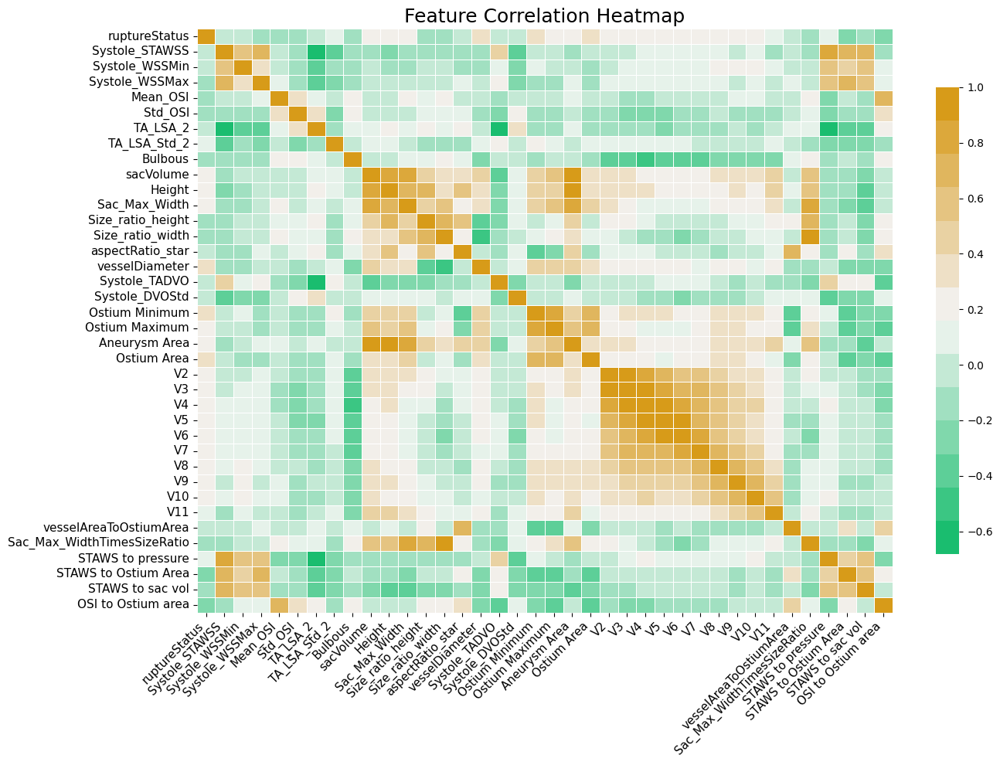

In [5]:
from matplotlib.colors import LinearSegmentedColormap

df_numeric = load_dataset().drop(columns=["Case", "Aneurysm type", "Aneurysm Location"])

# Some handcrafted features
df_numeric["vesselAreaToOstiumArea"] = (3.14159265358*(df_numeric["vesselDiameter"]/2.0)**2 / df_numeric["Ostium Area"]**2)
df_numeric["Sac_Max_WidthTimesSizeRatio"] = df_numeric["Sac_Max_Width"]*df_numeric["Size_ratio_width"]
df_numeric["STAWS to pressure"] = df_numeric["Systole_STAWSS"] / df_numeric["Mean_OSI"]
df_numeric["STAWS to Ostium Area"] = df_numeric["Systole_STAWSS"] / df_numeric["Ostium Area"]
df_numeric["STAWS to sac vol"] = df_numeric["Systole_STAWSS"] / df_numeric["sacVolume"]
df_numeric["OSI to Ostium area"] = df_numeric["Mean_OSI"] / df_numeric["Ostium Area"]


# Compute correlation matrix
correlation_matrix = df_numeric.corr()

# Extract correlation with ruptureStatus
rupture_correlation = correlation_matrix['ruptureStatus'].drop('ruptureStatus').sort_values(ascending=False)

# Sort correlation values by absolute correlation strength
correlation_df = pd.DataFrame({
    'Feature': rupture_correlation.index,
    'Correlation': rupture_correlation.values
}).sort_values(by='Correlation', key=lambda x: x.abs(), ascending=False).reset_index(drop=True)

# Display correlations nicely formatted
print("\nFeature Correlations with Rupture Status:")
display(correlation_df.round(3).style.hide(axis='index'))

custom_palette = sns.diverging_palette(h_neg=141, h_pos=53, s=97, l=68, sep=13, n=14, center="light")
sns.choose_diverging_palette()

#colors = ['#008080', '#FFA500']  # teal, white, orange
#custom_palette = LinearSegmentedColormap.from_list("teal_orange", colors)

# Improved correlation heatmap for readability
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, cmap=custom_palette, annot=False, fmt=".2f",
            linewidths=0.5, annot_kws={"size": 10}, cbar_kws={'shrink': 0.8})

plt.title("Feature Correlation Heatmap", fontsize=18)
plt.xticks(rotation=45, ha='right', fontsize=11)
plt.yticks(fontsize=11)
plt.tight_layout()
plt.show()

### Mutual Information Analysis - Categorical Features (location / type) are included

Mutual Information Scores:


Feature,Mutual Information
vesselDiameter,0.115000
OSI to Ostium area,0.109000
Ostium Area,0.107000
aspectRatio_star,0.091000
V5,0.082000
V11,0.081000
Aneurysm Area,0.079000
Sac_Max_Width,0.068000
Size_ratio_width,0.067000
Size_ratio_height,0.063000


Top 5 Features Based on MI


Feature
vesselDiameter
OSI to Ostium area
Ostium Area
aspectRatio_star
V5


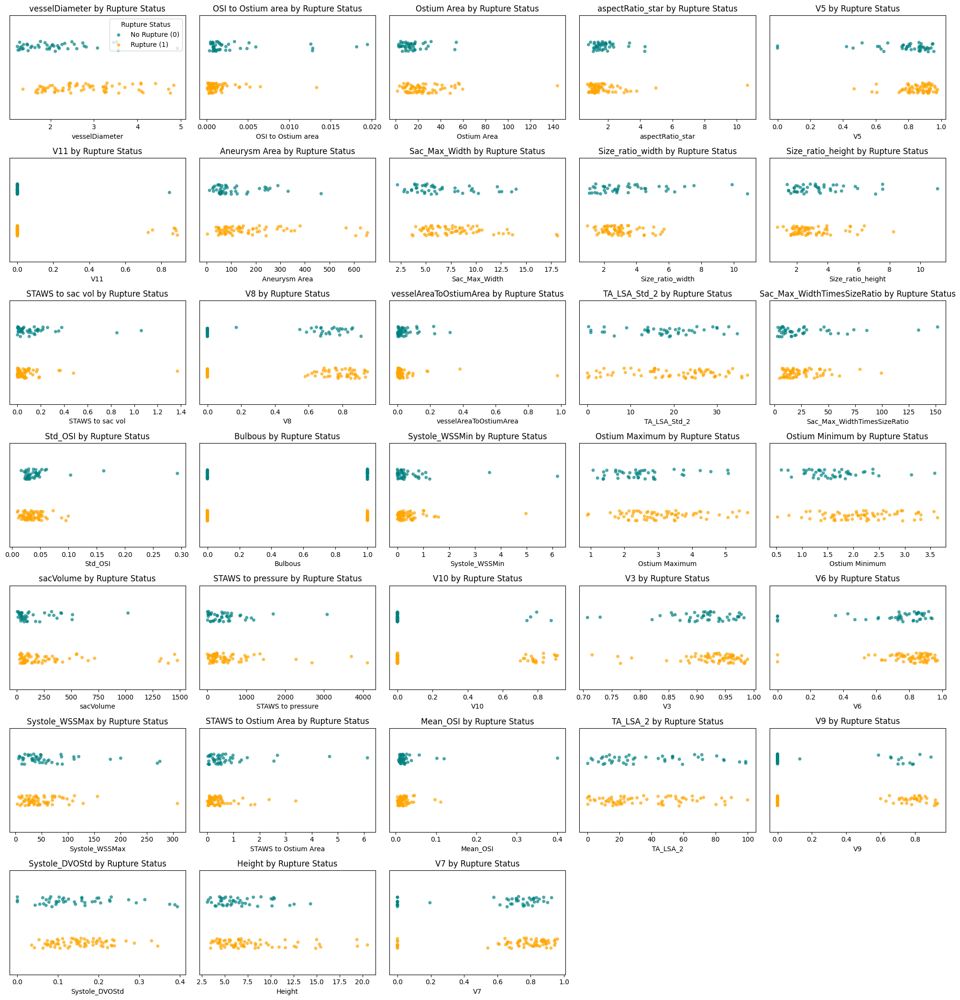

In [6]:
# Compute mutual information between features and ruptureStatus

df = load_dataset().drop(columns=["Case"])

X = df_numeric.drop(columns=['ruptureStatus'])
y = df_numeric['ruptureStatus']

mi_scores = mutual_info_classif(X, y, random_state=42)
mi_scores_df = pd.DataFrame({'Feature': X.columns, 'Mutual Information': mi_scores}).sort_values(by='Mutual Information', ascending=False)

# Display mutual information scores
print("Mutual Information Scores:")
display(mi_scores_df.round(3).style.hide(axis='index'))

# Select top 5 features based on mutual information
top_5_features = mi_scores_df['Feature'][:35]
print("Top 5 Features Based on MI")
display(mi_scores_df[['Feature']][:5].round(3).style.hide(axis='index'))


# Number of features to plot
num_features = 33
num_cols = 5
num_rows = int(np.ceil(num_features / num_cols))

# Set up subplots
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, num_rows * 3))

palette = {0: '#008080', 1: '#FFA500'}  # Teal and Orange

# Flatten axes array for easy indexing
axes = axes.flatten()

for i, feature in enumerate(mi_scores_df['Feature'][:num_features]):
    sns.stripplot(
        x=df_numeric[feature],
        hue=df_numeric['ruptureStatus'],
        palette=palette,
        ax=axes[i],
        dodge=True,
        alpha=0.7
    )

    axes[i].set_title(f'{feature} by Rupture Status')
    axes[i].set_xlabel(feature)
    axes[i].set_yticks([])
    axes[i].set_ylabel('')

    # Only show legend on the first plot
    if i == 0:
        axes[i].legend(title='Rupture Status', labels=['No Rupture (0)', 'Rupture (1)'], loc='upper right')
    else:
        axes[i].get_legend().remove()

# Remove unused subplots if any
for j in range(num_features, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [7]:
# showing the stats for top 5 MI features

In [8]:
df["vesselDiameter"].describe()

count    112.000000
mean       2.506331
std        0.887851
min        1.235403
25%        1.852252
50%        2.309030
75%        3.114370
max        4.922260
Name: vesselDiameter, dtype: float64

In [9]:
df["Ostium Area"].describe()

count    112.000000
mean      21.084834
std       18.033028
min        1.615760
25%       10.251902
50%       16.613450
75%       25.221965
max      143.949000
Name: Ostium Area, dtype: float64

In [10]:
df["V10"].describe()

count    112.000000
mean       0.185753
std        0.340709
min        0.000000
25%        0.000000
50%        0.000000
75%        0.000000
max        0.912368
Name: V10, dtype: float64

In [11]:
df["aspectRatio_star"].describe()

count    112.000000
mean       1.740596
std        1.158257
min        0.720787
25%        1.168038
50%        1.413915
75%        1.881656
max       10.671100
Name: aspectRatio_star, dtype: float64

In [12]:
df["V5"].describe()

count    112.000000
mean       0.821240
std        0.157576
min        0.000000
25%        0.795417
50%        0.864783
75%        0.915166
max        0.978153
Name: V5, dtype: float64

### Principal Component Analysis - Categorical variables (type / location) are dropped

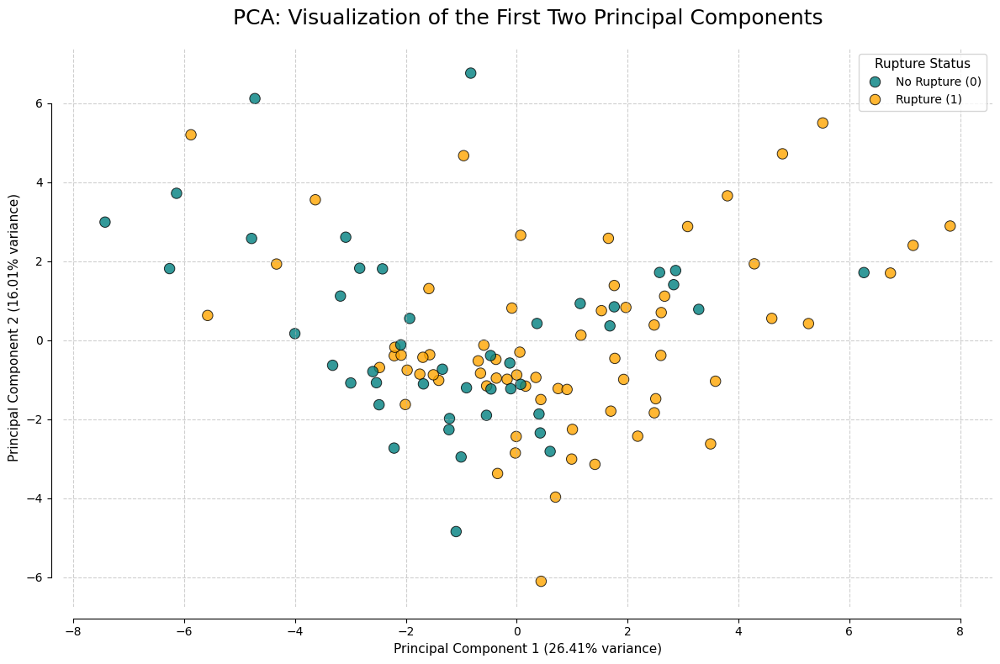

In [13]:
# Standardize the features
df_numeric = load_dataset().drop(columns=["Case", "Aneurysm type", "Aneurysm Location"])
X = df_numeric.drop(columns=['ruptureStatus'])

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform PCA
pca = PCA(n_components=2)  # Reduce to 2 components for visualization
X_pca = pca.fit_transform(X_scaled)

# Create a DataFrame for visualization
pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
pca_df['ruptureStatus'] = y

# Define professional color palette
palette = {0: '#008080', 1: '#FFA500'}  # Teal (no rupture) and Orange (rupture)

# Plotting PCA results
plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=pca_df, x='PC1', y='PC2',
    hue='ruptureStatus', palette=palette,
    alpha=0.8, s=80, edgecolor='k'
)

# Enhancing the plot aesthetics
plt.title('PCA: Visualization of the First Two Principal Components', fontsize=18, pad=20)
plt.xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]*100:.2f}% variance)', fontsize=11)
plt.ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]*100:.2f}% variance)', fontsize=11)

# Customized legend
handles, _ = plt.gca().get_legend_handles_labels()
plt.legend(handles=handles, labels=['No Rupture (0)', 'Rupture (1)'],
           title='Rupture Status', title_fontsize=11, fontsize=10, loc='upper right')

# Add gridlines and improve axes visibility
plt.grid(True, linestyle='--', alpha=0.6)

sns.despine(offset=10, trim=True)
plt.tight_layout()
plt.show()

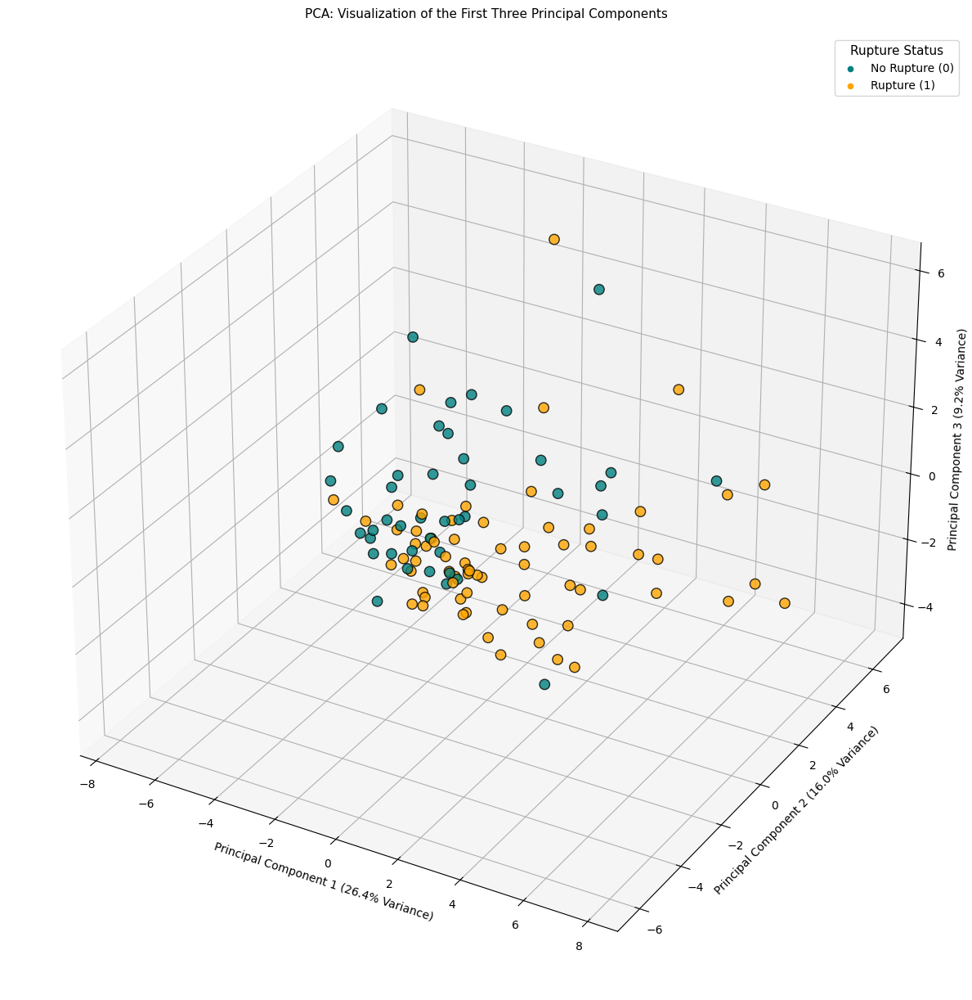


PCA Explained Variance:


Principal Component,Explained Variance Ratio
PC1,0.264000
PC2,0.160000
PC3,0.092000


In [14]:
from mpl_toolkits.mplot3d import Axes3D

# Remove non-numeric and categorical columns
df_numeric = load_dataset().drop(columns=["Case", "Aneurysm type", "Aneurysm Location"])

# Define features and target variable
X = df_numeric.drop(columns=['ruptureStatus'])

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform PCA with 3 components
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_scaled)

# Create a DataFrame for visualization
pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])
pca_df['ruptureStatus'] = y

# Professional color mapping (Teal and Orange)
colors = pca_df['ruptureStatus'].map({0: '#008080', 1: '#FFA500'})

# Plot PCA results in 3D
fig = plt.figure(figsize=(12, 14))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with improved aesthetics
scatter = ax.scatter(
    pca_df['PC1'], pca_df['PC2'], pca_df['PC3'],
    c=colors,
    alpha=0.8,
    s=80,
    edgecolor='k'
)

# Set titles and labels with standardized font sizes
ax.set_title('PCA: Visualization of the First Three Principal Components', fontsize=11, pad=15)
ax.set_xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]*100:.1f}% Variance)', fontsize=10)
ax.set_ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]*100:.1f}% Variance)', fontsize=10)
ax.set_zlabel(f'Principal Component 3 ({pca.explained_variance_ratio_[2]*100:.1f}% Variance)', fontsize=10)

# Custom legend for rupture status
for status, color in zip(['No Rupture (0)', 'Rupture (1)'], ['#008080', '#FFA500']):
    ax.scatter([], [], [], c=color, label=status)
ax.legend(title='Rupture Status', fontsize=10, title_fontsize=11, loc='best')

# Aesthetic adjustments
ax.grid(True)
plt.tight_layout()
plt.show()



# Display explained variance ratio
explained_variance = pd.DataFrame({'Principal Component': [f'PC{i+1}' for i in range(len(pca.explained_variance_ratio_))],
                                   'Explained Variance Ratio': pca.explained_variance_ratio_})

# Print explained variance
print("\nPCA Explained Variance:")
display(explained_variance.round(3).style.hide(axis='index'))

In [15]:
from mpl_toolkits.mplot3d import Axes3D

# Remove non-numeric and categorical columns
df_numeric = load_dataset().drop(columns=["Case", "Aneurysm type", "Aneurysm Location"])

# Define features and target variable
X = df_numeric.drop(columns=['ruptureStatus'])

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform PCA with 3 components
pca = PCA(n_components=15)
X_pca = pca.fit_transform(X_scaled)

# Create a DataFrame for visualization
pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10', 'PC11', 'PC12', 'PC13', 'PC14', 'PC15'])
pca_df['ruptureStatus'] = y

# Display explained variance ratio
explained_variance = pd.DataFrame({'Principal Component': [f'PC{i+1}' for i in range(len(pca.explained_variance_ratio_))],
                                   'Explained Variance Ratio': pca.explained_variance_ratio_})

explained_variance['Cumulative Explained Variance'] = explained_variance['Explained Variance Ratio'].cumsum()


# Print explained variance
print("\nPCA Explained Variance:")
display(explained_variance.round(3).style.hide(axis='index'))


PCA Explained Variance:


Principal Component,Explained Variance Ratio,Cumulative Explained Variance
PC1,0.264000,0.264000
PC2,0.160000,0.424000
PC3,0.092000,0.516000
PC4,0.088000,0.604000
PC5,0.059000,0.663000
PC6,0.048000,0.711000
PC7,0.043000,0.754000
PC8,0.037000,0.791000
PC9,0.029000,0.820000
PC10,0.025000,0.845000


## Configure Optuna for Parallelization

Optuna uses a database to share trial results for a given study. We will use timestamps to ensure studies are stored in unique tables across jupyter runs even if the notebook is turned off. To setup mysql, if you are using a mac just run brew install mysql. Then run brew services start mysql. Then run the below commands.

In [16]:
!mysql -u root -e "CREATE DATABASE IF NOT EXISTS optuna"

In [17]:
!pip install mysqlclient

In [18]:
from optuna.pruners import MedianPruner
from optuna.samplers import TPESampler

## Comparing LR, SVC, Decision Trees, XGB, MLP, BART on All Features

We will use all features as a baseline for later on

In [10]:
def generate_feature_permutation_plots(models, X_test, y_test, model_type):
    import math
    rs = []
    for i in range(len(models)):
        rs.append(permutation_importance(models[0], X_test, y_test, n_repeats=30, random_state=0, scoring="accuracy"))
    
    
    mean_importance_means = np.array(rs[0].importances_mean)
    mean_stds = np.array(rs[0].importances_std)
    
    for i in range(1, len(models)):
        mean_importance_means += np.array(rs[i].importances_mean)
        mean_stds += np.array(rs[i].importances_std)
        
    mean_importance_means /= len(models)
    mean_stds /= len(models)
    mean_stds /= math.sqrt(len(models))
    
    # Sort the features by importance
    sorted_idx = mean_importance_means.argsort()[::-1]
    sorted_importances = mean_importance_means[sorted_idx]
    sorted_features = X_test.columns[sorted_idx]
    sorted_std = mean_stds[sorted_idx]
    
    # Enhanced permutation importance plot
    plt.figure(figsize=(12, 9))
    bars = plt.barh(
        sorted_features, 
        sorted_importances, 
        xerr=sorted_std, 
        align='center', 
        color='teal', 
        edgecolor='orange', 
        linewidth=1, 
        capsize=4, 
        error_kw={
            'ecolor': 'orange',       # Color of error bars
            'elinewidth': 1.2,
            'capsize': 4
        },
        label='Mean Mean Importance ± mean std / sqrt(n)')
    
    # Titles and labels
    plt.xlabel("Permutation Importance", fontsize=10)
    plt.title(f"Permutation Feature Importance for Local {model_type}", fontsize=11)
    plt.gca().invert_yaxis()
    
    # Grid and aesthetics
    plt.grid(axis='x', linestyle='--', alpha=0.7)
    plt.gca().set_facecolor('#f9f9f9')
    plt.legend(fontsize=9, loc='lower right')
    plt.tight_layout()
    
    plt.show()
    
    # Create a DataFrame to show sorted feature importance clearly
    feature_importances_df = pd.DataFrame({
        'Feature': sorted_features,
        'Importance Mean': sorted_importances,
        'Importance Std': mean_stds[sorted_idx]
    })
    
    print(feature_importances_df.round(3).style.hide(axis='index'))

In [11]:
def generate_roc_plots(roc_curves, metrics, model_type):
    #############################################
    # Plot ROC Curve                           #
    #############################################
    plt.figure(figsize=(10, 7))
    
    # Background style
    plt.gca().set_facecolor('#f9f9f9')
    plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)
    
    # Plot individual ROC curves with low opacity
    for fpr, tpr in roc_curves:
        plt.plot(fpr, tpr, alpha=0.1, color="teal")
    
    # Calculate and plot mean ROC curve
    mean_fpr = np.linspace(0, 1, 100)
    interp_tprs = [np.interp(mean_fpr, fpr, tpr) for fpr, tpr in roc_curves]
    mean_tpr = np.mean(interp_tprs, axis=0)
    mean_auc = metrics["AUC (Area Under ROC)"][0] # this value is more accurate since interpolation interferes
    
    plt.plot(mean_fpr, mean_tpr, color="orange", linewidth=2.5,
             label=f"Mean ROC Curve (AUC = {mean_auc:.3f})")
    
    # Plot chance line
    plt.plot([0, 1], [0, 1], linestyle="--", color="gray", linewidth=1.2)
    
    # Labels and title
    plt.xlabel("False Positive Rate", fontsize=10)
    plt.ylabel("True Positive Rate", fontsize=10)
    plt.title(f"ROC Curve for Local {model_type} Model", fontsize=11)
    
    # Legend
    plt.legend(loc="lower right", fontsize=11, frameon=False)
    
    # Ticks
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    
    plt.tight_layout()
    plt.show()

In [12]:
import numpy as np
import matplotlib.pyplot as plt

def generate_pr_plots(pr_curves, metrics, model_type):
    """
    pr_curves should be a list of tuples: (precision_array, recall_array, thresholds)
    metrics is currently unused but left in case you want it
    model_type is a string for labeling
    """
    # Plot setup
    plt.figure(figsize=(10, 7))
    plt.gca().set_facecolor('#f9f9f9')
    plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.6)
    
    # Plot individual PR curves with low opacity
    for pr, re, _ in pr_curves:
        plt.plot(re, pr, alpha=0.1, color="teal")
    
    # Interpolate PR curves on a common recall grid
    mean_re = np.linspace(0, 1, 100)
    interp_prs = []
    
    for pr, re, _ in pr_curves:
        # Sort the arrays by recall to ensure monotonic interpolation
        sorted_idx = np.argsort(re)
        re_sorted = np.array(re)[sorted_idx]
        pr_sorted = np.array(pr)[sorted_idx]
        
        # Interpolate precision values at mean_re points
        interp_precision = np.interp(mean_re, re_sorted, pr_sorted)
        interp_prs.append(interp_precision)
    
    # Compute the mean precision across all interpolated curves
    mean_pr = np.mean(interp_prs, axis=0)
    
    # Plot the mean PR curve
    plt.plot(mean_re, mean_pr, color="orange", linewidth=2.5,
             label="Mean PR Curve")
    
    # (Optional) Plot a diagonal line (more relevant to ROC, but included here)
    plt.plot([0, 1], [0, 1], linestyle="--", color="gray", linewidth=1.2, 
             label="Reference (Diagonal)")
    
    # Labels, title, and legend
    plt.xlabel("Recall", fontsize=10)
    plt.ylabel("Precision", fontsize=10)
    plt.title(f"PR Curve for Local {model_type} Model", fontsize=11)
    plt.legend(loc="lower right", fontsize=11, frameon=False)
    
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    
    plt.tight_layout()
    plt.show()

In [13]:
def generate_confusian_matrix_plots(conf_matrices, model_type):
    thresholds = [i*0.1 for i in range(1, 10)]
    
    for i in range(9):
        thresh = thresholds[i]
        plt.figure(figsize=(6, 5))
        sns.heatmap(
            np.sum(conf_matrices[i], axis=0),
            annot=True,
            fmt=".0f",
            cmap="Greens",
            cbar=False,
            xticklabels=["No Rupture", "Rupture"],
            yticklabels=["No Rupture", "Rupture"],
            linewidths=0.5,
            linecolor='white',
            annot_kws={"fontsize": 10, "fontweight": "bold"}
        )
        plt.xlabel("Predicted Label", fontsize=10)
        plt.ylabel("True Label", fontsize=10)
        plt.title(f"Confusion Matrix at Threshold = {thresh:.1f} (Local {model_type})", fontsize=11)
        plt.tight_layout()
        plt.show()

### SVC (Support Vector Classifier)

In [23]:
df = load_dataset()
df.pop("Case")

0       C0001_dicom
1       C0002_dicom
2             C0010
3             C0006
4             C0007
5             C0014
6             C0016
7             C0019
8             C0020
9        CH_case087
10           UM_003
11           UM_007
12           UM_009
13           UM_013
14           UM_015
15            C0057
16            C0060
17            C0055
18            C0024
19            C0026
20      C0049_dicom
21           C0028b
22            C0030
23            C0033
24            C0034
25      C0035_dicom
26      C0036_dicom
27            C0063
28            C0064
29      C0039_dicom
30      C0040_dicom
31      C0041_dicom
32      C0042_dicom
33      C0044_dicom
34            C0045
35            C0046
36            C0066
37            C0067
38            C0069
39            C0071
40            C0072
41     C0074a_dicom
42      C0075_dicom
43      C0076_dicom
44            C0078
45            C0079
46            C0086
47            C0089
48            C0090
49            C0093


In [24]:
df.columns.tolist()
# .remove('Aneurysm type')
# Aneurysm Location

['ruptureStatus',
 'Aneurysm Location',
 'Aneurysm type',
 'Systole_STAWSS',
 'Systole_WSSMin',
 'Systole_WSSMax',
 'Mean_OSI',
 'Std_OSI',
 'TA_LSA_2',
 'TA_LSA_Std_2',
 'Bulbous',
 'sacVolume',
 'Height',
 'Sac_Max_Width',
 'Size_ratio_height',
 'Size_ratio_width',
 'aspectRatio_star',
 'vesselDiameter',
 'Systole_TADVO',
 'Systole_DVOStd',
 'Ostium Minimum',
 'Ostium Maximum',
 'Aneurysm Area',
 'Ostium Area',
 'V2',
 'V3',
 'V4',
 'V5',
 'V6',
 'V7',
 'V8',
 'V9',
 'V10',
 'V11']

#### Research Paper's Approach (Copy Pasted)

In [25]:
df.columns

Index(['ruptureStatus', 'Aneurysm Location', 'Aneurysm type', 'Systole_STAWSS',
       'Systole_WSSMin', 'Systole_WSSMax', 'Mean_OSI', 'Std_OSI', 'TA_LSA_2',
       'TA_LSA_Std_2', 'Bulbous', 'sacVolume', 'Height', 'Sac_Max_Width',
       'Size_ratio_height', 'Size_ratio_width', 'aspectRatio_star',
       'vesselDiameter', 'Systole_TADVO', 'Systole_DVOStd', 'Ostium Minimum',
       'Ostium Maximum', 'Aneurysm Area', 'Ostium Area', 'V2', 'V3', 'V4',
       'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11'],
      dtype='object')

In [26]:
import pandas as pd
import numpy as np 
import time
import csv

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier

# A function to ignore warnings!
import warnings
warnings.simplefilter('ignore')  

#------------------------------------------------------------------------------  
#--- Support Vector Machine  
#------------------------------------------------------------------------------  
def test_SVM(num_iters, features, labels):  
    print("running iterations")

    AUC_score = np.zeros(num_iters) 
    Accuracy_score = np.zeros(num_iters) 
    Precision_score = np.zeros(num_iters) 
    Recall_score = np.zeros(num_iters) 
    F1_score = np.zeros(num_iters)     

    for i in range(num_iters):
        print(f"iter {i}")
    
        #--get splits and best params
        np.random.RandomState(seed=1)
        t0 = time.time()        
        x_train,x_test,y_train,y_test=train_test_split(features,labels,test_size=0.1,random_state=i,stratify=labels) # 
        svc=SVC(probability=True)
        param_grid = {
             'kernel': ['linear'],
             'C':[ 0.1, 0.5, 1],
             'gamma': [0.1,0.5,1,2],
             'class_weight':['balanced'],
             'random_state':[800]
            }
        grid = GridSearchCV(svc, param_grid=param_grid, scoring='roc_auc', cv=5, verbose=0)#neg_log_loss,roc_auc # cv=3, acc=0.7646
        print(f"training {i}")
        grid.fit(x_train,y_train)
        print(f"finished training {i}")
        y_pred=grid.predict(x_test) 
            
        #--Get ROC-AUC Score
        Accuracy_score[i] = accuracy_score(y_test,y_pred)        
        AUC_score[i] = roc_auc_score(y_test, y_pred) #--Choose macro, micro etc. See Docs
        Precision_score[i] = precision_score(y_test,y_pred)
        Recall_score[i] = recall_score(y_test,y_pred)
        F1_score[i] = f1_score(y_test,y_pred)
        
    
        print("Iteration:", i, "Accuracy_Score:%.4f" % float(Accuracy_score[i]), "Predictions:", y_pred) 

    print("-------------------------")   
    print("Accuracy Score: %.4f" % np.mean(Accuracy_score))
    print("AUC Score: %.4f" % np.mean(AUC_score))
    print("Precision Score: %.4f" % np.mean(Precision_score))
    print("Recall Score: %.4f" % np.mean(Recall_score))
    print("F1 Score: %.4f" % np.mean(F1_score))
    print("-------------------------")      

train_cols_t = ['Aneurysm Location', 'Aneurysm type', 'Systole_STAWSS',
       'Systole_WSSMin', 'Systole_WSSMax', 'Mean_OSI', 'Std_OSI', 'TA_LSA_2',
       'TA_LSA_Std_2', 'Bulbous', 'sacVolume', 'Height', 'Sac_Max_Width',
       'Size_ratio_height', 'Size_ratio_width', 'aspectRatio_star',
       'vesselDiameter', 'Systole_TADVO', 'Systole_DVOStd', 'Ostium Minimum',
       'Ostium Maximum', 'Aneurysm Area', 'Ostium Area', 'V2', 'V3', 'V4',
       'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']
X_train_temp = df[train_cols_t].copy()
test_SVM(5, X_train_temp, df[["ruptureStatus"]].copy())

running iterations
iter 0
training 0
finished training 0
Iteration: 0 Accuracy_Score:0.4167 Predictions: [1 1 1 0 0 1 1 0 1 0 0 0]
iter 1
training 1
finished training 1
Iteration: 1 Accuracy_Score:0.7500 Predictions: [1 1 1 1 0 1 0 0 0 0 0 1]
iter 2
training 2
finished training 2
Iteration: 2 Accuracy_Score:0.7500 Predictions: [1 1 0 0 1 1 1 1 1 1 1 1]
iter 3
training 3
finished training 3
Iteration: 3 Accuracy_Score:0.6667 Predictions: [1 0 0 0 1 1 1 0 1 0 1 1]
iter 4
training 4
finished training 4
Iteration: 4 Accuracy_Score:0.6667 Predictions: [1 1 1 1 0 0 0 1 1 1 1 1]
-------------------------
Accuracy Score: 0.6500
AUC Score: 0.6314
Precision Score: 0.6829
Recall Score: 0.7429
F1 Score: 0.7037
-------------------------


[CV 5/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.516 total time=   5.0s
[CV 1/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.615 total time=   2.0s
[CV 2/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.729 total time=   3.4s
[CV 3/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.625 total time=   4.2s
[CV 4/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.802 total time=   3.9s
[CV 5/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.516 total time=   4.9s
finished training 6
Iteration: 6 Accuracy_Score:0.6667 Predictions: [1 0 0 0 0 1 1 1 0 1 0 0]
iter 7
training 7
Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.791 total time=   0.4s
[CV 2/5] END C=0.1

[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.896 total time=   0.6s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.760 total time=   0.3s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.698 total time=   0.8s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.448 total time=   0.3s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.593 total time=   0.3s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.896 total time=   0.6s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.760 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.698 total time=   0.8s
[CV 5/5] END C=0.1, class_weight=balanced, gamma

[CV 1/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.791 total time=   0.5s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.542 total time=   0.3s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.750 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.948 total time=   0.9s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.865 total time=   0.5s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.791 total time=   0.5s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.542 total time=   0.3s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.750 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linea

[CV 5/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.896 total time=   0.3s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.582 total time=   2.0s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.802 total time=   2.8s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.719 total time=   2.7s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.698 total time=   1.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.771 total time=   2.0s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.582 total time=   1.9s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.802 total time=   2.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0

[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.729 total time=   2.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.637 total time=   1.7s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.760 total time=   1.8s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.823 total time=   2.3s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.760 total time=   2.2s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.729 total time=   2.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.637 total time=   1.7s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.760 total time=   1.9s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=2, kernel=l

[CV 3/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.750 total time=   2.9s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.760 total time=   3.2s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.648 total time=   3.0s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.542 total time=   2.2s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.677 total time=   4.0s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.750 total time=   4.6s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.708 total time=   5.9s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.670 total time=   5.7s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linea

[CV 2/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.656 total time=   5.0s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.573 total time=   2.8s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.896 total time=   6.0s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.885 total time=   4.3s
[CV 1/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.659 total time=   4.5s
[CV 2/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.656 total time=   5.0s
[CV 3/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.573 total time=   2.8s
[CV 4/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.896 total time=   6.0s
[CV 5/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_

[CV 1/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.582 total time=   4.0s
[CV 2/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.531 total time=   6.0s
[CV 3/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.500 total time=   6.1s
[CV 4/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.938 total time=   4.3s
[CV 5/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.698 total time=   7.0s
finished training 14
Iteration: 14 Accuracy_Score:0.6667 Predictions: [1 1 0 0 0 1 1 1 0 0 0 0]
iter 15
training 15
Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.659 total time=   0.5s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.729 total time=   0.5s
[CV 3/5] E

[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.667 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.729 total time=   0.2s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.956 total time=   0.5s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.729 total time=   0.4s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.729 total time=   0.4s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.667 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.729 total time=   0.2s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.956 total time=   0.7s
[CV 1/5] END C=0.1, class_weight=balanced, gamma

[CV 2/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.906 total time=   0.8s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.781 total time=   0.5s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.760 total time=   0.3s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.792 total time=   0.4s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.769 total time=   0.7s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.906 total time=   0.7s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.781 total time=   0.5s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.760 total time=   0.3s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linea

[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.615 total time=   3.0s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.615 total time=   1.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.729 total time=   1.6s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.531 total time=   2.0s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.927 total time=   3.2s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.615 total time=   3.0s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.615 total time=   1.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.729 total time=   1.6s
[CV 4/5] END C=0.5, class_weight=balanced, gamma

[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.656 total time=   2.2s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.549 total time=   2.2s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.729 total time=   2.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.583 total time=   1.9s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.792 total time=   3.4s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.656 total time=   2.2s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.549 total time=   2.2s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.729 total time=   2.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=2, kernel=lin

[CV 4/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.667 total time=   1.6s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.812 total time=   2.0s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.791 total time=   2.3s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.844 total time=   5.7s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.771 total time=   3.2s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.656 total time=   3.2s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.802 total time=   4.7s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.791 total time=   2.3s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linea

[CV 3/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.771 total time=   3.4s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.667 total time=   4.0s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.844 total time=   4.5s
[CV 1/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.549 total time=   2.6s
[CV 2/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.729 total time=   6.1s
[CV 3/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.771 total time=   3.3s
[CV 4/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.667 total time=   4.0s
[CV 5/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.844 total time=   4.2s
[CV 1/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_st

[CV 2/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.573 total time=   4.0s
[CV 3/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.771 total time=   4.2s
[CV 4/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.802 total time=   3.8s
[CV 5/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.879 total time=   8.1s
finished training 22
Iteration: 22 Accuracy_Score:0.7500 Predictions: [0 1 0 0 0 1 0 0 0 0 1 1]
iter 23
training 23
Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.714 total time=   0.4s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.583 total time=   0.4s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.760 total time=   0.5s
[CV 4/

[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.698 total time=   0.4s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.879 total time=   0.2s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.500 total time=   0.2s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.927 total time=   0.4s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.750 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.698 total time=   0.4s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.879 total time=   0.2s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.500 total time=   0.2s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=1

[CV 3/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.635 total time=   0.5s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.615 total time=   0.6s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.729 total time=   0.5s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.802 total time=   0.3s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.833 total time=   0.6s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.635 total time=   0.5s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.615 total time=   0.6s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.729 total time=   0.5s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=lin

[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.708 total time=   3.1s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.510 total time=   1.9s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.500 total time=   2.1s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.681 total time=   2.2s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.875 total time=   2.7s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.708 total time=   3.1s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.510 total time=   2.2s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.500 total time=   2.1s
[CV 5/5] END C=0.5, class_weight=balanced, gamma

[CV 1/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.833 total time=   2.5s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.740 total time=   1.5s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.688 total time=   3.1s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.604 total time=   1.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.736 total time=   2.5s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.833 total time=   2.5s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.740 total time=   1.5s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.688 total time=   3.1s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linea

[CV 5/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.681 total time=   1.6s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.875 total time=   3.2s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.938 total time=   3.7s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.646 total time=   3.1s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.885 total time=   3.8s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.626 total time=   3.5s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.875 total time=   3.2s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.938 total time=   3.7s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linea

[CV 4/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.792 total time=   4.9s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.573 total time=   6.5s
[CV 1/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.890 total time=   5.6s
[CV 2/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.646 total time=   4.4s
[CV 3/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.573 total time=   3.4s
[CV 4/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.792 total time=   4.9s
[CV 5/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.573 total time=   6.6s
[CV 1/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.890 total time=   5.6s
[CV 2/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_stat

[CV 3/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.740 total time=   4.3s
[CV 4/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.802 total time=   3.5s
[CV 5/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.802 total time=   6.3s
finished training 30
Iteration: 30 Accuracy_Score:0.7500 Predictions: [0 1 1 1 0 1 0 0 1 1 0 0]
iter 31
training 31
Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.736 total time=   0.3s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.938 total time=   0.5s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.760 total time=   0.4s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.812 total time=   0.4s
[C

[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.750 total time=   0.3s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.879 total time=   0.3s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.792 total time=   0.3s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.698 total time=   0.3s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.844 total time=   0.5s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.750 total time=   0.3s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.879 total time=   0.3s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.792 total time=   0.3s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=1, 

[CV 4/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.948 total time=   0.5s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.780 total time=   0.9s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.854 total time=   0.4s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.469 total time=   0.5s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.698 total time=   0.5s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.948 total time=   0.5s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.780 total time=   0.9s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.833 total time=   3.0s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=l

[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.667 total time=   1.7s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.667 total time=   2.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.802 total time=   1.3s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.912 total time=   1.5s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.646 total time=   2.8s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.667 total time=   1.7s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.667 total time=   2.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.802 total time=   1.3s
[CV 1/5] END C=0.5, class_weight=balanced, gamma

[CV 2/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.823 total time=   1.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.792 total time=   0.9s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.833 total time=   1.0s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.760 total time=   1.3s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.824 total time=   2.2s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.823 total time=   1.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.792 total time=   0.9s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.833 total time=   1.0s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linea

[CV 1/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.780 total time=   3.4s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.760 total time=   4.7s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.594 total time=   2.3s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.771 total time=   4.3s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.844 total time=   2.8s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.780 total time=   3.4s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.760 total time=   4.7s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.594 total time=   2.3s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linea

[CV 5/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.552 total time=   3.7s
[CV 1/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.846 total time=   3.2s
[CV 2/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.854 total time=   6.8s
[CV 3/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.625 total time=   5.1s
[CV 4/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.729 total time=   5.3s
[CV 5/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.552 total time=   3.7s
[CV 1/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.846 total time=   3.2s
[CV 2/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.854 total time=   6.8s
[CV 3/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=

[CV 4/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.635 total time=   2.1s
[CV 5/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.802 total time=   3.9s
finished training 38
Iteration: 38 Accuracy_Score:0.9167 Predictions: [0 1 0 1 0 1 1 0 1 1 1 1]
iter 39
training 39
Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.681 total time=   0.2s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.802 total time=   0.2s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.792 total time=   0.3s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.677 total time=   0.3s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.760 total time=   0.3

[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.956 total time=   0.4s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.594 total time=   0.4s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.729 total time=   0.6s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.792 total time=   0.4s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.656 total time=   0.4s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.956 total time=   0.4s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.594 total time=   0.4s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.729 total time=   0.6s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=1, ke

[CV 5/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.875 total time=   0.5s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.824 total time=   0.5s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.625 total time=   0.3s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.615 total time=   0.3s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.833 total time=   0.7s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.875 total time=   0.5s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.868 total time=   2.5s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.729 total time=   2.5s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel

[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.812 total time=   2.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.635 total time=   1.7s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.549 total time=   1.6s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.479 total time=   1.7s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.719 total time=   2.6s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.812 total time=   2.3s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.635 total time=   1.7s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.549 total time=   1.6s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=1

[CV 3/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.823 total time=   3.6s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.583 total time=   2.5s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.626 total time=   2.2s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.635 total time=   1.6s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.833 total time=   2.1s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.823 total time=   3.6s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.583 total time=   2.5s
[CV 5/5] END C=0.5, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.626 total time=   2.2s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linea

[CV 2/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.688 total time=   7.4s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.760 total time=   2.5s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.760 total time=   2.8s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.813 total time=   7.3s
[CV 1/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.802 total time=   3.6s
[CV 2/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.688 total time=   7.4s
[CV 3/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.760 total time=   2.5s
[CV 4/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.760 total time=   2.8s
[CV 5/5] END C=1, class_weight=balanced, gamma=0.5, kernel=linea

[CV 1/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.714 total time=   4.6s
[CV 2/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.802 total time=   4.7s
[CV 3/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.604 total time=   5.5s
[CV 4/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.417 total time=   3.3s
[CV 5/5] END C=1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.573 total time=   4.3s
[CV 1/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.714 total time=   4.6s
[CV 2/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.802 total time=   4.7s
[CV 3/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.604 total time=   5.5s
[CV 4/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=80

[CV 5/5] END C=1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.854 total time=   3.6s
finished training 46
Iteration: 46 Accuracy_Score:0.5833 Predictions: [0 1 1 1 1 0 0 1 1 1 1 0]
iter 47
training 47
Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.812 total time=   0.7s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.604 total time=   0.5s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.615 total time=   0.2s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.750 total time=   1.3s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.890 total time=   0.5s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.812 total time=  

[CV 2/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.677 total time=   0.7s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.938 total time=   0.7s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.656 total time=   0.7s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=0.5, kernel=linear, random_state=800;, score=0.854 total time=   0.5s
[CV 1/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.560 total time=   0.3s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.677 total time=   0.7s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.938 total time=   0.7s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=1, kernel=linear, random_state=800;, score=0.656 total time=   0.7s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=1, kern

[CV 1/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.688 total time=   0.6s
[CV 2/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.615 total time=   0.5s
[CV 3/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.740 total time=   0.7s
[CV 4/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.948 total time=   0.7s
[CV 5/5] END C=0.1, class_weight=balanced, gamma=2, kernel=linear, random_state=800;, score=0.692 total time=   0.4s
[CV 1/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.708 total time=   1.2s
[CV 2/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.583 total time=   3.2s
[CV 3/5] END C=0.5, class_weight=balanced, gamma=0.1, kernel=linear, random_state=800;, score=0.802 total time=   2.5s
[CV 4/5] END C=0.5, class_weight=balanced, gamma=0.1, kern

#### Now Our Model

In [27]:
import os

#############################################
# Identify columns and create dataframe  #
#############################################

standardized_num_features = df.columns.tolist()
categorical = ["Aneurysm type", "Aneurysm Location", "Bulbous"]
[standardized_num_features.remove(cat) for cat in categorical]
standardized_num_features.remove("ruptureStatus")

target_col = "ruptureStatus"
selected_features = standardized_num_features + categorical

X = df[selected_features].copy()

# feature scaling
X["Ostium Area"] = X["Ostium Area"]**(1/2.0)
X["Aneurysm Area"] = X["Aneurysm Area"]**(1/2.0)
X["sacVolume"] = X["sacVolume"]**(1/3.0)

# feature combos
#X["vesselAreaToOstiumArea"] = (3.14159265358*(X["vesselDiameter"]/2.0)**2 / X["Ostium Area"]**2)**(1/2.0) did not work
X["OSI to Ostium area"] = X["Mean_OSI"] / (X["Ostium Area"]**2)
X["Sac_Max_WidthTimesSizeRatio"] = X["Sac_Max_Width"]*X["Size_ratio_width"]
#X["STAWS to pressure"] = X["Systole_STAWSS"] / X["Mean_OSI"]
#X["STAWS to Ostium Area"] = X["Systole_STAWSS"] / (X["Ostium Area"]**2) did not work
#X["STAWS to sac vol"] = X["Systole_STAWSS"] / (X["sacVolume"]**3)

#standardized_num_features.append("vesselAreaToOstiumArea") did not work
standardized_num_features.append("OSI to Ostium area")
standardized_num_features.append("Sac_Max_WidthTimesSizeRatio")
#standardized_num_features.append("STAWS to pressure")
#standardized_num_features.append("STAWS to Ostium Area") did not work
#standardized_num_features.append("STAWS to sac vol")
#standardized_num_features.append("Sac_Max_WidthTimesSizeRatio")
selected_features = standardized_num_features + categorical

y = df[target_col].copy()

# Convert to numeric, coerce errors to NaN
for col in standardized_num_features:
    X[col] = pd.to_numeric(X[col], errors="coerce")

#############################################
# Perform 100 Iterations with Random Splits #
#############################################

n_splits = 100
test_scores = []
precisions = []
recalls = []
specificities = []
sensitivities = []
auc_scores = []
roc_curves = []
precision_recall_curves = []
conf_matrices = [[] for i in range(1, 10)] # different matrix for thresholds 0.1, ..., 0.9
f1s = []

from scipy.stats import t
def compute_confidence_interval(metric_list, confidence=0.95):
    metric_list = np.array(metric_list)
    n = len(metric_list)
    mean_val = np.mean(metric_list)
    std_err = np.std(metric_list, ddof=1) / np.sqrt(n)
    ci = t.interval(confidence, df=n-1, loc=mean_val, scale=std_err)
    return mean_val, ci, std_err

import optuna

sss = StratifiedShuffleSplit(n_splits=n_splits, test_size=0.2, random_state=42)
it = 1

biggest_model_id_existing = 0
for i in range(1, n_splits+1):
    dir_path = "./aneurysm_models_trained_locally/svc"
    model_filename = f"model{i}.joblib"
    if os.path.exists(os.path.join(dir_path, model_filename)):
        biggest_model_id_existing += 1
    else:
        break

models = list(joblib.Parallel(n_jobs=-1)(
    joblib.delayed(joblib.load)(f"./aneurysm_models_trained_locally/svc/model{i}.joblib") for i in range(1, biggest_model_id_existing+1)
))

splits_it = 1
train_idxs = []
test_idxs = []
if os.path.exists("./aneurysm_models_trained_locally/svc/splits/"):
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/svc/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/svc/splits/test{splits_it}.npy"))
        splits_it += 1
else:
    os.makedirs("./aneurysm_models_trained_locally/svc/splits/")
    for train_idx, test_idx in sss.split(X,y):
        np.save(f"./aneurysm_models_trained_locally/svc/splits/training{splits_it}.npy", train_idx)
        np.save(f"./aneurysm_models_trained_locally/svc/splits/test{splits_it}.npy", test_idx)
        splits_it += 1
    splits_it = 1
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/svc/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/svc/splits/test{splits_it}.npy"))
        splits_it += 1
            

for train_idx, test_idx in list(zip(train_idxs, test_idxs)):
    dir_path = "./aneurysm_models_trained_locally/svc"
    model_filename = f"model{it}.joblib"
    print(f"Running iteration {it}")
    X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
    y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
    
    if not os.path.exists(os.path.join(dir_path, model_filename)):
    
        print("Getting best params")
        def objective(trial):
            preprocessor = ColumnTransformer([
                ("stand_nums",
                 Pipeline([
                     ("imputer", SimpleImputer(strategy="median")),
                     ("scaler", StandardScaler())
                 ]),
                 standardized_num_features
                ),
                ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
            ])
            pipeline = Pipeline([
                ('preprocessor', preprocessor),
                ('classifier', SVC(
                    C=trial.suggest_float('C',  1e-3, 1e3, log=True),
                    gamma=trial.suggest_float('G', 1e-3, 1e3, log=True),
                    kernel=trial.suggest_categorical("K", ['linear', 'rbf']),
                    probability=True,
                    class_weight='balanced'
                ))
            ])
            
            val_aucs = []
            train_aucs = []
    
            cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=6789)
            for train_idx, val_idx in cv.split(X_train, y_train):
                X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
                y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]
    
                pipeline.fit(X_tr, y_tr)
    
                y_val_pred = pipeline.predict_proba(X_val)[:, 1]
                y_tr_pred = pipeline.predict_proba(X_tr)[:, 1]
    
                val_auc = roc_auc_score(y_val, y_val_pred)
                train_auc = roc_auc_score(y_tr, y_tr_pred)
    
                val_aucs.append(val_auc)
                train_aucs.append(train_auc)
    
            mean_val_auc = np.mean(val_aucs)
            mean_train_auc = np.mean(train_aucs)
            auc_diff = np.mean(np.abs(np.array(val_aucs) - np.array(train_auc)))  # Overfitting penalty
    
            return mean_val_auc - 0.1*auc_diff

        study_name = "SVC" + str(int(time.time() * 1000))
        optuna.create_study(
            study_name=study_name, 
            directions=['maximize'], # Optimization directions
            sampler=TPESampler(seed=42), # Use the NSGAIII sampler
            pruner=MedianPruner(n_startup_trials=10, n_min_trials=2), # Use the MedianPruner
            load_if_exists=True, # Load study if it exists
            storage='mysql://root@localhost/optuna' # Save the study in SQLite
        )
        
        from concurrent.futures import ThreadPoolExecutor
        def run_optuna_study(study_name):
            study = optuna.load_study(
                study_name=study_name, storage="mysql://root@localhost/optuna"
            )
            study.optimize(objective, n_trials=5)
            
        with ThreadPoolExecutor(max_workers=16) as executor:
            res = []
            for i in range(16):
                res.append(executor.submit(run_optuna_study, study_name))
            for r in res:
                r.result()
        
        best_params = optuna.load_study(
            study_name=study_name, storage="mysql://root@localhost/optuna"
        ).best_params
        
        print(f"Best params obtained from optuna were: {best_params}")
        preprocessor = ColumnTransformer([
            ("stand_nums",
             Pipeline([
                 ("imputer", SimpleImputer(strategy="median")),
                 ("scaler", StandardScaler())
             ]),
             standardized_num_features
            ),
            ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
        ])
        pipeline = Pipeline([
            ('preprocessor', preprocessor),
            ('classifier', SVC(
                C=best_params['C'],
                gamma=best_params['G'],
                kernel=best_params['K'],
                probability=True,
                class_weight='balanced'
            ))
        ])
        pipeline.fit(X_train, y_train)
        models.append(pipeline)

        # save model
        os.makedirs(dir_path, exist_ok=True)
        joblib.dump(models[-1], os.path.join(dir_path, model_filename))
        best_model = pipeline
    else:
        pipeline = joblib.load(os.path.join(dir_path, model_filename))
        best_model = pipeline
        
    # Accuracy
    y_pred = pipeline.predict(X_test)
    test_score = accuracy_score(y_test, y_pred)
    test_scores.append(test_score)
    
    # Precision & Recall
    precision = precision_score(y_test, y_pred, average="binary")  # Adjust if multiclass
    recall = recall_score(y_test, y_pred, average="binary")
    precisions.append(precision)
    recalls.append(recall)
    f1s.append(2.0*precision*recall / (precision + recall))
    
    # Sensitivity & Specificity
    cm = confusion_matrix(y_test, y_pred)
    tn, fp, fn, tp = cm.ravel()  # Extract TP, TN, FP, FN
    specificity = tn / (tn + fp) if (tn + fp) != 0 else 0
    sensitivity = tp / (tp + fn) if (tp + fn) != 0 else 0
    specificities.append(specificity)
    sensitivities.append(sensitivity)
        
    # Get predicted probabilities for ROC curve
    y_probs = pipeline.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_probs)
    roc_curves.append((fpr, tpr))
    auc_score = roc_auc_score(y_test, y_probs)
    auc_scores.append(auc_score)
    print(auc_score)

    precision_recall_curves.append(precision_recall_curve(y_test, best_model.predict_proba(X_test)[:, 1]))

    # Confusion Matrix
    for k in range(len(conf_matrices)):
        y_pred = (pipeline.predict_proba(X_test)[:, 1] > 0.1*(k+1)).astype(int)
        conf_matrices[k].append(confusion_matrix(y_test, y_pred))


    it += 1

# Compute all metric statistics
metrics = {
    "Accuracy": compute_confidence_interval(test_scores),
    "Precision": compute_confidence_interval(precisions),
    "Recall (Sensitivity)": compute_confidence_interval(recalls),
    "Specificity": compute_confidence_interval(specificities),
    "AUC (Area Under ROC)": compute_confidence_interval(auc_scores),
    "F1 Score": compute_confidence_interval(f1s),
}

# Print results
for metric_name, (mean_val, (ci_lower, ci_upper), std) in metrics.items():
    print(f"{metric_name}: {mean_val:.4f}/{std:.4f} (95% CI: {ci_lower:.4f}, {ci_upper:.4f})")


Running iteration 1
0.6111111111111112
Running iteration 2
0.7380952380952381
Running iteration 3
0.626984126984127
Running iteration 4
0.7222222222222222
Running iteration 5
0.626984126984127
Running iteration 6
0.7698412698412698
Running iteration 7
Getting best params


[I 2025-04-07 05:22:57,658] A new study created in RDB with name: SVC1744017776748
[I 2025-04-07 05:23:02,369] Trial 3 finished with value: 0.45 and parameters: {'C': 16.797604725897607, 'G': 20.29907748838645, 'K': 'rbf'}. Best is trial 1 with value: 0.7786785714285713.
[I 2025-04-07 05:23:02,385] Trial 8 finished with value: 0.45 and parameters: {'C': 0.9261692730492801, 'G': 29.507843940964513, 'K': 'rbf'}. Best is trial 1 with value: 0.7786785714285713.
[I 2025-04-07 05:23:02,469] Trial 1 finished with value: 0.7786785714285713 and parameters: {'C': 0.006829089550128547, 'G': 0.006518427651530786, 'K': 'linear'}. Best is trial 1 with value: 0.7786785714285713.
[I 2025-04-07 05:23:02,475] Trial 4 finished with value: 0.7287662337662337 and parameters: {'C': 0.6110606879760117, 'G': 0.04496029993299061, 'K': 'linear'}. Best is trial 1 with value: 0.7786785714285713.
[I 2025-04-07 05:23:02,521] Trial 11 finished with value: 0.7685909090909091 and parameters: {'C': 0.06511606272767807,

Best params obtained from optuna were: {'C': 0.005138652582534477, 'G': 2.1722978537812563, 'K': 'linear'}
0.6825396825396826
Running iteration 8
Getting best params


[I 2025-04-07 05:23:24,447] Trial 1 finished with value: 0.5891428571428571 and parameters: {'C': 334.2995776888556, 'G': 0.0016478433435570695, 'K': 'linear'}. Best is trial 1 with value: 0.5891428571428571.
[I 2025-04-07 05:23:24,515] Trial 0 finished with value: 0.4254545454545455 and parameters: {'C': 2.985640785285301, 'G': 8.513657941796211, 'K': 'rbf'}. Best is trial 1 with value: 0.5891428571428571.
[I 2025-04-07 05:23:24,863] Trial 2 finished with value: 0.6605714285714287 and parameters: {'C': 413.93090979608127, 'G': 0.010063488942915906, 'K': 'rbf'}. Best is trial 2 with value: 0.6605714285714287.
[I 2025-04-07 05:23:24,945] Trial 7 finished with value: 0.5862857142857143 and parameters: {'C': 51.139098137697005, 'G': 26.200138662144592, 'K': 'linear'}. Best is trial 2 with value: 0.6605714285714287.
[I 2025-04-07 05:23:25,006] Trial 8 finished with value: 0.6576883116883118 and parameters: {'C': 0.04713283591135023, 'G': 234.10267336452986, 'K': 'linear'}. Best is trial 2 

Best params obtained from optuna were: {'C': 413.93090979608127, 'G': 0.010063488942915906, 'K': 'rbf'}
0.7777777777777778
Running iteration 9
Getting best params


[I 2025-04-07 05:23:46,839] Trial 0 finished with value: 0.27420779220779223 and parameters: {'C': 0.30015370228192795, 'G': 0.5572195130734191, 'K': 'rbf'}. Best is trial 0 with value: 0.27420779220779223.
[I 2025-04-07 05:23:47,269] Trial 2 finished with value: 0.6975941558441557 and parameters: {'C': 0.0877209575439447, 'G': 1.786018192876275, 'K': 'linear'}. Best is trial 2 with value: 0.6975941558441557.
[I 2025-04-07 05:23:47,296] Trial 9 finished with value: 0.45 and parameters: {'C': 4.161799679404783, 'G': 118.20535730150101, 'K': 'rbf'}. Best is trial 2 with value: 0.6975941558441557.
[I 2025-04-07 05:23:47,408] Trial 1 finished with value: 0.6068571428571429 and parameters: {'C': 317.6621250804097, 'G': 0.01881223077005037, 'K': 'linear'}. Best is trial 2 with value: 0.6975941558441557.
[I 2025-04-07 05:23:47,477] Trial 3 finished with value: 0.2890551948051948 and parameters: {'C': 0.001392765139578983, 'G': 0.001182595012322087, 'K': 'linear'}. Best is trial 2 with value: 

Best params obtained from optuna were: {'C': 0.07330792353194239, 'G': 0.06697186157178495, 'K': 'linear'}
0.5555555555555556
Running iteration 10
Getting best params


[I 2025-04-07 05:24:09,320] Trial 0 finished with value: 0.28519480519480517 and parameters: {'C': 0.41561899527661417, 'G': 0.6031538621546624, 'K': 'rbf'}. Best is trial 0 with value: 0.28519480519480517.
[I 2025-04-07 05:24:09,447] Trial 4 finished with value: 0.27467532467532474 and parameters: {'C': 0.18910422863942075, 'G': 0.6865611388077634, 'K': 'rbf'}. Best is trial 6 with value: 0.7163246753246754.
[I 2025-04-07 05:24:09,512] Trial 6 finished with value: 0.7163246753246754 and parameters: {'C': 4.337331241649194, 'G': 3.7378633292668866, 'K': 'linear'}. Best is trial 6 with value: 0.7163246753246754.
[I 2025-04-07 05:24:09,598] Trial 2 finished with value: 0.634159090909091 and parameters: {'C': 0.14501734855004272, 'G': 0.0029635895178441313, 'K': 'linear'}. Best is trial 6 with value: 0.7163246753246754.
[I 2025-04-07 05:24:09,701] Trial 1 finished with value: 0.6759999999999999 and parameters: {'C': 142.6714147720819, 'G': 0.24395750847420966, 'K': 'linear'}. Best is tria

Best params obtained from optuna were: {'C': 3.5424404740259563, 'G': 0.012493801932276012, 'K': 'linear'}
0.626984126984127
Running iteration 11
Getting best params


[I 2025-04-07 05:24:31,724] Trial 0 finished with value: 0.7256266233766234 and parameters: {'C': 0.006196380908634051, 'G': 4.56338710260562, 'K': 'linear'}. Best is trial 0 with value: 0.7256266233766234.
[I 2025-04-07 05:24:31,863] Trial 3 finished with value: 0.6977142857142857 and parameters: {'C': 69.64733318984388, 'G': 114.30897762279162, 'K': 'linear'}. Best is trial 0 with value: 0.7256266233766234.
[I 2025-04-07 05:24:31,912] Trial 2 finished with value: 0.713 and parameters: {'C': 0.04710679266884358, 'G': 0.03249144580914316, 'K': 'linear'}. Best is trial 0 with value: 0.7256266233766234.
[I 2025-04-07 05:24:31,915] Trial 1 finished with value: 0.6977142857142857 and parameters: {'C': 103.19144758886614, 'G': 17.819488990112394, 'K': 'linear'}. Best is trial 0 with value: 0.7256266233766234.
[I 2025-04-07 05:24:31,916] Trial 4 finished with value: 0.6962857142857142 and parameters: {'C': 514.0177615606806, 'G': 93.27378325161186, 'K': 'linear'}. Best is trial 0 with value:

Best params obtained from optuna were: {'C': 42.70207208148599, 'G': 0.005761396866136627, 'K': 'rbf'}
0.7857142857142857
Running iteration 12
Getting best params


[I 2025-04-07 05:24:54,644] Trial 2 finished with value: 0.21951948051948053 and parameters: {'C': 0.003705766281238298, 'G': 0.00547583715739697, 'K': 'rbf'}. Best is trial 3 with value: 0.6530909090909092.
[I 2025-04-07 05:24:54,698] Trial 3 finished with value: 0.6530909090909092 and parameters: {'C': 3.6637311222951303, 'G': 0.7475155675968883, 'K': 'linear'}. Best is trial 5 with value: 0.6973344155844156.
[I 2025-04-07 05:24:54,703] Trial 1 finished with value: 0.45 and parameters: {'C': 2.7678030340168918, 'G': 566.3877228013384, 'K': 'rbf'}. Best is trial 5 with value: 0.6973344155844156.
[I 2025-04-07 05:24:54,769] Trial 6 finished with value: 0.6360000000000001 and parameters: {'C': 47.39821511548546, 'G': 0.007463472965958927, 'K': 'linear'}. Best is trial 5 with value: 0.6973344155844156.
[I 2025-04-07 05:24:54,804] Trial 0 finished with value: 0.4328181818181819 and parameters: {'C': 0.1032595413868928, 'G': 13.13797994355295, 'K': 'rbf'}. Best is trial 5 with value: 0.697

Best params obtained from optuna were: {'C': 0.014803299239175182, 'G': 0.0012882446937669148, 'K': 'linear'}
0.6190476190476191
Running iteration 13
Getting best params


[I 2025-04-07 05:25:16,700] Trial 0 finished with value: 0.45 and parameters: {'C': 0.016119381991234485, 'G': 135.74007108213937, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:25:16,725] Trial 1 finished with value: 0.271948051948052 and parameters: {'C': 0.2291202415005003, 'G': 0.0011291288725012536, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:25:17,150] Trial 7 finished with value: 0.25809415584415585 and parameters: {'C': 0.0013240546367150124, 'G': 0.3742310381713693, 'K': 'linear'}. Best is trial 4 with value: 0.7185616883116883.
[I 2025-04-07 05:25:17,160] Trial 3 finished with value: 0.6536558441558441 and parameters: {'C': 0.37286721939167283, 'G': 0.5161438748685082, 'K': 'linear'}. Best is trial 4 with value: 0.7185616883116883.
[I 2025-04-07 05:25:17,180] Trial 2 finished with value: 0.3275064935064935 and parameters: {'C': 0.01003191451853943, 'G': 0.11521053160056723, 'K': 'rbf'}. Best is trial 4 with value: 0.7185616883116883.
[I 20

Best params obtained from optuna were: {'C': 2.506525670218512, 'G': 0.008917048139305536, 'K': 'rbf'}
0.8412698412698413
Running iteration 14
Getting best params


[I 2025-04-07 05:25:38,515] Trial 0 finished with value: 0.2922077922077922 and parameters: {'C': 0.5288063442772584, 'G': 0.6650584614454906, 'K': 'rbf'}. Best is trial 0 with value: 0.2922077922077922.
[I 2025-04-07 05:25:39,454] Trial 2 finished with value: 0.28893506493506493 and parameters: {'C': 0.001100947066995406, 'G': 0.4396128245000979, 'K': 'rbf'}. Best is trial 1 with value: 0.6834415584415583.
[I 2025-04-07 05:25:39,482] Trial 4 finished with value: 0.6407012987012988 and parameters: {'C': 2.065699435873082, 'G': 0.009908231672468456, 'K': 'linear'}. Best is trial 1 with value: 0.6834415584415583.
[I 2025-04-07 05:25:39,519] Trial 1 finished with value: 0.6834415584415583 and parameters: {'C': 114.16928660215106, 'G': 0.0010022355353229069, 'K': 'rbf'}. Best is trial 1 with value: 0.6834415584415583.
[I 2025-04-07 05:25:39,519] Trial 3 finished with value: 0.6346525974025973 and parameters: {'C': 10.236611483695965, 'G': 104.70888760921812, 'K': 'linear'}. Best is trial 1

Best params obtained from optuna were: {'C': 0.9125940219551236, 'G': 0.005540617199350578, 'K': 'rbf'}
0.8650793650793651
Running iteration 15
Getting best params


[I 2025-04-07 05:26:01,420] Trial 1 finished with value: 0.7519123376623376 and parameters: {'C': 6.226483378078725, 'G': 0.0014697790627033064, 'K': 'rbf'}. Best is trial 5 with value: 0.778090909090909.
[I 2025-04-07 05:26:01,657] Trial 5 finished with value: 0.778090909090909 and parameters: {'C': 0.007002178589354686, 'G': 0.11659700185451248, 'K': 'linear'}. Best is trial 5 with value: 0.778090909090909.
[I 2025-04-07 05:26:01,680] Trial 4 finished with value: 0.7327224025974026 and parameters: {'C': 0.017356696470385517, 'G': 0.18518991676431437, 'K': 'linear'}. Best is trial 2 with value: 0.783685064935065.
[I 2025-04-07 05:26:01,724] Trial 0 finished with value: 0.6853376623376624 and parameters: {'C': 1.175317301889691, 'G': 0.002685594317023316, 'K': 'linear'}. Best is trial 2 with value: 0.783685064935065.
[I 2025-04-07 05:26:01,854] Trial 2 finished with value: 0.783685064935065 and parameters: {'C': 4.492869504783016, 'G': 0.004261617715135272, 'K': 'rbf'}. Best is trial 2

Best params obtained from optuna were: {'C': 4.492869504783016, 'G': 0.004261617715135272, 'K': 'rbf'}
0.6904761904761905
Running iteration 16
Getting best params


[I 2025-04-07 05:26:23,740] Trial 0 finished with value: 0.6622857142857144 and parameters: {'C': 628.5634710180466, 'G': 0.44306857303410596, 'K': 'linear'}. Best is trial 0 with value: 0.6622857142857144.
[I 2025-04-07 05:26:24,131] Trial 2 finished with value: 0.3992727272727273 and parameters: {'C': 0.006194164693168948, 'G': 8.44897391717046, 'K': 'rbf'}. Best is trial 3 with value: 0.7859318181818181.
[I 2025-04-07 05:26:24,162] Trial 1 finished with value: 0.18444155844155846 and parameters: {'C': 3.9536101750970323, 'G': 0.9429055487279444, 'K': 'rbf'}. Best is trial 3 with value: 0.7859318181818181.
[I 2025-04-07 05:26:24,304] Trial 3 finished with value: 0.7859318181818181 and parameters: {'C': 0.004213729673269658, 'G': 0.0010782413070130107, 'K': 'linear'}. Best is trial 3 with value: 0.7859318181818181.
[I 2025-04-07 05:26:24,414] Trial 7 finished with value: 0.7508116883116883 and parameters: {'C': 0.006592776946023626, 'G': 0.0789848511429755, 'K': 'linear'}. Best is tri

Best params obtained from optuna were: {'C': 1.7158289382947194, 'G': 0.19049113157117475, 'K': 'rbf'}
0.753968253968254
Running iteration 17
Getting best params


[I 2025-04-07 05:26:46,296] Trial 0 finished with value: 0.4232857142857143 and parameters: {'C': 0.5150388014999676, 'G': 0.0024863922381433254, 'K': 'rbf'}. Best is trial 0 with value: 0.4232857142857143.
[I 2025-04-07 05:26:46,801] Trial 4 finished with value: 0.6652435064935066 and parameters: {'C': 25.947080005171674, 'G': 0.003946949040003701, 'K': 'rbf'}. Best is trial 4 with value: 0.6652435064935066.
[I 2025-04-07 05:26:46,820] Trial 1 finished with value: 0.27753896103896103 and parameters: {'C': 0.0011399225637613395, 'G': 93.63487228275272, 'K': 'linear'}. Best is trial 4 with value: 0.6652435064935066.
[I 2025-04-07 05:26:47,128] Trial 6 finished with value: 0.6725714285714286 and parameters: {'C': 800.6524093486971, 'G': 996.9477783484896, 'K': 'linear'}. Best is trial 6 with value: 0.6725714285714286.
[I 2025-04-07 05:26:47,141] Trial 2 finished with value: 0.26602597402597405 and parameters: {'C': 0.1527707699424799, 'G': 0.5960502908660253, 'K': 'rbf'}. Best is trial 6

Best params obtained from optuna were: {'C': 60.37959806551676, 'G': 175.90106730042203, 'K': 'linear'}
0.746031746031746
Running iteration 18
Getting best params


[I 2025-04-07 05:27:09,391] Trial 0 finished with value: 0.38197402597402597 and parameters: {'C': 0.01107880374402544, 'G': 3.4966481292253593, 'K': 'rbf'}. Best is trial 10 with value: 0.7708376623376624.
[I 2025-04-07 05:27:09,487] Trial 2 finished with value: 0.750711038961039 and parameters: {'C': 0.023656961277309325, 'G': 321.98482529196286, 'K': 'linear'}. Best is trial 10 with value: 0.7708376623376624.
[I 2025-04-07 05:27:09,493] Trial 1 finished with value: 0.7646363636363637 and parameters: {'C': 15.581986107685855, 'G': 0.0010417015331487165, 'K': 'rbf'}. Best is trial 10 with value: 0.7708376623376624.
[I 2025-04-07 05:27:09,521] Trial 6 finished with value: 0.7521363636363636 and parameters: {'C': 0.017728182675033743, 'G': 0.004447600271338921, 'K': 'linear'}. Best is trial 10 with value: 0.7708376623376624.
[I 2025-04-07 05:27:09,524] Trial 10 finished with value: 0.7708376623376624 and parameters: {'C': 0.033712931755303724, 'G': 0.22393746488017655, 'K': 'linear'}. B

Best params obtained from optuna were: {'C': 0.04177347976437421, 'G': 0.003898919832689381, 'K': 'linear'}
0.7619047619047619
Running iteration 19
Getting best params


[I 2025-04-07 05:27:31,571] Trial 0 finished with value: 0.6951428571428572 and parameters: {'C': 348.37736855922134, 'G': 0.0624385280169038, 'K': 'rbf'}. Best is trial 0 with value: 0.6951428571428572.
[I 2025-04-07 05:27:31,593] Trial 2 finished with value: 0.2214675324675325 and parameters: {'C': 0.1338724202823618, 'G': 0.003946169814960898, 'K': 'rbf'}. Best is trial 0 with value: 0.6951428571428572.
[I 2025-04-07 05:27:31,909] Trial 1 finished with value: 0.6431428571428572 and parameters: {'C': 56.76492213791203, 'G': 0.055493884026991694, 'K': 'linear'}. Best is trial 0 with value: 0.6951428571428572.
[I 2025-04-07 05:27:32,082] Trial 9 finished with value: 0.45 and parameters: {'C': 0.001373557955675104, 'G': 13.889336732955949, 'K': 'rbf'}. Best is trial 0 with value: 0.6951428571428572.
[I 2025-04-07 05:27:32,114] Trial 3 finished with value: 0.2179512987012987 and parameters: {'C': 0.001278271778326438, 'G': 130.3413692818289, 'K': 'linear'}. Best is trial 0 with value: 0.

Best params obtained from optuna were: {'C': 0.004964784999037655, 'G': 340.0336508325422, 'K': 'linear'}
0.746031746031746
Running iteration 20
Getting best params


[I 2025-04-07 05:27:54,208] Trial 0 finished with value: 0.4905909090909091 and parameters: {'C': 16.968561484649868, 'G': 9.875708959990485, 'K': 'linear'}. Best is trial 0 with value: 0.4905909090909091.
[I 2025-04-07 05:27:54,480] Trial 2 finished with value: 0.6694285714285715 and parameters: {'C': 1.247112636305655, 'G': 0.16330253202072256, 'K': 'rbf'}. Best is trial 2 with value: 0.6694285714285715.
[I 2025-04-07 05:27:54,500] Trial 3 finished with value: 0.6236720779220779 and parameters: {'C': 0.31599519436111123, 'G': 0.040589872349205025, 'K': 'linear'}. Best is trial 2 with value: 0.6694285714285715.
[I 2025-04-07 05:27:54,580] Trial 5 finished with value: 0.45 and parameters: {'C': 0.003932546764430522, 'G': 64.10151377530588, 'K': 'rbf'}. Best is trial 6 with value: 0.7109853896103896.
[I 2025-04-07 05:27:54,628] Trial 8 finished with value: 0.45 and parameters: {'C': 0.14443083352846908, 'G': 16.738384059028093, 'K': 'rbf'}. Best is trial 6 with value: 0.7109853896103896

Best params obtained from optuna were: {'C': 0.4388333910511811, 'G': 0.020906225551640876, 'K': 'rbf'}
0.7222222222222223
Running iteration 21
Getting best params


[I 2025-04-07 05:28:16,908] Trial 0 finished with value: 0.2904805194805195 and parameters: {'C': 0.0014743117077649244, 'G': 0.005701285841897241, 'K': 'linear'}. Best is trial 0 with value: 0.2904805194805195.
[I 2025-04-07 05:28:17,108] Trial 1 finished with value: 0.6121038961038962 and parameters: {'C': 3.197975253176732, 'G': 501.3376928598896, 'K': 'linear'}. Best is trial 6 with value: 0.7165616883116883.
[I 2025-04-07 05:28:17,162] Trial 6 finished with value: 0.7165616883116883 and parameters: {'C': 1.0933832017794773, 'G': 0.04054814742891441, 'K': 'rbf'}. Best is trial 12 with value: 0.7463409090909092.
[I 2025-04-07 05:28:17,172] Trial 3 finished with value: 0.6893636363636363 and parameters: {'C': 0.005148776522501322, 'G': 73.05614773024345, 'K': 'linear'}. Best is trial 12 with value: 0.7463409090909092.
[I 2025-04-07 05:28:17,226] Trial 5 finished with value: 0.6094090909090909 and parameters: {'C': 2.8344810349997323, 'G': 31.812738304769823, 'K': 'linear'}. Best is t

Best params obtained from optuna were: {'C': 1.3277371115922707, 'G': 0.01948038759916187, 'K': 'rbf'}
0.8650793650793651
Running iteration 22
Getting best params


[I 2025-04-07 05:28:39,042] Trial 0 finished with value: 0.7542694805194804 and parameters: {'C': 1.3420477978548178, 'G': 0.07280248967651416, 'K': 'linear'}. Best is trial 0 with value: 0.7542694805194804.
[I 2025-04-07 05:28:39,235] Trial 2 finished with value: 0.5575324675324675 and parameters: {'C': 474.04241167484525, 'G': 0.0035069439885865696, 'K': 'linear'}. Best is trial 0 with value: 0.7542694805194804.
[I 2025-04-07 05:28:39,318] Trial 7 finished with value: 0.45 and parameters: {'C': 562.0585499051324, 'G': 87.68367957809028, 'K': 'rbf'}. Best is trial 0 with value: 0.7542694805194804.
[I 2025-04-07 05:28:39,531] Trial 6 finished with value: 0.6442857142857142 and parameters: {'C': 122.52347108156512, 'G': 0.2539492733994616, 'K': 'linear'}. Best is trial 12 with value: 0.7623409090909091.
[I 2025-04-07 05:28:39,565] Trial 10 finished with value: 0.45 and parameters: {'C': 0.0340790810654228, 'G': 718.9980062374811, 'K': 'rbf'}. Best is trial 12 with value: 0.7623409090909

Best params obtained from optuna were: {'C': 0.654780492711857, 'G': 10.794058879954552, 'K': 'linear'}
0.6428571428571428
Running iteration 23
Getting best params


[I 2025-04-07 05:29:01,637] Trial 0 finished with value: 0.2644383116883117 and parameters: {'C': 0.018625181245396173, 'G': 0.02142053073035991, 'K': 'rbf'}. Best is trial 0 with value: 0.2644383116883117.
[I 2025-04-07 05:29:02,012] Trial 3 finished with value: 0.45 and parameters: {'C': 29.38266871151737, 'G': 460.3539822007421, 'K': 'rbf'}. Best is trial 1 with value: 0.7091558441558441.
[I 2025-04-07 05:29:02,016] Trial 1 finished with value: 0.7091558441558441 and parameters: {'C': 1.1242720897789167, 'G': 0.7770961570793303, 'K': 'linear'}. Best is trial 1 with value: 0.7091558441558441.
[I 2025-04-07 05:29:02,024] Trial 4 finished with value: 0.667366883116883 and parameters: {'C': 2.4054883104269296, 'G': 21.756780095629804, 'K': 'linear'}. Best is trial 1 with value: 0.7091558441558441.
[I 2025-04-07 05:29:02,070] Trial 6 finished with value: 0.6960032467532467 and parameters: {'C': 0.1438323273448674, 'G': 332.82661114071806, 'K': 'linear'}. Best is trial 9 with value: 0.755

Best params obtained from optuna were: {'C': 146.54791755769656, 'G': 0.002913363661209927, 'K': 'rbf'}
0.738095238095238
Running iteration 24
Getting best params


[I 2025-04-07 05:29:24,117] Trial 0 finished with value: 0.6037142857142855 and parameters: {'C': 68.69629751127218, 'G': 142.17472620886863, 'K': 'linear'}. Best is trial 1 with value: 0.7588603896103896.
[I 2025-04-07 05:29:24,212] Trial 1 finished with value: 0.7588603896103896 and parameters: {'C': 0.010161686913698403, 'G': 0.01228753636896315, 'K': 'linear'}. Best is trial 1 with value: 0.7588603896103896.
[I 2025-04-07 05:29:24,335] Trial 6 finished with value: 0.6635974025974026 and parameters: {'C': 0.16701752871244566, 'G': 173.4957773758141, 'K': 'linear'}. Best is trial 1 with value: 0.7588603896103896.
[I 2025-04-07 05:29:24,494] Trial 8 finished with value: 0.45 and parameters: {'C': 0.001183320687739125, 'G': 15.76495761619797, 'K': 'rbf'}. Best is trial 10 with value: 0.7662759740259739.
[I 2025-04-07 05:29:24,525] Trial 2 finished with value: 0.45 and parameters: {'C': 2.5417434119160034, 'G': 285.9037581066064, 'K': 'rbf'}. Best is trial 10 with value: 0.7662759740259

Best params obtained from optuna were: {'C': 0.004304595270358958, 'G': 0.04754395362754979, 'K': 'linear'}
0.6031746031746033
Running iteration 25
Getting best params


[I 2025-04-07 05:29:46,516] Trial 1 finished with value: 0.5105714285714287 and parameters: {'C': 210.2617809882111, 'G': 0.03209568490714214, 'K': 'linear'}. Best is trial 6 with value: 0.6404577922077922.
[I 2025-04-07 05:29:46,540] Trial 2 finished with value: 0.5134285714285712 and parameters: {'C': 74.11965795891716, 'G': 4.88452966698163, 'K': 'linear'}. Best is trial 6 with value: 0.6404577922077922.
[I 2025-04-07 05:29:46,567] Trial 6 finished with value: 0.6404577922077922 and parameters: {'C': 0.8538935178011406, 'G': 0.0026526578911027217, 'K': 'linear'}. Best is trial 4 with value: 0.6573571428571429.
[I 2025-04-07 05:29:46,569] Trial 0 finished with value: 0.5014935064935064 and parameters: {'C': 10.533191565884485, 'G': 0.1855467260555106, 'K': 'linear'}. Best is trial 4 with value: 0.6573571428571429.
[I 2025-04-07 05:29:46,659] Trial 4 finished with value: 0.6573571428571429 and parameters: {'C': 0.3078607441996633, 'G': 0.0015435684792457086, 'K': 'linear'}. Best is tr

Best params obtained from optuna were: {'C': 0.015801522222500423, 'G': 26.847828200022118, 'K': 'linear'}
0.8571428571428572
Running iteration 26
Getting best params


[I 2025-04-07 05:30:08,803] Trial 0 finished with value: 0.791142857142857 and parameters: {'C': 8.106303703834229, 'G': 0.04047765762485479, 'K': 'rbf'}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 05:30:09,170] Trial 4 finished with value: 0.7210292207792207 and parameters: {'C': 0.054293955529896194, 'G': 0.0020019215625741785, 'K': 'linear'}. Best is trial 2 with value: 0.8120194805194805.
[I 2025-04-07 05:30:09,215] Trial 6 finished with value: 0.45 and parameters: {'C': 506.8404845396036, 'G': 72.41833610495954, 'K': 'rbf'}. Best is trial 2 with value: 0.8120194805194805.
[I 2025-04-07 05:30:09,323] Trial 2 finished with value: 0.8120194805194805 and parameters: {'C': 4.777037181242578, 'G': 0.006396609652876153, 'K': 'rbf'}. Best is trial 2 with value: 0.8120194805194805.
[I 2025-04-07 05:30:09,421] Trial 8 finished with value: 0.5354285714285714 and parameters: {'C': 171.0947474532484, 'G': 0.1720838013604147, 'K': 'linear'}. Best is trial 2 with value: 0.81201

Best params obtained from optuna were: {'C': 2.5490406402896753, 'G': 0.02707256771279495, 'K': 'rbf'}
0.5793650793650794
Running iteration 27
Getting best params


[I 2025-04-07 05:30:31,265] Trial 0 finished with value: 0.6175811688311688 and parameters: {'C': 3.4960177399696346, 'G': 3.963654040868478, 'K': 'linear'}. Best is trial 1 with value: 0.6537142857142857.
[I 2025-04-07 05:30:31,305] Trial 1 finished with value: 0.6537142857142857 and parameters: {'C': 9.184061334012576, 'G': 0.018010766113135197, 'K': 'linear'}. Best is trial 1 with value: 0.6537142857142857.
[I 2025-04-07 05:30:31,377] Trial 5 finished with value: 0.3384935064935065 and parameters: {'C': 0.015166403400112433, 'G': 0.22770573593952942, 'K': 'rbf'}. Best is trial 1 with value: 0.6537142857142857.
[I 2025-04-07 05:30:31,491] Trial 2 finished with value: 0.2214577922077922 and parameters: {'C': 0.34918839416357, 'G': 0.09562585656399741, 'K': 'rbf'}. Best is trial 1 with value: 0.6537142857142857.
[I 2025-04-07 05:30:31,824] Trial 6 finished with value: 0.6984350649350649 and parameters: {'C': 0.0037403616859397006, 'G': 0.00467884645034717, 'K': 'linear'}. Best is trial

Best params obtained from optuna were: {'C': 0.0037403616859397006, 'G': 0.00467884645034717, 'K': 'linear'}
0.8015873015873016
Running iteration 28
Getting best params


[I 2025-04-07 05:30:53,885] Trial 0 finished with value: 0.633827922077922 and parameters: {'C': 4.733622224985604, 'G': 70.156951219327, 'K': 'linear'}. Best is trial 0 with value: 0.633827922077922.
[I 2025-04-07 05:30:53,935] Trial 2 finished with value: 0.45 and parameters: {'C': 0.004701064940403835, 'G': 36.6891830644804, 'K': 'rbf'}. Best is trial 1 with value: 0.7087337662337662.
[I 2025-04-07 05:30:54,001] Trial 5 finished with value: 0.6022857142857143 and parameters: {'C': 84.36788100033878, 'G': 0.029412091659887986, 'K': 'linear'}. Best is trial 1 with value: 0.7087337662337662.
[I 2025-04-07 05:30:54,097] Trial 1 finished with value: 0.7087337662337662 and parameters: {'C': 0.15980210872819192, 'G': 0.06435271905258176, 'K': 'linear'}. Best is trial 1 with value: 0.7087337662337662.
[I 2025-04-07 05:30:54,198] Trial 7 finished with value: 0.45 and parameters: {'C': 1.6269289793205268, 'G': 287.94871273469215, 'K': 'rbf'}. Best is trial 14 with value: 0.7463246753246753.
[

Best params obtained from optuna were: {'C': 0.023531502447169724, 'G': 2.1958078117425246, 'K': 'linear'}
0.6666666666666667
Running iteration 29
Getting best params


[I 2025-04-07 05:31:15,852] Trial 0 finished with value: 0.6682857142857143 and parameters: {'C': 47.51102828963582, 'G': 0.02314474475732215, 'K': 'rbf'}. Best is trial 0 with value: 0.6682857142857143.
[I 2025-04-07 05:31:16,102] Trial 1 finished with value: 0.7352727272727272 and parameters: {'C': 0.002308901578019744, 'G': 1.4564121998464696, 'K': 'linear'}. Best is trial 1 with value: 0.7352727272727272.
[I 2025-04-07 05:31:16,408] Trial 3 finished with value: 0.5684805194805196 and parameters: {'C': 0.003499393121604685, 'G': 0.022948985508311027, 'K': 'linear'}. Best is trial 1 with value: 0.7352727272727272.
[I 2025-04-07 05:31:16,475] Trial 2 finished with value: 0.7014285714285713 and parameters: {'C': 278.77547552771347, 'G': 0.026642531860505272, 'K': 'linear'}. Best is trial 14 with value: 0.763405844155844.
[I 2025-04-07 05:31:16,522] Trial 5 finished with value: 0.6520000000000001 and parameters: {'C': 192.44371891314867, 'G': 0.009468250238928637, 'K': 'rbf'}. Best is t

Best params obtained from optuna were: {'C': 7.600466942802666, 'G': 0.00241614573842852, 'K': 'rbf'}
0.5714285714285714
Running iteration 30
Getting best params


[I 2025-04-07 05:31:38,392] Trial 0 finished with value: 0.6235032467532469 and parameters: {'C': 0.016596155145928843, 'G': 80.55078663783623, 'K': 'linear'}. Best is trial 0 with value: 0.6235032467532469.
[I 2025-04-07 05:31:38,756] Trial 2 finished with value: 0.32089935064935066 and parameters: {'C': 0.0011585039028152403, 'G': 0.6896410545321751, 'K': 'linear'}. Best is trial 0 with value: 0.6235032467532469.
[I 2025-04-07 05:31:38,897] Trial 8 finished with value: 0.6127337662337662 and parameters: {'C': 0.018075833353168393, 'G': 296.0851608385988, 'K': 'linear'}. Best is trial 0 with value: 0.6235032467532469.
[I 2025-04-07 05:31:38,907] Trial 1 finished with value: 0.6062857142857144 and parameters: {'C': 0.1344858661774558, 'G': 68.28765649001012, 'K': 'linear'}. Best is trial 7 with value: 0.6485714285714286.
[I 2025-04-07 05:31:39,033] Trial 3 finished with value: 0.3045357142857143 and parameters: {'C': 0.0019163660538113647, 'G': 58.36077961714724, 'K': 'linear'}. Best i

Best params obtained from optuna were: {'C': 535.238160237943, 'G': 0.28475689048462144, 'K': 'rbf'}
0.6984126984126984
Running iteration 31
Getting best params


[I 2025-04-07 05:32:00,775] Trial 0 finished with value: 0.7208571428571429 and parameters: {'C': 741.7063755427992, 'G': 0.007043546211625984, 'K': 'linear'}. Best is trial 0 with value: 0.7208571428571429.
[I 2025-04-07 05:32:01,387] Trial 5 finished with value: 0.6698571428571428 and parameters: {'C': 51.4460815407995, 'G': 0.4497229375924139, 'K': 'rbf'}. Best is trial 2 with value: 0.7654285714285713.
[I 2025-04-07 05:32:01,460] Trial 2 finished with value: 0.7654285714285713 and parameters: {'C': 7.632844979905227, 'G': 0.04088192446143608, 'K': 'rbf'}. Best is trial 2 with value: 0.7654285714285713.
[I 2025-04-07 05:32:01,482] Trial 10 finished with value: 0.45 and parameters: {'C': 0.005474570896116115, 'G': 32.249070076684426, 'K': 'rbf'}. Best is trial 2 with value: 0.7654285714285713.
[I 2025-04-07 05:32:01,517] Trial 4 finished with value: 0.4382857142857143 and parameters: {'C': 13.78168394234431, 'G': 0.7868478193821818, 'K': 'rbf'}. Best is trial 2 with value: 0.76542857

Best params obtained from optuna were: {'C': 22.45695084202682, 'G': 0.30245858042057266, 'K': 'rbf'}
0.4841269841269842
Running iteration 32
Getting best params


[I 2025-04-07 05:32:23,174] Trial 0 finished with value: 0.6502857142857142 and parameters: {'C': 279.51834623838556, 'G': 0.003078932910140591, 'K': 'linear'}. Best is trial 0 with value: 0.6502857142857142.
[I 2025-04-07 05:32:23,665] Trial 1 finished with value: 0.662685064935065 and parameters: {'C': 6.147314201707141, 'G': 336.49084956896615, 'K': 'linear'}. Best is trial 1 with value: 0.662685064935065.
[I 2025-04-07 05:32:23,874] Trial 2 finished with value: 0.46332467532467536 and parameters: {'C': 120.96005629128848, 'G': 0.20519455695444386, 'K': 'rbf'}. Best is trial 3 with value: 0.7121623376623376.
[I 2025-04-07 05:32:23,961] Trial 4 finished with value: 0.36771428571428566 and parameters: {'C': 0.4232536264340867, 'G': 6.183683367943072, 'K': 'rbf'}. Best is trial 11 with value: 0.7483961038961039.
[I 2025-04-07 05:32:24,019] Trial 5 finished with value: 0.45 and parameters: {'C': 0.04472857326913533, 'G': 19.196654242219253, 'K': 'rbf'}. Best is trial 11 with value: 0.74

Best params obtained from optuna were: {'C': 2.5944776462558066, 'G': 0.003310235947292393, 'K': 'rbf'}
0.8015873015873016
Running iteration 33
Getting best params


[I 2025-04-07 05:32:45,993] Trial 3 finished with value: 0.3109090909090909 and parameters: {'C': 4.004201782304313, 'G': 3.172611531668737, 'K': 'rbf'}. Best is trial 2 with value: 0.5615714285714286.
[I 2025-04-07 05:32:45,994] Trial 0 finished with value: 0.45 and parameters: {'C': 5.99908239218161, 'G': 80.37293877250525, 'K': 'rbf'}. Best is trial 2 with value: 0.5615714285714286.
[I 2025-04-07 05:32:46,049] Trial 1 finished with value: 0.24884090909090908 and parameters: {'C': 0.0017416401004100757, 'G': 2.499708473602372, 'K': 'linear'}. Best is trial 2 with value: 0.5615714285714286.
[I 2025-04-07 05:32:46,060] Trial 2 finished with value: 0.5615714285714286 and parameters: {'C': 3.201143634641312, 'G': 144.2331437321485, 'K': 'linear'}. Best is trial 6 with value: 0.6342857142857143.
[I 2025-04-07 05:32:46,113] Trial 8 finished with value: 0.30903896103896106 and parameters: {'C': 43.69829528638124, 'G': 3.646743985599241, 'K': 'rbf'}. Best is trial 6 with value: 0.63428571428

Best params obtained from optuna were: {'C': 13.858730853727064, 'G': 0.014899811714635591, 'K': 'rbf'}
0.8333333333333334
Running iteration 34
Getting best params


[I 2025-04-07 05:33:08,076] Trial 1 finished with value: 0.5530422077922078 and parameters: {'C': 1.4417042607167678, 'G': 242.92033404438124, 'K': 'linear'}. Best is trial 0 with value: 0.7071525974025974.
[I 2025-04-07 05:33:08,095] Trial 0 finished with value: 0.7071525974025974 and parameters: {'C': 2.2116771350429625, 'G': 0.016945785491271608, 'K': 'rbf'}. Best is trial 0 with value: 0.7071525974025974.
[I 2025-04-07 05:33:08,445] Trial 2 finished with value: 0.5745714285714286 and parameters: {'C': 46.6727829206986, 'G': 0.0029955923323683837, 'K': 'linear'}. Best is trial 0 with value: 0.7071525974025974.
[I 2025-04-07 05:33:08,470] Trial 7 finished with value: 0.5431980519480519 and parameters: {'C': 1.1493546293836014, 'G': 198.37742300207535, 'K': 'linear'}. Best is trial 0 with value: 0.7071525974025974.
[I 2025-04-07 05:33:08,565] Trial 3 finished with value: 0.5745714285714286 and parameters: {'C': 837.9334442015829, 'G': 16.14164842912461, 'K': 'linear'}. Best is trial 0

Best params obtained from optuna were: {'C': 2.4065537088758124, 'G': 0.02371073702285301, 'K': 'rbf'}
0.7857142857142858
Running iteration 35
Getting best params


[I 2025-04-07 05:33:30,184] Trial 0 finished with value: 0.4336363636363636 and parameters: {'C': 0.33063243961296807, 'G': 12.501108965549191, 'K': 'rbf'}. Best is trial 0 with value: 0.4336363636363636.
[I 2025-04-07 05:33:30,516] Trial 1 finished with value: 0.5163376623376623 and parameters: {'C': 0.8172347566206299, 'G': 83.28173600729319, 'K': 'linear'}. Best is trial 3 with value: 0.7387922077922078.
[I 2025-04-07 05:33:30,615] Trial 2 finished with value: 0.4336363636363636 and parameters: {'C': 0.027093080926951046, 'G': 10.064199372666074, 'K': 'rbf'}. Best is trial 3 with value: 0.7387922077922078.
[I 2025-04-07 05:33:30,634] Trial 3 finished with value: 0.7387922077922078 and parameters: {'C': 0.0353937015216529, 'G': 0.6610868425967545, 'K': 'linear'}. Best is trial 3 with value: 0.7387922077922078.
[I 2025-04-07 05:33:30,776] Trial 15 finished with value: 0.5471428571428572 and parameters: {'C': 185.60325827600641, 'G': 5.834084556280114, 'K': 'linear'}. Best is trial 3 w

Best params obtained from optuna were: {'C': 0.006543453163277529, 'G': 0.5098025687230604, 'K': 'linear'}
0.7857142857142857
Running iteration 36
Getting best params


[I 2025-04-07 05:33:52,618] Trial 0 finished with value: 0.45 and parameters: {'C': 0.005556309702489071, 'G': 17.96335059089638, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:33:52,749] Trial 1 finished with value: 0.27396103896103896 and parameters: {'C': 0.0018949304060712725, 'G': 0.0010760450854091141, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:33:52,996] Trial 5 finished with value: 0.6660551948051948 and parameters: {'C': 0.031089193730318848, 'G': 11.20125020031569, 'K': 'linear'}. Best is trial 2 with value: 0.6720941558441559.
[I 2025-04-07 05:33:53,055] Trial 2 finished with value: 0.6720941558441559 and parameters: {'C': 0.029040710226935967, 'G': 629.1729512984459, 'K': 'linear'}. Best is trial 2 with value: 0.6720941558441559.
[I 2025-04-07 05:33:53,429] Trial 9 finished with value: 0.6981331168831169 and parameters: {'C': 1.9882275534732332, 'G': 41.37490778621854, 'K': 'linear'}. Best is trial 9 with value: 0.6981331168831169.
[I 2

Best params obtained from optuna were: {'C': 3.2491970341405603, 'G': 0.2377952413744527, 'K': 'linear'}
0.761904761904762
Running iteration 37
Getting best params


[I 2025-04-07 05:34:15,646] Trial 0 finished with value: 0.1789935064935065 and parameters: {'C': 0.0019066666999644367, 'G': 0.0017080353209250464, 'K': 'rbf'}. Best is trial 1 with value: 0.45.
[I 2025-04-07 05:34:15,796] Trial 1 finished with value: 0.45 and parameters: {'C': 0.062244208087908884, 'G': 23.42176035299862, 'K': 'rbf'}. Best is trial 3 with value: 0.6988571428571427.
[I 2025-04-07 05:34:15,816] Trial 4 finished with value: 0.6988571428571427 and parameters: {'C': 109.46858536403931, 'G': 0.01680076619387773, 'K': 'linear'}. Best is trial 3 with value: 0.6988571428571427.
[I 2025-04-07 05:34:15,846] Trial 3 finished with value: 0.6988571428571427 and parameters: {'C': 197.31227242555772, 'G': 0.02793881193892507, 'K': 'linear'}. Best is trial 3 with value: 0.6988571428571427.
[I 2025-04-07 05:34:16,032] Trial 7 finished with value: 0.6988571428571427 and parameters: {'C': 48.5368370920203, 'G': 0.5532495279532708, 'K': 'linear'}. Best is trial 12 with value: 0.845629870

Best params obtained from optuna were: {'C': 0.9579302729751237, 'G': 0.00729170313374023, 'K': 'rbf'}
0.6587301587301587
Running iteration 38
Getting best params


[I 2025-04-07 05:34:37,518] Trial 1 finished with value: 0.7213636363636363 and parameters: {'C': 0.009504475268325634, 'G': 0.0732410945373849, 'K': 'linear'}. Best is trial 1 with value: 0.7213636363636363.
[I 2025-04-07 05:34:37,725] Trial 2 finished with value: 0.278064935064935 and parameters: {'C': 0.002615383647072127, 'G': 744.4468462000006, 'K': 'linear'}. Best is trial 1 with value: 0.7213636363636363.
[I 2025-04-07 05:34:37,990] Trial 0 finished with value: 0.32836038961038966 and parameters: {'C': 0.003436084032346567, 'G': 0.011303648436942884, 'K': 'linear'}. Best is trial 1 with value: 0.7213636363636363.
[I 2025-04-07 05:34:38,147] Trial 4 finished with value: 0.6954350649350649 and parameters: {'C': 0.044495137766856686, 'G': 0.03623654018391594, 'K': 'linear'}. Best is trial 1 with value: 0.7213636363636363.
[I 2025-04-07 05:34:38,258] Trial 10 finished with value: 0.45 and parameters: {'C': 0.14321028316517817, 'G': 27.87005268100343, 'K': 'rbf'}. Best is trial 1 wit

Best params obtained from optuna were: {'C': 1.9942255553390702, 'G': 0.14145314324355737, 'K': 'linear'}
0.7142857142857143
Running iteration 39
Getting best params


[I 2025-04-07 05:35:00,348] Trial 8 finished with value: 0.31965584415584414 and parameters: {'C': 0.00196414482117791, 'G': 0.0038639818693732395, 'K': 'linear'}. Best is trial 0 with value: 0.7560454545454546.
[I 2025-04-07 05:35:00,352] Trial 2 finished with value: 0.45 and parameters: {'C': 0.002152365924998793, 'G': 74.31392908764144, 'K': 'rbf'}. Best is trial 15 with value: 0.7573100649350649.
[I 2025-04-07 05:35:00,355] Trial 0 finished with value: 0.7560454545454546 and parameters: {'C': 0.017372108710968753, 'G': 0.5234936312548419, 'K': 'linear'}. Best is trial 0 with value: 0.7560454545454546.
[I 2025-04-07 05:35:00,411] Trial 7 finished with value: 0.294077922077922 and parameters: {'C': 5.217281356857747, 'G': 2.523291959510555, 'K': 'rbf'}. Best is trial 15 with value: 0.7573100649350649.
[I 2025-04-07 05:35:00,446] Trial 5 finished with value: 0.6687045454545455 and parameters: {'C': 0.2600967604451406, 'G': 22.53114452035295, 'K': 'linear'}. Best is trial 15 with value

Best params obtained from optuna were: {'C': 9.89708877237739, 'G': 0.009354127210972174, 'K': 'rbf'}
0.753968253968254
Running iteration 40
Getting best params


[I 2025-04-07 05:35:22,290] Trial 3 finished with value: 0.45 and parameters: {'C': 0.06658646550678207, 'G': 631.9520954552693, 'K': 'rbf'}. Best is trial 3 with value: 0.45.
[I 2025-04-07 05:35:22,540] Trial 1 finished with value: 0.2891688311688312 and parameters: {'C': 0.012977606492665744, 'G': 0.4769941116856803, 'K': 'rbf'}. Best is trial 6 with value: 0.6885876623376624.
[I 2025-04-07 05:35:22,573] Trial 0 finished with value: 0.23709415584415586 and parameters: {'C': 0.0013658164505472444, 'G': 415.35441089086225, 'K': 'linear'}. Best is trial 6 with value: 0.6885876623376624.
[I 2025-04-07 05:35:22,595] Trial 7 finished with value: 0.31161038961038967 and parameters: {'C': 0.14056364028596835, 'G': 4.142833678589086, 'K': 'rbf'}. Best is trial 6 with value: 0.6885876623376624.
[I 2025-04-07 05:35:22,610] Trial 2 finished with value: 0.6051428571428572 and parameters: {'C': 3.3503675143758316, 'G': 0.03696329801275021, 'K': 'rbf'}. Best is trial 6 with value: 0.688587662337662

Best params obtained from optuna were: {'C': 5.777100825501541, 'G': 37.67371424821653, 'K': 'linear'}
0.7380952380952381
Running iteration 41
Getting best params


[I 2025-04-07 05:35:44,200] Trial 1 finished with value: 0.5222857142857142 and parameters: {'C': 6.131075398149626, 'G': 0.43451957674305064, 'K': 'rbf'}. Best is trial 1 with value: 0.5222857142857142.
[I 2025-04-07 05:35:44,608] Trial 0 finished with value: 0.5154285714285715 and parameters: {'C': 306.7348257393052, 'G': 0.35378242521743425, 'K': 'linear'}. Best is trial 1 with value: 0.5222857142857142.
[I 2025-04-07 05:35:45,091] Trial 8 finished with value: 0.5578766233766235 and parameters: {'C': 10.824676830982348, 'G': 19.817131437414442, 'K': 'linear'}. Best is trial 2 with value: 0.603607142857143.
[I 2025-04-07 05:35:45,116] Trial 4 finished with value: 0.3424675324675325 and parameters: {'C': 0.0033191876205088335, 'G': 3.8271247815439304, 'K': 'rbf'}. Best is trial 2 with value: 0.603607142857143.
[I 2025-04-07 05:35:45,159] Trial 6 finished with value: 0.45 and parameters: {'C': 0.1724828430979323, 'G': 27.788539475576084, 'K': 'rbf'}. Best is trial 2 with value: 0.60360

Best params obtained from optuna were: {'C': 5.672000476080282, 'G': 0.0015056309397847999, 'K': 'rbf'}
0.7698412698412699
Running iteration 42
Getting best params


[I 2025-04-07 05:36:07,008] Trial 0 finished with value: 0.2854285714285715 and parameters: {'C': 0.004401075641294369, 'G': 0.3697431213499218, 'K': 'rbf'}. Best is trial 0 with value: 0.2854285714285715.
[I 2025-04-07 05:36:07,415] Trial 3 finished with value: 0.45 and parameters: {'C': 0.0019993703891820914, 'G': 29.86989580434209, 'K': 'rbf'}. Best is trial 8 with value: 0.7348116883116883.
[I 2025-04-07 05:36:07,477] Trial 8 finished with value: 0.7348116883116883 and parameters: {'C': 0.011592031181636587, 'G': 10.975492092783396, 'K': 'linear'}. Best is trial 10 with value: 0.7376688311688312.
[I 2025-04-07 05:36:07,480] Trial 4 finished with value: 0.624 and parameters: {'C': 101.81082347265183, 'G': 15.894920117614214, 'K': 'linear'}. Best is trial 10 with value: 0.7376688311688312.
[I 2025-04-07 05:36:07,526] Trial 6 finished with value: 0.49153246753246754 and parameters: {'C': 7.880958615304324, 'G': 2.11064743982465, 'K': 'linear'}. Best is trial 10 with value: 0.737668831

Best params obtained from optuna were: {'C': 0.015833451519201014, 'G': 3.1602294770836963, 'K': 'linear'}
0.7777777777777778
Running iteration 43
Getting best params


[I 2025-04-07 05:36:29,280] Trial 1 finished with value: 0.6522857142857142 and parameters: {'C': 549.7293641676865, 'G': 0.0034621163226752493, 'K': 'rbf'}. Best is trial 0 with value: 0.6931428571428572.
[I 2025-04-07 05:36:29,371] Trial 0 finished with value: 0.6931428571428572 and parameters: {'C': 23.45224359340912, 'G': 0.004742460128673049, 'K': 'linear'}. Best is trial 0 with value: 0.6931428571428572.
[I 2025-04-07 05:36:29,379] Trial 2 finished with value: 0.6640162337662338 and parameters: {'C': 0.040469796618316935, 'G': 927.0644972390871, 'K': 'linear'}. Best is trial 0 with value: 0.6931428571428572.
[I 2025-04-07 05:36:29,536] Trial 3 finished with value: 0.5934285714285714 and parameters: {'C': 189.40055340442797, 'G': 0.21401743882490012, 'K': 'rbf'}. Best is trial 0 with value: 0.6931428571428572.
[I 2025-04-07 05:36:29,692] Trial 9 finished with value: 0.45 and parameters: {'C': 0.014630808757265015, 'G': 75.367931336699, 'K': 'rbf'}. Best is trial 15 with value: 0.7

Best params obtained from optuna were: {'C': 20.730760283117753, 'G': 0.007265992406840267, 'K': 'rbf'}
0.7539682539682541


[I 2025-04-07 05:36:47,029] A new study created in RDB with name: SVC1744018606970


Running iteration 44
Getting best params


[I 2025-04-07 05:36:51,106] Trial 0 finished with value: 0.6771428571428572 and parameters: {'C': 21.242291393839334, 'G': 0.08030922101259295, 'K': 'rbf'}. Best is trial 0 with value: 0.6771428571428572.
[I 2025-04-07 05:36:51,755] Trial 4 finished with value: 0.6136298701298701 and parameters: {'C': 0.0032478456715383905, 'G': 595.4249588593105, 'K': 'linear'}. Best is trial 0 with value: 0.6771428571428572.
[I 2025-04-07 05:36:51,756] Trial 5 finished with value: 0.6137142857142857 and parameters: {'C': 260.8928279625179, 'G': 0.07609098063511735, 'K': 'linear'}. Best is trial 0 with value: 0.6771428571428572.
[I 2025-04-07 05:36:51,791] Trial 1 finished with value: 0.24454870129870132 and parameters: {'C': 0.01822494853177824, 'G': 0.0014733112386889683, 'K': 'rbf'}. Best is trial 0 with value: 0.6771428571428572.
[I 2025-04-07 05:36:51,902] Trial 2 finished with value: 0.45 and parameters: {'C': 17.380066397916615, 'G': 18.40508560565234, 'K': 'rbf'}. Best is trial 0 with value: 0

Best params obtained from optuna were: {'C': 4.303217923347736, 'G': 0.017554852467457603, 'K': 'rbf'}
0.7619047619047619
Running iteration 45
Getting best params


[I 2025-04-07 05:37:13,770] Trial 1 finished with value: 0.45 and parameters: {'C': 48.81891586503782, 'G': 40.77482473822416, 'K': 'rbf'}. Best is trial 0 with value: 0.7267142857142859.
[I 2025-04-07 05:37:13,941] Trial 0 finished with value: 0.7267142857142859 and parameters: {'C': 0.924863237043153, 'G': 781.0791678889244, 'K': 'linear'}. Best is trial 0 with value: 0.7267142857142859.
[I 2025-04-07 05:37:14,027] Trial 10 finished with value: 0.3052987012987013 and parameters: {'C': 0.015611926513698995, 'G': 1.9043782842795167, 'K': 'rbf'}. Best is trial 6 with value: 0.7602857142857142.
[I 2025-04-07 05:37:14,034] Trial 3 finished with value: 0.4587694805194805 and parameters: {'C': 0.5117752409007083, 'G': 0.07703552086533764, 'K': 'rbf'}. Best is trial 6 with value: 0.7602857142857142.
[I 2025-04-07 05:37:14,134] Trial 2 finished with value: 0.45 and parameters: {'C': 0.009301511256936904, 'G': 218.2949519926237, 'K': 'rbf'}. Best is trial 6 with value: 0.7602857142857142.
[I 2

Best params obtained from optuna were: {'C': 10.012507241573802, 'G': 0.0026336565814025843, 'K': 'linear'}
0.626984126984127
Running iteration 46
Getting best params


[I 2025-04-07 05:37:35,755] Trial 0 finished with value: 0.21974025974025974 and parameters: {'C': 1.3926149709680637, 'G': 2.686316489770217, 'K': 'rbf'}. Best is trial 0 with value: 0.21974025974025974.
[I 2025-04-07 05:37:36,376] Trial 1 finished with value: 0.7008571428571428 and parameters: {'C': 7.0288166712219, 'G': 0.12075226067078412, 'K': 'rbf'}. Best is trial 1 with value: 0.7008571428571428.
[I 2025-04-07 05:37:36,435] Trial 3 finished with value: 0.5674383116883117 and parameters: {'C': 0.16258503464960186, 'G': 1.2917841311744716, 'K': 'linear'}. Best is trial 1 with value: 0.7008571428571428.
[I 2025-04-07 05:37:36,474] Trial 6 finished with value: 0.6498636363636363 and parameters: {'C': 71.84334961508006, 'G': 0.00198440860606993, 'K': 'rbf'}. Best is trial 1 with value: 0.7008571428571428.
[I 2025-04-07 05:37:36,501] Trial 2 finished with value: 0.45 and parameters: {'C': 0.004663203214676537, 'G': 142.80561022967552, 'K': 'rbf'}. Best is trial 1 with value: 0.7008571

Best params obtained from optuna were: {'C': 2.153461091637263, 'G': 0.49310291263529465, 'K': 'rbf'}
0.6428571428571429
Running iteration 47
Getting best params


[I 2025-04-07 05:37:58,514] Trial 0 finished with value: 0.45 and parameters: {'C': 428.01073463522675, 'G': 364.9984587639898, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:37:58,548] Trial 1 finished with value: 0.2515324675324676 and parameters: {'C': 0.02533241962164363, 'G': 0.2292048901028095, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:37:58,744] Trial 2 finished with value: 0.6696948051948052 and parameters: {'C': 0.16696241994323177, 'G': 0.0013766762289485904, 'K': 'linear'}. Best is trial 2 with value: 0.6696948051948052.
[I 2025-04-07 05:37:58,932] Trial 4 finished with value: 0.24849350649350652 and parameters: {'C': 0.06507320712347169, 'G': 0.3924639156178779, 'K': 'rbf'}. Best is trial 5 with value: 0.7112272727272727.
[I 2025-04-07 05:37:59,048] Trial 5 finished with value: 0.7112272727272727 and parameters: {'C': 1.324492349042719, 'G': 290.6154037380885, 'K': 'linear'}. Best is trial 12 with value: 0.7246850649350649.
[I 2025-04-

Best params obtained from optuna were: {'C': 11.95787657301288, 'G': 0.008767472452018903, 'K': 'rbf'}
0.8809523809523809
Running iteration 48
Getting best params


[I 2025-04-07 05:38:20,991] Trial 1 finished with value: 0.2294123376623377 and parameters: {'C': 0.0012563041947826832, 'G': 0.0024121399725995176, 'K': 'rbf'}. Best is trial 0 with value: 0.30238311688311686.
[I 2025-04-07 05:38:21,002] Trial 0 finished with value: 0.30238311688311686 and parameters: {'C': 0.812462120356001, 'G': 0.0011160209930844514, 'K': 'rbf'}. Best is trial 0 with value: 0.30238311688311686.
[I 2025-04-07 05:38:21,243] Trial 2 finished with value: 0.30214285714285716 and parameters: {'C': 2.6864808871819115, 'G': 3.051985029894345, 'K': 'rbf'}. Best is trial 5 with value: 0.7688571428571429.
[I 2025-04-07 05:38:21,247] Trial 3 finished with value: 0.7645551948051948 and parameters: {'C': 0.9724461742370328, 'G': 5.1686810621134835, 'K': 'linear'}. Best is trial 5 with value: 0.7688571428571429.
[I 2025-04-07 05:38:21,326] Trial 5 finished with value: 0.7688571428571429 and parameters: {'C': 12.423823695848633, 'G': 0.030802260327856032, 'K': 'rbf'}. Best is tria

Best params obtained from optuna were: {'C': 1.2325096069765775, 'G': 0.008350175624106879, 'K': 'rbf'}
0.6507936507936508
Running iteration 49
Getting best params


[I 2025-04-07 05:38:42,961] Trial 1 finished with value: 0.6669415584415584 and parameters: {'C': 0.08848132398245112, 'G': 0.7215913846654197, 'K': 'linear'}. Best is trial 1 with value: 0.6669415584415584.
[I 2025-04-07 05:38:43,203] Trial 0 finished with value: 0.23632467532467535 and parameters: {'C': 0.0010179591676969344, 'G': 0.03835130812365371, 'K': 'linear'}. Best is trial 1 with value: 0.6669415584415584.
[I 2025-04-07 05:38:43,370] Trial 4 finished with value: 0.22815584415584417 and parameters: {'C': 0.0013080635833349534, 'G': 0.09647730720970772, 'K': 'rbf'}. Best is trial 1 with value: 0.6669415584415584.
[I 2025-04-07 05:38:43,586] Trial 2 finished with value: 0.6896233766233767 and parameters: {'C': 1.8541871709434907, 'G': 0.18879693205309986, 'K': 'linear'}. Best is trial 2 with value: 0.6896233766233767.
[I 2025-04-07 05:38:43,750] Trial 15 finished with value: 0.45 and parameters: {'C': 42.334455417407355, 'G': 15.918247355186736, 'K': 'rbf'}. Best is trial 7 with

Best params obtained from optuna were: {'C': 6.317398216358311, 'G': 0.006728162788477051, 'K': 'rbf'}
0.7619047619047619
Running iteration 50
Getting best params


[I 2025-04-07 05:39:05,781] Trial 1 finished with value: 0.45 and parameters: {'C': 16.303838414204026, 'G': 39.713843641057935, 'K': 'rbf'}. Best is trial 1 with value: 0.45.
[I 2025-04-07 05:39:06,003] Trial 11 finished with value: 0.45 and parameters: {'C': 0.0034780330464283973, 'G': 329.78028069552954, 'K': 'rbf'}. Best is trial 3 with value: 0.7321428571428571.
[I 2025-04-07 05:39:06,029] Trial 4 finished with value: 0.6737142857142857 and parameters: {'C': 69.43806298115443, 'G': 84.98333505067592, 'K': 'linear'}. Best is trial 3 with value: 0.7321428571428571.
[I 2025-04-07 05:39:06,072] Trial 2 finished with value: 0.6851428571428572 and parameters: {'C': 22.94337744357823, 'G': 0.059876898595868186, 'K': 'linear'}. Best is trial 3 with value: 0.7321428571428571.
[I 2025-04-07 05:39:06,073] Trial 9 finished with value: 0.6765714285714285 and parameters: {'C': 175.0240163306768, 'G': 0.005325491603868737, 'K': 'linear'}. Best is trial 3 with value: 0.7321428571428571.
[I 2025-0

Best params obtained from optuna were: {'C': 0.004534099552208266, 'G': 0.0132516854450567, 'K': 'linear'}
0.746031746031746
Running iteration 51
Getting best params


[I 2025-04-07 05:39:27,846] Trial 1 finished with value: 0.7397142857142858 and parameters: {'C': 424.884419165287, 'G': 0.006881880229390674, 'K': 'linear'}. Best is trial 1 with value: 0.7397142857142858.
[I 2025-04-07 05:39:28,119] Trial 0 finished with value: 0.8448376623376623 and parameters: {'C': 0.9350012064709488, 'G': 0.0038784934953666837, 'K': 'linear'}. Best is trial 0 with value: 0.8448376623376623.
[I 2025-04-07 05:39:28,148] Trial 5 finished with value: 0.748 and parameters: {'C': 1.5398380388193693, 'G': 0.05673164350202142, 'K': 'rbf'}. Best is trial 0 with value: 0.8448376623376623.
[I 2025-04-07 05:39:28,253] Trial 9 finished with value: 0.7397142857142858 and parameters: {'C': 31.707429206692762, 'G': 39.41798569448679, 'K': 'linear'}. Best is trial 11 with value: 0.8571396103896102.
[I 2025-04-07 05:39:28,262] Trial 2 finished with value: 0.23925974025974023 and parameters: {'C': 0.03484487914876259, 'G': 0.9483719921074886, 'K': 'rbf'}. Best is trial 11 with valu

Best params obtained from optuna were: {'C': 1.6294526182671043, 'G': 0.1206920186407463, 'K': 'linear'}
0.5793650793650793
Running iteration 52
Getting best params


[I 2025-04-07 05:39:50,167] Trial 0 finished with value: 0.4324853896103896 and parameters: {'C': 0.2791783207036661, 'G': 159.54035686818787, 'K': 'linear'}. Best is trial 0 with value: 0.4324853896103896.
[I 2025-04-07 05:39:50,608] Trial 1 finished with value: 0.29736038961038963 and parameters: {'C': 0.001245996730919855, 'G': 6.007622883870388, 'K': 'linear'}. Best is trial 6 with value: 0.6594285714285714.
[I 2025-04-07 05:39:50,659] Trial 3 finished with value: 0.4624805194805195 and parameters: {'C': 0.005252682786981715, 'G': 0.8014960149136968, 'K': 'linear'}. Best is trial 6 with value: 0.6594285714285714.
[I 2025-04-07 05:39:50,660] Trial 5 finished with value: 0.47089285714285717 and parameters: {'C': 0.007904599961952922, 'G': 15.308634359550014, 'K': 'linear'}. Best is trial 6 with value: 0.6594285714285714.
[I 2025-04-07 05:39:50,693] Trial 6 finished with value: 0.6594285714285714 and parameters: {'C': 685.8865057677161, 'G': 0.0015757710884258098, 'K': 'rbf'}. Best is

Best params obtained from optuna were: {'C': 16.77403060406428, 'G': 0.007724548792792902, 'K': 'rbf'}
0.753968253968254
Running iteration 53
Getting best params


[I 2025-04-07 05:40:12,746] Trial 0 finished with value: 0.45 and parameters: {'C': 0.23692964128635186, 'G': 328.90457843151063, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:40:12,811] Trial 2 finished with value: 0.31383116883116885 and parameters: {'C': 2.7403604083892574, 'G': 3.3928494437464187, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:40:13,200] Trial 4 finished with value: 0.6075584415584416 and parameters: {'C': 2.059703018381602, 'G': 0.4342110320467011, 'K': 'rbf'}. Best is trial 6 with value: 0.7414285714285715.
[I 2025-04-07 05:40:13,289] Trial 6 finished with value: 0.7414285714285715 and parameters: {'C': 929.0139641920288, 'G': 0.1816222054974533, 'K': 'rbf'}. Best is trial 9 with value: 0.742461038961039.
[I 2025-04-07 05:40:13,303] Trial 3 finished with value: 0.6583863636363637 and parameters: {'C': 1.8565826588734053, 'G': 1.3410817271600155, 'K': 'linear'}. Best is trial 9 with value: 0.742461038961039.
[I 2025-04-07 05:40:1

Best params obtained from optuna were: {'C': 822.5072542089172, 'G': 0.008710332972251239, 'K': 'rbf'}
0.7380952380952381
Running iteration 54
Getting best params


[I 2025-04-07 05:40:35,313] Trial 5 finished with value: 0.8019155844155843 and parameters: {'C': 0.24166579044246658, 'G': 0.3844715935804283, 'K': 'linear'}. Best is trial 0 with value: 0.807340909090909.
[I 2025-04-07 05:40:35,365] Trial 0 finished with value: 0.807340909090909 and parameters: {'C': 7.071848553536699, 'G': 0.013838950766450416, 'K': 'rbf'}. Best is trial 0 with value: 0.807340909090909.
[I 2025-04-07 05:40:35,410] Trial 2 finished with value: 0.7266688311688313 and parameters: {'C': 4.517806095089691, 'G': 127.75221517393318, 'K': 'linear'}. Best is trial 0 with value: 0.807340909090909.
[I 2025-04-07 05:40:35,425] Trial 3 finished with value: 0.45 and parameters: {'C': 0.011405566937531749, 'G': 149.21956706590828, 'K': 'rbf'}. Best is trial 0 with value: 0.807340909090909.
[I 2025-04-07 05:40:35,514] Trial 6 finished with value: 0.718 and parameters: {'C': 58.324017471081405, 'G': 0.1170063728047272, 'K': 'linear'}. Best is trial 0 with value: 0.807340909090909.
[

Best params obtained from optuna were: {'C': 7.071848553536699, 'G': 0.013838950766450416, 'K': 'rbf'}
0.5714285714285714
Running iteration 55
Getting best params


[I 2025-04-07 05:40:57,531] Trial 1 finished with value: 0.44533116883116886 and parameters: {'C': 0.4379421302445624, 'G': 0.024270550032922836, 'K': 'linear'}. Best is trial 0 with value: 0.576.
[I 2025-04-07 05:40:57,550] Trial 0 finished with value: 0.576 and parameters: {'C': 388.0726205021647, 'G': 0.09159543744141217, 'K': 'rbf'}. Best is trial 0 with value: 0.576.
[I 2025-04-07 05:40:57,660] Trial 2 finished with value: 0.4605714285714286 and parameters: {'C': 12.573970203441052, 'G': 0.5064863940673362, 'K': 'rbf'}. Best is trial 0 with value: 0.576.
[I 2025-04-07 05:40:57,763] Trial 5 finished with value: 0.45 and parameters: {'C': 0.002937702319628985, 'G': 970.4165736868321, 'K': 'rbf'}. Best is trial 0 with value: 0.576.
[I 2025-04-07 05:40:57,920] Trial 4 finished with value: 0.3109090909090909 and parameters: {'C': 0.1562112300173898, 'G': 0.31503346566940005, 'K': 'rbf'}. Best is trial 0 with value: 0.576.
[I 2025-04-07 05:40:57,923] Trial 3 finished with value: 0.32799

Best params obtained from optuna were: {'C': 28.903584653790993, 'G': 0.004287861200794797, 'K': 'rbf'}
0.8968253968253967
Running iteration 56
Getting best params


[I 2025-04-07 05:41:15,161] A new study created in RDB with name: SVC1744018874899
[I 2025-04-07 05:41:19,457] Trial 1 finished with value: 0.2566753246753247 and parameters: {'C': 39.212129042980926, 'G': 1.279743773535831, 'K': 'rbf'}. Best is trial 1 with value: 0.2566753246753247.
[I 2025-04-07 05:41:19,654] Trial 3 finished with value: 0.2992207792207792 and parameters: {'C': 507.4987423304745, 'G': 3.660756856484529, 'K': 'rbf'}. Best is trial 4 with value: 0.6980454545454546.
[I 2025-04-07 05:41:19,743] Trial 4 finished with value: 0.6980454545454546 and parameters: {'C': 0.030918588674825644, 'G': 0.027226719512866468, 'K': 'linear'}. Best is trial 4 with value: 0.6980454545454546.
[I 2025-04-07 05:41:19,786] Trial 5 finished with value: 0.6489383116883116 and parameters: {'C': 14.745928862731427, 'G': 0.01705454640869683, 'K': 'rbf'}. Best is trial 4 with value: 0.6980454545454546.
[I 2025-04-07 05:41:19,865] Trial 0 finished with value: 0.2633116883116883 and parameters: {'C'

Best params obtained from optuna were: {'C': 0.007476591393097788, 'G': 0.02285173617393128, 'K': 'linear'}
0.8571428571428572
Running iteration 57
Getting best params


[I 2025-04-07 05:41:41,527] Trial 0 finished with value: 0.6994285714285714 and parameters: {'C': 135.2400730817571, 'G': 91.70277354408694, 'K': 'linear'}. Best is trial 0 with value: 0.6994285714285714.
[I 2025-04-07 05:41:41,851] Trial 1 finished with value: 0.6994285714285714 and parameters: {'C': 157.3309455579619, 'G': 0.3770356771359016, 'K': 'linear'}. Best is trial 4 with value: 0.7650876623376623.
[I 2025-04-07 05:41:41,988] Trial 4 finished with value: 0.7650876623376623 and parameters: {'C': 0.2281671435809251, 'G': 0.37159441683930317, 'K': 'linear'}. Best is trial 4 with value: 0.7650876623376623.
[I 2025-04-07 05:41:42,332] Trial 3 finished with value: 0.32890909090909093 and parameters: {'C': 7.540770535916144, 'G': 1.471720220828459, 'K': 'rbf'}. Best is trial 4 with value: 0.7650876623376623.
[I 2025-04-07 05:41:42,344] Trial 2 finished with value: 0.55099512987013 and parameters: {'C': 0.004406521143492424, 'G': 184.36731998306868, 'K': 'linear'}. Best is trial 4 wit

Best params obtained from optuna were: {'C': 0.27988773271084577, 'G': 36.346082449714764, 'K': 'linear'}
0.6507936507936507
Running iteration 58
Getting best params


[I 2025-04-07 05:42:04,458] Trial 5 finished with value: 0.694857142857143 and parameters: {'C': 184.93595125986266, 'G': 0.00333587337093326, 'K': 'linear'}. Best is trial 0 with value: 0.7220389610389609.
[I 2025-04-07 05:42:04,525] Trial 0 finished with value: 0.7220389610389609 and parameters: {'C': 385.57552076096385, 'G': 0.001904457550584991, 'K': 'rbf'}. Best is trial 0 with value: 0.7220389610389609.
[I 2025-04-07 05:42:04,713] Trial 6 finished with value: 0.7348571428571429 and parameters: {'C': 9.14713700459393, 'G': 0.11864764330757352, 'K': 'rbf'}. Best is trial 3 with value: 0.765047077922078.
[I 2025-04-07 05:42:04,723] Trial 3 finished with value: 0.765047077922078 and parameters: {'C': 0.014853605626719857, 'G': 197.26398422533669, 'K': 'linear'}. Best is trial 3 with value: 0.765047077922078.
[I 2025-04-07 05:42:04,739] Trial 2 finished with value: 0.7139707792207791 and parameters: {'C': 0.3898848257916193, 'G': 75.52783088997269, 'K': 'linear'}. Best is trial 4 with

Best params obtained from optuna were: {'C': 0.0024984966013497077, 'G': 0.03182487700147829, 'K': 'linear'}
0.6031746031746033
Running iteration 59
Getting best params


[I 2025-04-07 05:42:26,636] Trial 0 finished with value: 0.6377142857142858 and parameters: {'C': 329.0244166043997, 'G': 0.06698729727958551, 'K': 'rbf'}. Best is trial 0 with value: 0.6377142857142858.
[I 2025-04-07 05:42:26,866] Trial 3 finished with value: 0.3695844155844155 and parameters: {'C': 0.005642742214100611, 'G': 3.31386966652337, 'K': 'rbf'}. Best is trial 0 with value: 0.6377142857142858.
[I 2025-04-07 05:42:27,087] Trial 2 finished with value: 0.59 and parameters: {'C': 291.22462902379414, 'G': 2.3886047042542424, 'K': 'linear'}. Best is trial 0 with value: 0.6377142857142858.
[I 2025-04-07 05:42:27,093] Trial 1 finished with value: 0.23280844155844155 and parameters: {'C': 0.0010314019622081655, 'G': 14.979948967683367, 'K': 'linear'}. Best is trial 0 with value: 0.6377142857142858.
[I 2025-04-07 05:42:27,173] Trial 8 finished with value: 0.45 and parameters: {'C': 4.150026761032998, 'G': 893.8066259219605, 'K': 'rbf'}. Best is trial 0 with value: 0.6377142857142858.


Best params obtained from optuna were: {'C': 0.004667631894783984, 'G': 0.5653992918644928, 'K': 'linear'}
0.761904761904762
Running iteration 60
Getting best params


[I 2025-04-07 05:42:49,184] Trial 0 finished with value: 0.6666428571428571 and parameters: {'C': 0.09108192989985858, 'G': 0.038598547807834054, 'K': 'linear'}. Best is trial 0 with value: 0.6666428571428571.
[I 2025-04-07 05:42:49,401] Trial 2 finished with value: 0.33054545454545453 and parameters: {'C': 1.529839000088999, 'G': 0.7162170205451119, 'K': 'rbf'}. Best is trial 0 with value: 0.6666428571428571.
[I 2025-04-07 05:42:49,440] Trial 1 finished with value: 0.5528571428571429 and parameters: {'C': 690.6438334177664, 'G': 157.89264793647195, 'K': 'linear'}. Best is trial 0 with value: 0.6666428571428571.
[I 2025-04-07 05:42:49,546] Trial 3 finished with value: 0.2597435064935065 and parameters: {'C': 0.0012651564646572828, 'G': 0.005397874036143117, 'K': 'rbf'}. Best is trial 6 with value: 0.7449577922077921.
[I 2025-04-07 05:42:49,610] Trial 6 finished with value: 0.7449577922077921 and parameters: {'C': 0.9915835482015745, 'G': 0.0105756458937589, 'K': 'rbf'}. Best is trial 6

Best params obtained from optuna were: {'C': 0.009041458636534222, 'G': 0.016906010566179613, 'K': 'linear'}
0.6666666666666666
Running iteration 61
Getting best params


[I 2025-04-07 05:43:11,618] Trial 0 finished with value: 0.45 and parameters: {'C': 11.773068336367093, 'G': 192.7851783380156, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:43:12,096] Trial 1 finished with value: 0.45 and parameters: {'C': 0.13574068524548563, 'G': 148.06010879597574, 'K': 'rbf'}. Best is trial 8 with value: 0.7831525974025975.
[I 2025-04-07 05:43:12,112] Trial 2 finished with value: 0.7647532467532466 and parameters: {'C': 0.02333292099088132, 'G': 169.14832843215606, 'K': 'linear'}. Best is trial 8 with value: 0.7831525974025975.
[I 2025-04-07 05:43:12,207] Trial 3 finished with value: 0.7017142857142857 and parameters: {'C': 38.47863704469887, 'G': 1.9756664466729597, 'K': 'linear'}. Best is trial 8 with value: 0.7831525974025975.
[I 2025-04-07 05:43:12,243] Trial 8 finished with value: 0.7831525974025975 and parameters: {'C': 0.43319994246238047, 'G': 0.008852886959381058, 'K': 'rbf'}. Best is trial 8 with value: 0.7831525974025975.
[I 2025-04-07

Best params obtained from optuna were: {'C': 0.43319994246238047, 'G': 0.008852886959381058, 'K': 'rbf'}
0.5952380952380952
Running iteration 62
Getting best params


[I 2025-04-07 05:43:34,336] Trial 0 finished with value: 0.6191428571428571 and parameters: {'C': 395.47132235388926, 'G': 0.34453469717870355, 'K': 'linear'}. Best is trial 6 with value: 0.6529772727272728.
[I 2025-04-07 05:43:34,524] Trial 6 finished with value: 0.6529772727272728 and parameters: {'C': 79.24809181555108, 'G': 0.003927505302485865, 'K': 'rbf'}. Best is trial 6 with value: 0.6529772727272728.
[I 2025-04-07 05:43:34,573] Trial 3 finished with value: 0.6004967532467532 and parameters: {'C': 0.3373634907782561, 'G': 7.020027425638268, 'K': 'linear'}. Best is trial 6 with value: 0.6529772727272728.
[I 2025-04-07 05:43:34,607] Trial 1 finished with value: 0.5747792207792208 and parameters: {'C': 0.032453952099680335, 'G': 0.008696972528151605, 'K': 'linear'}. Best is trial 5 with value: 0.6814285714285714.
[I 2025-04-07 05:43:34,635] Trial 2 finished with value: 0.59225 and parameters: {'C': 0.2982568046862467, 'G': 0.023441399099988592, 'K': 'linear'}. Best is trial 5 with

Best params obtained from optuna were: {'C': 1.3318056544612122, 'G': 0.07295250201668281, 'K': 'rbf'}
0.7063492063492063
Running iteration 63
Getting best params


[I 2025-04-07 05:43:56,967] Trial 0 finished with value: 0.606 and parameters: {'C': 23.276281704651094, 'G': 0.0016758775268396345, 'K': 'linear'}. Best is trial 0 with value: 0.606.
[I 2025-04-07 05:43:57,276] Trial 3 finished with value: 0.45 and parameters: {'C': 0.7279761662930939, 'G': 420.8082814696051, 'K': 'rbf'}. Best is trial 11 with value: 0.7540000000000001.
[I 2025-04-07 05:43:57,290] Trial 1 finished with value: 0.39212337662337665 and parameters: {'C': 0.003223896039787263, 'G': 1.37715255115078, 'K': 'linear'}. Best is trial 11 with value: 0.7540000000000001.
[I 2025-04-07 05:43:57,297] Trial 6 finished with value: 0.41645454545454547 and parameters: {'C': 0.1840954022113689, 'G': 8.859835311032464, 'K': 'rbf'}. Best is trial 11 with value: 0.7540000000000001.
[I 2025-04-07 05:43:57,358] Trial 2 finished with value: 0.45 and parameters: {'C': 0.0010853069265099363, 'G': 15.459459823113468, 'K': 'rbf'}. Best is trial 11 with value: 0.7540000000000001.
[I 2025-04-07 05:4

Best params obtained from optuna were: {'C': 1.8725487886757612, 'G': 0.027725898085797798, 'K': 'rbf'}
0.7142857142857142
Running iteration 64
Getting best params


[I 2025-04-07 05:44:18,994] Trial 0 finished with value: 0.45 and parameters: {'C': 0.0013070787741852714, 'G': 33.876215207267215, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:44:19,608] Trial 5 finished with value: 0.7165 and parameters: {'C': 0.04164524109848257, 'G': 0.001087757620131694, 'K': 'linear'}. Best is trial 5 with value: 0.7165.
[I 2025-04-07 05:44:19,686] Trial 3 finished with value: 0.6557142857142857 and parameters: {'C': 230.52127997325945, 'G': 0.11499440910049935, 'K': 'linear'}. Best is trial 5 with value: 0.7165.
[I 2025-04-07 05:44:19,809] Trial 9 finished with value: 0.45 and parameters: {'C': 321.192917209227, 'G': 27.77125265334424, 'K': 'rbf'}. Best is trial 8 with value: 0.7368701298701299.
[I 2025-04-07 05:44:19,821] Trial 2 finished with value: 0.45 and parameters: {'C': 0.013573080376058614, 'G': 76.90342357681881, 'K': 'rbf'}. Best is trial 5 with value: 0.7165.
[I 2025-04-07 05:44:19,886] Trial 4 finished with value: 0.63942857142857

Best params obtained from optuna were: {'C': 0.1712969645326659, 'G': 0.5679505708706475, 'K': 'linear'}
0.6507936507936509
Running iteration 65
Getting best params


[I 2025-04-07 05:44:41,721] Trial 0 finished with value: 0.3040811688311688 and parameters: {'C': 0.25374497987883055, 'G': 0.005692824322790938, 'K': 'rbf'}. Best is trial 0 with value: 0.3040811688311688.
[I 2025-04-07 05:44:41,949] Trial 1 finished with value: 0.19663636363636364 and parameters: {'C': 0.001079977480145466, 'G': 1.1543697361599505, 'K': 'linear'}. Best is trial 9 with value: 0.7625844155844156.
[I 2025-04-07 05:44:42,067] Trial 5 finished with value: 0.19431493506493505 and parameters: {'C': 0.0013023832258659118, 'G': 0.5948598684224186, 'K': 'linear'}. Best is trial 9 with value: 0.7625844155844156.
[I 2025-04-07 05:44:42,109] Trial 9 finished with value: 0.7625844155844156 and parameters: {'C': 4.587020227145925, 'G': 0.006186450227189208, 'K': 'rbf'}. Best is trial 9 with value: 0.7625844155844156.
[I 2025-04-07 05:44:42,134] Trial 2 finished with value: 0.7448571428571429 and parameters: {'C': 259.506040371351, 'G': 0.026969664208412483, 'K': 'rbf'}. Best is tri

Best params obtained from optuna were: {'C': 0.0026913117306558887, 'G': 7.965398471514797, 'K': 'linear'}
0.626984126984127
Running iteration 66
Getting best params


[I 2025-04-07 05:45:04,064] Trial 0 finished with value: 0.45 and parameters: {'C': 0.0282348616109045, 'G': 71.91531293709095, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:45:04,367] Trial 2 finished with value: 0.4539740259740259 and parameters: {'C': 0.002781275734471752, 'G': 0.003305156415490737, 'K': 'linear'}. Best is trial 1 with value: 0.6830714285714286.
[I 2025-04-07 05:45:04,387] Trial 1 finished with value: 0.6830714285714286 and parameters: {'C': 0.20189354414265476, 'G': 15.158838409936196, 'K': 'linear'}. Best is trial 1 with value: 0.6830714285714286.
[I 2025-04-07 05:45:04,442] Trial 6 finished with value: 0.41645454545454547 and parameters: {'C': 0.244247849717971, 'G': 11.404902220109713, 'K': 'rbf'}. Best is trial 1 with value: 0.6830714285714286.
[I 2025-04-07 05:45:04,514] Trial 5 finished with value: 0.6830324675324675 and parameters: {'C': 0.20912767489541023, 'G': 11.044241771385986, 'K': 'linear'}. Best is trial 15 with value: 0.70106818181

Best params obtained from optuna were: {'C': 0.42418975677785814, 'G': 0.3154595803066222, 'K': 'linear'}
0.7301587301587301
Running iteration 67
Getting best params


[I 2025-04-07 05:45:26,528] Trial 2 finished with value: 0.45 and parameters: {'C': 0.012450856897878034, 'G': 15.415386758989783, 'K': 'rbf'}. Best is trial 1 with value: 0.6988279220779221.
[I 2025-04-07 05:45:26,644] Trial 0 finished with value: 0.6265714285714287 and parameters: {'C': 18.191455867688603, 'G': 15.053935282150238, 'K': 'linear'}. Best is trial 1 with value: 0.6988279220779221.
[I 2025-04-07 05:45:26,743] Trial 1 finished with value: 0.6988279220779221 and parameters: {'C': 0.09799331271368057, 'G': 2.0820144407200094, 'K': 'linear'}. Best is trial 1 with value: 0.6988279220779221.
[I 2025-04-07 05:45:27,029] Trial 8 finished with value: 0.6505714285714285 and parameters: {'C': 147.44508469344495, 'G': 0.10658768253662973, 'K': 'rbf'}. Best is trial 10 with value: 0.7459025974025975.
[I 2025-04-07 05:45:27,076] Trial 9 finished with value: 0.6652987012987013 and parameters: {'C': 1.0910877323114718, 'G': 0.0021546653244782265, 'K': 'linear'}. Best is trial 10 with val

Best params obtained from optuna were: {'C': 1.3524069636660216, 'G': 0.01034908631376141, 'K': 'rbf'}
0.8492063492063493
Running iteration 68
Getting best params


[I 2025-04-07 05:45:49,065] Trial 0 finished with value: 0.6516948051948053 and parameters: {'C': 0.5575384270337178, 'G': 316.7214414452715, 'K': 'linear'}. Best is trial 0 with value: 0.6516948051948053.
[I 2025-04-07 05:45:49,194] Trial 4 finished with value: 0.626 and parameters: {'C': 0.1825697006962422, 'G': 0.0026325033721528086, 'K': 'linear'}. Best is trial 0 with value: 0.6516948051948053.
[I 2025-04-07 05:45:49,244] Trial 1 finished with value: 0.5714285714285713 and parameters: {'C': 125.04841894816408, 'G': 69.48203681697831, 'K': 'linear'}. Best is trial 0 with value: 0.6516948051948053.
[I 2025-04-07 05:45:49,309] Trial 6 finished with value: 0.3658993506493507 and parameters: {'C': 0.5650985885258241, 'G': 0.0032684225496237077, 'K': 'linear'}. Best is trial 0 with value: 0.6516948051948053.
[I 2025-04-07 05:45:49,620] Trial 7 finished with value: 0.41999999999999993 and parameters: {'C': 939.2292683710551, 'G': 221.85760965591766, 'K': 'linear'}. Best is trial 0 with v

Best params obtained from optuna were: {'C': 0.0073094780925989904, 'G': 7.434673971915513, 'K': 'linear'}
0.8333333333333333
Running iteration 69
Getting best params


[I 2025-04-07 05:46:07,418] A new study created in RDB with name: SVC1744019167363
[I 2025-04-07 05:46:11,995] Trial 3 finished with value: 0.7290357142857142 and parameters: {'C': 9.090664355140923, 'G': 0.0032762331962264473, 'K': 'rbf'}. Best is trial 3 with value: 0.7290357142857142.
[I 2025-04-07 05:46:12,003] Trial 1 finished with value: 0.710857142857143 and parameters: {'C': 136.34309230652926, 'G': 327.8599628004451, 'K': 'linear'}. Best is trial 3 with value: 0.7290357142857142.
[I 2025-04-07 05:46:12,200] Trial 0 finished with value: 0.45 and parameters: {'C': 288.7131865896665, 'G': 231.68884547494469, 'K': 'rbf'}. Best is trial 3 with value: 0.7290357142857142.
[I 2025-04-07 05:46:12,220] Trial 6 finished with value: 0.6568571428571428 and parameters: {'C': 5.877558056559545, 'G': 780.4708358894637, 'K': 'linear'}. Best is trial 3 with value: 0.7290357142857142.
[I 2025-04-07 05:46:12,375] Trial 5 finished with value: 0.661094155844156 and parameters: {'C': 4.1161887761374

Best params obtained from optuna were: {'C': 9.090664355140923, 'G': 0.0032762331962264473, 'K': 'rbf'}
0.6190476190476191
Running iteration 70
Getting best params


[I 2025-04-07 05:46:34,248] Trial 2 finished with value: 0.6801396103896103 and parameters: {'C': 2.2518343472841598, 'G': 0.0011937872375978556, 'K': 'linear'}. Best is trial 3 with value: 0.7340357142857142.
[I 2025-04-07 05:46:34,320] Trial 1 finished with value: 0.7113733766233766 and parameters: {'C': 128.65535457163836, 'G': 0.002127234131283727, 'K': 'rbf'}. Best is trial 3 with value: 0.7340357142857142.
[I 2025-04-07 05:46:34,386] Trial 0 finished with value: 0.3476103896103896 and parameters: {'C': 39.811322247512024, 'G': 4.058745649457992, 'K': 'rbf'}. Best is trial 3 with value: 0.7340357142857142.
[I 2025-04-07 05:46:34,403] Trial 3 finished with value: 0.7340357142857142 and parameters: {'C': 0.34216827098649727, 'G': 17.23882554869487, 'K': 'linear'}. Best is trial 3 with value: 0.7340357142857142.
[I 2025-04-07 05:46:34,523] Trial 4 finished with value: 0.6786525974025974 and parameters: {'C': 62.63668432635102, 'G': 0.010009044574709287, 'K': 'rbf'}. Best is trial 7 w

Best params obtained from optuna were: {'C': 772.8592671495603, 'G': 0.3134505842169868, 'K': 'linear'}
0.634920634920635
Running iteration 71
Getting best params


[I 2025-04-07 05:46:56,821] Trial 0 finished with value: 0.7297564935064935 and parameters: {'C': 0.3109191992674956, 'G': 6.73249976915675, 'K': 'linear'}. Best is trial 2 with value: 0.753142857142857.
[I 2025-04-07 05:46:56,845] Trial 2 finished with value: 0.753142857142857 and parameters: {'C': 857.5621551876644, 'G': 210.4197008210859, 'K': 'linear'}. Best is trial 2 with value: 0.753142857142857.
[I 2025-04-07 05:46:57,113] Trial 3 finished with value: 0.7055454545454546 and parameters: {'C': 25.180744164779586, 'G': 0.0019040742745492667, 'K': 'rbf'}. Best is trial 2 with value: 0.753142857142857.
[I 2025-04-07 05:46:57,116] Trial 1 finished with value: 0.7411428571428572 and parameters: {'C': 14.315675385825426, 'G': 11.018469387442138, 'K': 'linear'}. Best is trial 2 with value: 0.753142857142857.
[I 2025-04-07 05:46:57,315] Trial 6 finished with value: 0.6917857142857143 and parameters: {'C': 0.1503921134028759, 'G': 0.00708515185733128, 'K': 'linear'}. Best is trial 2 with 

Best params obtained from optuna were: {'C': 4.0925944902686, 'G': 0.005493742993433102, 'K': 'rbf'}
0.8253968253968254
Running iteration 72
Getting best params


[I 2025-04-07 05:47:19,403] Trial 1 finished with value: 0.6799383116883119 and parameters: {'C': 1.4700592670245611, 'G': 0.013353919271476802, 'K': 'linear'}. Best is trial 1 with value: 0.6799383116883119.
[I 2025-04-07 05:47:19,408] Trial 2 finished with value: 0.6758636363636366 and parameters: {'C': 1.5681499245513257, 'G': 0.02995132155880975, 'K': 'linear'}. Best is trial 1 with value: 0.6799383116883119.
[I 2025-04-07 05:47:19,599] Trial 4 finished with value: 0.5691428571428572 and parameters: {'C': 12.323456311307718, 'G': 0.14448154710057456, 'K': 'rbf'}. Best is trial 3 with value: 0.7271428571428571.
[I 2025-04-07 05:47:19,603] Trial 0 finished with value: 0.6735487012987011 and parameters: {'C': 3.442843644310881, 'G': 79.7911253277002, 'K': 'linear'}. Best is trial 3 with value: 0.7271428571428571.
[I 2025-04-07 05:47:19,615] Trial 3 finished with value: 0.7271428571428571 and parameters: {'C': 290.9835744795092, 'G': 0.014588121309617995, 'K': 'linear'}. Best is trial 

Best params obtained from optuna were: {'C': 290.9835744795092, 'G': 0.014588121309617995, 'K': 'linear'}
0.7301587301587302
Running iteration 73
Getting best params


[I 2025-04-07 05:47:36,987] A new study created in RDB with name: SVC1744019256931
[I 2025-04-07 05:47:41,921] Trial 3 finished with value: 0.6572012987012987 and parameters: {'C': 2.4248212217942804, 'G': 0.9018525523934311, 'K': 'linear'}. Best is trial 2 with value: 0.6721006493506493.
[I 2025-04-07 05:47:41,924] Trial 1 finished with value: 0.2947175324675325 and parameters: {'C': 0.0010676218043912961, 'G': 0.0016756985631972167, 'K': 'linear'}. Best is trial 2 with value: 0.6721006493506493.
[I 2025-04-07 05:47:41,927] Trial 0 finished with value: 0.6565714285714285 and parameters: {'C': 273.4812244331368, 'G': 0.16868572236308102, 'K': 'linear'}. Best is trial 2 with value: 0.6721006493506493.
[I 2025-04-07 05:47:41,978] Trial 8 finished with value: 0.5897142857142857 and parameters: {'C': 2.020045619217368, 'G': 0.5344441105559228, 'K': 'rbf'}. Best is trial 2 with value: 0.6721006493506493.
[I 2025-04-07 05:47:42,007] Trial 4 finished with value: 0.45 and parameters: {'C': 0.0

Best params obtained from optuna were: {'C': 0.005771481527599947, 'G': 0.003922750797902604, 'K': 'linear'}
0.8253968253968255
Running iteration 74
Getting best params


[I 2025-04-07 05:48:04,240] Trial 0 finished with value: 0.21915909090909097 and parameters: {'C': 0.047818682784544604, 'G': 0.0030493209127344014, 'K': 'rbf'}. Best is trial 11 with value: 0.7069123376623376.
[I 2025-04-07 05:48:04,318] Trial 2 finished with value: 0.2725909090909091 and parameters: {'C': 0.41743182688465263, 'G': 0.0017400120189218313, 'K': 'rbf'}. Best is trial 11 with value: 0.7069123376623376.
[I 2025-04-07 05:48:04,321] Trial 11 finished with value: 0.7069123376623376 and parameters: {'C': 0.11878539568648784, 'G': 0.0018843889280551682, 'K': 'linear'}. Best is trial 11 with value: 0.7069123376623376.
[I 2025-04-07 05:48:04,473] Trial 5 finished with value: 0.22959415584415588 and parameters: {'C': 0.0017380543621526542, 'G': 0.0012295993437929284, 'K': 'rbf'}. Best is trial 11 with value: 0.7069123376623376.
[I 2025-04-07 05:48:04,476] Trial 12 finished with value: 0.45 and parameters: {'C': 340.7601670170055, 'G': 331.0093248955404, 'K': 'rbf'}. Best is trial 

Best params obtained from optuna were: {'C': 0.03483147811976643, 'G': 9.760411990399627, 'K': 'linear'}
0.634920634920635
Running iteration 75
Getting best params


[I 2025-04-07 05:48:25,997] Trial 0 finished with value: 0.45 and parameters: {'C': 0.0252890760040139, 'G': 24.63079519504568, 'K': 'rbf'}. Best is trial 1 with value: 0.6605909090909092.
[I 2025-04-07 05:48:26,013] Trial 1 finished with value: 0.6605909090909092 and parameters: {'C': 0.5905224092106741, 'G': 0.0845077181931278, 'K': 'linear'}. Best is trial 1 with value: 0.6605909090909092.
[I 2025-04-07 05:48:26,475] Trial 4 finished with value: 0.7567987012987013 and parameters: {'C': 0.01949998845041123, 'G': 14.993008715098258, 'K': 'linear'}. Best is trial 4 with value: 0.7567987012987013.
[I 2025-04-07 05:48:26,602] Trial 8 finished with value: 0.7144188311688313 and parameters: {'C': 0.15847533577886622, 'G': 1.1065066227214546, 'K': 'linear'}. Best is trial 4 with value: 0.7567987012987013.
[I 2025-04-07 05:48:26,838] Trial 7 finished with value: 0.7398766233766234 and parameters: {'C': 0.07450527885080922, 'G': 6.6241263801798675, 'K': 'linear'}. Best is trial 4 with value: 

Best params obtained from optuna were: {'C': 8.15444227586669, 'G': 0.002314335377199144, 'K': 'rbf'}
0.5714285714285714
Running iteration 76
Getting best params


[I 2025-04-07 05:48:48,689] Trial 0 finished with value: 0.2927077922077922 and parameters: {'C': 0.006375939593926292, 'G': 0.0771244835957511, 'K': 'rbf'}. Best is trial 1 with value: 0.6562857142857144.
[I 2025-04-07 05:48:48,826] Trial 1 finished with value: 0.6562857142857144 and parameters: {'C': 358.63054653603956, 'G': 0.006769438079336932, 'K': 'linear'}. Best is trial 1 with value: 0.6562857142857144.
[I 2025-04-07 05:48:49,182] Trial 3 finished with value: 0.7180616883116884 and parameters: {'C': 36.344923263881526, 'G': 0.0023962227450756795, 'K': 'rbf'}. Best is trial 3 with value: 0.7180616883116884.
[I 2025-04-07 05:48:49,245] Trial 6 finished with value: 0.45 and parameters: {'C': 0.0021875085892302426, 'G': 630.6219243001449, 'K': 'rbf'}. Best is trial 3 with value: 0.7180616883116884.
[I 2025-04-07 05:48:49,380] Trial 7 finished with value: 0.4328181818181819 and parameters: {'C': 0.0017137990964362776, 'G': 7.8987374320905355, 'K': 'rbf'}. Best is trial 3 with value:

Best params obtained from optuna were: {'C': 238.15783680780515, 'G': 0.18230808151090505, 'K': 'rbf'}
0.8015873015873016
Running iteration 77
Getting best params


[I 2025-04-07 05:49:11,510] Trial 0 finished with value: 0.5594285714285714 and parameters: {'C': 991.2119195485262, 'G': 0.006418768388495996, 'K': 'linear'}. Best is trial 1 with value: 0.6818311688311689.
[I 2025-04-07 05:49:11,557] Trial 2 finished with value: 0.38033766233766225 and parameters: {'C': 0.8507563308954382, 'G': 1.9745741063693822, 'K': 'rbf'}. Best is trial 10 with value: 0.7491428571428571.
[I 2025-04-07 05:49:11,620] Trial 1 finished with value: 0.6818311688311689 and parameters: {'C': 0.11381847245255998, 'G': 4.0167843657452895, 'K': 'linear'}. Best is trial 10 with value: 0.7491428571428571.
[I 2025-04-07 05:49:11,652] Trial 4 finished with value: 0.3787012987012987 and parameters: {'C': 0.0014164095706493398, 'G': 4.329917401931879, 'K': 'rbf'}. Best is trial 10 with value: 0.7491428571428571.
[I 2025-04-07 05:49:11,738] Trial 3 finished with value: 0.7344220779220778 and parameters: {'C': 2.0210635907526546, 'G': 0.015582963690619766, 'K': 'rbf'}. Best is tria

Best params obtained from optuna were: {'C': 1.4123490636052636, 'G': 0.008090611535005744, 'K': 'rbf'}
0.8333333333333334
Running iteration 78
Getting best params


[I 2025-04-07 05:49:33,605] Trial 1 finished with value: 0.7028571428571427 and parameters: {'C': 2.0697575288697907, 'G': 0.2053688937066008, 'K': 'rbf'}. Best is trial 1 with value: 0.7028571428571427.
[I 2025-04-07 05:49:33,731] Trial 4 finished with value: 0.678603896103896 and parameters: {'C': 0.6618109399743337, 'G': 0.011649622117902438, 'K': 'linear'}. Best is trial 1 with value: 0.7028571428571427.
[I 2025-04-07 05:49:33,869] Trial 0 finished with value: 0.33101298701298704 and parameters: {'C': 3.8341548290247585, 'G': 1.3672928282984271, 'K': 'rbf'}. Best is trial 1 with value: 0.7028571428571427.
[I 2025-04-07 05:49:34,055] Trial 2 finished with value: 0.7078896103896103 and parameters: {'C': 4.583844899179778, 'G': 0.003619499368957115, 'K': 'rbf'}. Best is trial 2 with value: 0.7078896103896103.
[I 2025-04-07 05:49:34,218] Trial 5 finished with value: 0.2821396103896104 and parameters: {'C': 0.03309002453321051, 'G': 0.025770021197031392, 'K': 'rbf'}. Best is trial 2 wit

Best params obtained from optuna were: {'C': 18.057732941517312, 'G': 0.0056250935576289286, 'K': 'rbf'}
0.6666666666666667
Running iteration 79
Getting best params


[I 2025-04-07 05:49:56,738] Trial 0 finished with value: 0.6631428571428571 and parameters: {'C': 55.35485516175435, 'G': 0.0530444288231169, 'K': 'rbf'}. Best is trial 0 with value: 0.6631428571428571.
[I 2025-04-07 05:49:56,900] Trial 2 finished with value: 0.45 and parameters: {'C': 0.09256604724354928, 'G': 860.9504430273907, 'K': 'rbf'}. Best is trial 4 with value: 0.7800000000000001.
[I 2025-04-07 05:49:57,012] Trial 4 finished with value: 0.7800000000000001 and parameters: {'C': 0.39244038039955015, 'G': 0.4953855083268175, 'K': 'linear'}. Best is trial 4 with value: 0.7800000000000001.
[I 2025-04-07 05:49:57,162] Trial 5 finished with value: 0.3243831168831169 and parameters: {'C': 0.45381295864420806, 'G': 0.0023928514486254047, 'K': 'rbf'}. Best is trial 4 with value: 0.7800000000000001.
[I 2025-04-07 05:49:57,305] Trial 6 finished with value: 0.45 and parameters: {'C': 999.3675459736298, 'G': 49.97641541566695, 'K': 'rbf'}. Best is trial 4 with value: 0.7800000000000001.
[I 

Best params obtained from optuna were: {'C': 0.25303192178685846, 'G': 17.478517535499634, 'K': 'linear'}
0.6666666666666667
Running iteration 80
Getting best params


[I 2025-04-07 05:50:20,756] Trial 3 finished with value: 0.6805714285714286 and parameters: {'C': 201.86358324976248, 'G': 97.86058620349449, 'K': 'linear'}. Best is trial 3 with value: 0.6805714285714286.
[I 2025-04-07 05:50:20,991] Trial 5 finished with value: 0.5789237012987013 and parameters: {'C': 0.007779577968360604, 'G': 75.45446259095473, 'K': 'linear'}. Best is trial 1 with value: 0.6805714285714286.
[I 2025-04-07 05:50:21,017] Trial 14 finished with value: 0.45 and parameters: {'C': 0.20425140233140282, 'G': 333.4276499175727, 'K': 'rbf'}. Best is trial 1 with value: 0.6805714285714286.
[I 2025-04-07 05:50:21,057] Trial 1 finished with value: 0.6805714285714286 and parameters: {'C': 104.60036047133576, 'G': 0.002801580902642765, 'K': 'linear'}. Best is trial 2 with value: 0.682146103896104.
[I 2025-04-07 05:50:21,066] Trial 9 finished with value: 0.5163571428571428 and parameters: {'C': 1.8474648959110331, 'G': 1.8696212081601735, 'K': 'linear'}. Best is trial 2 with value: 

Best params obtained from optuna were: {'C': 223.17003035223888, 'G': 0.005388157170531639, 'K': 'rbf'}
0.746031746031746
Running iteration 81
Getting best params


[I 2025-04-07 05:50:43,043] Trial 0 finished with value: 0.5883116883116883 and parameters: {'C': 5.392708900030743, 'G': 0.26858738509220054, 'K': 'linear'}. Best is trial 0 with value: 0.5883116883116883.
[I 2025-04-07 05:50:43,449] Trial 1 finished with value: 0.6883084415584416 and parameters: {'C': 0.008660681117467641, 'G': 35.73251177956737, 'K': 'linear'}. Best is trial 1 with value: 0.6883084415584416.
[I 2025-04-07 05:50:43,784] Trial 13 finished with value: 0.6808571428571428 and parameters: {'C': 0.025017436041801063, 'G': 11.069413279244605, 'K': 'linear'}. Best is trial 5 with value: 0.7025714285714285.
[I 2025-04-07 05:50:43,866] Trial 5 finished with value: 0.7025714285714285 and parameters: {'C': 133.44101111612835, 'G': 0.21339474736622266, 'K': 'rbf'}. Best is trial 5 with value: 0.7025714285714285.
[I 2025-04-07 05:50:43,898] Trial 4 finished with value: 0.5732857142857142 and parameters: {'C': 2.117932298347505, 'G': 0.3838846035806246, 'K': 'linear'}. Best is tria

Best params obtained from optuna were: {'C': 0.003959816758063451, 'G': 4.823035508055976, 'K': 'linear'}
0.7857142857142857
Running iteration 82
Getting best params


[I 2025-04-07 05:51:05,769] Trial 0 finished with value: 0.27971753246753245 and parameters: {'C': 0.0012692685268212364, 'G': 431.07276129417374, 'K': 'linear'}. Best is trial 0 with value: 0.27971753246753245.
[I 2025-04-07 05:51:06,238] Trial 4 finished with value: 0.45 and parameters: {'C': 1.9121194496742746, 'G': 588.922418258127, 'K': 'rbf'}. Best is trial 1 with value: 0.5582857142857143.
[I 2025-04-07 05:51:06,266] Trial 1 finished with value: 0.5582857142857143 and parameters: {'C': 20.78840348829637, 'G': 34.03847083684121, 'K': 'linear'}. Best is trial 1 with value: 0.5582857142857143.
[I 2025-04-07 05:51:06,271] Trial 5 finished with value: 0.45 and parameters: {'C': 0.02722550462655969, 'G': 510.0209236822502, 'K': 'rbf'}. Best is trial 1 with value: 0.5582857142857143.
[I 2025-04-07 05:51:06,325] Trial 6 finished with value: 0.45 and parameters: {'C': 70.69836837651914, 'G': 76.29976537358459, 'K': 'rbf'}. Best is trial 1 with value: 0.5582857142857143.
[I 2025-04-07 05:

Best params obtained from optuna were: {'C': 672.3708520773246, 'G': 0.005724231105426762, 'K': 'rbf'}
0.8650793650793651
Running iteration 83
Getting best params


[I 2025-04-07 05:51:28,381] Trial 0 finished with value: 0.6765714285714285 and parameters: {'C': 29.957682081564705, 'G': 162.6729780602462, 'K': 'linear'}. Best is trial 0 with value: 0.6765714285714285.
[I 2025-04-07 05:51:28,456] Trial 7 finished with value: 0.6644512987012986 and parameters: {'C': 0.1388534893004649, 'G': 286.53824113560796, 'K': 'linear'}. Best is trial 0 with value: 0.6765714285714285.
[I 2025-04-07 05:51:28,536] Trial 1 finished with value: 0.6607954545454546 and parameters: {'C': 0.4676228062899896, 'G': 0.0061095330581247215, 'K': 'linear'}. Best is trial 0 with value: 0.6765714285714285.
[I 2025-04-07 05:51:28,570] Trial 2 finished with value: 0.44100000000000006 and parameters: {'C': 0.014896950925439594, 'G': 11.955941244954987, 'K': 'rbf'}. Best is trial 0 with value: 0.6765714285714285.
[I 2025-04-07 05:51:28,578] Trial 8 finished with value: 0.45 and parameters: {'C': 0.13650331380983266, 'G': 27.436055235642456, 'K': 'rbf'}. Best is trial 0 with value:

Best params obtained from optuna were: {'C': 6.949606999878624, 'G': 0.13176966795343978, 'K': 'rbf'}
0.6825396825396826
Running iteration 84
Getting best params


[I 2025-04-07 05:51:50,720] Trial 0 finished with value: 0.7695974025974027 and parameters: {'C': 0.07968855075898187, 'G': 0.02793159448969443, 'K': 'linear'}. Best is trial 1 with value: 0.7822435064935065.
[I 2025-04-07 05:51:50,809] Trial 1 finished with value: 0.7822435064935065 and parameters: {'C': 0.002061130733073931, 'G': 0.006735373669664127, 'K': 'linear'}. Best is trial 1 with value: 0.7822435064935065.
[I 2025-04-07 05:51:51,231] Trial 3 finished with value: 0.45 and parameters: {'C': 5.57676857646203, 'G': 188.0034640707256, 'K': 'rbf'}. Best is trial 1 with value: 0.7822435064935065.
[I 2025-04-07 05:51:51,293] Trial 2 finished with value: 0.45 and parameters: {'C': 0.0032433620727396186, 'G': 645.566535339282, 'K': 'rbf'}. Best is trial 6 with value: 0.7970746753246754.
[I 2025-04-07 05:51:51,368] Trial 5 finished with value: 0.3698181818181818 and parameters: {'C': 0.6361725907446757, 'G': 1.6938284564462032, 'K': 'rbf'}. Best is trial 6 with value: 0.7970746753246754

Best params obtained from optuna were: {'C': 0.3825325573120425, 'G': 0.11721630677528469, 'K': 'linear'}
0.6428571428571429
Running iteration 85
Getting best params


[I 2025-04-07 05:52:13,514] Trial 0 finished with value: 0.45 and parameters: {'C': 0.01059374107609864, 'G': 58.46939253753649, 'K': 'rbf'}. Best is trial 1 with value: 0.590987012987013.
[I 2025-04-07 05:52:13,527] Trial 1 finished with value: 0.590987012987013 and parameters: {'C': 0.1930975174635894, 'G': 0.09142164074632622, 'K': 'linear'}. Best is trial 1 with value: 0.590987012987013.
[I 2025-04-07 05:52:13,823] Trial 4 finished with value: 0.35836363636363644 and parameters: {'C': 0.003055162064954833, 'G': 5.842308579446821, 'K': 'rbf'}. Best is trial 6 with value: 0.6857142857142856.
[I 2025-04-07 05:52:13,832] Trial 6 finished with value: 0.6857142857142856 and parameters: {'C': 71.37055502931368, 'G': 0.09944938838035251, 'K': 'rbf'}. Best is trial 6 with value: 0.6857142857142856.
[I 2025-04-07 05:52:13,860] Trial 2 finished with value: 0.2891688311688312 and parameters: {'C': 2.1406841147866107, 'G': 0.569526809516599, 'K': 'rbf'}. Best is trial 6 with value: 0.6857142857

Best params obtained from optuna were: {'C': 0.0071864798136354845, 'G': 0.5174701912791659, 'K': 'linear'}
0.8412698412698413
Running iteration 86
Getting best params


[I 2025-04-07 05:52:35,851] Trial 0 finished with value: 0.4660000000000001 and parameters: {'C': 632.212567962517, 'G': 0.22178258654501107, 'K': 'linear'}. Best is trial 3 with value: 0.6991525974025975.
[I 2025-04-07 05:52:35,972] Trial 3 finished with value: 0.6991525974025975 and parameters: {'C': 0.024020325039541178, 'G': 0.019736412330910762, 'K': 'linear'}. Best is trial 3 with value: 0.6991525974025975.
[I 2025-04-07 05:52:36,245] Trial 8 finished with value: 0.3113928571428572 and parameters: {'C': 0.15822461727037576, 'G': 0.07330093102207226, 'K': 'rbf'}. Best is trial 1 with value: 0.7016688311688313.
[I 2025-04-07 05:52:36,255] Trial 1 finished with value: 0.7016688311688313 and parameters: {'C': 0.026490951900545973, 'G': 614.0264980602626, 'K': 'linear'}. Best is trial 1 with value: 0.7016688311688313.
[I 2025-04-07 05:52:36,424] Trial 6 finished with value: 0.25048051948051947 and parameters: {'C': 0.04732429205445152, 'G': 0.00365678804768945, 'K': 'rbf'}. Best is tr

Best params obtained from optuna were: {'C': 0.004682446742413329, 'G': 54.38909546466339, 'K': 'linear'}
0.8095238095238095
Running iteration 87
Getting best params


[I 2025-04-07 05:52:58,221] Trial 0 finished with value: 0.5780000000000001 and parameters: {'C': 25.0140950455598, 'G': 516.030124152888, 'K': 'linear'}. Best is trial 3 with value: 0.6118538961038961.
[I 2025-04-07 05:52:58,432] Trial 3 finished with value: 0.6118538961038961 and parameters: {'C': 0.003074693415150416, 'G': 1.0207784733560452, 'K': 'linear'}. Best is trial 3 with value: 0.6118538961038961.
[I 2025-04-07 05:52:58,706] Trial 6 finished with value: 0.27210389610389607 and parameters: {'C': 383.043606217959, 'G': 4.357121352055926, 'K': 'rbf'}. Best is trial 3 with value: 0.6118538961038961.
[I 2025-04-07 05:52:58,733] Trial 1 finished with value: 0.21857142857142858 and parameters: {'C': 0.014456925825394127, 'G': 0.46938793891202923, 'K': 'rbf'}. Best is trial 3 with value: 0.6118538961038961.
[I 2025-04-07 05:52:58,766] Trial 2 finished with value: 0.21623376623376628 and parameters: {'C': 41.202260351750084, 'G': 1.148348196172123, 'K': 'rbf'}. Best is trial 3 with v

Best params obtained from optuna were: {'C': 96.77053607881585, 'G': 0.0058761589028578105, 'K': 'rbf'}
0.6984126984126985
Running iteration 88
Getting best params


[I 2025-04-07 05:53:20,615] Trial 0 finished with value: 0.45 and parameters: {'C': 0.0958028144208162, 'G': 291.4714392428754, 'K': 'rbf'}. Best is trial 0 with value: 0.45.
[I 2025-04-07 05:53:20,935] Trial 3 finished with value: 0.6645714285714286 and parameters: {'C': 142.60076260882235, 'G': 1.18459687456088, 'K': 'linear'}. Best is trial 6 with value: 0.667142857142857.
[I 2025-04-07 05:53:20,941] Trial 2 finished with value: 0.3083798701298702 and parameters: {'C': 0.0025409827259674444, 'G': 93.30672776590467, 'K': 'linear'}. Best is trial 6 with value: 0.667142857142857.
[I 2025-04-07 05:53:20,944] Trial 4 finished with value: 0.6335811688311689 and parameters: {'C': 2.501313621896138, 'G': 23.592363768759363, 'K': 'linear'}. Best is trial 6 with value: 0.667142857142857.
[I 2025-04-07 05:53:21,094] Trial 6 finished with value: 0.667142857142857 and parameters: {'C': 15.871001023508468, 'G': 0.011767019918228525, 'K': 'linear'}. Best is trial 6 with value: 0.667142857142857.
[

Best params obtained from optuna were: {'C': 0.002710071836318748, 'G': 0.011583530930319818, 'K': 'linear'}
0.19841269841269843
Running iteration 89
Getting best params


[I 2025-04-07 05:53:43,476] Trial 1 finished with value: 0.8405779220779221 and parameters: {'C': 0.004792138448297188, 'G': 2.3200622020291095, 'K': 'linear'}. Best is trial 1 with value: 0.8405779220779221.
[I 2025-04-07 05:53:43,531] Trial 4 finished with value: 0.22874025974025972 and parameters: {'C': 3.078827304239243, 'G': 2.838471103969731, 'K': 'rbf'}. Best is trial 1 with value: 0.8405779220779221.
[I 2025-04-07 05:53:43,548] Trial 2 finished with value: 0.8142987012987012 and parameters: {'C': 0.11236414094282896, 'G': 1.1149044757581434, 'K': 'linear'}. Best is trial 1 with value: 0.8405779220779221.
[I 2025-04-07 05:53:43,575] Trial 3 finished with value: 0.6822857142857143 and parameters: {'C': 40.87955457575298, 'G': 41.27899878115486, 'K': 'linear'}. Best is trial 1 with value: 0.8405779220779221.
[I 2025-04-07 05:53:43,605] Trial 0 finished with value: 0.7205616883116883 and parameters: {'C': 956.6778099829259, 'G': 0.0017890185968519481, 'K': 'rbf'}. Best is trial 1 w

Best params obtained from optuna were: {'C': 0.004215019311373882, 'G': 0.1374222548298079, 'K': 'linear'}
0.5873015873015873
Running iteration 90
Getting best params


[I 2025-04-07 05:54:05,933] Trial 4 finished with value: 0.6731428571428572 and parameters: {'C': 930.5989170214983, 'G': 0.4392320921546797, 'K': 'rbf'}. Best is trial 4 with value: 0.6731428571428572.
[I 2025-04-07 05:54:05,995] Trial 5 finished with value: 0.45 and parameters: {'C': 0.45237411076633766, 'G': 241.9581262403346, 'K': 'rbf'}. Best is trial 4 with value: 0.6731428571428572.
[I 2025-04-07 05:54:06,006] Trial 9 finished with value: 0.2617564935064935 and parameters: {'C': 0.0010122208763968501, 'G': 0.0027365265273250425, 'K': 'rbf'}. Best is trial 4 with value: 0.6731428571428572.
[I 2025-04-07 05:54:06,011] Trial 2 finished with value: 0.3195324675324676 and parameters: {'C': 0.002360661855494541, 'G': 0.009676995963056833, 'K': 'linear'}. Best is trial 4 with value: 0.6731428571428572.
[I 2025-04-07 05:54:06,051] Trial 1 finished with value: 0.40009090909090905 and parameters: {'C': 0.0022633569838963344, 'G': 5.98111271670545, 'K': 'rbf'}. Best is trial 4 with value: 

Best params obtained from optuna were: {'C': 0.5838274845038954, 'G': 0.0071319938298956345, 'K': 'rbf'}
0.8134920634920635
Running iteration 91
Getting best params


[I 2025-04-07 05:54:27,950] Trial 1 finished with value: 0.45 and parameters: {'C': 0.0033621669602215618, 'G': 270.92692090472065, 'K': 'rbf'}. Best is trial 0 with value: 0.7354285714285714.
[I 2025-04-07 05:54:28,120] Trial 0 finished with value: 0.7354285714285714 and parameters: {'C': 184.86764025865546, 'G': 0.02810175099974508, 'K': 'rbf'}. Best is trial 0 with value: 0.7354285714285714.
[I 2025-04-07 05:54:28,390] Trial 6 finished with value: 0.7435454545454545 and parameters: {'C': 220.67763488885197, 'G': 0.0010220297948565888, 'K': 'rbf'}. Best is trial 2 with value: 0.8199188311688311.
[I 2025-04-07 05:54:28,469] Trial 2 finished with value: 0.8199188311688311 and parameters: {'C': 0.6511329968996422, 'G': 0.029622558726338167, 'K': 'rbf'}. Best is trial 2 with value: 0.8199188311688311.
[I 2025-04-07 05:54:28,524] Trial 4 finished with value: 0.7802857142857142 and parameters: {'C': 446.49253231356374, 'G': 0.010789768958504644, 'K': 'rbf'}. Best is trial 2 with value: 0.8

Best params obtained from optuna were: {'C': 0.6511329968996422, 'G': 0.029622558726338167, 'K': 'rbf'}
0.626984126984127
Running iteration 92
Getting best params


[I 2025-04-07 05:54:50,573] Trial 0 finished with value: 0.7422435064935066 and parameters: {'C': 5.671119583536787, 'G': 0.2804255272516064, 'K': 'linear'}. Best is trial 1 with value: 0.7683474025974025.
[I 2025-04-07 05:54:50,629] Trial 1 finished with value: 0.7683474025974025 and parameters: {'C': 0.06521645121820263, 'G': 0.3714681714229277, 'K': 'linear'}. Best is trial 1 with value: 0.7683474025974025.
[I 2025-04-07 05:54:50,816] Trial 5 finished with value: 0.45 and parameters: {'C': 105.52244696545523, 'G': 18.095599980454462, 'K': 'rbf'}. Best is trial 1 with value: 0.7683474025974025.
[I 2025-04-07 05:54:50,878] Trial 3 finished with value: 0.26275974025974025 and parameters: {'C': 0.001468592620608941, 'G': 0.06529725284017868, 'K': 'rbf'}. Best is trial 1 with value: 0.7683474025974025.
[I 2025-04-07 05:54:50,886] Trial 4 finished with value: 0.738 and parameters: {'C': 524.1800452136016, 'G': 0.20356318917420393, 'K': 'linear'}. Best is trial 1 with value: 0.768347402597

Best params obtained from optuna were: {'C': 0.016267757869238935, 'G': 0.006691418601757111, 'K': 'linear'}
0.6111111111111112
Running iteration 93
Getting best params


[I 2025-04-07 05:55:12,654] Trial 0 finished with value: 0.6568571428571429 and parameters: {'C': 199.2804770412918, 'G': 1.2739450423954317, 'K': 'linear'}. Best is trial 0 with value: 0.6568571428571429.
[I 2025-04-07 05:55:13,052] Trial 2 finished with value: 0.19636688311688313 and parameters: {'C': 0.22585562367465722, 'G': 0.0014094533685927455, 'K': 'rbf'}. Best is trial 6 with value: 0.7157272727272725.
[I 2025-04-07 05:55:13,153] Trial 4 finished with value: 0.6789707792207793 and parameters: {'C': 7.085191527386262, 'G': 18.86360255529417, 'K': 'linear'}. Best is trial 6 with value: 0.7157272727272725.
[I 2025-04-07 05:55:13,224] Trial 6 finished with value: 0.7157272727272725 and parameters: {'C': 0.29390738082139867, 'G': 192.30856999067115, 'K': 'linear'}. Best is trial 6 with value: 0.7157272727272725.
[I 2025-04-07 05:55:13,267] Trial 1 finished with value: 0.2724448051948052 and parameters: {'C': 0.018637434668784203, 'G': 0.00639144739517357, 'K': 'rbf'}. Best is trial

Best params obtained from optuna were: {'C': 0.7561146716019734, 'G': 0.017928468496443768, 'K': 'rbf'}
0.634920634920635
Running iteration 94
Getting best params


[I 2025-04-07 05:55:35,215] Trial 0 finished with value: 0.6765649350649351 and parameters: {'C': 0.6385907795870811, 'G': 0.05344442421932536, 'K': 'linear'}. Best is trial 2 with value: 0.6925064935064934.
[I 2025-04-07 05:55:35,315] Trial 2 finished with value: 0.6925064935064934 and parameters: {'C': 0.3548944834398647, 'G': 0.0026267753781579924, 'K': 'linear'}. Best is trial 2 with value: 0.6925064935064934.
[I 2025-04-07 05:55:35,520] Trial 1 finished with value: 0.7377954545454546 and parameters: {'C': 2.382522507763584, 'G': 0.02006029965452542, 'K': 'linear'}. Best is trial 9 with value: 0.7628571428571429.
[I 2025-04-07 05:55:35,651] Trial 9 finished with value: 0.7628571428571429 and parameters: {'C': 816.5487745398889, 'G': 0.014197803156994473, 'K': 'rbf'}. Best is trial 9 with value: 0.7628571428571429.
[I 2025-04-07 05:55:35,672] Trial 12 finished with value: 0.7082824675324675 and parameters: {'C': 1.091027452881207, 'G': 33.69104565091732, 'K': 'linear'}. Best is tria

Best params obtained from optuna were: {'C': 2.225118541101088, 'G': 0.02311082587614328, 'K': 'rbf'}
0.5952380952380952
Running iteration 95
Getting best params


[I 2025-04-07 05:55:57,259] Trial 0 finished with value: 0.41645454545454547 and parameters: {'C': 49.308021588451396, 'G': 9.949992259005613, 'K': 'rbf'}. Best is trial 0 with value: 0.41645454545454547.
[I 2025-04-07 05:55:57,850] Trial 1 finished with value: 0.26712987012987016 and parameters: {'C': 0.0024556051196574736, 'G': 0.007915086022440539, 'K': 'rbf'}. Best is trial 2 with value: 0.6378538961038961.
[I 2025-04-07 05:55:58,002] Trial 8 finished with value: 0.5872759740259741 and parameters: {'C': 0.0030712314969758066, 'G': 0.1490513365714438, 'K': 'linear'}. Best is trial 2 with value: 0.6378538961038961.
[I 2025-04-07 05:55:58,064] Trial 2 finished with value: 0.6378538961038961 and parameters: {'C': 0.0491443654001977, 'G': 0.0014938180302781561, 'K': 'linear'}. Best is trial 2 with value: 0.6378538961038961.
[I 2025-04-07 05:55:58,064] Trial 4 finished with value: 0.5614610389610389 and parameters: {'C': 23.711697893681563, 'G': 2.553000114773584, 'K': 'linear'}. Best is

Best params obtained from optuna were: {'C': 2.7359332347381735, 'G': 0.03794724817806566, 'K': 'rbf'}
0.7777777777777778
Running iteration 96
Getting best params


[I 2025-04-07 05:56:20,263] Trial 1 finished with value: 0.45 and parameters: {'C': 0.006686085693577607, 'G': 105.65029616577233, 'K': 'rbf'}. Best is trial 1 with value: 0.45.
[I 2025-04-07 05:56:20,381] Trial 3 finished with value: 0.37390909090909086 and parameters: {'C': 0.03216601090115884, 'G': 6.2947505468095954, 'K': 'rbf'}. Best is trial 2 with value: 0.7659512987012986.
[I 2025-04-07 05:56:20,483] Trial 0 finished with value: 0.45 and parameters: {'C': 135.35393948108145, 'G': 297.29940325646874, 'K': 'rbf'}. Best is trial 2 with value: 0.7659512987012986.
[I 2025-04-07 05:56:20,502] Trial 2 finished with value: 0.7659512987012986 and parameters: {'C': 0.021450361557572763, 'G': 0.0012029916985432534, 'K': 'linear'}. Best is trial 2 with value: 0.7659512987012986.
[I 2025-04-07 05:56:20,549] Trial 4 finished with value: 0.6922857142857143 and parameters: {'C': 1.8338194378013863, 'G': 0.16168447130223654, 'K': 'rbf'}. Best is trial 7 with value: 0.782538961038961.
[I 2025-04

Best params obtained from optuna were: {'C': 0.03791663218388658, 'G': 0.006226915862081495, 'K': 'linear'}
0.6587301587301587
Running iteration 97
Getting best params


[I 2025-04-07 05:56:42,526] Trial 0 finished with value: 0.23844155844155843 and parameters: {'C': 0.027709120636137927, 'G': 1.4540359815201107, 'K': 'rbf'}. Best is trial 1 with value: 0.6563506493506492.
[I 2025-04-07 05:56:42,718] Trial 1 finished with value: 0.6563506493506492 and parameters: {'C': 6.291032441331786, 'G': 0.002449113143586922, 'K': 'rbf'}. Best is trial 1 with value: 0.6563506493506492.
[I 2025-04-07 05:56:42,817] Trial 3 finished with value: 0.6505714285714286 and parameters: {'C': 374.7574675397789, 'G': 417.52927879514135, 'K': 'linear'}. Best is trial 6 with value: 0.6924204545454545.
[I 2025-04-07 05:56:42,853] Trial 2 finished with value: 0.4991428571428572 and parameters: {'C': 526.1651158002185, 'G': 10.593831851237532, 'K': 'linear'}. Best is trial 6 with value: 0.6924204545454545.
[I 2025-04-07 05:56:42,891] Trial 5 finished with value: 0.26139285714285715 and parameters: {'C': 0.07613796321735401, 'G': 0.006805684150207433, 'K': 'rbf'}. Best is trial 6 

Best params obtained from optuna were: {'C': 2.996273177202554, 'G': 0.0013498435995520845, 'K': 'rbf'}
0.9126984126984128
Running iteration 98
Getting best params


[I 2025-04-07 05:57:04,504] Trial 0 finished with value: 0.17696103896103899 and parameters: {'C': 8.434960826397669, 'G': 1.8154557616257596, 'K': 'rbf'}. Best is trial 0 with value: 0.17696103896103899.
[I 2025-04-07 05:57:05,164] Trial 3 finished with value: 0.45 and parameters: {'C': 603.834599146957, 'G': 447.1203881657208, 'K': 'rbf'}. Best is trial 7 with value: 0.6177142857142858.
[I 2025-04-07 05:57:05,212] Trial 2 finished with value: 0.45 and parameters: {'C': 0.2541804263922188, 'G': 80.7253305509109, 'K': 'rbf'}. Best is trial 4 with value: 0.6496298701298702.
[I 2025-04-07 05:57:05,278] Trial 7 finished with value: 0.6177142857142858 and parameters: {'C': 56.168236355904504, 'G': 625.33862600226, 'K': 'linear'}. Best is trial 4 with value: 0.6496298701298702.
[I 2025-04-07 05:57:05,482] Trial 1 finished with value: 0.6290519480519481 and parameters: {'C': 0.2210607489944265, 'G': 0.009797999856359213, 'K': 'linear'}. Best is trial 11 with value: 0.6713051948051948.
[I 202

Best params obtained from optuna were: {'C': 28.655237507835242, 'G': 0.10117208245224388, 'K': 'rbf'}
0.5079365079365079
Running iteration 99
Getting best params


[I 2025-04-07 05:57:27,381] Trial 0 finished with value: 0.7162337662337662 and parameters: {'C': 0.2018670059010804, 'G': 492.4197895639437, 'K': 'linear'}. Best is trial 0 with value: 0.7162337662337662.
[I 2025-04-07 05:57:27,630] Trial 1 finished with value: 0.75462987012987 and parameters: {'C': 0.0029077727274568555, 'G': 0.1507268223395402, 'K': 'linear'}. Best is trial 1 with value: 0.75462987012987.
[I 2025-04-07 05:57:27,689] Trial 3 finished with value: 0.45 and parameters: {'C': 0.8011465643347369, 'G': 63.40928418199259, 'K': 'rbf'}. Best is trial 1 with value: 0.75462987012987.
[I 2025-04-07 05:57:27,732] Trial 2 finished with value: 0.7134870129870129 and parameters: {'C': 0.6133054285443518, 'G': 0.0061610945720586285, 'K': 'rbf'}. Best is trial 1 with value: 0.75462987012987.
[I 2025-04-07 05:57:27,880] Trial 4 finished with value: 0.45 and parameters: {'C': 0.1519111359197597, 'G': 399.0096805734284, 'K': 'rbf'}. Best is trial 1 with value: 0.75462987012987.
[I 2025-0

Best params obtained from optuna were: {'C': 2.9814890294191065, 'G': 0.006778770328019717, 'K': 'rbf'}
0.8174603174603174
Running iteration 100
Getting best params


[I 2025-04-07 05:57:50,023] Trial 0 finished with value: 0.6737142857142857 and parameters: {'C': 101.86410611578566, 'G': 1.7864277285681838, 'K': 'linear'}. Best is trial 1 with value: 0.7222857142857143.
[I 2025-04-07 05:57:50,064] Trial 1 finished with value: 0.7222857142857143 and parameters: {'C': 84.69201734633917, 'G': 0.32105348011498624, 'K': 'rbf'}. Best is trial 1 with value: 0.7222857142857143.
[I 2025-04-07 05:57:50,305] Trial 2 finished with value: 0.6570844155844157 and parameters: {'C': 1.4341690676558259, 'G': 153.91520588971326, 'K': 'linear'}. Best is trial 1 with value: 0.7222857142857143.
[I 2025-04-07 05:57:50,771] Trial 6 finished with value: 0.7062272727272727 and parameters: {'C': 0.0317929252496867, 'G': 0.06415424948576294, 'K': 'linear'}. Best is trial 1 with value: 0.7222857142857143.
[I 2025-04-07 05:57:50,823] Trial 5 finished with value: 0.6737142857142857 and parameters: {'C': 60.44635861814011, 'G': 0.1946337713982993, 'K': 'linear'}. Best is trial 1 

Best params obtained from optuna were: {'C': 4.094700217758303, 'G': 0.005758821963775286, 'K': 'rbf'}
0.753968253968254
Accuracy: 0.6713/0.0088 (95% CI: 0.6538, 0.6888)
Precision: 0.7529/0.0087 (95% CI: 0.7358, 0.7701)
Recall (Sensitivity): 0.7050/0.0149 (95% CI: 0.6755, 0.7345)
Specificity: 0.6189/0.0201 (95% CI: 0.5790, 0.6588)
AUC (Area Under ROC): 0.7115/0.0108 (95% CI: 0.6901, 0.7328)
F1 Score: 0.7172/0.0090 (95% CI: 0.6993, 0.7351)


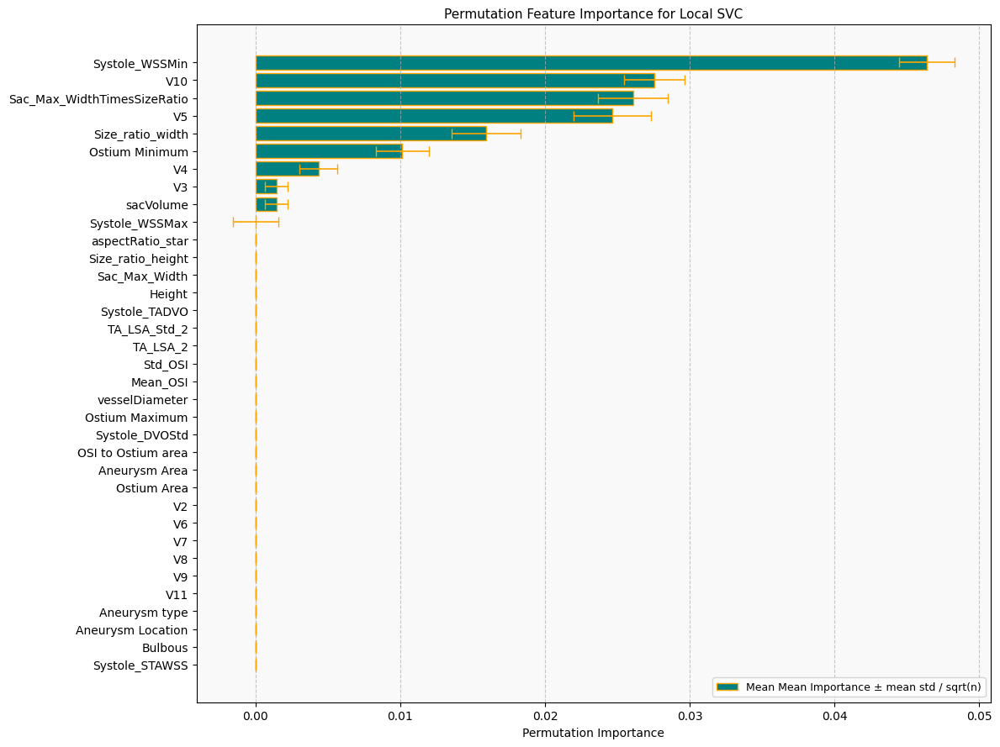

In [28]:
generate_feature_permutation_plots(models, X_test, y_test, "SVC")

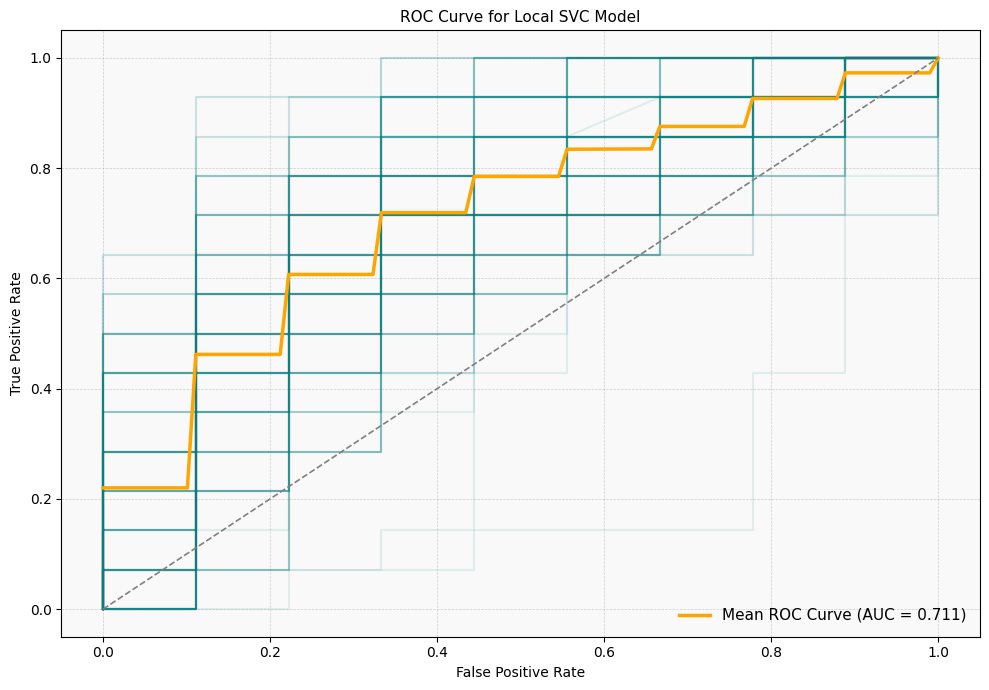

In [29]:
generate_roc_plots(roc_curves, metrics, "SVC")

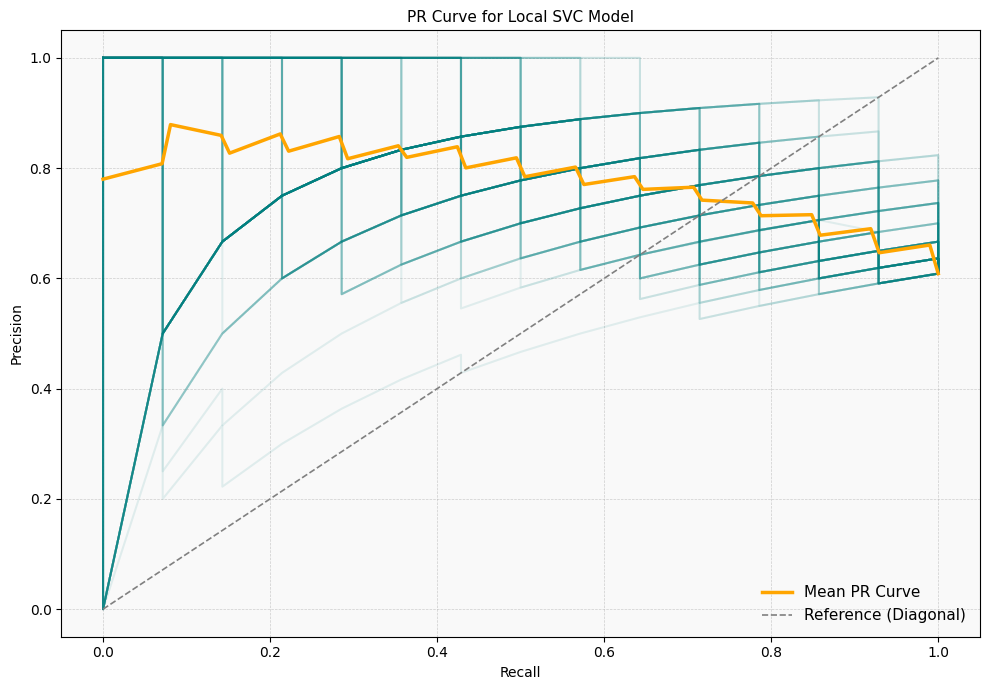

In [30]:
generate_pr_plots(precision_recall_curves, metrics, "SVC")

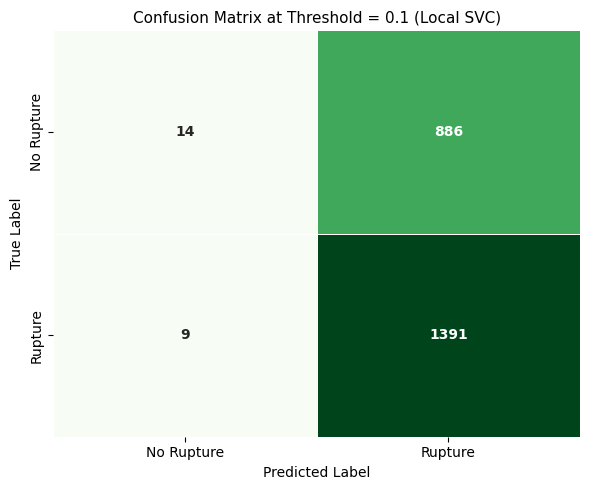

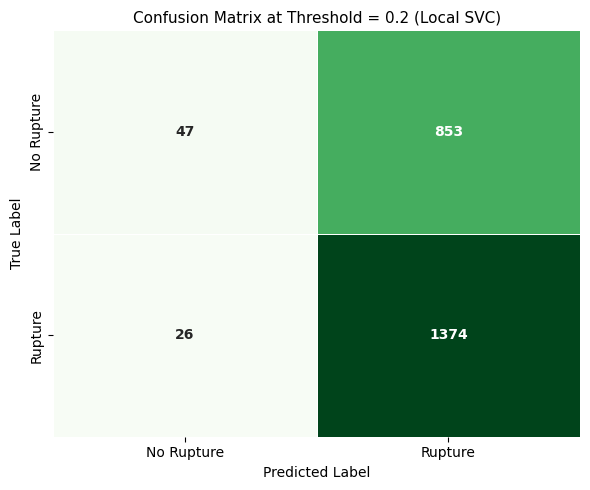

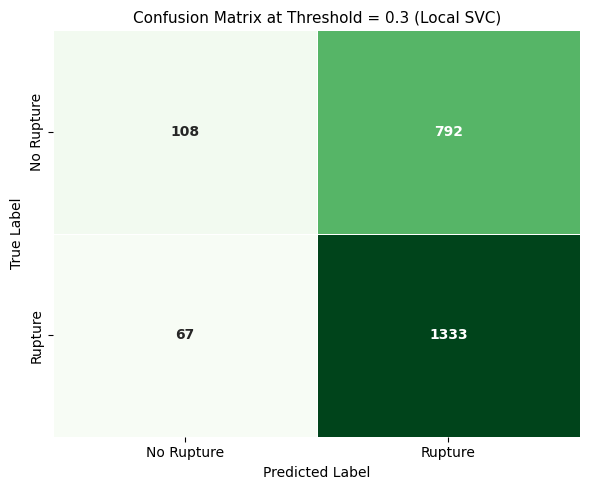

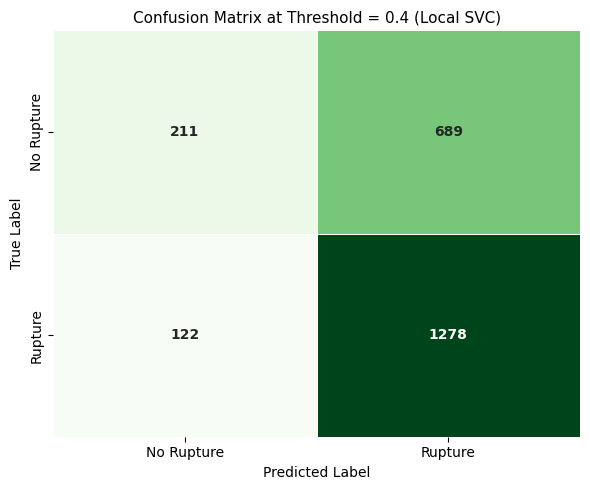

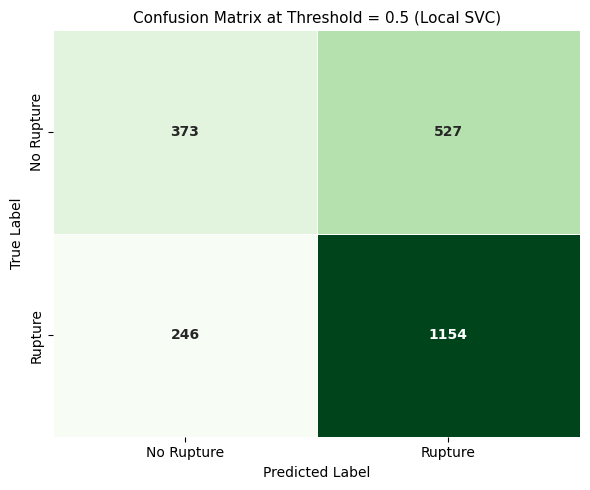

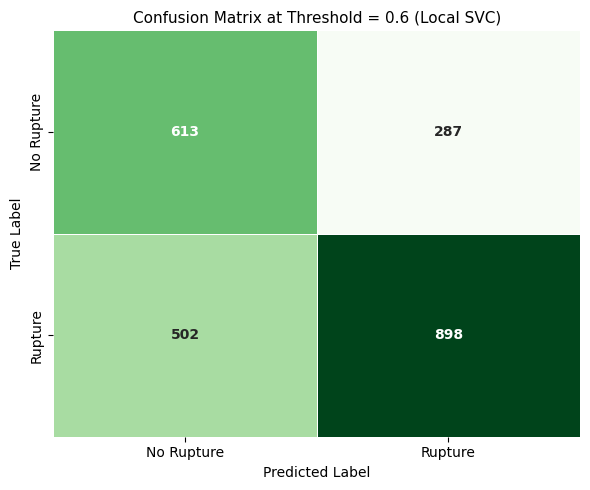

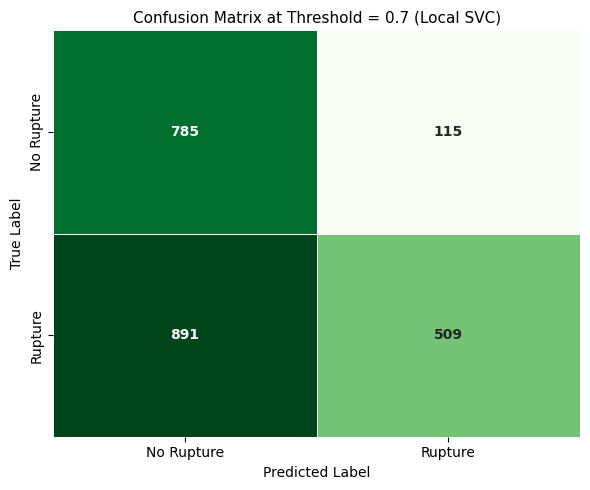

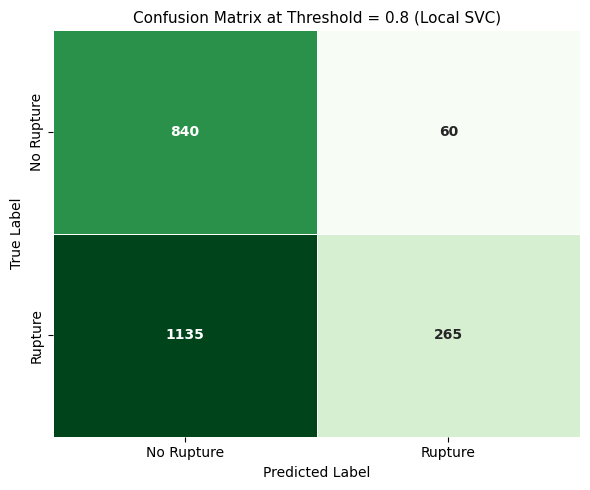

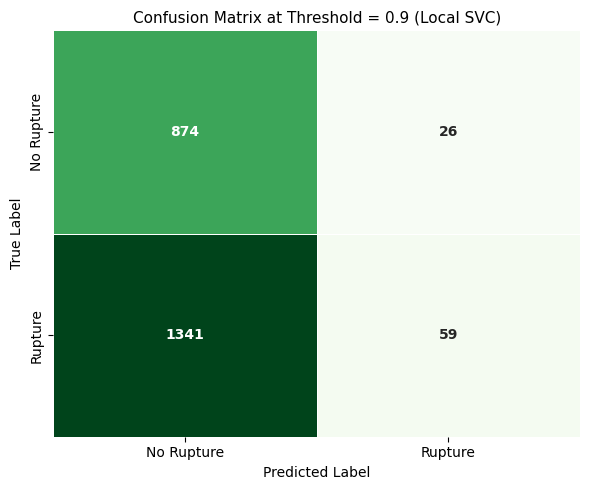

In [31]:
generate_confusian_matrix_plots(conf_matrices, "SVC") 

### Logistic Regression (LR)

In [32]:
df = load_dataset()
df.pop("Case")

0       C0001_dicom
1       C0002_dicom
2             C0010
3             C0006
4             C0007
5             C0014
6             C0016
7             C0019
8             C0020
9        CH_case087
10           UM_003
11           UM_007
12           UM_009
13           UM_013
14           UM_015
15            C0057
16            C0060
17            C0055
18            C0024
19            C0026
20      C0049_dicom
21           C0028b
22            C0030
23            C0033
24            C0034
25      C0035_dicom
26      C0036_dicom
27            C0063
28            C0064
29      C0039_dicom
30      C0040_dicom
31      C0041_dicom
32      C0042_dicom
33      C0044_dicom
34            C0045
35            C0046
36            C0066
37            C0067
38            C0069
39            C0071
40            C0072
41     C0074a_dicom
42      C0075_dicom
43      C0076_dicom
44            C0078
45            C0079
46            C0086
47            C0089
48            C0090
49            C0093


### Previous Codebase's

In [33]:
import pandas as pd
import numpy as np 
import time
import csv

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier

def test_LR(num_iters, features, labels):    

    AUC_score = np.zeros(num_iters) 
    Accuracy_score = np.zeros(num_iters) 
    Precision_score = np.zeros(num_iters) 
    Recall_score = np.zeros(num_iters) 
    F1_score = np.zeros(num_iters)     

    for i in range(num_iters):
    
        #--get splits and best params
        np.random.RandomState(seed=1)
        t0 = time.time()                
        x_train,x_test,y_train,y_test=train_test_split(features,labels,test_size=0.1,random_state=i,stratify=labels)     
        lr=LogisticRegression(verbose=0)        
        PARAMETERS = {
             'solver': ['liblinear','lbfgs'],
             'C':[0.5,1,1.5,2,2.5,5],
             'penalty':['l1','l2'],
             'class_weight':['balanced'],
             #'multi_class': ['ovr', 'multinomial'],
             'max_iter':[100,200,300,500],
            }       
        grid = GridSearchCV(lr, param_grid=PARAMETERS, scoring='neg_log_loss', cv=10, verbose=0)#neg_log_loss,roc_auc
        grid.fit(x_train,y_train)
        y_pred=grid.predict(x_test)
            
        #--Get ROC-AUC Score
        Accuracy_score[i] = accuracy_score(y_test,y_pred)        
        AUC_score[i] = roc_auc_score(y_test, y_pred) #--Choose macro, micro etc. See Docs
        Precision_score[i] = precision_score(y_test,y_pred)
        Recall_score[i] = recall_score(y_test,y_pred)
        F1_score[i] = f1_score(y_test,y_pred)
        

        print("Iteration:", i, "Accuracy_Score:%.4f" % float(Accuracy_score[i]), "Predictions:", y_pred) 
    
    print("-------------------------")               
    print("Accuracy Score: %.4f" % np.mean(Accuracy_score))
    print("AUC Score: %.4f" % np.mean(AUC_score))
    print("Precision Score: %.4f" % np.mean(Precision_score))
    print("Recall Score: %.4f" % np.mean(Recall_score))
    print("F1 Score: %.4f" % np.mean(F1_score))
    print("-------------------------")  

train_cols_t = ['Aneurysm Location', 'Aneurysm type', 'Systole_STAWSS',
       'Systole_WSSMin', 'Systole_WSSMax', 'Mean_OSI', 'Std_OSI', 'TA_LSA_2',
       'TA_LSA_Std_2', 'Bulbous', 'sacVolume', 'Height', 'Sac_Max_Width',
       'Size_ratio_height', 'Size_ratio_width', 'aspectRatio_star',
       'vesselDiameter', 'Systole_TADVO', 'Systole_DVOStd', 'Ostium Minimum',
       'Ostium Maximum', 'Aneurysm Area', 'Ostium Area', 'V2', 'V3', 'V4',
       'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']
X_train_temp = df[train_cols_t].copy()
test_LR(50, X_train_temp, df[["ruptureStatus"]].copy())

Iteration: 0 Accuracy_Score:0.6667 Predictions: [0 1 1 0 0 0 1 1 1 0 1 1]
Iteration: 1 Accuracy_Score:0.5833 Predictions: [0 1 1 1 0 1 0 0 1 0 0 1]
Iteration: 2 Accuracy_Score:0.6667 Predictions: [1 1 1 0 1 1 1 1 1 1 1 1]
Iteration: 3 Accuracy_Score:0.7500 Predictions: [1 1 0 0 1 1 1 1 0 0 1 1]
Iteration: 4 Accuracy_Score:0.5833 Predictions: [0 1 1 1 1 1 0 1 1 1 1 1]
Iteration: 5 Accuracy_Score:0.7500 Predictions: [1 0 1 0 1 1 0 1 0 0 0 1]
Iteration: 6 Accuracy_Score:0.6667 Predictions: [1 0 0 0 0 1 1 1 0 1 0 0]
Iteration: 7 Accuracy_Score:0.7500 Predictions: [1 0 1 1 1 1 1 1 1 0 1 1]
Iteration: 8 Accuracy_Score:0.5833 Predictions: [0 1 0 1 1 0 0 0 0 0 0 1]
Iteration: 9 Accuracy_Score:0.4167 Predictions: [1 1 1 1 0 0 1 1 1 1 1 1]
Iteration: 10 Accuracy_Score:0.6667 Predictions: [0 1 1 1 1 0 1 1 0 0 0 1]
Iteration: 11 Accuracy_Score:0.6667 Predictions: [1 1 0 0 0 0 1 1 1 1 1 0]
Iteration: 12 Accuracy_Score:0.8333 Predictions: [1 0 1 0 0 1 1 1 0 1 1 0]
Iteration: 13 Accuracy_Score:0.7500

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REA

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REA

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REA

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REA

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REA

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REA

Iteration: 0 Accuracy_Score:0.6667 Predictions: [0 1 1 0 0 0 1 1 1 0 1 1]


/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REA

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d

### Ours

In [34]:
#############################################
# Identify columns and create dataframe  #
#############################################
standardized_num_features = df.columns.tolist()
categorical = ["Aneurysm type", "Aneurysm Location", "Bulbous"]
[standardized_num_features.remove(cat) for cat in categorical]
standardized_num_features.remove("ruptureStatus")

target_col = "ruptureStatus"
selected_features = standardized_num_features + categorical

X = df[selected_features].copy()

# feature scaling
X["Ostium Area"] = X["Ostium Area"]**(1/2.0)
X["Aneurysm Area"] = X["Aneurysm Area"]**(1/2.0)
X["sacVolume"] = X["sacVolume"]**(1/3.0)

# feature combos
X["OSI to Ostium area"] = X["Mean_OSI"] / (X["Ostium Area"]**2)
X["Sac_Max_WidthTimesSizeRatio"] = X["Sac_Max_Width"]*X["Size_ratio_width"]
standardized_num_features.append("OSI to Ostium area")
standardized_num_features.append("Sac_Max_WidthTimesSizeRatio")
selected_features = standardized_num_features + categorical

y = df[target_col].copy()

# Convert to numeric, coerce errors to NaN
for col in standardized_num_features:
    X[col] = pd.to_numeric(X[col], errors="coerce")


#############################################
# Perform 100 Iterations with Random Splits #
#############################################

n_splits = 100
test_scores = []
precisions = []
recalls = []
specificities = []
sensitivities = []
auc_scores = []
roc_curves = []
precision_recall_curves = []
conf_matrices = [[] for i in range(1, 10)] # different matrix for thresholds 0.1, ..., 0.9
f1s = []

from scipy.stats import t
def compute_confidence_interval(metric_list, confidence=0.95):
    metric_list = np.array(metric_list)
    n = len(metric_list)
    mean_val = np.mean(metric_list)
    std_err = np.std(metric_list, ddof=1) / np.sqrt(n)
    ci = t.interval(confidence, df=n-1, loc=mean_val, scale=std_err)
    return mean_val, ci, std_err

import optuna

sss = StratifiedShuffleSplit(n_splits=n_splits, test_size=0.2, random_state=42)
it = 1

biggest_model_id_existing = 0
for i in range(1, n_splits+1):
    dir_path = "./aneurysm_models_trained_locally/lr"
    model_filename = f"model{i}.joblib"
    if os.path.exists(os.path.join(dir_path, model_filename)):
        biggest_model_id_existing += 1
    else:
        break

models = list(joblib.Parallel(n_jobs=-1)(
    joblib.delayed(joblib.load)(f"./aneurysm_models_trained_locally/svc/model{i}.joblib") for i in range(1, biggest_model_id_existing+1)
))

splits_it = 1
train_idxs = []
test_idxs = []
if os.path.exists("./aneurysm_models_trained_locally/lr/splits/"):
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/lr/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/lr/splits/test{splits_it}.npy"))
        splits_it += 1
else:
    os.makedirs("./aneurysm_models_trained_locally/lr/splits/")
    for train_idx, test_idx in sss.split(X,y):
        np.save(f"./aneurysm_models_trained_locally/lr/splits/training{splits_it}.npy", train_idx)
        np.save(f"./aneurysm_models_trained_locally/lr/splits/test{splits_it}.npy", test_idx)
        splits_it += 1
    splits_it = 1
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/lr/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/lr/splits/test{splits_it}.npy"))
        splits_it += 1
            
for train_idx, test_idx in list(zip(train_idxs, test_idxs)):
    dir_path = "./aneurysm_models_trained_locally/lr"
    model_filename = f"model{it}.joblib"
    print(f"Running iteration {it}")
    X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
    y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
    
    if not os.path.exists(os.path.join(dir_path, model_filename)):
        def objective(trial):
            preprocessor = ColumnTransformer([
                ("stand_nums",
                 Pipeline([
                     ("imputer", SimpleImputer(strategy="median")),
                     ("scaler", StandardScaler())
                 ]),
                 standardized_num_features
                ),
                ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
            ])
    
            pipeline = Pipeline([
                ("preprocessor", preprocessor),
                ("classifier", LogisticRegression(solver=trial.suggest_categorical('S', ['liblinear','lbfgs']), C=trial.suggest_float('C', 1e-3, 1e3, log=True), penalty='l2', max_iter=trial.suggest_int('MI', 2, 100), class_weight="balanced"))
            ])
            
            val_aucs = []
            train_aucs = []
    
            cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=6789)
            for train_idx, val_idx in cv.split(X_train, y_train):
                X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
                y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]
    
                pipeline.fit(X_tr, y_tr)
    
                y_val_pred = pipeline.predict_proba(X_val)[:, 1]
                y_tr_pred = pipeline.predict_proba(X_tr)[:, 1]
    
                val_auc = roc_auc_score(y_val, y_val_pred)
                train_auc = roc_auc_score(y_tr, y_tr_pred)
    
                val_aucs.append(val_auc)
                train_aucs.append(train_auc)
    
            mean_val_auc = np.mean(val_aucs)
            mean_train_auc = np.mean(train_aucs)
            auc_diff = np.mean(np.abs(np.array(val_aucs) - np.array(train_auc)))  # Overfitting penalty
    
            return mean_val_auc - 0.1*auc_diff
    
        study_name = "LR" + str(int(time.time() * 1000))
        optuna.create_study(
            study_name=study_name, 
            directions=['maximize'], # Optimization directions
            sampler=TPESampler(seed=42), # Use the NSGAIII sampler
            pruner=MedianPruner(n_startup_trials=10, n_min_trials=2), # Use the MedianPruner
            load_if_exists=True, # Load study if it exists
            storage='mysql://root@localhost/optuna' # Save the study in SQLite
        )
    
        from concurrent.futures import ThreadPoolExecutor
        def run_optuna_study(study_name):
            study = optuna.load_study(
                study_name=study_name, storage="mysql://root@localhost/optuna"
            )
            study.optimize(objective, n_trials=5)
            
        with ThreadPoolExecutor(max_workers=16) as executor:
            res = []
            for i in range(16):
                res.append(executor.submit(run_optuna_study, study_name))
            for r in res:
                r.result()
    
        best_params = optuna.load_study(
            study_name=study_name, storage="mysql://root@localhost/optuna"
        ).best_params
        
        preprocessor = ColumnTransformer([
            ("stand_nums",
             Pipeline([
                 ("imputer", SimpleImputer(strategy="median")),
                 ("scaler", StandardScaler())
             ]),
             standardized_num_features
            ),
            ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
        ])
    
        pipeline = Pipeline([
            ("preprocessor", preprocessor),
            ("classifier", LogisticRegression(solver=best_params['S'], C=best_params['C'], penalty='l2', max_iter=best_params['MI'], class_weight="balanced"))
        ])
    
        pipeline.fit(X_train, y_train)
        best_model = pipeline
        models.append(best_model)

        # save model
        os.makedirs(dir_path, exist_ok=True)
        joblib.dump(models[-1], os.path.join(dir_path, model_filename))
    else:
        pipeline = joblib.load(os.path.join(dir_path, model_filename))
        best_model = pipeline
    
    # Accuracy
    y_pred = best_model.predict(X_test)
    test_score = accuracy_score(y_test, y_pred)
    test_scores.append(test_score)
    
    # Precision & Recall
    precision = precision_score(y_test, y_pred, average="binary")  # Adjust if multiclass
    recall = recall_score(y_test, y_pred, average="binary")
    precisions.append(precision)
    recalls.append(recall)
    f1s.append(2.0*precision*recall / (precision + recall))
    
    # Sensitivity & Specificity
    cm = confusion_matrix(y_test, y_pred)
    tn, fp, fn, tp = cm.ravel()  # Extract TP, TN, FP, FN
    specificity = tn / (tn + fp) if (tn + fp) != 0 else 0
    sensitivity = tp / (tp + fn) if (tp + fn) != 0 else 0
    specificities.append(specificity)
    sensitivities.append(sensitivity)
    
    test_score = best_model.score(X_test, y_test)
    test_scores.append(test_score)
    
    # Get predicted probabilities for ROC curve
    y_scores = best_model.decision_function(X_test)
    
    fpr, tpr, _ = roc_curve(y_test, y_scores)
    roc_curves.append((fpr, tpr))
    auc_score = auc(fpr, tpr)
    auc_scores.append(auc_score)

    precision_recall_curves.append(precision_recall_curve(y_test, best_model.predict_proba(X_test)[:, 1]))

    # Confusion Matrix
    for k in range(len(conf_matrices)):
        y_pred = (best_model.predict_proba(X_test)[:, 1] > 0.1*(k+1)).astype(int)
        conf_matrices[k].append(confusion_matrix(y_test, y_pred))


    it += 1


# Compute all metric statistics
metrics = {
    "Accuracy": compute_confidence_interval(test_scores),
    "Precision": compute_confidence_interval(precisions),
    "Recall (Sensitivity)": compute_confidence_interval(recalls),
    "Specificity": compute_confidence_interval(specificities),
    "AUC (Area Under ROC)": compute_confidence_interval(auc_scores),
    "F1 Score": compute_confidence_interval(f1s),
}

# Print results
for metric_name, (mean_val, (ci_lower, ci_upper), std) in metrics.items():
    print(f"{metric_name}: {mean_val:.4f}/{std:.4f} (95% CI: {ci_lower:.4f}, {ci_upper:.4f})")

Running iteration 1


[I 2025-04-07 06:33:28,533] A new study created in RDB with name: LR1744022008476
[I 2025-04-07 06:33:34,292] Trial 0 finished with value: 0.7334870129870129 and parameters: {'S': 'liblinear', 'C': 0.02873756180284146, 'MI': 78}. Best is trial 0 with value: 0.7334870129870129.
[I 2025-04-07 06:33:34,312] Trial 1 finished with value: 0.6606363636363636 and parameters: {'S': 'liblinear', 'C': 1.8977515747828886, 'MI': 73}. Best is trial 0 with value: 0.7334870129870129.
[I 2025-04-07 06:33:34,690] Trial 5 finished with value: 0.6342857142857141 and parameters: {'S': 'liblinear', 'C': 806.1350471346283, 'MI': 100}. Best is trial 0 with value: 0.7334870129870129.
[I 2025-04-07 06:33:34,760] Trial 4 finished with value: 0.6993441558441559 and parameters: {'S': 'liblinear', 'C': 0.18637051387566736, 'MI': 44}. Best is trial 0 with value: 0.7334870129870129.
[I 2025-04-07 06:33:34,784] Trial 11 finished with value: 0.6285714285714286 and parameters: {'S': 'liblinear', 'C': 857.9737083689834, 

Running iteration 2


[I 2025-04-07 06:34:06,175] Trial 0 finished with value: 0.5782857142857142 and parameters: {'S': 'liblinear', 'C': 159.1921441940204, 'MI': 49}. Best is trial 0 with value: 0.5782857142857142.
[I 2025-04-07 06:34:06,469] Trial 1 finished with value: 0.6945162337662337 and parameters: {'S': 'liblinear', 'C': 0.4898336242227912, 'MI': 81}. Best is trial 1 with value: 0.6945162337662337.
[I 2025-04-07 06:34:07,174] Trial 2 finished with value: 0.7136103896103897 and parameters: {'S': 'liblinear', 'C': 0.25890130611421386, 'MI': 17}. Best is trial 2 with value: 0.7136103896103897.
[I 2025-04-07 06:34:07,335] Trial 5 finished with value: 0.6370162337662337 and parameters: {'S': 'liblinear', 'C': 4.741716056272798, 'MI': 61}. Best is trial 10 with value: 0.7409025974025976.
[I 2025-04-07 06:34:07,430] Trial 7 finished with value: 0.7408214285714287 and parameters: {'S': 'liblinear', 'C': 0.01506240704303716, 'MI': 48}. Best is trial 10 with value: 0.7409025974025976.
[I 2025-04-07 06:34:07,

Running iteration 3


[I 2025-04-07 06:34:34,436] Trial 0 finished with value: 0.7667272727272727 and parameters: {'S': 'liblinear', 'C': 0.06658323427081489, 'MI': 53}. Best is trial 0 with value: 0.7667272727272727.
[I 2025-04-07 06:34:34,696] Trial 1 finished with value: 0.7624707792207792 and parameters: {'S': 'lbfgs', 'C': 0.02688831408689282, 'MI': 97}. Best is trial 0 with value: 0.7667272727272727.
[I 2025-04-07 06:34:35,198] Trial 2 finished with value: 0.7651461038961038 and parameters: {'S': 'liblinear', 'C': 0.12553836443241456, 'MI': 54}. Best is trial 0 with value: 0.7667272727272727.
[I 2025-04-07 06:34:35,568] Trial 5 finished with value: 0.7696753246753247 and parameters: {'S': 'lbfgs', 'C': 0.004823614303298287, 'MI': 57}. Best is trial 5 with value: 0.7696753246753247.
[I 2025-04-07 06:34:35,887] Trial 6 finished with value: 0.7687564935064937 and parameters: {'S': 'liblinear', 'C': 0.8720607943588724, 'MI': 65}. Best is trial 5 with value: 0.7696753246753247.
[I 2025-04-07 06:34:35,912] 

Running iteration 4


[I 2025-04-07 06:35:04,515] Trial 0 finished with value: 0.7507954545454546 and parameters: {'S': 'lbfgs', 'C': 0.0020161833599717264, 'MI': 72}. Best is trial 0 with value: 0.7507954545454546.
[I 2025-04-07 06:35:04,822] Trial 1 finished with value: 0.6428571428571429 and parameters: {'S': 'liblinear', 'C': 45.40675219745927, 'MI': 47}. Best is trial 0 with value: 0.7507954545454546.
[I 2025-04-07 06:35:04,872] Trial 2 finished with value: 0.6790487012987012 and parameters: {'S': 'lbfgs', 'C': 2.831977324135872, 'MI': 23}. Best is trial 0 with value: 0.7507954545454546.
[I 2025-04-07 06:35:04,879] Trial 5 finished with value: 0.6822694805194804 and parameters: {'S': 'lbfgs', 'C': 1.9558907621068136, 'MI': 38}. Best is trial 0 with value: 0.7507954545454546.
[I 2025-04-07 06:35:05,057] Trial 3 finished with value: 0.7507792207792208 and parameters: {'S': 'lbfgs', 'C': 0.0022123530846614465, 'MI': 66}. Best is trial 13 with value: 0.7619415584415584.
[I 2025-04-07 06:35:05,172] Trial 4 

Running iteration 5


[I 2025-04-07 06:35:38,422] Trial 0 finished with value: 0.6786396103896104 and parameters: {'S': 'liblinear', 'C': 6.074456600770846, 'MI': 3}. Best is trial 1 with value: 0.7025551948051948.
[I 2025-04-07 06:35:38,831] Trial 1 finished with value: 0.7025551948051948 and parameters: {'S': 'liblinear', 'C': 2.2218287324499117, 'MI': 54}. Best is trial 1 with value: 0.7025551948051948.
[I 2025-04-07 06:35:39,120] Trial 3 finished with value: 0.6854642857142856 and parameters: {'S': 'liblinear', 'C': 14.937760372044496, 'MI': 71}. Best is trial 1 with value: 0.7025551948051948.
[I 2025-04-07 06:35:39,438] Trial 5 finished with value: 0.6868571428571429 and parameters: {'S': 'liblinear', 'C': 53.14141936072807, 'MI': 14}. Best is trial 1 with value: 0.7025551948051948.
[I 2025-04-07 06:35:39,555] Trial 11 finished with value: 0.684853896103896 and parameters: {'S': 'liblinear', 'C': 17.911855289550683, 'MI': 73}. Best is trial 6 with value: 0.7290227272727273.
[I 2025-04-07 06:35:39,676] 

Running iteration 6


[I 2025-04-07 06:36:13,544] Trial 2 finished with value: 0.6372922077922077 and parameters: {'S': 'liblinear', 'C': 2.75222399187396, 'MI': 59}. Best is trial 1 with value: 0.7285064935064935.
[I 2025-04-07 06:36:13,580] Trial 1 finished with value: 0.7285064935064935 and parameters: {'S': 'lbfgs', 'C': 0.08745336625327729, 'MI': 52}. Best is trial 1 with value: 0.7285064935064935.
[I 2025-04-07 06:36:13,903] Trial 0 finished with value: 0.6598733766233765 and parameters: {'S': 'lbfgs', 'C': 58.99590691858112, 'MI': 16}. Best is trial 6 with value: 0.7313636363636364.
[I 2025-04-07 06:36:13,991] Trial 6 finished with value: 0.7313636363636364 and parameters: {'S': 'liblinear', 'C': 0.0884121839664214, 'MI': 82}. Best is trial 6 with value: 0.7313636363636364.
[I 2025-04-07 06:36:14,230] Trial 3 finished with value: 0.7238474025974027 and parameters: {'S': 'liblinear', 'C': 0.014635150508915026, 'MI': 33}. Best is trial 4 with value: 0.7326363636363635.
[I 2025-04-07 06:36:14,323] Trial

Running iteration 7


[I 2025-04-07 06:36:41,294] Trial 0 finished with value: 0.7590227272727273 and parameters: {'S': 'lbfgs', 'C': 0.35827888103697847, 'MI': 99}. Best is trial 0 with value: 0.7590227272727273.
[I 2025-04-07 06:36:41,671] Trial 2 finished with value: 0.7252954545454545 and parameters: {'S': 'liblinear', 'C': 4.84789347600841, 'MI': 95}. Best is trial 1 with value: 0.7885746753246753.
[I 2025-04-07 06:36:41,910] Trial 1 finished with value: 0.7885746753246753 and parameters: {'S': 'liblinear', 'C': 0.002387674990502134, 'MI': 89}. Best is trial 1 with value: 0.7885746753246753.
[I 2025-04-07 06:36:42,402] Trial 6 finished with value: 0.7885584415584415 and parameters: {'S': 'liblinear', 'C': 0.002489034902974365, 'MI': 13}. Best is trial 1 with value: 0.7885746753246753.
[I 2025-04-07 06:36:42,504] Trial 8 finished with value: 0.7346785714285714 and parameters: {'S': 'lbfgs', 'C': 2.92161242184679, 'MI': 45}. Best is trial 1 with value: 0.7885746753246753.
[I 2025-04-07 06:36:42,527] Tria

Running iteration 8


[I 2025-04-07 06:37:08,067] Trial 0 finished with value: 0.6906785714285716 and parameters: {'S': 'lbfgs', 'C': 0.13031031439672586, 'MI': 65}. Best is trial 0 with value: 0.6906785714285716.
[I 2025-04-07 06:37:08,387] Trial 4 finished with value: 0.7297564935064935 and parameters: {'S': 'liblinear', 'C': 0.0038254072957590065, 'MI': 56}. Best is trial 4 with value: 0.7297564935064935.
[I 2025-04-07 06:37:08,431] Trial 13 finished with value: 0.5894285714285715 and parameters: {'S': 'liblinear', 'C': 95.17464162746376, 'MI': 60}. Best is trial 4 with value: 0.7297564935064935.
[I 2025-04-07 06:37:08,444] Trial 2 finished with value: 0.6011428571428572 and parameters: {'S': 'liblinear', 'C': 670.2977900046383, 'MI': 27}. Best is trial 4 with value: 0.7297564935064935.
[I 2025-04-07 06:37:08,464] Trial 1 finished with value: 0.5897954545454547 and parameters: {'S': 'lbfgs', 'C': 54.2395233957184, 'MI': 65}. Best is trial 4 with value: 0.7297564935064935.
[I 2025-04-07 06:37:08,478] Tria

Running iteration 9


[I 2025-04-07 06:37:33,509] Trial 0 finished with value: 0.6838733766233768 and parameters: {'S': 'lbfgs', 'C': 0.00235316484055983, 'MI': 26}. Best is trial 0 with value: 0.6838733766233768.
[I 2025-04-07 06:37:33,837] Trial 6 finished with value: 0.6841948051948051 and parameters: {'S': 'lbfgs', 'C': 80.5412267843164, 'MI': 13}. Best is trial 5 with value: 0.698396103896104.
[I 2025-04-07 06:37:34,211] Trial 8 finished with value: 0.648448051948052 and parameters: {'S': 'liblinear', 'C': 43.644681025841635, 'MI': 5}. Best is trial 2 with value: 0.7075389610389611.
[I 2025-04-07 06:37:34,242] Trial 4 finished with value: 0.6354285714285713 and parameters: {'S': 'liblinear', 'C': 425.9156696875616, 'MI': 79}. Best is trial 2 with value: 0.7075389610389611.
[I 2025-04-07 06:37:34,247] Trial 5 finished with value: 0.698396103896104 and parameters: {'S': 'lbfgs', 'C': 55.18690010498453, 'MI': 10}. Best is trial 2 with value: 0.7075389610389611.
[I 2025-04-07 06:37:34,300] Trial 2 finished

Running iteration 10


[I 2025-04-07 06:38:09,578] Trial 0 finished with value: 0.6594285714285715 and parameters: {'S': 'lbfgs', 'C': 0.5253209847719688, 'MI': 3}. Best is trial 0 with value: 0.6594285714285715.
[I 2025-04-07 06:38:09,890] Trial 2 finished with value: 0.700301948051948 and parameters: {'S': 'liblinear', 'C': 0.019686723923027855, 'MI': 71}. Best is trial 2 with value: 0.700301948051948.
[I 2025-04-07 06:38:10,232] Trial 5 finished with value: 0.6825616883116883 and parameters: {'S': 'lbfgs', 'C': 46.84161689545976, 'MI': 13}. Best is trial 2 with value: 0.700301948051948.
[I 2025-04-07 06:38:10,573] Trial 4 finished with value: 0.6875454545454546 and parameters: {'S': 'lbfgs', 'C': 0.006122792353067482, 'MI': 12}. Best is trial 2 with value: 0.700301948051948.
[I 2025-04-07 06:38:10,635] Trial 1 finished with value: 0.675711038961039 and parameters: {'S': 'lbfgs', 'C': 5.648824186793589, 'MI': 35}. Best is trial 2 with value: 0.700301948051948.
[I 2025-04-07 06:38:10,705] Trial 3 finished w

Running iteration 11


[I 2025-04-07 06:38:44,405] Trial 3 finished with value: 0.7201980519480519 and parameters: {'S': 'liblinear', 'C': 5.097168975229158, 'MI': 88}. Best is trial 2 with value: 0.7614383116883116.
[I 2025-04-07 06:38:44,472] Trial 2 finished with value: 0.7614383116883116 and parameters: {'S': 'lbfgs', 'C': 0.5541370389726604, 'MI': 47}. Best is trial 2 with value: 0.7614383116883116.
[I 2025-04-07 06:38:44,535] Trial 6 finished with value: 0.7602857142857142 and parameters: {'S': 'liblinear', 'C': 0.2791558667889349, 'MI': 74}. Best is trial 2 with value: 0.7614383116883116.
[I 2025-04-07 06:38:44,628] Trial 0 finished with value: 0.7094285714285714 and parameters: {'S': 'lbfgs', 'C': 756.8231519105769, 'MI': 40}. Best is trial 2 with value: 0.7614383116883116.
[I 2025-04-07 06:38:44,647] Trial 9 finished with value: 0.7541006493506495 and parameters: {'S': 'liblinear', 'C': 1.043607004580668, 'MI': 17}. Best is trial 2 with value: 0.7614383116883116.
[I 2025-04-07 06:38:44,698] Trial 5 

Running iteration 12


[I 2025-04-07 06:39:12,305] Trial 0 finished with value: 0.7813668831168832 and parameters: {'S': 'liblinear', 'C': 0.022327376939732895, 'MI': 57}. Best is trial 0 with value: 0.7813668831168832.
[I 2025-04-07 06:39:12,729] Trial 8 finished with value: 0.6674285714285715 and parameters: {'S': 'liblinear', 'C': 119.5607019059291, 'MI': 70}. Best is trial 0 with value: 0.7813668831168832.
[I 2025-04-07 06:39:12,811] Trial 3 finished with value: 0.6625292207792208 and parameters: {'S': 'liblinear', 'C': 220.36564313413973, 'MI': 4}. Best is trial 0 with value: 0.7813668831168832.
[I 2025-04-07 06:39:12,973] Trial 2 finished with value: 0.6719935064935065 and parameters: {'S': 'liblinear', 'C': 7.150777077172831, 'MI': 85}. Best is trial 0 with value: 0.7813668831168832.
[I 2025-04-07 06:39:13,029] Trial 4 finished with value: 0.6806590909090909 and parameters: {'S': 'lbfgs', 'C': 0.6770382469303556, 'MI': 78}. Best is trial 0 with value: 0.7813668831168832.
[I 2025-04-07 06:39:13,051] Tr

Running iteration 13


[I 2025-04-07 06:39:41,559] Trial 0 finished with value: 0.7191168831168832 and parameters: {'S': 'lbfgs', 'C': 0.007122366606525341, 'MI': 28}. Best is trial 0 with value: 0.7191168831168832.
[I 2025-04-07 06:39:41,719] Trial 1 finished with value: 0.6708961038961038 and parameters: {'S': 'liblinear', 'C': 9.19950805470641, 'MI': 32}. Best is trial 0 with value: 0.7191168831168832.
[I 2025-04-07 06:39:42,305] Trial 3 finished with value: 0.67 and parameters: {'S': 'lbfgs', 'C': 8.412679899511527, 'MI': 3}. Best is trial 0 with value: 0.7191168831168832.
[I 2025-04-07 06:39:42,648] Trial 7 finished with value: 0.719198051948052 and parameters: {'S': 'liblinear', 'C': 0.007145685261848707, 'MI': 13}. Best is trial 7 with value: 0.719198051948052.
[I 2025-04-07 06:39:42,787] Trial 2 finished with value: 0.6814935064935066 and parameters: {'S': 'lbfgs', 'C': 0.11472372313897865, 'MI': 24}. Best is trial 7 with value: 0.719198051948052.
[I 2025-04-07 06:39:42,813] Trial 6 finished with val

Running iteration 14


[I 2025-04-07 06:40:07,896] Trial 0 finished with value: 0.6154285714285713 and parameters: {'S': 'liblinear', 'C': 120.0638119871554, 'MI': 11}. Best is trial 0 with value: 0.6154285714285713.
[I 2025-04-07 06:40:08,638] Trial 1 finished with value: 0.7197532467532467 and parameters: {'S': 'lbfgs', 'C': 0.047658006877214526, 'MI': 86}. Best is trial 1 with value: 0.7197532467532467.
[I 2025-04-07 06:40:09,352] Trial 2 finished with value: 0.706788961038961 and parameters: {'S': 'liblinear', 'C': 0.06398869154731422, 'MI': 89}. Best is trial 1 with value: 0.7197532467532467.
[I 2025-04-07 06:40:09,588] Trial 3 finished with value: 0.7066428571428571 and parameters: {'S': 'lbfgs', 'C': 0.07003808191099203, 'MI': 95}. Best is trial 6 with value: 0.7281753246753248.
[I 2025-04-07 06:40:09,614] Trial 5 finished with value: 0.6235097402597403 and parameters: {'S': 'lbfgs', 'C': 13.101755787752184, 'MI': 69}. Best is trial 6 with value: 0.7281753246753248.
[I 2025-04-07 06:40:09,641] Trial 4

Running iteration 15


[I 2025-04-07 06:40:37,768] Trial 1 finished with value: 0.7907337662337663 and parameters: {'S': 'liblinear', 'C': 0.002493261651710259, 'MI': 80}. Best is trial 1 with value: 0.7907337662337663.
[I 2025-04-07 06:40:37,923] Trial 0 finished with value: 0.6973863636363636 and parameters: {'S': 'lbfgs', 'C': 2.4578035515891816, 'MI': 87}. Best is trial 1 with value: 0.7907337662337663.
[I 2025-04-07 06:40:39,096] Trial 4 finished with value: 0.6057142857142856 and parameters: {'S': 'liblinear', 'C': 868.5804797595401, 'MI': 100}. Best is trial 1 with value: 0.7907337662337663.
[I 2025-04-07 06:40:39,385] Trial 2 finished with value: 0.7426266233766234 and parameters: {'S': 'lbfgs', 'C': 0.13503783346455567, 'MI': 69}. Best is trial 1 with value: 0.7907337662337663.
[I 2025-04-07 06:40:39,395] Trial 7 finished with value: 0.7877045454545455 and parameters: {'S': 'liblinear', 'C': 0.0014003950428635263, 'MI': 93}. Best is trial 1 with value: 0.7907337662337663.
[I 2025-04-07 06:40:39,410]

Running iteration 16


[I 2025-04-07 06:41:07,496] Trial 0 finished with value: 0.774172077922078 and parameters: {'S': 'liblinear', 'C': 0.0012341594643887346, 'MI': 76}. Best is trial 0 with value: 0.774172077922078.
[I 2025-04-07 06:41:08,361] Trial 4 finished with value: 0.6911428571428572 and parameters: {'S': 'liblinear', 'C': 144.93593938917817, 'MI': 14}. Best is trial 0 with value: 0.774172077922078.
[I 2025-04-07 06:41:08,632] Trial 5 finished with value: 0.6713051948051949 and parameters: {'S': 'lbfgs', 'C': 17.87830124756957, 'MI': 30}. Best is trial 7 with value: 0.7764512987012987.
[I 2025-04-07 06:41:08,643] Trial 3 finished with value: 0.6751428571428572 and parameters: {'S': 'lbfgs', 'C': 964.2771668699615, 'MI': 43}. Best is trial 7 with value: 0.7764512987012987.
[I 2025-04-07 06:41:08,656] Trial 2 finished with value: 0.7742272727272727 and parameters: {'S': 'lbfgs', 'C': 0.0142209534953519, 'MI': 53}. Best is trial 7 with value: 0.7764512987012987.
[I 2025-04-07 06:41:08,773] Trial 6 fin

Running iteration 17


[I 2025-04-07 06:41:34,866] Trial 1 finished with value: 0.7165746753246753 and parameters: {'S': 'liblinear', 'C': 0.01145606506730637, 'MI': 46}. Best is trial 1 with value: 0.7165746753246753.
[I 2025-04-07 06:41:35,133] Trial 2 finished with value: 0.7072500000000002 and parameters: {'S': 'liblinear', 'C': 0.01648901927722016, 'MI': 94}. Best is trial 1 with value: 0.7165746753246753.
[I 2025-04-07 06:41:35,317] Trial 0 finished with value: 0.6972759740259741 and parameters: {'S': 'lbfgs', 'C': 0.0611522334448719, 'MI': 97}. Best is trial 1 with value: 0.7165746753246753.
[I 2025-04-07 06:41:35,436] Trial 4 finished with value: 0.7052564935064934 and parameters: {'S': 'liblinear', 'C': 0.00651269859621159, 'MI': 100}. Best is trial 1 with value: 0.7165746753246753.
[I 2025-04-07 06:41:35,609] Trial 3 finished with value: 0.7053051948051947 and parameters: {'S': 'liblinear', 'C': 0.006088340373577491, 'MI': 23}. Best is trial 1 with value: 0.7165746753246753.
[I 2025-04-07 06:41:35,

Running iteration 18


[I 2025-04-07 06:42:02,606] Trial 3 finished with value: 0.6008571428571429 and parameters: {'S': 'liblinear', 'C': 173.99362675583154, 'MI': 89}. Best is trial 7 with value: 0.757538961038961.
[I 2025-04-07 06:42:02,621] Trial 1 finished with value: 0.6916623376623376 and parameters: {'S': 'liblinear', 'C': 3.2297499529850673, 'MI': 34}. Best is trial 7 with value: 0.757538961038961.
[I 2025-04-07 06:42:02,668] Trial 4 finished with value: 0.7451233766233767 and parameters: {'S': 'liblinear', 'C': 0.001809804185959958, 'MI': 56}. Best is trial 7 with value: 0.757538961038961.
[I 2025-04-07 06:42:02,685] Trial 6 finished with value: 0.7094967532467533 and parameters: {'S': 'liblinear', 'C': 1.6559005780678233, 'MI': 66}. Best is trial 7 with value: 0.757538961038961.
[I 2025-04-07 06:42:02,751] Trial 2 finished with value: 0.7451233766233767 and parameters: {'S': 'liblinear', 'C': 0.0014860103335292616, 'MI': 13}. Best is trial 7 with value: 0.757538961038961.
[I 2025-04-07 06:42:02,79

Running iteration 19


[I 2025-04-07 06:42:34,133] Trial 0 finished with value: 0.7456980519480519 and parameters: {'S': 'lbfgs', 'C': 0.0010832148533512413, 'MI': 42}. Best is trial 0 with value: 0.7456980519480519.
[I 2025-04-07 06:42:34,634] Trial 1 finished with value: 0.6502857142857142 and parameters: {'S': 'liblinear', 'C': 857.0306352727007, 'MI': 15}. Best is trial 0 with value: 0.7456980519480519.
[I 2025-04-07 06:42:34,767] Trial 2 finished with value: 0.6488571428571428 and parameters: {'S': 'lbfgs', 'C': 193.93621430693912, 'MI': 90}. Best is trial 0 with value: 0.7456980519480519.
[I 2025-04-07 06:42:35,430] Trial 3 finished with value: 0.7557142857142857 and parameters: {'S': 'lbfgs', 'C': 0.007107783591080715, 'MI': 67}. Best is trial 5 with value: 0.758922077922078.
[I 2025-04-07 06:42:35,516] Trial 10 finished with value: 0.6488571428571428 and parameters: {'S': 'liblinear', 'C': 693.4347887899548, 'MI': 24}. Best is trial 5 with value: 0.758922077922078.
[I 2025-04-07 06:42:35,519] Trial 4

Running iteration 20


[I 2025-04-07 06:43:04,107] Trial 0 finished with value: 0.6907824675324675 and parameters: {'S': 'lbfgs', 'C': 0.49890510255271775, 'MI': 3}. Best is trial 0 with value: 0.6907824675324675.
[I 2025-04-07 06:43:05,710] Trial 1 finished with value: 0.5779058441558441 and parameters: {'S': 'lbfgs', 'C': 37.528116287546176, 'MI': 20}. Best is trial 8 with value: 0.7651493506493506.
[I 2025-04-07 06:43:05,711] Trial 9 finished with value: 0.6060974025974025 and parameters: {'S': 'liblinear', 'C': 1.8649871545725833, 'MI': 69}. Best is trial 8 with value: 0.7651493506493506.
[I 2025-04-07 06:43:05,719] Trial 8 finished with value: 0.7651493506493506 and parameters: {'S': 'liblinear', 'C': 0.006084901579564595, 'MI': 14}. Best is trial 8 with value: 0.7651493506493506.
[I 2025-04-07 06:43:05,765] Trial 10 finished with value: 0.7033214285714285 and parameters: {'S': 'liblinear', 'C': 0.06459342823816096, 'MI': 35}. Best is trial 8 with value: 0.7651493506493506.
[I 2025-04-07 06:43:05,765] T

Running iteration 21


[I 2025-04-07 06:43:31,169] Trial 0 finished with value: 0.6494285714285715 and parameters: {'S': 'liblinear', 'C': 87.31084417700815, 'MI': 84}. Best is trial 1 with value: 0.6497142857142857.
[I 2025-04-07 06:43:31,487] Trial 1 finished with value: 0.6497142857142857 and parameters: {'S': 'liblinear', 'C': 143.7545866785297, 'MI': 32}. Best is trial 1 with value: 0.6497142857142857.
[I 2025-04-07 06:43:32,830] Trial 2 finished with value: 0.7097954545454546 and parameters: {'S': 'liblinear', 'C': 0.008678502234113305, 'MI': 60}. Best is trial 2 with value: 0.7097954545454546.
[I 2025-04-07 06:43:32,950] Trial 3 finished with value: 0.6878863636363637 and parameters: {'S': 'liblinear', 'C': 0.05771992567439215, 'MI': 42}. Best is trial 2 with value: 0.7097954545454546.
[I 2025-04-07 06:43:33,475] Trial 4 finished with value: 0.6846103896103898 and parameters: {'S': 'liblinear', 'C': 0.001098793690702531, 'MI': 39}. Best is trial 2 with value: 0.7097954545454546.
[I 2025-04-07 06:43:33

Running iteration 22


[I 2025-04-07 06:43:58,887] Trial 0 finished with value: 0.7604805194805195 and parameters: {'S': 'liblinear', 'C': 0.008796209260646694, 'MI': 83}. Best is trial 1 with value: 0.7654318181818182.
[I 2025-04-07 06:43:58,958] Trial 1 finished with value: 0.7654318181818182 and parameters: {'S': 'liblinear', 'C': 0.2959694133122778, 'MI': 38}. Best is trial 1 with value: 0.7654318181818182.
[I 2025-04-07 06:44:00,139] Trial 3 finished with value: 0.7617954545454546 and parameters: {'S': 'liblinear', 'C': 0.01914975624042001, 'MI': 5}. Best is trial 1 with value: 0.7654318181818182.
[I 2025-04-07 06:44:00,551] Trial 10 finished with value: 0.7599610389610391 and parameters: {'S': 'liblinear', 'C': 0.2613309217001351, 'MI': 100}. Best is trial 1 with value: 0.7654318181818182.
[I 2025-04-07 06:44:00,691] Trial 2 finished with value: 0.7584999999999998 and parameters: {'S': 'liblinear', 'C': 0.4128413040379003, 'MI': 24}. Best is trial 4 with value: 0.7749448051948052.
[I 2025-04-07 06:44:0

Running iteration 23


[I 2025-04-07 06:44:33,136] Trial 0 finished with value: 0.6259999999999999 and parameters: {'S': 'lbfgs', 'C': 132.87816279158196, 'MI': 54}. Best is trial 2 with value: 0.6955389610389612.
[I 2025-04-07 06:44:33,214] Trial 1 finished with value: 0.6236720779220779 and parameters: {'S': 'lbfgs', 'C': 20.708551127219422, 'MI': 91}. Best is trial 2 with value: 0.6955389610389612.
[I 2025-04-07 06:44:33,270] Trial 4 finished with value: 0.6173733766233767 and parameters: {'S': 'liblinear', 'C': 2.67621687043151, 'MI': 95}. Best is trial 2 with value: 0.6955389610389612.
[I 2025-04-07 06:44:33,401] Trial 5 finished with value: 0.6237532467532467 and parameters: {'S': 'liblinear', 'C': 18.28482359959532, 'MI': 60}. Best is trial 2 with value: 0.6955389610389612.
[I 2025-04-07 06:44:33,453] Trial 2 finished with value: 0.6955389610389612 and parameters: {'S': 'lbfgs', 'C': 0.12929386035830934, 'MI': 6}. Best is trial 2 with value: 0.6955389610389612.
[I 2025-04-07 06:44:33,468] Trial 3 fini

Running iteration 24


[I 2025-04-07 06:45:02,025] Trial 0 finished with value: 0.7665811688311689 and parameters: {'S': 'lbfgs', 'C': 0.0018688586550656065, 'MI': 29}. Best is trial 0 with value: 0.7665811688311689.
[I 2025-04-07 06:45:02,749] Trial 2 finished with value: 0.7466525974025975 and parameters: {'S': 'liblinear', 'C': 0.2254443949319007, 'MI': 15}. Best is trial 0 with value: 0.7665811688311689.
[I 2025-04-07 06:45:02,886] Trial 1 finished with value: 0.6886396103896104 and parameters: {'S': 'lbfgs', 'C': 16.659844532450485, 'MI': 12}. Best is trial 4 with value: 0.7697792207792207.
[I 2025-04-07 06:45:02,984] Trial 3 finished with value: 0.6845876623376623 and parameters: {'S': 'liblinear', 'C': 15.529697225049357, 'MI': 2}. Best is trial 6 with value: 0.7836461038961038.
[I 2025-04-07 06:45:03,019] Trial 7 finished with value: 0.7635162337662337 and parameters: {'S': 'lbfgs', 'C': 0.019767015095852054, 'MI': 95}. Best is trial 6 with value: 0.7836461038961038.
[I 2025-04-07 06:45:03,037] Trial

Running iteration 25


[I 2025-04-07 06:45:35,203] Trial 0 finished with value: 0.6734058441558441 and parameters: {'S': 'lbfgs', 'C': 1.6242717285828099, 'MI': 12}. Best is trial 0 with value: 0.6734058441558441.
[I 2025-04-07 06:45:35,337] Trial 3 finished with value: 0.5942857142857142 and parameters: {'S': 'lbfgs', 'C': 80.71351738902555, 'MI': 37}. Best is trial 0 with value: 0.6734058441558441.
[I 2025-04-07 06:45:35,635] Trial 2 finished with value: 0.6246850649350649 and parameters: {'S': 'liblinear', 'C': 8.743916310140422, 'MI': 53}. Best is trial 6 with value: 0.729801948051948.
[I 2025-04-07 06:45:35,708] Trial 6 finished with value: 0.729801948051948 and parameters: {'S': 'liblinear', 'C': 0.04289031412429729, 'MI': 58}. Best is trial 6 with value: 0.729801948051948.
[I 2025-04-07 06:45:35,783] Trial 1 finished with value: 0.612159090909091 and parameters: {'S': 'lbfgs', 'C': 13.785842914191411, 'MI': 50}. Best is trial 6 with value: 0.729801948051948.
[I 2025-04-07 06:45:35,896] Trial 5 finishe

Running iteration 26


[I 2025-04-07 06:46:04,539] Trial 0 finished with value: 0.757448051948052 and parameters: {'S': 'liblinear', 'C': 0.0013173907905060735, 'MI': 10}. Best is trial 0 with value: 0.757448051948052.
[I 2025-04-07 06:46:05,267] Trial 1 finished with value: 0.6464837662337662 and parameters: {'S': 'liblinear', 'C': 6.754722136037375, 'MI': 74}. Best is trial 0 with value: 0.757448051948052.
[I 2025-04-07 06:46:05,700] Trial 3 finished with value: 0.7625941558441559 and parameters: {'S': 'liblinear', 'C': 0.001741532733349066, 'MI': 9}. Best is trial 3 with value: 0.7625941558441559.
[I 2025-04-07 06:46:05,954] Trial 4 finished with value: 0.6492597402597403 and parameters: {'S': 'liblinear', 'C': 8.34962632455587, 'MI': 45}. Best is trial 3 with value: 0.7625941558441559.
[I 2025-04-07 06:46:06,097] Trial 5 finished with value: 0.7624740259740259 and parameters: {'S': 'lbfgs', 'C': 0.0031815642610969123, 'MI': 94}. Best is trial 3 with value: 0.7625941558441559.
[I 2025-04-07 06:46:06,237] 

Running iteration 27


[I 2025-04-07 06:46:35,046] Trial 0 finished with value: 0.6348733766233766 and parameters: {'S': 'liblinear', 'C': 0.07076404050641817, 'MI': 6}. Best is trial 0 with value: 0.6348733766233766.
[I 2025-04-07 06:46:35,786] Trial 3 finished with value: 0.6937142857142857 and parameters: {'S': 'liblinear', 'C': 789.1593757999514, 'MI': 5}. Best is trial 3 with value: 0.6937142857142857.
[I 2025-04-07 06:46:36,019] Trial 1 finished with value: 0.6292987012987012 and parameters: {'S': 'liblinear', 'C': 0.1732315288384664, 'MI': 81}. Best is trial 3 with value: 0.6937142857142857.
[I 2025-04-07 06:46:36,230] Trial 2 finished with value: 0.6128603896103896 and parameters: {'S': 'liblinear', 'C': 0.36438256140625813, 'MI': 9}. Best is trial 4 with value: 0.7054448051948052.
[I 2025-04-07 06:46:36,433] Trial 4 finished with value: 0.7054448051948052 and parameters: {'S': 'liblinear', 'C': 0.0012119914386866288, 'MI': 22}. Best is trial 4 with value: 0.7054448051948052.
[I 2025-04-07 06:46:36,4

Running iteration 28


[I 2025-04-07 06:47:01,637] Trial 0 finished with value: 0.6045714285714286 and parameters: {'S': 'liblinear', 'C': 792.5415673714149, 'MI': 52}. Best is trial 0 with value: 0.6045714285714286.
[I 2025-04-07 06:47:02,597] Trial 9 finished with value: 0.7664837662337662 and parameters: {'S': 'liblinear', 'C': 0.04782777890578629, 'MI': 94}. Best is trial 9 with value: 0.7664837662337662.
[I 2025-04-07 06:47:02,615] Trial 2 finished with value: 0.6045714285714286 and parameters: {'S': 'liblinear', 'C': 813.4880601304064, 'MI': 17}. Best is trial 9 with value: 0.7664837662337662.
[I 2025-04-07 06:47:02,628] Trial 3 finished with value: 0.6365714285714286 and parameters: {'S': 'lbfgs', 'C': 978.0651676712845, 'MI': 61}. Best is trial 9 with value: 0.7664837662337662.
[I 2025-04-07 06:47:02,644] Trial 1 finished with value: 0.7330162337662337 and parameters: {'S': 'liblinear', 'C': 0.0017014607792641561, 'MI': 20}. Best is trial 9 with value: 0.7664837662337662.
[I 2025-04-07 06:47:02,786] 

Running iteration 29


[I 2025-04-07 06:47:29,360] Trial 1 finished with value: 0.7592922077922077 and parameters: {'S': 'liblinear', 'C': 0.008895699301225574, 'MI': 97}. Best is trial 1 with value: 0.7592922077922077.
[I 2025-04-07 06:47:29,710] Trial 0 finished with value: 0.6902857142857142 and parameters: {'S': 'lbfgs', 'C': 10.098396905824279, 'MI': 58}. Best is trial 1 with value: 0.7592922077922077.
[I 2025-04-07 06:47:29,986] Trial 3 finished with value: 0.7680519480519481 and parameters: {'S': 'lbfgs', 'C': 0.011911512780215636, 'MI': 60}. Best is trial 3 with value: 0.7680519480519481.
[I 2025-04-07 06:47:30,024] Trial 2 finished with value: 0.7645811688311688 and parameters: {'S': 'lbfgs', 'C': 0.058775073284246915, 'MI': 29}. Best is trial 3 with value: 0.7680519480519481.
[I 2025-04-07 06:47:30,050] Trial 5 finished with value: 0.7595032467532468 and parameters: {'S': 'liblinear', 'C': 0.0063860284405177995, 'MI': 8}. Best is trial 3 with value: 0.7680519480519481.
[I 2025-04-07 06:47:30,124] T

Running iteration 30


[I 2025-04-07 06:47:57,327] Trial 0 finished with value: 0.6285714285714286 and parameters: {'S': 'liblinear', 'C': 942.5202792030861, 'MI': 41}. Best is trial 0 with value: 0.6285714285714286.
[I 2025-04-07 06:47:58,543] Trial 6 finished with value: 0.6552467532467533 and parameters: {'S': 'liblinear', 'C': 0.020005099806872755, 'MI': 93}. Best is trial 6 with value: 0.6552467532467533.
[I 2025-04-07 06:47:58,628] Trial 2 finished with value: 0.6448668831168831 and parameters: {'S': 'liblinear', 'C': 0.6540964583410813, 'MI': 18}. Best is trial 1 with value: 0.6554902597402598.
[I 2025-04-07 06:47:58,782] Trial 1 finished with value: 0.6554902597402598 and parameters: {'S': 'liblinear', 'C': 0.019339290878013466, 'MI': 28}. Best is trial 3 with value: 0.6647402597402599.
[I 2025-04-07 06:47:58,919] Trial 5 finished with value: 0.6383279220779221 and parameters: {'S': 'liblinear', 'C': 0.32889255250550214, 'MI': 41}. Best is trial 3 with value: 0.6647402597402599.
[I 2025-04-07 06:47:5

Running iteration 31


[I 2025-04-07 06:48:30,594] Trial 4 finished with value: 0.8170779220779221 and parameters: {'S': 'liblinear', 'C': 0.002965303225854732, 'MI': 63}. Best is trial 1 with value: 0.8395129870129872.
[I 2025-04-07 06:48:30,667] Trial 3 finished with value: 0.8306071428571428 and parameters: {'S': 'liblinear', 'C': 0.1434582654254417, 'MI': 2}. Best is trial 1 with value: 0.8395129870129872.
[I 2025-04-07 06:48:30,730] Trial 0 finished with value: 0.7637824675324675 and parameters: {'S': 'liblinear', 'C': 1.9009762171736526, 'MI': 90}. Best is trial 1 with value: 0.8395129870129872.
[I 2025-04-07 06:48:30,760] Trial 1 finished with value: 0.8395129870129872 and parameters: {'S': 'liblinear', 'C': 0.12640435296150734, 'MI': 97}. Best is trial 1 with value: 0.8395129870129872.
[I 2025-04-07 06:48:30,793] Trial 5 finished with value: 0.7489675324675326 and parameters: {'S': 'liblinear', 'C': 2.5300476869745054, 'MI': 75}. Best is trial 1 with value: 0.8395129870129872.
[I 2025-04-07 06:48:30,

Running iteration 32


[I 2025-04-07 06:48:59,139] Trial 0 finished with value: 0.7223344155844156 and parameters: {'S': 'liblinear', 'C': 0.0550169064431664, 'MI': 72}. Best is trial 0 with value: 0.7223344155844156.
[I 2025-04-07 06:49:00,045] Trial 2 finished with value: 0.7124967532467532 and parameters: {'S': 'lbfgs', 'C': 22.71899276703407, 'MI': 9}. Best is trial 0 with value: 0.7223344155844156.
[I 2025-04-07 06:49:00,057] Trial 1 finished with value: 0.6830487012987013 and parameters: {'S': 'lbfgs', 'C': 3.8529045389893977, 'MI': 84}. Best is trial 0 with value: 0.7223344155844156.
[I 2025-04-07 06:49:00,170] Trial 4 finished with value: 0.6978409090909092 and parameters: {'S': 'lbfgs', 'C': 0.540349953594571, 'MI': 43}. Best is trial 0 with value: 0.7223344155844156.
[I 2025-04-07 06:49:00,292] Trial 13 finished with value: 0.7111623376623376 and parameters: {'S': 'liblinear', 'C': 0.1379770510122154, 'MI': 70}. Best is trial 0 with value: 0.7223344155844156.
[I 2025-04-07 06:49:00,491] Trial 3 fin

Running iteration 33


[I 2025-04-07 06:49:27,437] Trial 1 finished with value: 0.5902857142857143 and parameters: {'S': 'liblinear', 'C': 604.1277332929437, 'MI': 79}. Best is trial 0 with value: 0.6462597402597403.
[I 2025-04-07 06:49:27,649] Trial 2 finished with value: 0.5826006493506494 and parameters: {'S': 'lbfgs', 'C': 2.872947058582563, 'MI': 37}. Best is trial 6 with value: 0.6600876623376624.
[I 2025-04-07 06:49:27,654] Trial 0 finished with value: 0.6462597402597403 and parameters: {'S': 'lbfgs', 'C': 0.11404183452503833, 'MI': 23}. Best is trial 6 with value: 0.6600876623376624.
[I 2025-04-07 06:49:27,839] Trial 4 finished with value: 0.5822759740259741 and parameters: {'S': 'liblinear', 'C': 3.524310773145166, 'MI': 73}. Best is trial 5 with value: 0.6601850649350649.
[I 2025-04-07 06:49:27,857] Trial 6 finished with value: 0.6600876623376624 and parameters: {'S': 'lbfgs', 'C': 0.020790972299408784, 'MI': 87}. Best is trial 5 with value: 0.6601850649350649.
[I 2025-04-07 06:49:27,907] Trial 3 f

Running iteration 34


[I 2025-04-07 06:49:53,826] Trial 0 finished with value: 0.7108344155844155 and parameters: {'S': 'liblinear', 'C': 0.002522839181768677, 'MI': 5}. Best is trial 0 with value: 0.7108344155844155.
[I 2025-04-07 06:49:54,764] Trial 3 finished with value: 0.6114025974025974 and parameters: {'S': 'liblinear', 'C': 1.2544183483166813, 'MI': 38}. Best is trial 0 with value: 0.7108344155844155.
[I 2025-04-07 06:49:54,910] Trial 5 finished with value: 0.6203409090909091 and parameters: {'S': 'liblinear', 'C': 1.0740376544785635, 'MI': 7}. Best is trial 0 with value: 0.7108344155844155.
[I 2025-04-07 06:49:54,945] Trial 7 finished with value: 0.6917922077922078 and parameters: {'S': 'lbfgs', 'C': 0.006605082575493935, 'MI': 24}. Best is trial 0 with value: 0.7108344155844155.
[I 2025-04-07 06:49:54,950] Trial 2 finished with value: 0.7055162337662337 and parameters: {'S': 'liblinear', 'C': 0.0013538772253191046, 'MI': 54}. Best is trial 0 with value: 0.7108344155844155.
[I 2025-04-07 06:49:55,3

Running iteration 35


[I 2025-04-07 06:50:23,658] Trial 1 finished with value: 0.5947954545454546 and parameters: {'S': 'liblinear', 'C': 92.8144793121141, 'MI': 34}. Best is trial 1 with value: 0.5947954545454546.
[I 2025-04-07 06:50:24,066] Trial 2 finished with value: 0.7501688311688312 and parameters: {'S': 'lbfgs', 'C': 0.00283051075408406, 'MI': 96}. Best is trial 2 with value: 0.7501688311688312.
[I 2025-04-07 06:50:24,450] Trial 3 finished with value: 0.745025974025974 and parameters: {'S': 'liblinear', 'C': 0.03317528457397311, 'MI': 33}. Best is trial 2 with value: 0.7501688311688312.
[I 2025-04-07 06:50:24,659] Trial 4 finished with value: 0.6921168831168831 and parameters: {'S': 'lbfgs', 'C': 0.21072607453167133, 'MI': 60}. Best is trial 2 with value: 0.7501688311688312.
[I 2025-04-07 06:50:24,808] Trial 5 finished with value: 0.5920000000000001 and parameters: {'S': 'liblinear', 'C': 469.82584941995015, 'MI': 57}. Best is trial 2 with value: 0.7501688311688312.
[I 2025-04-07 06:50:24,835] Trial

Running iteration 36


[I 2025-04-07 06:50:57,389] Trial 0 finished with value: 0.6953474025974027 and parameters: {'S': 'lbfgs', 'C': 0.006439690121756276, 'MI': 79}. Best is trial 0 with value: 0.6953474025974027.
[I 2025-04-07 06:50:57,736] Trial 1 finished with value: 0.6740974025974027 and parameters: {'S': 'lbfgs', 'C': 1.7276498454263312, 'MI': 52}. Best is trial 0 with value: 0.6953474025974027.
[I 2025-04-07 06:50:57,761] Trial 2 finished with value: 0.6330259740259739 and parameters: {'S': 'liblinear', 'C': 0.42872914905708365, 'MI': 100}. Best is trial 0 with value: 0.6953474025974027.
[I 2025-04-07 06:50:58,087] Trial 4 finished with value: 0.6791428571428572 and parameters: {'S': 'liblinear', 'C': 165.9022718549208, 'MI': 39}. Best is trial 13 with value: 0.7067045454545455.
[I 2025-04-07 06:50:58,128] Trial 3 finished with value: 0.6521168831168831 and parameters: {'S': 'liblinear', 'C': 0.21732543457666648, 'MI': 64}. Best is trial 13 with value: 0.7067045454545455.
[I 2025-04-07 06:50:58,309]

Running iteration 37


[I 2025-04-07 06:51:29,639] Trial 0 finished with value: 0.7448831168831168 and parameters: {'S': 'lbfgs', 'C': 1.2429380943455328, 'MI': 82}. Best is trial 0 with value: 0.7448831168831168.
[I 2025-04-07 06:51:29,659] Trial 1 finished with value: 0.7380324675324677 and parameters: {'S': 'lbfgs', 'C': 2.604119972427156, 'MI': 40}. Best is trial 0 with value: 0.7448831168831168.
[I 2025-04-07 06:51:29,827] Trial 9 finished with value: 0.7214285714285714 and parameters: {'S': 'liblinear', 'C': 100.4072180858487, 'MI': 76}. Best is trial 10 with value: 0.8086785714285714.
[I 2025-04-07 06:51:29,887] Trial 4 finished with value: 0.7948993506493506 and parameters: {'S': 'lbfgs', 'C': 0.009411907003645407, 'MI': 94}. Best is trial 10 with value: 0.8086785714285714.
[I 2025-04-07 06:51:29,952] Trial 7 finished with value: 0.7904707792207792 and parameters: {'S': 'lbfgs', 'C': 0.0014337627953790444, 'MI': 5}. Best is trial 10 with value: 0.8086785714285714.
[I 2025-04-07 06:51:29,984] Trial 10

Running iteration 38


[I 2025-04-07 06:52:01,213] Trial 0 finished with value: 0.6885227272727272 and parameters: {'S': 'liblinear', 'C': 1.524219063754087, 'MI': 10}. Best is trial 0 with value: 0.6885227272727272.
[I 2025-04-07 06:52:02,252] Trial 1 finished with value: 0.6937142857142857 and parameters: {'S': 'liblinear', 'C': 25.233172604447507, 'MI': 8}. Best is trial 6 with value: 0.7039480519480519.
[I 2025-04-07 06:52:02,462] Trial 7 finished with value: 0.6944058441558442 and parameters: {'S': 'lbfgs', 'C': 0.060637220734011975, 'MI': 14}. Best is trial 6 with value: 0.7039480519480519.
[I 2025-04-07 06:52:02,498] Trial 6 finished with value: 0.7039480519480519 and parameters: {'S': 'lbfgs', 'C': 0.0010245987748927284, 'MI': 8}. Best is trial 6 with value: 0.7039480519480519.
[I 2025-04-07 06:52:02,642] Trial 3 finished with value: 0.6912597402597402 and parameters: {'S': 'liblinear', 'C': 4.413117289933067, 'MI': 56}. Best is trial 6 with value: 0.7039480519480519.
[I 2025-04-07 06:52:02,662] Tria

Running iteration 39


[I 2025-04-07 06:52:32,485] Trial 0 finished with value: 0.6351428571428571 and parameters: {'S': 'liblinear', 'C': 27.552806250211596, 'MI': 91}. Best is trial 0 with value: 0.6351428571428571.
[I 2025-04-07 06:52:32,514] Trial 1 finished with value: 0.632448051948052 and parameters: {'S': 'liblinear', 'C': 747.0198000519116, 'MI': 3}. Best is trial 0 with value: 0.6351428571428571.
[I 2025-04-07 06:52:33,508] Trial 2 finished with value: 0.7039383116883117 and parameters: {'S': 'lbfgs', 'C': 3.224657816101103, 'MI': 4}. Best is trial 2 with value: 0.7039383116883117.
[I 2025-04-07 06:52:33,804] Trial 8 finished with value: 0.7492954545454545 and parameters: {'S': 'lbfgs', 'C': 0.10029457470437464, 'MI': 65}. Best is trial 4 with value: 0.7517727272727274.
[I 2025-04-07 06:52:33,900] Trial 6 finished with value: 0.6348571428571428 and parameters: {'S': 'lbfgs', 'C': 30.36653570225142, 'MI': 62}. Best is trial 4 with value: 0.7517727272727274.
[I 2025-04-07 06:52:33,918] Trial 5 finish

Running iteration 40


[I 2025-04-07 06:53:04,959] Trial 0 finished with value: 0.7097142857142857 and parameters: {'S': 'liblinear', 'C': 53.93625192778831, 'MI': 25}. Best is trial 0 with value: 0.7097142857142857.
[I 2025-04-07 06:53:05,808] Trial 1 finished with value: 0.7517954545454545 and parameters: {'S': 'liblinear', 'C': 0.0025626749115259264, 'MI': 69}. Best is trial 1 with value: 0.7517954545454545.
[I 2025-04-07 06:53:06,644] Trial 14 finished with value: 0.7094285714285715 and parameters: {'S': 'liblinear', 'C': 36.955799419021, 'MI': 23}. Best is trial 7 with value: 0.7518116883116883.
[I 2025-04-07 06:53:06,779] Trial 7 finished with value: 0.7518116883116883 and parameters: {'S': 'lbfgs', 'C': 0.0023431797683533383, 'MI': 62}. Best is trial 7 with value: 0.7518116883116883.
[I 2025-04-07 06:53:06,803] Trial 6 finished with value: 0.7182857142857142 and parameters: {'S': 'liblinear', 'C': 105.21245256810978, 'MI': 61}. Best is trial 7 with value: 0.7518116883116883.
[I 2025-04-07 06:53:06,849

Running iteration 41


[I 2025-04-07 06:53:32,776] Trial 0 finished with value: 0.5612207792207794 and parameters: {'S': 'liblinear', 'C': 7.565901876537057, 'MI': 33}. Best is trial 0 with value: 0.5612207792207794.
[I 2025-04-07 06:53:33,858] Trial 2 finished with value: 0.7071980519480519 and parameters: {'S': 'liblinear', 'C': 0.04538159246314594, 'MI': 96}. Best is trial 2 with value: 0.7071980519480519.
[I 2025-04-07 06:53:33,981] Trial 1 finished with value: 0.6567337662337661 and parameters: {'S': 'liblinear', 'C': 0.1755982326415034, 'MI': 50}. Best is trial 3 with value: 0.7269870129870131.
[I 2025-04-07 06:53:34,155] Trial 3 finished with value: 0.7269870129870131 and parameters: {'S': 'lbfgs', 'C': 0.0075535720128165965, 'MI': 10}. Best is trial 3 with value: 0.7269870129870131.
[I 2025-04-07 06:53:34,374] Trial 6 finished with value: 0.5297142857142857 and parameters: {'S': 'liblinear', 'C': 448.20416270199274, 'MI': 88}. Best is trial 3 with value: 0.7269870129870131.
[I 2025-04-07 06:53:34,656

Running iteration 42


[I 2025-04-07 06:54:06,129] Trial 0 finished with value: 0.631 and parameters: {'S': 'liblinear', 'C': 524.8335643748891, 'MI': 37}. Best is trial 0 with value: 0.631.
[I 2025-04-07 06:54:06,789] Trial 3 finished with value: 0.7121331168831169 and parameters: {'S': 'lbfgs', 'C': 0.1275973372036207, 'MI': 2}. Best is trial 3 with value: 0.7121331168831169.
[I 2025-04-07 06:54:07,016] Trial 2 finished with value: 0.6637402597402597 and parameters: {'S': 'lbfgs', 'C': 2.973463862307342, 'MI': 66}. Best is trial 4 with value: 0.7188344155844155.
[I 2025-04-07 06:54:07,030] Trial 1 finished with value: 0.6936103896103896 and parameters: {'S': 'lbfgs', 'C': 0.0025809147281345103, 'MI': 93}. Best is trial 4 with value: 0.7188344155844155.
[I 2025-04-07 06:54:07,129] Trial 4 finished with value: 0.7188344155844155 and parameters: {'S': 'lbfgs', 'C': 0.0394866161403787, 'MI': 80}. Best is trial 4 with value: 0.7188344155844155.
[I 2025-04-07 06:54:07,582] Trial 5 finished with value: 0.69982142

Running iteration 43


[I 2025-04-07 06:54:38,949] Trial 1 finished with value: 0.6934285714285714 and parameters: {'S': 'liblinear', 'C': 815.0795152111783, 'MI': 60}. Best is trial 2 with value: 0.7169318181818182.
[I 2025-04-07 06:54:39,076] Trial 2 finished with value: 0.7169318181818182 and parameters: {'S': 'liblinear', 'C': 4.076679180922325, 'MI': 35}. Best is trial 2 with value: 0.7169318181818182.
[I 2025-04-07 06:54:39,114] Trial 3 finished with value: 0.7036818181818181 and parameters: {'S': 'liblinear', 'C': 0.30964201158935073, 'MI': 23}. Best is trial 2 with value: 0.7169318181818182.
[I 2025-04-07 06:54:39,126] Trial 0 finished with value: 0.692 and parameters: {'S': 'liblinear', 'C': 488.8149399243705, 'MI': 85}. Best is trial 2 with value: 0.7169318181818182.
[I 2025-04-07 06:54:39,159] Trial 8 finished with value: 0.7121103896103894 and parameters: {'S': 'liblinear', 'C': 0.06619795594885368, 'MI': 99}. Best is trial 2 with value: 0.7169318181818182.
[I 2025-04-07 06:54:39,478] Trial 5 fin

Running iteration 44


[I 2025-04-07 06:55:04,775] Trial 2 finished with value: 0.7275422077922078 and parameters: {'S': 'lbfgs', 'C': 0.004815911697435427, 'MI': 58}. Best is trial 2 with value: 0.7275422077922078.
[I 2025-04-07 06:55:04,876] Trial 1 finished with value: 0.7019318181818182 and parameters: {'S': 'liblinear', 'C': 0.03471849926922061, 'MI': 35}. Best is trial 2 with value: 0.7275422077922078.
[I 2025-04-07 06:55:04,928] Trial 0 finished with value: 0.6270779220779222 and parameters: {'S': 'lbfgs', 'C': 206.17377342725476, 'MI': 11}. Best is trial 2 with value: 0.7275422077922078.
[I 2025-04-07 06:55:05,015] Trial 5 finished with value: 0.6397142857142857 and parameters: {'S': 'liblinear', 'C': 64.25819452155955, 'MI': 74}. Best is trial 2 with value: 0.7275422077922078.
[I 2025-04-07 06:55:05,074] Trial 3 finished with value: 0.6149220779220779 and parameters: {'S': 'liblinear', 'C': 2.7592279222006484, 'MI': 80}. Best is trial 2 with value: 0.7275422077922078.
[I 2025-04-07 06:55:05,377] Tri

Running iteration 45


[I 2025-04-07 06:55:35,116] Trial 0 finished with value: 0.7168571428571427 and parameters: {'S': 'liblinear', 'C': 45.249831784704256, 'MI': 70}. Best is trial 1 with value: 0.727568181818182.
[I 2025-04-07 06:55:35,293] Trial 1 finished with value: 0.727568181818182 and parameters: {'S': 'liblinear', 'C': 0.011236238193944386, 'MI': 44}. Best is trial 1 with value: 0.727568181818182.
[I 2025-04-07 06:55:36,003] Trial 6 finished with value: 0.728512987012987 and parameters: {'S': 'lbfgs', 'C': 0.0031177307314735623, 'MI': 100}. Best is trial 9 with value: 0.7438051948051948.
[I 2025-04-07 06:55:36,098] Trial 9 finished with value: 0.7438051948051948 and parameters: {'S': 'liblinear', 'C': 0.3796186171053854, 'MI': 75}. Best is trial 9 with value: 0.7438051948051948.
[I 2025-04-07 06:55:36,105] Trial 5 finished with value: 0.713840909090909 and parameters: {'S': 'lbfgs', 'C': 0.01661269596154393, 'MI': 37}. Best is trial 9 with value: 0.7438051948051948.
[I 2025-04-07 06:55:36,177] Tri

Running iteration 46


[I 2025-04-07 06:56:15,470] Trial 1 finished with value: 0.633922077922078 and parameters: {'S': 'liblinear', 'C': 0.16436525088818046, 'MI': 90}. Best is trial 1 with value: 0.633922077922078.
[I 2025-04-07 06:56:15,520] Trial 0 finished with value: 0.5610974025974026 and parameters: {'S': 'lbfgs', 'C': 10.049677130451448, 'MI': 76}. Best is trial 2 with value: 0.7171396103896104.
[I 2025-04-07 06:56:15,728] Trial 2 finished with value: 0.7171396103896104 and parameters: {'S': 'lbfgs', 'C': 0.025097319197290614, 'MI': 4}. Best is trial 5 with value: 0.7339610389610389.
[I 2025-04-07 06:56:15,895] Trial 5 finished with value: 0.7339610389610389 and parameters: {'S': 'lbfgs', 'C': 566.9902483415211, 'MI': 2}. Best is trial 5 with value: 0.7339610389610389.
[I 2025-04-07 06:56:15,938] Trial 4 finished with value: 0.5648474025974026 and parameters: {'S': 'liblinear', 'C': 6.343306459262284, 'MI': 3}. Best is trial 5 with value: 0.7339610389610389.
[I 2025-04-07 06:56:16,119] Trial 13 fini

Running iteration 47


[I 2025-04-07 06:56:45,029] Trial 0 finished with value: 0.71225 and parameters: {'S': 'liblinear', 'C': 1.3901157975252778, 'MI': 15}. Best is trial 0 with value: 0.71225.
[I 2025-04-07 06:56:46,459] Trial 2 finished with value: 0.6625292207792208 and parameters: {'S': 'liblinear', 'C': 56.28813725599619, 'MI': 20}. Best is trial 1 with value: 0.7291103896103897.
[I 2025-04-07 06:56:46,470] Trial 3 finished with value: 0.7165811688311687 and parameters: {'S': 'liblinear', 'C': 0.04201279609316501, 'MI': 61}. Best is trial 1 with value: 0.7291103896103897.
[I 2025-04-07 06:56:46,478] Trial 1 finished with value: 0.7291103896103897 and parameters: {'S': 'lbfgs', 'C': 28.07900985126523, 'MI': 11}. Best is trial 1 with value: 0.7291103896103897.
[I 2025-04-07 06:56:46,646] Trial 6 finished with value: 0.7056201298701299 and parameters: {'S': 'lbfgs', 'C': 258.8526621438422, 'MI': 18}. Best is trial 5 with value: 0.7389350649350649.
[I 2025-04-07 06:56:46,779] Trial 5 finished with value: 

Running iteration 48


[I 2025-04-07 06:57:18,630] Trial 0 finished with value: 0.7588571428571429 and parameters: {'S': 'lbfgs', 'C': 194.15506970184464, 'MI': 23}. Best is trial 0 with value: 0.7588571428571429.
[I 2025-04-07 06:57:18,878] Trial 2 finished with value: 0.7257142857142858 and parameters: {'S': 'liblinear', 'C': 570.0883647617002, 'MI': 79}. Best is trial 0 with value: 0.7588571428571429.
[I 2025-04-07 06:57:19,037] Trial 5 finished with value: 0.7516720779220779 and parameters: {'S': 'liblinear', 'C': 19.3690413240654, 'MI': 7}. Best is trial 1 with value: 0.7678798701298701.
[I 2025-04-07 06:57:19,105] Trial 1 finished with value: 0.7678798701298701 and parameters: {'S': 'lbfgs', 'C': 0.8749733831732394, 'MI': 2}. Best is trial 1 with value: 0.7678798701298701.
[I 2025-04-07 06:57:19,374] Trial 3 finished with value: 0.7109480519480519 and parameters: {'S': 'lbfgs', 'C': 0.18414489433918108, 'MI': 5}. Best is trial 1 with value: 0.7678798701298701.
[I 2025-04-07 06:57:19,544] Trial 4 finish

Running iteration 49


[I 2025-04-07 06:57:50,750] Trial 0 finished with value: 0.6994285714285714 and parameters: {'S': 'liblinear', 'C': 61.32310397709256, 'MI': 86}. Best is trial 0 with value: 0.6994285714285714.
[I 2025-04-07 06:57:51,517] Trial 2 finished with value: 0.6707727272727272 and parameters: {'S': 'lbfgs', 'C': 7.66675356499753, 'MI': 61}. Best is trial 5 with value: 0.7487792207792208.
[I 2025-04-07 06:57:51,640] Trial 1 finished with value: 0.6893993506493505 and parameters: {'S': 'lbfgs', 'C': 0.24451677736966965, 'MI': 49}. Best is trial 5 with value: 0.7487792207792208.
[I 2025-04-07 06:57:51,726] Trial 5 finished with value: 0.7487792207792208 and parameters: {'S': 'lbfgs', 'C': 0.0019261958695995576, 'MI': 2}. Best is trial 6 with value: 0.7503376623376624.
[I 2025-04-07 06:57:51,785] Trial 3 finished with value: 0.7123668831168831 and parameters: {'S': 'liblinear', 'C': 0.1195292714547259, 'MI': 85}. Best is trial 6 with value: 0.7503376623376624.
[I 2025-04-07 06:57:51,916] Trial 6 f

Running iteration 50


[I 2025-04-07 06:58:23,046] Trial 0 finished with value: 0.7310454545454546 and parameters: {'S': 'lbfgs', 'C': 0.2856158731977478, 'MI': 98}. Best is trial 0 with value: 0.7310454545454546.
[I 2025-04-07 06:58:23,769] Trial 1 finished with value: 0.6797142857142857 and parameters: {'S': 'liblinear', 'C': 271.2680776590039, 'MI': 55}. Best is trial 10 with value: 0.7648798701298701.
[I 2025-04-07 06:58:23,781] Trial 2 finished with value: 0.6822857142857143 and parameters: {'S': 'liblinear', 'C': 25.01422255140443, 'MI': 92}. Best is trial 10 with value: 0.7648798701298701.
[I 2025-04-07 06:58:23,859] Trial 5 finished with value: 0.7612435064935065 and parameters: {'S': 'lbfgs', 'C': 0.0042183754470228535, 'MI': 77}. Best is trial 7 with value: 0.7650487012987013.
[I 2025-04-07 06:58:23,860] Trial 10 finished with value: 0.7648798701298701 and parameters: {'S': 'lbfgs', 'C': 0.011109665559335114, 'MI': 60}. Best is trial 7 with value: 0.7650487012987013.
[I 2025-04-07 06:58:23,974] Tri

Running iteration 51


[I 2025-04-07 06:58:52,920] Trial 0 finished with value: 0.7574285714285713 and parameters: {'S': 'liblinear', 'C': 721.0720378039215, 'MI': 53}. Best is trial 0 with value: 0.7574285714285713.
[I 2025-04-07 06:58:53,547] Trial 3 finished with value: 0.7995032467532467 and parameters: {'S': 'lbfgs', 'C': 3.2317245406461135, 'MI': 57}. Best is trial 3 with value: 0.7995032467532467.
[I 2025-04-07 06:58:53,926] Trial 8 finished with value: 0.780974025974026 and parameters: {'S': 'lbfgs', 'C': 0.04144806834451305, 'MI': 65}. Best is trial 5 with value: 0.818883116883117.
[I 2025-04-07 06:58:53,958] Trial 2 finished with value: 0.7808571428571428 and parameters: {'S': 'liblinear', 'C': 44.23708609945792, 'MI': 6}. Best is trial 5 with value: 0.818883116883117.
[I 2025-04-07 06:58:53,971] Trial 1 finished with value: 0.7904025974025973 and parameters: {'S': 'lbfgs', 'C': 6.0107298257970845, 'MI': 90}. Best is trial 5 with value: 0.818883116883117.
[I 2025-04-07 06:58:53,990] Trial 11 finish

Running iteration 52


[I 2025-04-07 06:59:25,404] Trial 0 finished with value: 0.6100162337662338 and parameters: {'S': 'lbfgs', 'C': 159.07389469078004, 'MI': 9}. Best is trial 0 with value: 0.6100162337662338.
[I 2025-04-07 06:59:25,802] Trial 2 finished with value: 0.6035779220779219 and parameters: {'S': 'liblinear', 'C': 5.553056796293871, 'MI': 13}. Best is trial 1 with value: 0.6818084415584416.
[I 2025-04-07 06:59:26,185] Trial 1 finished with value: 0.6818084415584416 and parameters: {'S': 'lbfgs', 'C': 0.0016023727792971708, 'MI': 33}. Best is trial 1 with value: 0.6818084415584416.
[I 2025-04-07 06:59:26,214] Trial 8 finished with value: 0.6324058441558441 and parameters: {'S': 'lbfgs', 'C': 0.05678409731904101, 'MI': 12}. Best is trial 1 with value: 0.6818084415584416.
[I 2025-04-07 06:59:26,368] Trial 4 finished with value: 0.6337305194805195 and parameters: {'S': 'liblinear', 'C': 1.9280191263977413, 'MI': 2}. Best is trial 1 with value: 0.6818084415584416.
[I 2025-04-07 06:59:26,514] Trial 7 

Running iteration 53


[I 2025-04-07 06:59:56,720] Trial 1 finished with value: 0.6656720779220778 and parameters: {'S': 'liblinear', 'C': 0.2425510571233849, 'MI': 97}. Best is trial 1 with value: 0.6656720779220778.
[I 2025-04-07 06:59:57,080] Trial 2 finished with value: 0.6685681818181818 and parameters: {'S': 'lbfgs', 'C': 0.22292280807214332, 'MI': 16}. Best is trial 7 with value: 0.7169642857142858.
[I 2025-04-07 06:59:57,228] Trial 3 finished with value: 0.7022857142857142 and parameters: {'S': 'lbfgs', 'C': 598.3126471450865, 'MI': 66}. Best is trial 7 with value: 0.7169642857142858.
[I 2025-04-07 06:59:57,349] Trial 7 finished with value: 0.7169642857142858 and parameters: {'S': 'lbfgs', 'C': 0.0019294402783294644, 'MI': 56}. Best is trial 7 with value: 0.7169642857142858.
[I 2025-04-07 06:59:57,532] Trial 8 finished with value: 0.6729675324675325 and parameters: {'S': 'lbfgs', 'C': 0.11967450425992872, 'MI': 31}. Best is trial 7 with value: 0.7169642857142858.
[I 2025-04-07 06:59:57,813] Trial 4 f

Running iteration 54


[I 2025-04-07 07:00:27,610] Trial 0 finished with value: 0.7289383116883117 and parameters: {'S': 'liblinear', 'C': 16.662581228943417, 'MI': 47}. Best is trial 0 with value: 0.7289383116883117.
[I 2025-04-07 07:00:28,354] Trial 1 finished with value: 0.726 and parameters: {'S': 'liblinear', 'C': 59.179602270507864, 'MI': 96}. Best is trial 0 with value: 0.7289383116883117.
[I 2025-04-07 07:00:29,160] Trial 2 finished with value: 0.7120000000000001 and parameters: {'S': 'lbfgs', 'C': 163.66302205793048, 'MI': 48}. Best is trial 7 with value: 0.8007792207792209.
[I 2025-04-07 07:00:29,227] Trial 5 finished with value: 0.762935064935065 and parameters: {'S': 'lbfgs', 'C': 1.3438435369313393, 'MI': 98}. Best is trial 7 with value: 0.8007792207792209.
[I 2025-04-07 07:00:29,318] Trial 3 finished with value: 0.7317142857142858 and parameters: {'S': 'lbfgs', 'C': 19.807023494530753, 'MI': 71}. Best is trial 11 with value: 0.8015129870129871.
[I 2025-04-07 07:00:29,372] Trial 8 finished with 

Running iteration 55


[I 2025-04-07 07:00:55,690] Trial 1 finished with value: 0.6585616883116883 and parameters: {'S': 'liblinear', 'C': 0.007287860207553906, 'MI': 16}. Best is trial 1 with value: 0.6585616883116883.
[I 2025-04-07 07:00:56,388] Trial 3 finished with value: 0.6056590909090909 and parameters: {'S': 'lbfgs', 'C': 0.0558332617385635, 'MI': 50}. Best is trial 1 with value: 0.6585616883116883.
[I 2025-04-07 07:00:56,465] Trial 4 finished with value: 0.5472922077922078 and parameters: {'S': 'lbfgs', 'C': 2.999430815478305, 'MI': 89}. Best is trial 1 with value: 0.6585616883116883.
[I 2025-04-07 07:00:56,479] Trial 2 finished with value: 0.5357045454545455 and parameters: {'S': 'lbfgs', 'C': 0.38610715420622266, 'MI': 83}. Best is trial 1 with value: 0.6585616883116883.
[I 2025-04-07 07:00:56,608] Trial 0 finished with value: 0.6557954545454544 and parameters: {'S': 'lbfgs', 'C': 0.008444621364563977, 'MI': 4}. Best is trial 1 with value: 0.6585616883116883.
[I 2025-04-07 07:00:56,769] Trial 7 fi

Running iteration 56


[I 2025-04-07 07:01:21,604] A new study created in RDB with name: LR1744023681311
[I 2025-04-07 07:01:27,881] Trial 0 finished with value: 0.6448571428571429 and parameters: {'S': 'lbfgs', 'C': 89.82426746604905, 'MI': 31}. Best is trial 3 with value: 0.7236233766233766.
[I 2025-04-07 07:01:27,910] Trial 3 finished with value: 0.7236233766233766 and parameters: {'S': 'liblinear', 'C': 0.029454025216262215, 'MI': 84}. Best is trial 3 with value: 0.7236233766233766.
[I 2025-04-07 07:01:28,745] Trial 9 finished with value: 0.6365714285714286 and parameters: {'S': 'liblinear', 'C': 33.3521102199812, 'MI': 75}. Best is trial 3 with value: 0.7236233766233766.
[I 2025-04-07 07:01:28,749] Trial 2 finished with value: 0.6648571428571429 and parameters: {'S': 'lbfgs', 'C': 38.60273974938279, 'MI': 22}. Best is trial 3 with value: 0.7236233766233766.
[I 2025-04-07 07:01:28,755] Trial 6 finished with value: 0.7098181818181818 and parameters: {'S': 'lbfgs', 'C': 0.10266195092588683, 'MI': 69}. Best

Running iteration 57


[I 2025-04-07 07:01:58,464] Trial 0 finished with value: 0.7473636363636365 and parameters: {'S': 'liblinear', 'C': 0.39248137573963066, 'MI': 84}. Best is trial 0 with value: 0.7473636363636365.
[I 2025-04-07 07:01:59,448] Trial 4 finished with value: 0.6993441558441558 and parameters: {'S': 'liblinear', 'C': 3.0178609963397407, 'MI': 55}. Best is trial 0 with value: 0.7473636363636365.
[I 2025-04-07 07:01:59,763] Trial 3 finished with value: 0.6962857142857142 and parameters: {'S': 'liblinear', 'C': 66.32718083981172, 'MI': 8}. Best is trial 0 with value: 0.7473636363636365.
[I 2025-04-07 07:01:59,964] Trial 6 finished with value: 0.6874285714285713 and parameters: {'S': 'lbfgs', 'C': 5.609091498639791, 'MI': 69}. Best is trial 0 with value: 0.7473636363636365.
[I 2025-04-07 07:01:59,976] Trial 11 finished with value: 0.6962857142857142 and parameters: {'S': 'liblinear', 'C': 54.19806822214626, 'MI': 63}. Best is trial 0 with value: 0.7473636363636365.
[I 2025-04-07 07:02:00,016] Tri

Running iteration 58


[I 2025-04-07 07:02:28,791] Trial 1 finished with value: 0.7122824675324676 and parameters: {'S': 'liblinear', 'C': 6.244643026511802, 'MI': 64}. Best is trial 1 with value: 0.7122824675324676.
[I 2025-04-07 07:02:29,377] Trial 0 finished with value: 0.7186753246753246 and parameters: {'S': 'lbfgs', 'C': 0.9002728202078293, 'MI': 45}. Best is trial 3 with value: 0.7648474025974026.
[I 2025-04-07 07:02:29,491] Trial 3 finished with value: 0.7648474025974026 and parameters: {'S': 'liblinear', 'C': 0.09422177898808197, 'MI': 88}. Best is trial 3 with value: 0.7648474025974026.
[I 2025-04-07 07:02:29,797] Trial 4 finished with value: 0.7138668831168831 and parameters: {'S': 'lbfgs', 'C': 1.9536836023331328, 'MI': 41}. Best is trial 9 with value: 0.8067662337662338.
[I 2025-04-07 07:02:29,809] Trial 2 finished with value: 0.6962857142857142 and parameters: {'S': 'lbfgs', 'C': 379.00621307677443, 'MI': 60}. Best is trial 9 with value: 0.8067662337662338.
[I 2025-04-07 07:02:29,867] Trial 9 f

Running iteration 59


[I 2025-04-07 07:02:56,068] Trial 0 finished with value: 0.6839545454545456 and parameters: {'S': 'liblinear', 'C': 0.11400254293971882, 'MI': 29}. Best is trial 0 with value: 0.6839545454545456.
[I 2025-04-07 07:02:56,967] Trial 2 finished with value: 0.6945227272727272 and parameters: {'S': 'lbfgs', 'C': 3.6399270927964302, 'MI': 4}. Best is trial 2 with value: 0.6945227272727272.
[I 2025-04-07 07:02:57,124] Trial 4 finished with value: 0.5815909090909092 and parameters: {'S': 'liblinear', 'C': 60.66495656780707, 'MI': 50}. Best is trial 1 with value: 0.742288961038961.
[I 2025-04-07 07:02:57,324] Trial 6 finished with value: 0.7110324675324675 and parameters: {'S': 'liblinear', 'C': 0.0585617699301427, 'MI': 65}. Best is trial 1 with value: 0.742288961038961.
[I 2025-04-07 07:02:57,353] Trial 11 finished with value: 0.6562792207792207 and parameters: {'S': 'liblinear', 'C': 0.5211638875062782, 'MI': 27}. Best is trial 1 with value: 0.742288961038961.
[I 2025-04-07 07:02:57,353] Tria

Running iteration 60


[I 2025-04-07 07:03:29,396] Trial 1 finished with value: 0.634633116883117 and parameters: {'S': 'liblinear', 'C': 2.1033344210406333, 'MI': 76}. Best is trial 5 with value: 0.727474025974026.
[I 2025-04-07 07:03:29,429] Trial 5 finished with value: 0.727474025974026 and parameters: {'S': 'lbfgs', 'C': 98.88203329602669, 'MI': 2}. Best is trial 5 with value: 0.727474025974026.
[I 2025-04-07 07:03:29,707] Trial 3 finished with value: 0.5956298701298701 and parameters: {'S': 'liblinear', 'C': 73.61801052307709, 'MI': 14}. Best is trial 2 with value: 0.7362889610389611.
[I 2025-04-07 07:03:29,896] Trial 4 finished with value: 0.6434902597402598 and parameters: {'S': 'liblinear', 'C': 1.924878780098653, 'MI': 13}. Best is trial 2 with value: 0.7362889610389611.
[I 2025-04-07 07:03:29,911] Trial 0 finished with value: 0.6054285714285713 and parameters: {'S': 'lbfgs', 'C': 695.9652160098642, 'MI': 77}. Best is trial 2 with value: 0.7362889610389611.
[I 2025-04-07 07:03:30,011] Trial 2 finish

Running iteration 61


[I 2025-04-07 07:03:57,512] Trial 1 finished with value: 0.7149383116883117 and parameters: {'S': 'liblinear', 'C': 14.515757690245255, 'MI': 99}. Best is trial 0 with value: 0.7217142857142858.
[I 2025-04-07 07:03:57,619] Trial 0 finished with value: 0.7217142857142858 and parameters: {'S': 'liblinear', 'C': 56.55345165407476, 'MI': 48}. Best is trial 0 with value: 0.7217142857142858.
[I 2025-04-07 07:03:57,729] Trial 4 finished with value: 0.7217142857142858 and parameters: {'S': 'liblinear', 'C': 166.7587517958051, 'MI': 64}. Best is trial 0 with value: 0.7217142857142858.
[I 2025-04-07 07:03:58,187] Trial 2 finished with value: 0.7655032467532468 and parameters: {'S': 'lbfgs', 'C': 0.005950406442196648, 'MI': 86}. Best is trial 2 with value: 0.7655032467532468.
[I 2025-04-07 07:03:58,237] Trial 8 finished with value: 0.7654058441558441 and parameters: {'S': 'liblinear', 'C': 0.006411235845582275, 'MI': 40}. Best is trial 2 with value: 0.7655032467532468.
[I 2025-04-07 07:03:58,296]

Running iteration 62


[I 2025-04-07 07:04:26,385] Trial 0 finished with value: 0.642409090909091 and parameters: {'S': 'liblinear', 'C': 0.03357895950683917, 'MI': 13}. Best is trial 0 with value: 0.642409090909091.
[I 2025-04-07 07:04:26,597] Trial 1 finished with value: 0.6191428571428571 and parameters: {'S': 'liblinear', 'C': 609.4122517862606, 'MI': 74}. Best is trial 0 with value: 0.642409090909091.
[I 2025-04-07 07:04:26,916] Trial 2 finished with value: 0.6254285714285716 and parameters: {'S': 'liblinear', 'C': 137.87277182458328, 'MI': 71}. Best is trial 0 with value: 0.642409090909091.
[I 2025-04-07 07:04:27,009] Trial 5 finished with value: 0.6220000000000001 and parameters: {'S': 'liblinear', 'C': 515.262282520714, 'MI': 12}. Best is trial 0 with value: 0.642409090909091.
[I 2025-04-07 07:04:27,116] Trial 3 finished with value: 0.6220779220779222 and parameters: {'S': 'lbfgs', 'C': 0.24410754364102305, 'MI': 96}. Best is trial 0 with value: 0.642409090909091.
[I 2025-04-07 07:04:27,136] Trial 4 

Running iteration 63


[I 2025-04-07 07:04:53,814] Trial 1 finished with value: 0.6570519480519481 and parameters: {'S': 'lbfgs', 'C': 0.2782448735535967, 'MI': 3}. Best is trial 1 with value: 0.6570519480519481.
[I 2025-04-07 07:04:54,103] Trial 0 finished with value: 0.60575 and parameters: {'S': 'lbfgs', 'C': 5.372020989565145, 'MI': 87}. Best is trial 1 with value: 0.6570519480519481.
[I 2025-04-07 07:04:54,484] Trial 3 finished with value: 0.6437142857142857 and parameters: {'S': 'liblinear', 'C': 0.04835079347924666, 'MI': 77}. Best is trial 1 with value: 0.6570519480519481.
[I 2025-04-07 07:04:54,618] Trial 5 finished with value: 0.5998344155844156 and parameters: {'S': 'liblinear', 'C': 11.948665737886554, 'MI': 4}. Best is trial 1 with value: 0.6570519480519481.
[I 2025-04-07 07:04:54,887] Trial 2 finished with value: 0.6116980519480519 and parameters: {'S': 'lbfgs', 'C': 0.5141582970526124, 'MI': 83}. Best is trial 9 with value: 0.6651915584415584.
[I 2025-04-07 07:04:54,936] Trial 10 finished with

Running iteration 64


[I 2025-04-07 07:05:22,772] Trial 0 finished with value: 0.7601915584415585 and parameters: {'S': 'liblinear', 'C': 0.009218760763333772, 'MI': 100}. Best is trial 0 with value: 0.7601915584415585.
[I 2025-04-07 07:05:23,521] Trial 1 finished with value: 0.7302337662337662 and parameters: {'S': 'liblinear', 'C': 3.7690611269669465, 'MI': 51}. Best is trial 0 with value: 0.7601915584415585.
[I 2025-04-07 07:05:24,009] Trial 3 finished with value: 0.7427727272727274 and parameters: {'S': 'liblinear', 'C': 0.39667895021733474, 'MI': 6}. Best is trial 0 with value: 0.7601915584415585.
[I 2025-04-07 07:05:24,030] Trial 2 finished with value: 0.734025974025974 and parameters: {'S': 'liblinear', 'C': 0.0014646972702194332, 'MI': 57}. Best is trial 0 with value: 0.7601915584415585.
[I 2025-04-07 07:05:24,093] Trial 4 finished with value: 0.7287629870129873 and parameters: {'S': 'liblinear', 'C': 0.5842503749750121, 'MI': 12}. Best is trial 0 with value: 0.7601915584415585.
[I 2025-04-07 07:05:

Running iteration 65


[I 2025-04-07 07:05:55,258] Trial 12 finished with value: 0.6465714285714286 and parameters: {'S': 'lbfgs', 'C': 61.436976426686115, 'MI': 19}. Best is trial 6 with value: 0.7855097402597402.
[I 2025-04-07 07:05:55,261] Trial 8 finished with value: 0.6477142857142857 and parameters: {'S': 'liblinear', 'C': 887.7922925058574, 'MI': 70}. Best is trial 6 with value: 0.7855097402597402.
[I 2025-04-07 07:05:55,342] Trial 6 finished with value: 0.7855097402597402 and parameters: {'S': 'lbfgs', 'C': 0.012796804958276205, 'MI': 50}. Best is trial 6 with value: 0.7855097402597402.
[I 2025-04-07 07:05:55,343] Trial 0 finished with value: 0.6665714285714286 and parameters: {'S': 'lbfgs', 'C': 17.24807217643693, 'MI': 53}. Best is trial 6 with value: 0.7855097402597402.
[I 2025-04-07 07:05:55,362] Trial 3 finished with value: 0.7803376623376623 and parameters: {'S': 'liblinear', 'C': 0.004704598222864058, 'MI': 63}. Best is trial 6 with value: 0.7855097402597402.
[I 2025-04-07 07:05:55,367] Trial 

Running iteration 66


[I 2025-04-07 07:06:21,297] A new study created in RDB with name: LR1744023980930
[I 2025-04-07 07:06:27,798] Trial 0 finished with value: 0.6565714285714285 and parameters: {'S': 'liblinear', 'C': 12.212126241362057, 'MI': 22}. Best is trial 2 with value: 0.6811688311688312.
[I 2025-04-07 07:06:28,026] Trial 2 finished with value: 0.6811688311688312 and parameters: {'S': 'liblinear', 'C': 0.0606358310158275, 'MI': 11}. Best is trial 4 with value: 0.701396103896104.
[I 2025-04-07 07:06:28,694] Trial 4 finished with value: 0.701396103896104 and parameters: {'S': 'liblinear', 'C': 0.028160208515123162, 'MI': 38}. Best is trial 4 with value: 0.701396103896104.
[I 2025-04-07 07:06:28,779] Trial 9 finished with value: 0.6983603896103895 and parameters: {'S': 'lbfgs', 'C': 95.79507127515251, 'MI': 12}. Best is trial 4 with value: 0.701396103896104.
[I 2025-04-07 07:06:28,790] Trial 6 finished with value: 0.6837824675324675 and parameters: {'S': 'liblinear', 'C': 0.009034233023916958, 'MI': 8

Running iteration 67


[I 2025-04-07 07:07:00,003] Trial 0 finished with value: 0.7164512987012988 and parameters: {'S': 'liblinear', 'C': 0.011191147473904704, 'MI': 45}. Best is trial 0 with value: 0.7164512987012988.
[I 2025-04-07 07:07:00,688] Trial 3 finished with value: 0.7042824675324675 and parameters: {'S': 'lbfgs', 'C': 0.025882861889823784, 'MI': 4}. Best is trial 0 with value: 0.7164512987012988.
[I 2025-04-07 07:07:00,746] Trial 1 finished with value: 0.6362857142857143 and parameters: {'S': 'liblinear', 'C': 828.9051019403678, 'MI': 17}. Best is trial 0 with value: 0.7164512987012988.
[I 2025-04-07 07:07:00,747] Trial 2 finished with value: 0.658 and parameters: {'S': 'liblinear', 'C': 159.76714273008028, 'MI': 38}. Best is trial 0 with value: 0.7164512987012988.
[I 2025-04-07 07:07:01,319] Trial 10 finished with value: 0.6728571428571429 and parameters: {'S': 'liblinear', 'C': 62.7996166996972, 'MI': 73}. Best is trial 8 with value: 0.7187142857142857.
[I 2025-04-07 07:07:01,547] Trial 8 finis

Running iteration 68


[I 2025-04-07 07:07:32,763] Trial 0 finished with value: 0.6317045454545454 and parameters: {'S': 'liblinear', 'C': 1.7104333306629982, 'MI': 56}. Best is trial 0 with value: 0.6317045454545454.
[I 2025-04-07 07:07:34,735] Trial 2 finished with value: 0.6567987012987012 and parameters: {'S': 'liblinear', 'C': 0.7045548365923522, 'MI': 86}. Best is trial 5 with value: 0.69037012987013.
[I 2025-04-07 07:07:34,781] Trial 4 finished with value: 0.6503116883116884 and parameters: {'S': 'liblinear', 'C': 0.9094240079563971, 'MI': 35}. Best is trial 5 with value: 0.69037012987013.
[I 2025-04-07 07:07:34,835] Trial 3 finished with value: 0.637646103896104 and parameters: {'S': 'lbfgs', 'C': 104.0542565213892, 'MI': 6}. Best is trial 5 with value: 0.69037012987013.
[I 2025-04-07 07:07:34,885] Trial 1 finished with value: 0.5834285714285715 and parameters: {'S': 'lbfgs', 'C': 150.62525529131733, 'MI': 44}. Best is trial 5 with value: 0.69037012987013.
[I 2025-04-07 07:07:34,890] Trial 6 finished

Running iteration 69


[I 2025-04-07 07:08:06,873] Trial 1 finished with value: 0.6558733766233766 and parameters: {'S': 'liblinear', 'C': 2.864354766178736, 'MI': 86}. Best is trial 0 with value: 0.7446103896103896.
[I 2025-04-07 07:08:06,880] Trial 0 finished with value: 0.7446103896103896 and parameters: {'S': 'lbfgs', 'C': 0.006832569349425943, 'MI': 46}. Best is trial 0 with value: 0.7446103896103896.
[I 2025-04-07 07:08:07,450] Trial 6 finished with value: 0.7485811688311688 and parameters: {'S': 'lbfgs', 'C': 0.003449126570822456, 'MI': 45}. Best is trial 6 with value: 0.7485811688311688.
[I 2025-04-07 07:08:07,479] Trial 4 finished with value: 0.7017142857142857 and parameters: {'S': 'liblinear', 'C': 24.789219117497986, 'MI': 23}. Best is trial 6 with value: 0.7485811688311688.
[I 2025-04-07 07:08:07,486] Trial 2 finished with value: 0.7002857142857143 and parameters: {'S': 'liblinear', 'C': 350.37960251032115, 'MI': 57}. Best is trial 6 with value: 0.7485811688311688.
[I 2025-04-07 07:08:07,552] Tr

Running iteration 70


[I 2025-04-07 07:08:38,746] Trial 1 finished with value: 0.7272824675324675 and parameters: {'S': 'liblinear', 'C': 0.00881751560176513, 'MI': 65}. Best is trial 1 with value: 0.7272824675324675.
[I 2025-04-07 07:08:39,055] Trial 0 finished with value: 0.6937337662337661 and parameters: {'S': 'liblinear', 'C': 2.4241369924974894, 'MI': 59}. Best is trial 1 with value: 0.7272824675324675.
[I 2025-04-07 07:08:39,592] Trial 7 finished with value: 0.7281623376623376 and parameters: {'S': 'liblinear', 'C': 17.628209950015968, 'MI': 64}. Best is trial 7 with value: 0.7281623376623376.
[I 2025-04-07 07:08:39,854] Trial 3 finished with value: 0.7197337662337662 and parameters: {'S': 'lbfgs', 'C': 0.03101792033526926, 'MI': 93}. Best is trial 10 with value: 0.7365714285714284.
[I 2025-04-07 07:08:39,999] Trial 2 finished with value: 0.6671103896103896 and parameters: {'S': 'lbfgs', 'C': 31.2142778943511, 'MI': 8}. Best is trial 6 with value: 0.7365714285714284.
[I 2025-04-07 07:08:40,058] Trial

Running iteration 71


[I 2025-04-07 07:09:12,348] Trial 0 finished with value: 0.769672077922078 and parameters: {'S': 'liblinear', 'C': 0.04294469159944521, 'MI': 18}. Best is trial 0 with value: 0.769672077922078.
[I 2025-04-07 07:09:13,448] Trial 3 finished with value: 0.7345584415584415 and parameters: {'S': 'liblinear', 'C': 1.6858130654590648, 'MI': 58}. Best is trial 0 with value: 0.769672077922078.
[I 2025-04-07 07:09:13,686] Trial 2 finished with value: 0.74125 and parameters: {'S': 'lbfgs', 'C': 1.2529332421288297, 'MI': 44}. Best is trial 0 with value: 0.769672077922078.
[I 2025-04-07 07:09:13,872] Trial 1 finished with value: 0.742155844155844 and parameters: {'S': 'lbfgs', 'C': 2.756338580761811, 'MI': 42}. Best is trial 0 with value: 0.769672077922078.
[I 2025-04-07 07:09:13,936] Trial 4 finished with value: 0.7686396103896104 and parameters: {'S': 'lbfgs', 'C': 0.05811580229446321, 'MI': 79}. Best is trial 0 with value: 0.769672077922078.
[I 2025-04-07 07:09:14,027] Trial 5 finished with valu

Running iteration 72


[I 2025-04-07 07:09:41,932] Trial 1 finished with value: 0.686987012987013 and parameters: {'S': 'liblinear', 'C': 0.4619978980422869, 'MI': 2}. Best is trial 1 with value: 0.686987012987013.
[I 2025-04-07 07:09:42,128] Trial 2 finished with value: 0.7134480519480518 and parameters: {'S': 'lbfgs', 'C': 0.019599812587792306, 'MI': 20}. Best is trial 2 with value: 0.7134480519480518.
[I 2025-04-07 07:09:42,463] Trial 4 finished with value: 0.7323084415584415 and parameters: {'S': 'liblinear', 'C': 0.001953319477497456, 'MI': 61}. Best is trial 6 with value: 0.7441590909090909.
[I 2025-04-07 07:09:42,502] Trial 6 finished with value: 0.7441590909090909 and parameters: {'S': 'liblinear', 'C': 6.010796956156069, 'MI': 27}. Best is trial 6 with value: 0.7441590909090909.
[I 2025-04-07 07:09:42,516] Trial 5 finished with value: 0.7023051948051947 and parameters: {'S': 'lbfgs', 'C': 1.0047196160675476, 'MI': 57}. Best is trial 6 with value: 0.7441590909090909.
[I 2025-04-07 07:09:42,558] Trial

Running iteration 73


[I 2025-04-07 07:10:12,478] Trial 1 finished with value: 0.6782857142857144 and parameters: {'S': 'liblinear', 'C': 379.47722269571864, 'MI': 87}. Best is trial 1 with value: 0.6782857142857144.
[I 2025-04-07 07:10:12,558] Trial 0 finished with value: 0.673672077922078 and parameters: {'S': 'liblinear', 'C': 0.35663113959491827, 'MI': 55}. Best is trial 1 with value: 0.6782857142857144.
[I 2025-04-07 07:10:14,202] Trial 5 finished with value: 0.6485941558441558 and parameters: {'S': 'lbfgs', 'C': 0.021684043869512545, 'MI': 52}. Best is trial 1 with value: 0.6782857142857144.
[I 2025-04-07 07:10:14,266] Trial 11 finished with value: 0.6700779220779222 and parameters: {'S': 'liblinear', 'C': 0.003588336702504632, 'MI': 46}. Best is trial 1 with value: 0.6782857142857144.
[I 2025-04-07 07:10:14,292] Trial 6 finished with value: 0.6556883116883118 and parameters: {'S': 'lbfgs', 'C': 0.10113962609705127, 'MI': 73}. Best is trial 1 with value: 0.6782857142857144.
[I 2025-04-07 07:10:14,465]

Running iteration 74


[I 2025-04-07 07:10:47,957] Trial 0 finished with value: 0.7264675324675324 and parameters: {'S': 'liblinear', 'C': 0.3854057432619923, 'MI': 36}. Best is trial 1 with value: 0.7598149350649351.
[I 2025-04-07 07:10:48,035] Trial 1 finished with value: 0.7598149350649351 and parameters: {'S': 'liblinear', 'C': 0.004153756331693653, 'MI': 24}. Best is trial 1 with value: 0.7598149350649351.
[I 2025-04-07 07:10:49,018] Trial 13 finished with value: 0.729038961038961 and parameters: {'S': 'liblinear', 'C': 0.3516069851699655, 'MI': 29}. Best is trial 4 with value: 0.7660811688311688.
[I 2025-04-07 07:10:49,130] Trial 6 finished with value: 0.7632467532467533 and parameters: {'S': 'lbfgs', 'C': 0.0011227702081586047, 'MI': 52}. Best is trial 2 with value: 0.7710162337662337.
[I 2025-04-07 07:10:49,145] Trial 9 finished with value: 0.70025 and parameters: {'S': 'lbfgs', 'C': 0.6530952623080922, 'MI': 89}. Best is trial 2 with value: 0.7710162337662337.
[I 2025-04-07 07:10:49,168] Trial 5 fin

Running iteration 75


[I 2025-04-07 07:11:21,624] Trial 0 finished with value: 0.7743733766233766 and parameters: {'S': 'lbfgs', 'C': 0.019643560452661635, 'MI': 65}. Best is trial 0 with value: 0.7743733766233766.
[I 2025-04-07 07:11:22,683] Trial 5 finished with value: 0.736737012987013 and parameters: {'S': 'liblinear', 'C': 0.1023690930802751, 'MI': 47}. Best is trial 4 with value: 0.7830487012987013.
[I 2025-04-07 07:11:22,726] Trial 4 finished with value: 0.7830487012987013 and parameters: {'S': 'lbfgs', 'C': 0.006507950145611853, 'MI': 4}. Best is trial 4 with value: 0.7830487012987013.
[I 2025-04-07 07:11:22,864] Trial 1 finished with value: 0.6777142857142857 and parameters: {'S': 'lbfgs', 'C': 160.15142012586693, 'MI': 21}. Best is trial 4 with value: 0.7830487012987013.
[I 2025-04-07 07:11:22,945] Trial 2 finished with value: 0.6854675324675326 and parameters: {'S': 'liblinear', 'C': 3.924332228705373, 'MI': 45}. Best is trial 4 with value: 0.7830487012987013.
[I 2025-04-07 07:11:22,956] Trial 7 

Running iteration 76


[I 2025-04-07 07:11:52,165] Trial 0 finished with value: 0.6377142857142858 and parameters: {'S': 'liblinear', 'C': 219.0583804110676, 'MI': 38}. Best is trial 0 with value: 0.6377142857142858.
[I 2025-04-07 07:11:53,030] Trial 1 finished with value: 0.7193376623376624 and parameters: {'S': 'liblinear', 'C': 0.07793607544166507, 'MI': 33}. Best is trial 1 with value: 0.7193376623376624.
[I 2025-04-07 07:11:53,519] Trial 2 finished with value: 0.6331428571428571 and parameters: {'S': 'liblinear', 'C': 62.02842805830864, 'MI': 45}. Best is trial 1 with value: 0.7193376623376624.
[I 2025-04-07 07:11:53,852] Trial 6 finished with value: 0.6723831168831169 and parameters: {'S': 'liblinear', 'C': 0.5430224955555172, 'MI': 98}. Best is trial 1 with value: 0.7193376623376624.
[I 2025-04-07 07:11:53,910] Trial 3 finished with value: 0.7190779220779221 and parameters: {'S': 'lbfgs', 'C': 0.05322214637973201, 'MI': 59}. Best is trial 1 with value: 0.7193376623376624.
[I 2025-04-07 07:11:54,477] T

Running iteration 77


[I 2025-04-07 07:12:26,843] Trial 0 finished with value: 0.7054318181818182 and parameters: {'S': 'liblinear', 'C': 0.0013794674762921994, 'MI': 39}. Best is trial 0 with value: 0.7054318181818182.
[I 2025-04-07 07:12:27,150] Trial 2 finished with value: 0.7026558441558443 and parameters: {'S': 'liblinear', 'C': 0.0010451077817582876, 'MI': 20}. Best is trial 0 with value: 0.7054318181818182.
[I 2025-04-07 07:12:27,449] Trial 6 finished with value: 0.7110000000000001 and parameters: {'S': 'liblinear', 'C': 0.0021086822106108696, 'MI': 77}. Best is trial 6 with value: 0.7110000000000001.
[I 2025-04-07 07:12:27,578] Trial 12 finished with value: 0.7110000000000001 and parameters: {'S': 'liblinear', 'C': 0.002112113184658946, 'MI': 9}. Best is trial 6 with value: 0.7110000000000001.
[I 2025-04-07 07:12:27,609] Trial 8 finished with value: 0.6005714285714285 and parameters: {'S': 'liblinear', 'C': 97.24363096893919, 'MI': 39}. Best is trial 6 with value: 0.7110000000000001.
[I 2025-04-07 0

Running iteration 78


[I 2025-04-07 07:13:00,415] Trial 1 finished with value: 0.7263733766233766 and parameters: {'S': 'liblinear', 'C': 0.006335646395338819, 'MI': 67}. Best is trial 1 with value: 0.7263733766233766.
[I 2025-04-07 07:13:00,625] Trial 0 finished with value: 0.7084058441558442 and parameters: {'S': 'lbfgs', 'C': 0.012603263707396808, 'MI': 76}. Best is trial 1 with value: 0.7263733766233766.
[I 2025-04-07 07:13:01,301] Trial 11 finished with value: 0.7317759740259739 and parameters: {'S': 'liblinear', 'C': 0.1340204330214263, 'MI': 45}. Best is trial 11 with value: 0.7317759740259739.
[I 2025-04-07 07:13:01,308] Trial 5 finished with value: 0.712724025974026 and parameters: {'S': 'liblinear', 'C': 0.021614126171020147, 'MI': 91}. Best is trial 11 with value: 0.7317759740259739.
[I 2025-04-07 07:13:01,324] Trial 3 finished with value: 0.6517142857142858 and parameters: {'S': 'liblinear', 'C': 218.2831523647882, 'MI': 90}. Best is trial 11 with value: 0.7317759740259739.
[I 2025-04-07 07:13:0

Running iteration 79


[I 2025-04-07 07:13:34,493] Trial 0 finished with value: 0.7243181818181817 and parameters: {'S': 'lbfgs', 'C': 0.1062852625070525, 'MI': 11}. Best is trial 0 with value: 0.7243181818181817.
[I 2025-04-07 07:13:34,647] Trial 3 finished with value: 0.70212012987013 and parameters: {'S': 'liblinear', 'C': 0.022584294730475456, 'MI': 58}. Best is trial 2 with value: 0.7385519480519481.
[I 2025-04-07 07:13:34,961] Trial 2 finished with value: 0.7385519480519481 and parameters: {'S': 'liblinear', 'C': 3.004477401305147, 'MI': 17}. Best is trial 2 with value: 0.7385519480519481.
[I 2025-04-07 07:13:35,104] Trial 7 finished with value: 0.7127207792207791 and parameters: {'S': 'liblinear', 'C': 0.029940478498571364, 'MI': 32}. Best is trial 2 with value: 0.7385519480519481.
[I 2025-04-07 07:13:35,203] Trial 10 finished with value: 0.7237824675324676 and parameters: {'S': 'liblinear', 'C': 0.12655578005584645, 'MI': 78}. Best is trial 12 with value: 0.7431980519480519.
[I 2025-04-07 07:13:35,27

Running iteration 80


[I 2025-04-07 07:14:12,368] Trial 7 finished with value: 0.6662857142857143 and parameters: {'S': 'lbfgs', 'C': 461.4671451450743, 'MI': 47}. Best is trial 8 with value: 0.6735844155844156.
[I 2025-04-07 07:14:12,460] Trial 10 finished with value: 0.648487012987013 and parameters: {'S': 'liblinear', 'C': 0.017442040422442164, 'MI': 93}. Best is trial 8 with value: 0.6735844155844156.
[I 2025-04-07 07:14:12,491] Trial 8 finished with value: 0.6735844155844156 and parameters: {'S': 'liblinear', 'C': 5.398421660379796, 'MI': 37}. Best is trial 8 with value: 0.6735844155844156.
[I 2025-04-07 07:14:12,662] Trial 6 finished with value: 0.6390811688311688 and parameters: {'S': 'liblinear', 'C': 0.006440234148015012, 'MI': 99}. Best is trial 8 with value: 0.6735844155844156.
[I 2025-04-07 07:14:12,752] Trial 14 finished with value: 0.6708896103896104 and parameters: {'S': 'liblinear', 'C': 3.621739647498377, 'MI': 28}. Best is trial 9 with value: 0.698.
[I 2025-04-07 07:14:12,764] Trial 1 fini

Running iteration 81


[I 2025-04-07 07:14:44,566] Trial 0 finished with value: 0.6725324675324676 and parameters: {'S': 'lbfgs', 'C': 0.041864893916003613, 'MI': 61}. Best is trial 0 with value: 0.6725324675324676.
[I 2025-04-07 07:14:44,919] Trial 1 finished with value: 0.7018733766233766 and parameters: {'S': 'lbfgs', 'C': 0.002481629791665594, 'MI': 59}. Best is trial 5 with value: 0.7071818181818182.
[I 2025-04-07 07:14:44,949] Trial 5 finished with value: 0.7071818181818182 and parameters: {'S': 'liblinear', 'C': 0.0016527045603453795, 'MI': 86}. Best is trial 5 with value: 0.7071818181818182.
[I 2025-04-07 07:14:45,208] Trial 10 finished with value: 0.7072402597402597 and parameters: {'S': 'lbfgs', 'C': 0.00425600387958572, 'MI': 30}. Best is trial 10 with value: 0.7072402597402597.
[I 2025-04-07 07:14:45,217] Trial 6 finished with value: 0.576237012987013 and parameters: {'S': 'liblinear', 'C': 10.614923625079472, 'MI': 5}. Best is trial 10 with value: 0.7072402597402597.
[I 2025-04-07 07:14:45,234] 

Running iteration 82


[I 2025-04-07 07:15:09,994] Trial 0 finished with value: 0.7084870129870131 and parameters: {'S': 'liblinear', 'C': 0.049250316973235474, 'MI': 38}. Best is trial 0 with value: 0.7084870129870131.
[I 2025-04-07 07:15:10,712] Trial 1 finished with value: 0.7179772727272727 and parameters: {'S': 'lbfgs', 'C': 0.01018846593857221, 'MI': 16}. Best is trial 1 with value: 0.7179772727272727.
[I 2025-04-07 07:15:10,785] Trial 3 finished with value: 0.6582857142857144 and parameters: {'S': 'liblinear', 'C': 40.618313102909205, 'MI': 93}. Best is trial 1 with value: 0.7179772727272727.
[I 2025-04-07 07:15:11,391] Trial 5 finished with value: 0.6704415584415585 and parameters: {'S': 'liblinear', 'C': 0.2612711875080304, 'MI': 90}. Best is trial 1 with value: 0.7179772727272727.
[I 2025-04-07 07:15:11,506] Trial 4 finished with value: 0.682064935064935 and parameters: {'S': 'liblinear', 'C': 1.8025729472381133, 'MI': 89}. Best is trial 1 with value: 0.7179772727272727.
[I 2025-04-07 07:15:11,608]

Running iteration 83


[I 2025-04-07 07:15:42,734] Trial 1 finished with value: 0.672262987012987 and parameters: {'S': 'liblinear', 'C': 0.9548238642184408, 'MI': 41}. Best is trial 0 with value: 0.7093051948051949.
[I 2025-04-07 07:15:42,966] Trial 0 finished with value: 0.7093051948051949 and parameters: {'S': 'liblinear', 'C': 0.020010159669063627, 'MI': 29}. Best is trial 0 with value: 0.7093051948051949.
[I 2025-04-07 07:15:43,348] Trial 9 finished with value: 0.6651428571428571 and parameters: {'S': 'liblinear', 'C': 42.209367810358394, 'MI': 79}. Best is trial 7 with value: 0.7254935064935065.
[I 2025-04-07 07:15:43,365] Trial 2 finished with value: 0.669948051948052 and parameters: {'S': 'lbfgs', 'C': 2.299446041054792, 'MI': 35}. Best is trial 7 with value: 0.7254935064935065.
[I 2025-04-07 07:15:43,442] Trial 7 finished with value: 0.7254935064935065 and parameters: {'S': 'liblinear', 'C': 0.0011905982427623239, 'MI': 90}. Best is trial 7 with value: 0.7254935064935065.
[I 2025-04-07 07:15:43,505]

Running iteration 84


[I 2025-04-07 07:16:11,098] Trial 2 finished with value: 0.7871233766233765 and parameters: {'S': 'liblinear', 'C': 0.7058547415888645, 'MI': 53}. Best is trial 2 with value: 0.7871233766233765.
[I 2025-04-07 07:16:11,519] Trial 0 finished with value: 0.706 and parameters: {'S': 'lbfgs', 'C': 196.32719087707937, 'MI': 95}. Best is trial 2 with value: 0.7871233766233765.
[I 2025-04-07 07:16:11,573] Trial 1 finished with value: 0.706 and parameters: {'S': 'lbfgs', 'C': 270.10243343255655, 'MI': 79}. Best is trial 2 with value: 0.7871233766233765.
[I 2025-04-07 07:16:11,736] Trial 6 finished with value: 0.726 and parameters: {'S': 'liblinear', 'C': 36.593479717298614, 'MI': 16}. Best is trial 2 with value: 0.7871233766233765.
[I 2025-04-07 07:16:11,744] Trial 3 finished with value: 0.7256298701298701 and parameters: {'S': 'liblinear', 'C': 165.75774226601644, 'MI': 4}. Best is trial 12 with value: 0.7984318181818181.
[I 2025-04-07 07:16:12,075] Trial 13 finished with value: 0.781422077922

Running iteration 85


[I 2025-04-07 07:16:39,220] Trial 0 finished with value: 0.5726428571428571 and parameters: {'S': 'liblinear', 'C': 2.44441420738021, 'MI': 38}. Best is trial 0 with value: 0.5726428571428571.
[I 2025-04-07 07:16:39,739] Trial 3 finished with value: 0.6024675324675324 and parameters: {'S': 'liblinear', 'C': 0.838117502988706, 'MI': 47}. Best is trial 1 with value: 0.6812272727272728.
[I 2025-04-07 07:16:40,092] Trial 1 finished with value: 0.6812272727272728 and parameters: {'S': 'lbfgs', 'C': 0.03610057725653979, 'MI': 28}. Best is trial 1 with value: 0.6812272727272728.
[I 2025-04-07 07:16:40,400] Trial 4 finished with value: 0.5878214285714287 and parameters: {'S': 'liblinear', 'C': 1.5543758951813984, 'MI': 49}. Best is trial 13 with value: 0.7442207792207792.
[I 2025-04-07 07:16:40,458] Trial 5 finished with value: 0.610288961038961 and parameters: {'S': 'lbfgs', 'C': 0.3110958178778757, 'MI': 8}. Best is trial 13 with value: 0.7442207792207792.
[I 2025-04-07 07:16:40,492] Trial 1

Running iteration 86


[I 2025-04-07 07:17:11,753] Trial 0 finished with value: 0.7298181818181819 and parameters: {'S': 'liblinear', 'C': 0.004455489300867495, 'MI': 5}. Best is trial 0 with value: 0.7298181818181819.
[I 2025-04-07 07:17:12,325] Trial 2 finished with value: 0.6353831168831168 and parameters: {'S': 'liblinear', 'C': 184.18439961387585, 'MI': 51}. Best is trial 0 with value: 0.7298181818181819.
[I 2025-04-07 07:17:13,072] Trial 1 finished with value: 0.5921006493506493 and parameters: {'S': 'liblinear', 'C': 6.180904317816347, 'MI': 81}. Best is trial 0 with value: 0.7298181818181819.
[I 2025-04-07 07:17:13,178] Trial 14 finished with value: 0.6804675324675326 and parameters: {'S': 'liblinear', 'C': 0.15410755836343087, 'MI': 55}. Best is trial 0 with value: 0.7298181818181819.
[I 2025-04-07 07:17:13,346] Trial 8 finished with value: 0.645 and parameters: {'S': 'liblinear', 'C': 795.1980614983577, 'MI': 47}. Best is trial 0 with value: 0.7298181818181819.
[I 2025-04-07 07:17:13,451] Trial 4 f

Running iteration 87


[I 2025-04-07 07:17:39,656] Trial 0 finished with value: 0.7161915584415585 and parameters: {'S': 'liblinear', 'C': 1.741918004636436, 'MI': 64}. Best is trial 0 with value: 0.7161915584415585.
[I 2025-04-07 07:17:39,992] Trial 5 finished with value: 0.7515454545454545 and parameters: {'S': 'liblinear', 'C': 0.006686638187486366, 'MI': 97}. Best is trial 5 with value: 0.7515454545454545.
[I 2025-04-07 07:17:40,172] Trial 2 finished with value: 0.7382564935064935 and parameters: {'S': 'lbfgs', 'C': 0.0011113076407172245, 'MI': 45}. Best is trial 5 with value: 0.7515454545454545.
[I 2025-04-07 07:17:40,279] Trial 1 finished with value: 0.6808571428571429 and parameters: {'S': 'lbfgs', 'C': 16.117378443334573, 'MI': 73}. Best is trial 5 with value: 0.7515454545454545.
[I 2025-04-07 07:17:40,345] Trial 4 finished with value: 0.7502077922077921 and parameters: {'S': 'lbfgs', 'C': 0.011058073342221494, 'MI': 41}. Best is trial 5 with value: 0.7515454545454545.
[I 2025-04-07 07:17:40,406] Tri

Running iteration 88


[I 2025-04-07 07:18:11,756] Trial 1 finished with value: 0.7008181818181819 and parameters: {'S': 'liblinear', 'C': 0.003010470231339255, 'MI': 26}. Best is trial 1 with value: 0.7008181818181819.
[I 2025-04-07 07:18:11,851] Trial 0 finished with value: 0.6531785714285715 and parameters: {'S': 'liblinear', 'C': 0.10776691181613914, 'MI': 36}. Best is trial 1 with value: 0.7008181818181819.
[I 2025-04-07 07:18:13,008] Trial 2 finished with value: 0.7008116883116883 and parameters: {'S': 'lbfgs', 'C': 0.0102236842378012, 'MI': 75}. Best is trial 1 with value: 0.7008181818181819.
[I 2025-04-07 07:18:13,214] Trial 6 finished with value: 0.6438863636363635 and parameters: {'S': 'lbfgs', 'C': 0.2818928308389193, 'MI': 89}. Best is trial 1 with value: 0.7008181818181819.
[I 2025-04-07 07:18:13,248] Trial 4 finished with value: 0.6999415584415585 and parameters: {'S': 'liblinear', 'C': 0.004504663825795211, 'MI': 34}. Best is trial 1 with value: 0.7008181818181819.
[I 2025-04-07 07:18:13,258] 

Running iteration 89


[I 2025-04-07 07:18:44,124] Trial 0 finished with value: 0.8276233766233766 and parameters: {'S': 'lbfgs', 'C': 0.05362420405134825, 'MI': 41}. Best is trial 0 with value: 0.8276233766233766.
[I 2025-04-07 07:18:45,214] Trial 1 finished with value: 0.830642857142857 and parameters: {'S': 'lbfgs', 'C': 0.046472232434758586, 'MI': 26}. Best is trial 1 with value: 0.830642857142857.
[I 2025-04-07 07:18:45,399] Trial 5 finished with value: 0.8165324675324674 and parameters: {'S': 'lbfgs', 'C': 0.0013406451034390916, 'MI': 71}. Best is trial 1 with value: 0.830642857142857.
[I 2025-04-07 07:18:45,820] Trial 9 finished with value: 0.710366883116883 and parameters: {'S': 'lbfgs', 'C': 32.048015527817455, 'MI': 65}. Best is trial 12 with value: 0.8450681818181819.
[I 2025-04-07 07:18:45,853] Trial 3 finished with value: 0.6991428571428572 and parameters: {'S': 'liblinear', 'C': 295.45801418152934, 'MI': 26}. Best is trial 12 with value: 0.8450681818181819.
[I 2025-04-07 07:18:45,886] Trial 12 

Running iteration 90


[I 2025-04-07 07:19:17,744] Trial 0 finished with value: 0.6114285714285715 and parameters: {'S': 'lbfgs', 'C': 213.96991274739142, 'MI': 58}. Best is trial 2 with value: 0.7093441558441559.
[I 2025-04-07 07:19:17,913] Trial 4 finished with value: 0.648448051948052 and parameters: {'S': 'lbfgs', 'C': 42.54312614619528, 'MI': 30}. Best is trial 2 with value: 0.7093441558441559.
[I 2025-04-07 07:19:18,008] Trial 3 finished with value: 0.6850389610389611 and parameters: {'S': 'lbfgs', 'C': 0.052092262057158834, 'MI': 16}. Best is trial 2 with value: 0.7093441558441559.
[I 2025-04-07 07:19:18,013] Trial 2 finished with value: 0.7093441558441559 and parameters: {'S': 'liblinear', 'C': 0.0036925265133442354, 'MI': 43}. Best is trial 2 with value: 0.7093441558441559.
[I 2025-04-07 07:19:18,148] Trial 8 finished with value: 0.658038961038961 and parameters: {'S': 'liblinear', 'C': 20.13698827858801, 'MI': 24}. Best is trial 2 with value: 0.7093441558441559.
[I 2025-04-07 07:19:18,329] Trial 7 

Running iteration 91


[I 2025-04-07 07:19:47,152] Trial 0 finished with value: 0.7994935064935065 and parameters: {'S': 'lbfgs', 'C': 0.651056602746448, 'MI': 82}. Best is trial 0 with value: 0.7994935064935065.
[I 2025-04-07 07:19:47,340] Trial 1 finished with value: 0.7953831168831168 and parameters: {'S': 'lbfgs', 'C': 0.08599592622831008, 'MI': 10}. Best is trial 0 with value: 0.7994935064935065.
[I 2025-04-07 07:19:47,561] Trial 9 finished with value: 0.7898636363636364 and parameters: {'S': 'lbfgs', 'C': 0.793530227216773, 'MI': 15}. Best is trial 4 with value: 0.8131590909090909.
[I 2025-04-07 07:19:47,567] Trial 5 finished with value: 0.7926103896103897 and parameters: {'S': 'liblinear', 'C': 3.060908299606222, 'MI': 93}. Best is trial 4 with value: 0.8131590909090909.
[I 2025-04-07 07:19:47,584] Trial 2 finished with value: 0.7824025974025974 and parameters: {'S': 'lbfgs', 'C': 31.708471211566454, 'MI': 9}. Best is trial 4 with value: 0.8131590909090909.
[I 2025-04-07 07:19:47,596] Trial 3 finished

Running iteration 92


[I 2025-04-07 07:20:23,401] Trial 1 finished with value: 0.7963344155844155 and parameters: {'S': 'lbfgs', 'C': 0.011728240769041814, 'MI': 6}. Best is trial 1 with value: 0.7963344155844155.
[I 2025-04-07 07:20:23,863] Trial 12 finished with value: 0.7853603896103896 and parameters: {'S': 'liblinear', 'C': 0.0027204167815292214, 'MI': 34}. Best is trial 1 with value: 0.7963344155844155.
[I 2025-04-07 07:20:24,130] Trial 6 finished with value: 0.7542857142857142 and parameters: {'S': 'liblinear', 'C': 87.87458471664651, 'MI': 20}. Best is trial 7 with value: 0.8362435064935066.
[I 2025-04-07 07:20:24,133] Trial 8 finished with value: 0.7597142857142857 and parameters: {'S': 'liblinear', 'C': 280.4614129131636, 'MI': 90}. Best is trial 7 with value: 0.8362435064935066.
[I 2025-04-07 07:20:24,163] Trial 0 finished with value: 0.7628571428571428 and parameters: {'S': 'lbfgs', 'C': 319.21155725435165, 'MI': 84}. Best is trial 7 with value: 0.8362435064935066.
[I 2025-04-07 07:20:24,181] Tr

Running iteration 93


[I 2025-04-07 07:20:56,120] Trial 0 finished with value: 0.770961038961039 and parameters: {'S': 'liblinear', 'C': 1.4613702089682967, 'MI': 48}. Best is trial 0 with value: 0.770961038961039.
[I 2025-04-07 07:20:56,961] Trial 4 finished with value: 0.7948733766233766 and parameters: {'S': 'liblinear', 'C': 0.002031650840579738, 'MI': 92}. Best is trial 7 with value: 0.7978506493506494.
[I 2025-04-07 07:20:57,054] Trial 6 finished with value: 0.7042759740259741 and parameters: {'S': 'lbfgs', 'C': 8.786626244933178, 'MI': 33}. Best is trial 7 with value: 0.7978506493506494.
[I 2025-04-07 07:20:57,088] Trial 7 finished with value: 0.7978506493506494 and parameters: {'S': 'lbfgs', 'C': 0.009305226668042177, 'MI': 49}. Best is trial 7 with value: 0.7978506493506494.
[I 2025-04-07 07:20:57,112] Trial 13 finished with value: 0.7948896103896104 and parameters: {'S': 'lbfgs', 'C': 0.0021235018090300316, 'MI': 5}. Best is trial 7 with value: 0.7978506493506494.
[I 2025-04-07 07:20:57,114] Trial

Running iteration 94


[I 2025-04-07 07:21:30,311] Trial 0 finished with value: 0.7199577922077921 and parameters: {'S': 'lbfgs', 'C': 2.9431395394456272, 'MI': 96}. Best is trial 7 with value: 0.7388831168831169.
[I 2025-04-07 07:21:30,375] Trial 1 finished with value: 0.7251428571428572 and parameters: {'S': 'lbfgs', 'C': 8.94270392435002, 'MI': 44}. Best is trial 7 with value: 0.7388831168831169.
[I 2025-04-07 07:21:30,392] Trial 7 finished with value: 0.7388831168831169 and parameters: {'S': 'lbfgs', 'C': 0.001961495177720898, 'MI': 17}. Best is trial 7 with value: 0.7388831168831169.
[I 2025-04-07 07:21:30,602] Trial 2 finished with value: 0.72487987012987 and parameters: {'S': 'lbfgs', 'C': 0.2363155877860946, 'MI': 70}. Best is trial 8 with value: 0.7413344155844156.
[I 2025-04-07 07:21:30,625] Trial 11 finished with value: 0.7311428571428572 and parameters: {'S': 'liblinear', 'C': 313.8720752871252, 'MI': 69}. Best is trial 9 with value: 0.7479058441558442.
[I 2025-04-07 07:21:30,720] Trial 5 finishe

Running iteration 95


[I 2025-04-07 07:21:57,273] Trial 0 finished with value: 0.7045000000000001 and parameters: {'S': 'liblinear', 'C': 0.0054451214307407415, 'MI': 51}. Best is trial 0 with value: 0.7045000000000001.
[I 2025-04-07 07:21:58,102] Trial 1 finished with value: 0.5804058441558442 and parameters: {'S': 'lbfgs', 'C': 85.45203964643893, 'MI': 70}. Best is trial 0 with value: 0.7045000000000001.
[I 2025-04-07 07:21:58,262] Trial 3 finished with value: 0.5660357142857144 and parameters: {'S': 'lbfgs', 'C': 39.87336574339228, 'MI': 63}. Best is trial 0 with value: 0.7045000000000001.
[I 2025-04-07 07:21:58,424] Trial 4 finished with value: 0.6961201298701298 and parameters: {'S': 'lbfgs', 'C': 0.05141349484498021, 'MI': 95}. Best is trial 0 with value: 0.7045000000000001.
[I 2025-04-07 07:21:58,443] Trial 11 finished with value: 0.5755 and parameters: {'S': 'liblinear', 'C': 19.395591927992953, 'MI': 27}. Best is trial 0 with value: 0.7045000000000001.
[I 2025-04-07 07:21:58,519] Trial 13 finished 

Running iteration 96


[I 2025-04-07 07:22:27,548] Trial 0 finished with value: 0.7307110389610388 and parameters: {'S': 'lbfgs', 'C': 0.001370622064435867, 'MI': 34}. Best is trial 1 with value: 0.757974025974026.
[I 2025-04-07 07:22:27,902] Trial 1 finished with value: 0.757974025974026 and parameters: {'S': 'liblinear', 'C': 0.019278910099773887, 'MI': 9}. Best is trial 1 with value: 0.757974025974026.
[I 2025-04-07 07:22:28,176] Trial 8 finished with value: 0.7483409090909092 and parameters: {'S': 'liblinear', 'C': 0.006108290334696116, 'MI': 16}. Best is trial 1 with value: 0.757974025974026.
[I 2025-04-07 07:22:28,195] Trial 4 finished with value: 0.7091818181818182 and parameters: {'S': 'liblinear', 'C': 6.725433570031656, 'MI': 40}. Best is trial 1 with value: 0.757974025974026.
[I 2025-04-07 07:22:28,266] Trial 3 finished with value: 0.7011428571428572 and parameters: {'S': 'liblinear', 'C': 371.8552306903365, 'MI': 98}. Best is trial 1 with value: 0.757974025974026.
[I 2025-04-07 07:22:28,396] Tria

Running iteration 97


[I 2025-04-07 07:22:57,473] Trial 0 finished with value: 0.655659090909091 and parameters: {'S': 'lbfgs', 'C': 0.04776188741136826, 'MI': 96}. Best is trial 4 with value: 0.6814025974025975.
[I 2025-04-07 07:22:57,641] Trial 4 finished with value: 0.6814025974025975 and parameters: {'S': 'liblinear', 'C': 0.0016685910580741857, 'MI': 11}. Best is trial 4 with value: 0.6814025974025975.
[I 2025-04-07 07:22:57,676] Trial 1 finished with value: 0.5917889610389611 and parameters: {'S': 'lbfgs', 'C': 1.1742920441038556, 'MI': 16}. Best is trial 4 with value: 0.6814025974025975.
[I 2025-04-07 07:22:57,778] Trial 2 finished with value: 0.6689577922077922 and parameters: {'S': 'liblinear', 'C': 0.03158442812277133, 'MI': 67}. Best is trial 4 with value: 0.6814025974025975.
[I 2025-04-07 07:22:57,965] Trial 3 finished with value: 0.6448571428571429 and parameters: {'S': 'liblinear', 'C': 643.1422252790662, 'MI': 55}. Best is trial 4 with value: 0.6814025974025975.
[I 2025-04-07 07:22:58,039] Tr

Running iteration 98


[I 2025-04-07 07:23:31,066] Trial 0 finished with value: 0.6383246753246753 and parameters: {'S': 'liblinear', 'C': 46.25390555545123, 'MI': 80}. Best is trial 4 with value: 0.6923701298701298.
[I 2025-04-07 07:23:31,268] Trial 4 finished with value: 0.6923701298701298 and parameters: {'S': 'liblinear', 'C': 0.07147738401410454, 'MI': 11}. Best is trial 3 with value: 0.7062532467532467.
[I 2025-04-07 07:23:31,383] Trial 3 finished with value: 0.7062532467532467 and parameters: {'S': 'liblinear', 'C': 0.009015283638898943, 'MI': 59}. Best is trial 3 with value: 0.7062532467532467.
[I 2025-04-07 07:23:31,426] Trial 9 finished with value: 0.6659675324675325 and parameters: {'S': 'liblinear', 'C': 0.550212175113671, 'MI': 65}. Best is trial 3 with value: 0.7062532467532467.
[I 2025-04-07 07:23:31,497] Trial 2 finished with value: 0.6549318181818183 and parameters: {'S': 'liblinear', 'C': 14.874606279540247, 'MI': 52}. Best is trial 3 with value: 0.7062532467532467.
[I 2025-04-07 07:23:31,4

Running iteration 99


[I 2025-04-07 07:24:04,025] Trial 0 finished with value: 0.7165681818181818 and parameters: {'S': 'lbfgs', 'C': 6.241208958689525, 'MI': 77}. Best is trial 0 with value: 0.7165681818181818.
[I 2025-04-07 07:24:04,118] Trial 2 finished with value: 0.6757922077922078 and parameters: {'S': 'lbfgs', 'C': 24.092992034602407, 'MI': 9}. Best is trial 3 with value: 0.7539902597402597.
[I 2025-04-07 07:24:04,258] Trial 4 finished with value: 0.7451948051948052 and parameters: {'S': 'lbfgs', 'C': 0.1288624741530534, 'MI': 61}. Best is trial 3 with value: 0.7539902597402597.
[I 2025-04-07 07:24:04,416] Trial 3 finished with value: 0.7539902597402597 and parameters: {'S': 'lbfgs', 'C': 0.0070354095805878905, 'MI': 81}. Best is trial 3 with value: 0.7539902597402597.
[I 2025-04-07 07:24:04,610] Trial 5 finished with value: 0.7199090909090908 and parameters: {'S': 'liblinear', 'C': 1.0319643080960155, 'MI': 34}. Best is trial 3 with value: 0.7539902597402597.
[I 2025-04-07 07:24:04,686] Trial 6 fini

Running iteration 100


[I 2025-04-07 07:24:35,564] Trial 0 finished with value: 0.7073474025974026 and parameters: {'S': 'liblinear', 'C': 0.1743959568746252, 'MI': 39}. Best is trial 0 with value: 0.7073474025974026.
[I 2025-04-07 07:24:36,614] Trial 1 finished with value: 0.6845714285714286 and parameters: {'S': 'lbfgs', 'C': 63.26846505027031, 'MI': 47}. Best is trial 2 with value: 0.7095551948051948.
[I 2025-04-07 07:24:36,708] Trial 2 finished with value: 0.7095551948051948 and parameters: {'S': 'lbfgs', 'C': 0.24231623241405512, 'MI': 59}. Best is trial 2 with value: 0.7095551948051948.
[I 2025-04-07 07:24:37,174] Trial 4 finished with value: 0.7062987012987013 and parameters: {'S': 'lbfgs', 'C': 0.42909554007942957, 'MI': 67}. Best is trial 9 with value: 0.7172954545454545.
[I 2025-04-07 07:24:37,207] Trial 3 finished with value: 0.6571753246753246 and parameters: {'S': 'lbfgs', 'C': 3.691635078773463, 'MI': 15}. Best is trial 9 with value: 0.7172954545454545.
[I 2025-04-07 07:24:37,291] Trial 9 finis

Accuracy: 0.6778/0.0066 (95% CI: 0.6649, 0.6908)
Precision: 0.7782/0.0086 (95% CI: 0.7612, 0.7952)
Recall (Sensitivity): 0.6693/0.0148 (95% CI: 0.6400, 0.6986)
Specificity: 0.6911/0.0154 (95% CI: 0.6606, 0.7216)
AUC (Area Under ROC): 0.7338/0.0097 (95% CI: 0.7146, 0.7530)
F1 Score: 0.7095/0.0101 (95% CI: 0.6896, 0.7295)


/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.ht

/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
[I 2025-04-03 17:10:10,129] Trial 69 finished with value: 0.7249415584415584 and parameters: {'S': 'liblinear', 'C': 0.013705587792086867, 'MI': 10}. Best is trial 25 with value: 0.7322922077922079.
/Users/jasoncarlson/anaconda3/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as show

Accuracy: 0.6435/0.0249 (95% CI: 0.5871, 0.6999)
Precision: 0.7460/0.0405 (95% CI: 0.6336, 0.8583)
Recall (Sensitivity): 0.6429/0.0319 (95% CI: 0.5542, 0.7315)
Specificity: 0.6444/0.0816 (95% CI: 0.4177, 0.8711)
AUC (Area Under ROC): 0.7317/0.0502 (95% CI: 0.5925, 0.8710)
F1 Score: 0.6875/0.0289 (95% CI: 0.6073, 0.7676)


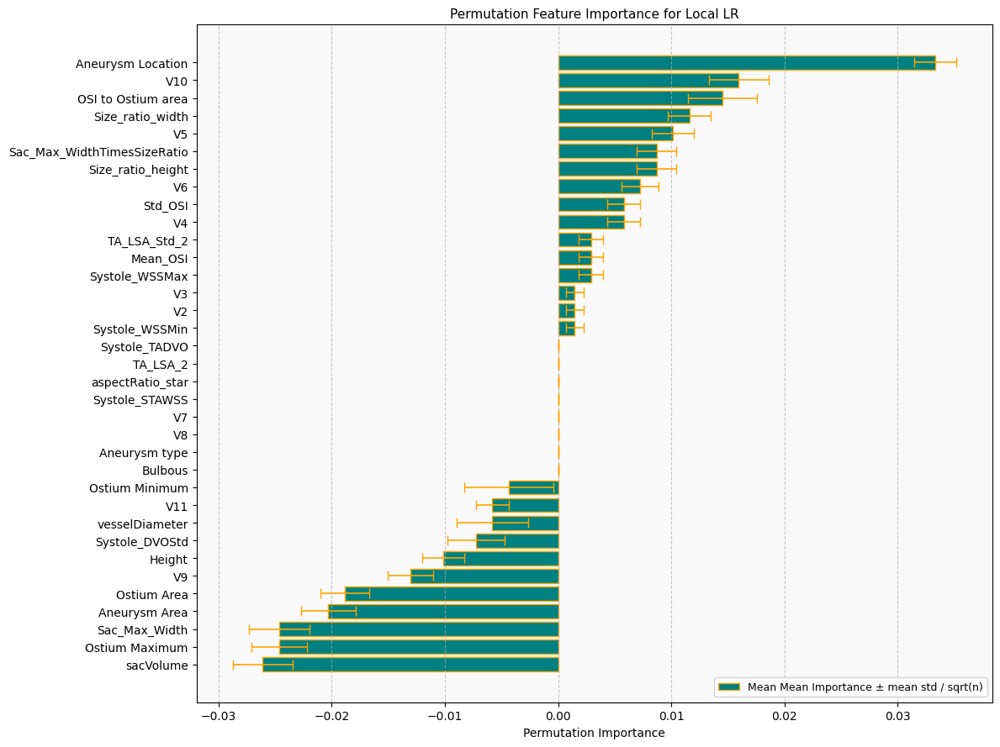

In [35]:
generate_feature_permutation_plots(models, X_test, y_test, "LR")

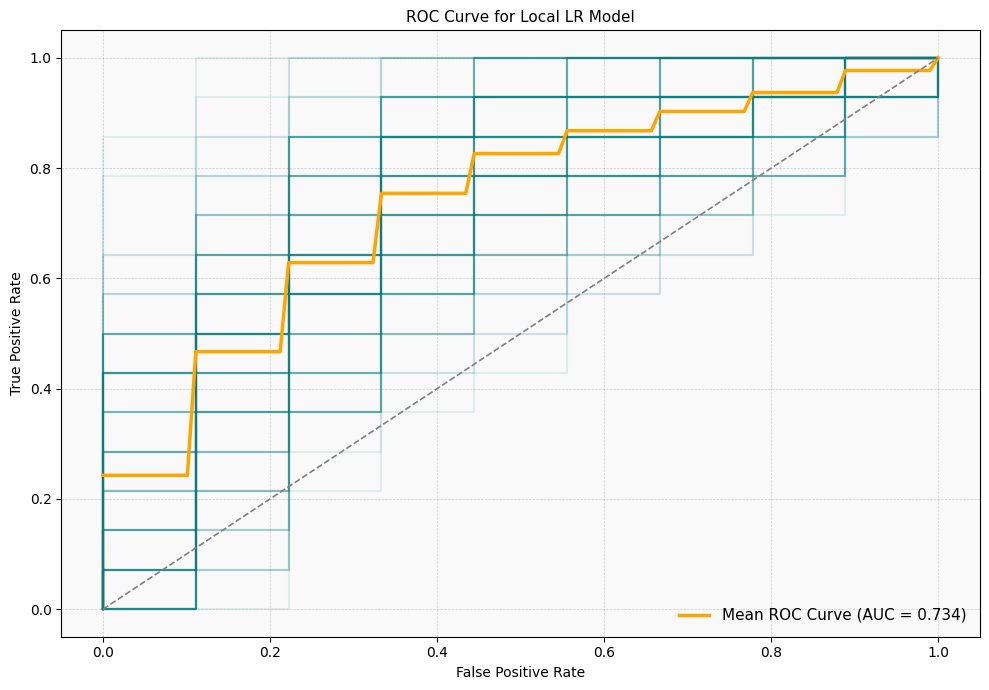

In [36]:
generate_roc_plots(roc_curves, metrics, "LR")

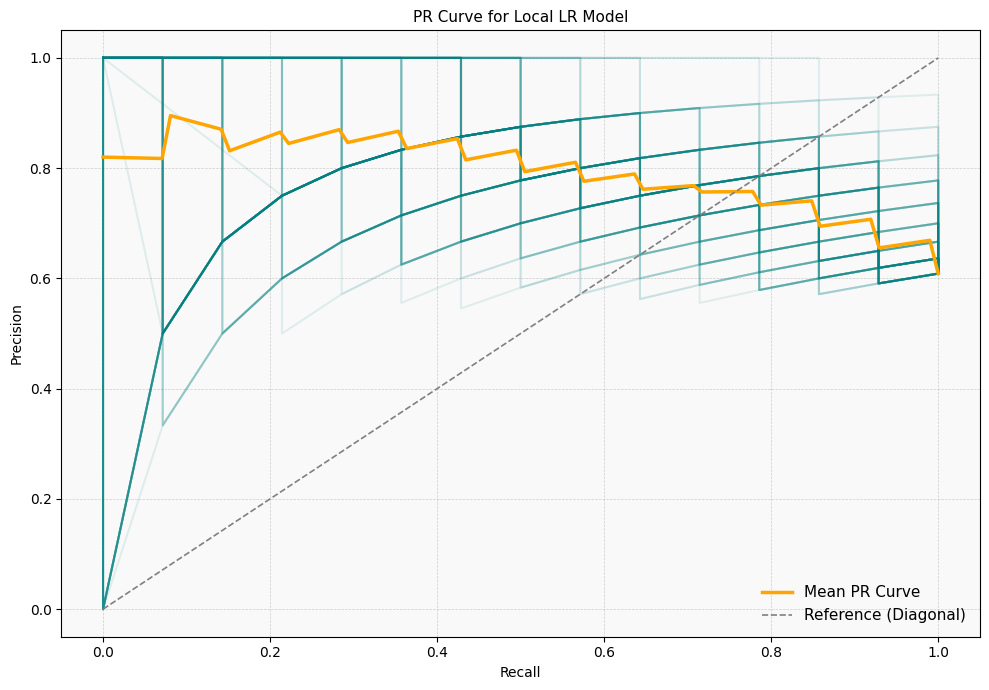

In [37]:
generate_pr_plots(precision_recall_curves, metrics, "LR")

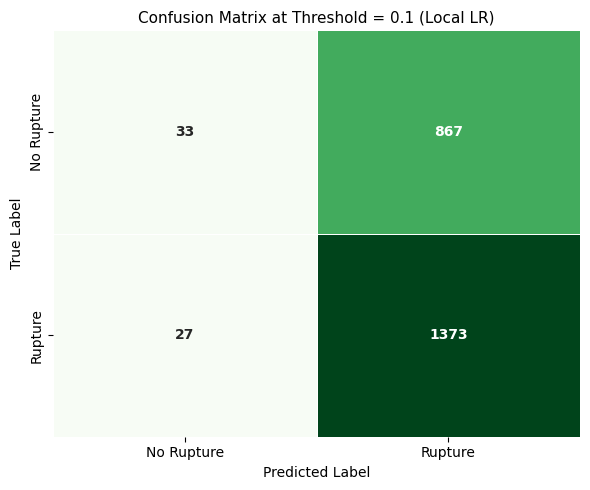

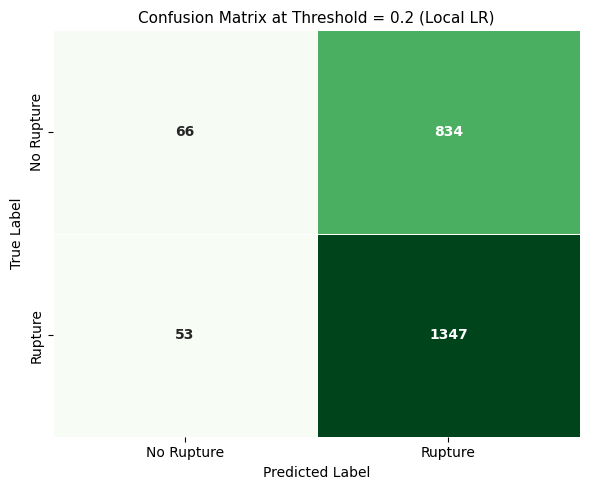

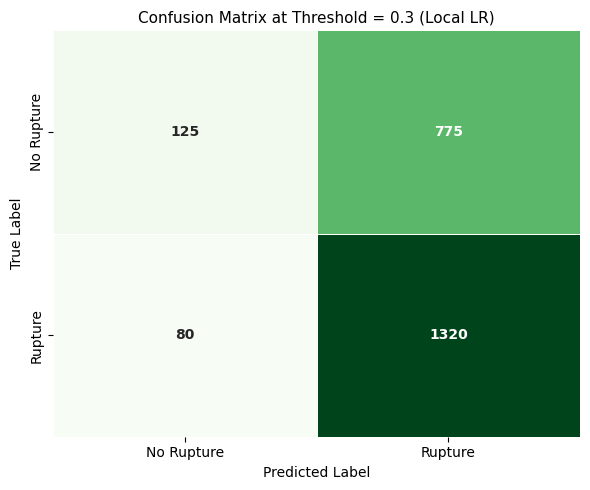

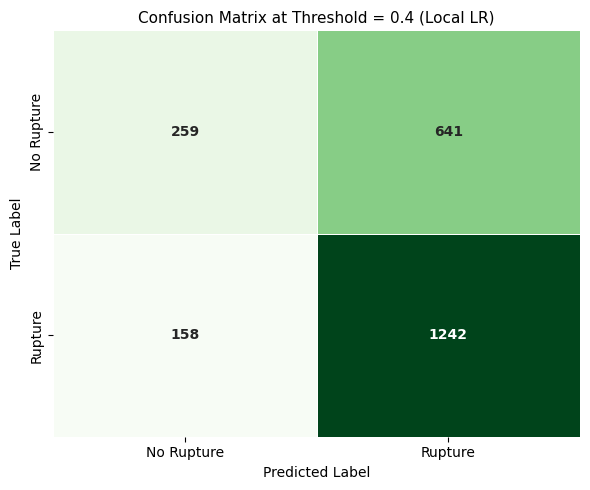

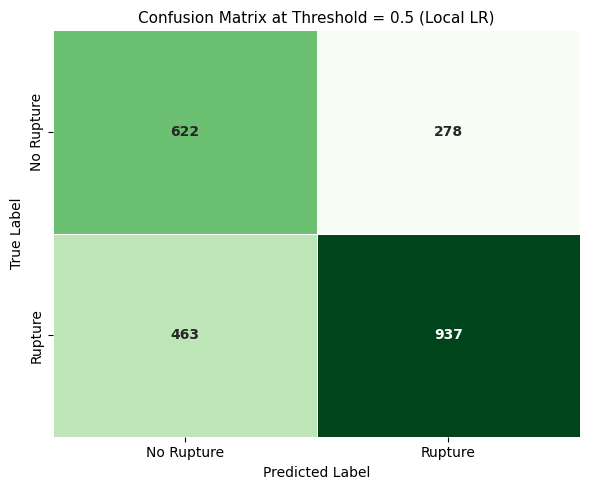

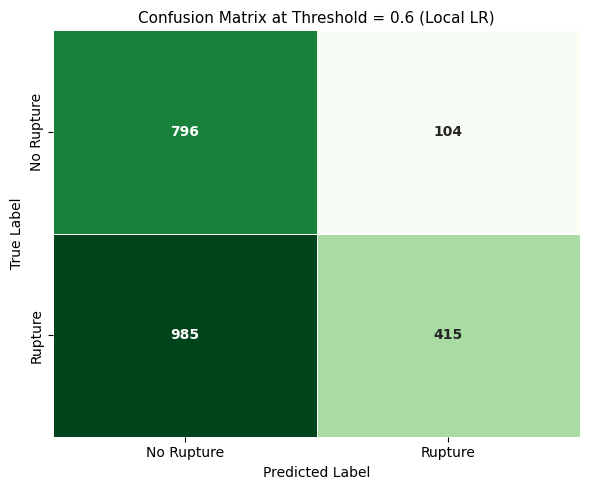

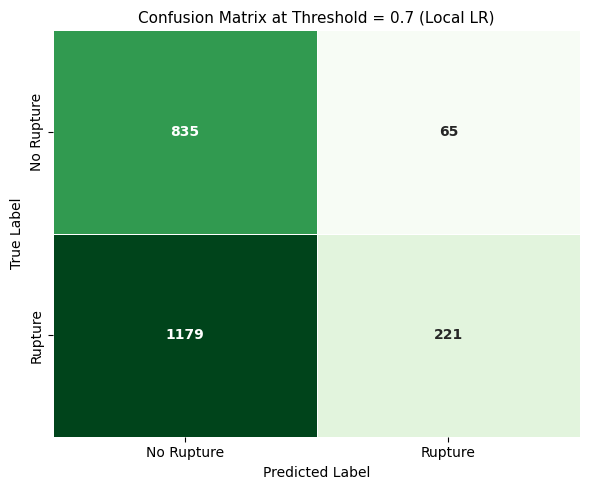

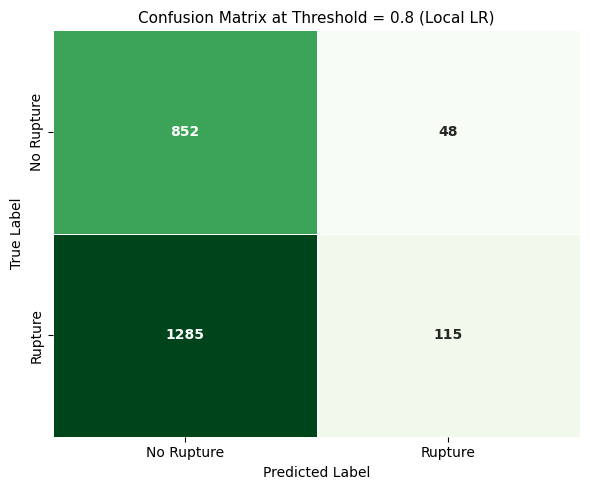

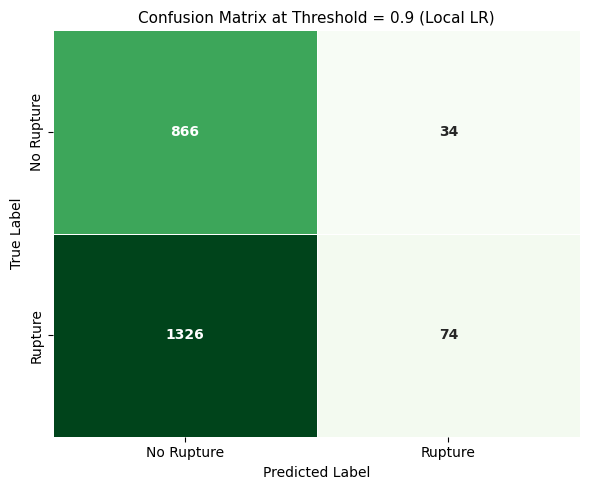

In [38]:
generate_confusian_matrix_plots(conf_matrices, "LR")

### Random Forest

In [39]:
df = load_dataset()
df.pop("Case")

0       C0001_dicom
1       C0002_dicom
2             C0010
3             C0006
4             C0007
5             C0014
6             C0016
7             C0019
8             C0020
9        CH_case087
10           UM_003
11           UM_007
12           UM_009
13           UM_013
14           UM_015
15            C0057
16            C0060
17            C0055
18            C0024
19            C0026
20      C0049_dicom
21           C0028b
22            C0030
23            C0033
24            C0034
25      C0035_dicom
26      C0036_dicom
27            C0063
28            C0064
29      C0039_dicom
30      C0040_dicom
31      C0041_dicom
32      C0042_dicom
33      C0044_dicom
34            C0045
35            C0046
36            C0066
37            C0067
38            C0069
39            C0071
40            C0072
41     C0074a_dicom
42      C0075_dicom
43      C0076_dicom
44            C0078
45            C0079
46            C0086
47            C0089
48            C0090
49            C0093


### Other Paper's Code

In [40]:
import pandas as pd
import numpy as np 
import time
import csv

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.neural_network import MLPClassifier

# A function to ignore warnings!
import warnings
warnings.simplefilter('ignore')  

print("trst")

def test_RF(num_iters, features, labels):    
    print("dsgfd")
    AUC_score = np.zeros(num_iters) 
    Accuracy_score = np.zeros(num_iters) 
    Precision_score = np.zeros(num_iters) 
    Recall_score = np.zeros(num_iters) 
    F1_score = np.zeros(num_iters)     

    for i in range(num_iters):
    
        #--get splits and best params
        np.random.RandomState(seed=1)
        t0 = time.time()        
        x_train,x_test,y_train,y_test=train_test_split(features,labels,test_size=0.1,random_state=i,stratify=labels)         
        rf=RandomForestClassifier()
        param_grid = {
             "n_estimators":[50,100,200,301,401],#**** removed a few very large ones to speed it up
             "max_depth":[7,15,19],#*** removed a few very large ones to speed it up
             'class_weight':['balanced'],
             #'max_features':[5,7,9],#*
             #'min_samples_split':[110],#**
             #'min_samples_leaf':[80],#**
             'random_state': [300]
             }              
        grid = GridSearchCV(rf, param_grid=param_grid, scoring='roc_auc', cv=10, verbose=0)#neg_log_loss,roc_auc
        grid.fit(x_train,y_train)
        y_pred=grid.predict(x_test)   
                        
        #--Get ROC-AUC Score
        Accuracy_score[i] = accuracy_score(y_test,y_pred)        
        AUC_score[i] = roc_auc_score(y_test, y_pred) #--Choose macro, micro etc. See Docs, average='micro'
        Precision_score[i] = precision_score(y_test,y_pred)
        Recall_score[i] = recall_score(y_test,y_pred)
        F1_score[i] = f1_score(y_test,y_pred)
        

        print("Iteration:", i, "Accuracy_Score:%.4f" % float(Accuracy_score[i]), "Predictions:", y_pred) 

    print("-------------------------")           
    print("Accuracy Score: %.4f" % np.mean(Accuracy_score))
    print("AUC Score: %.4f" % np.mean(AUC_score))
    print("Precision Score: %.4f" % np.mean(Precision_score))
    print("Recall Score: %.4f" % np.mean(Recall_score))
    print("F1 Score: %.4f" % np.mean(F1_score))
    print("-------------------------")   


trst


In [41]:

train_cols_t = ['Aneurysm Location', 'Aneurysm type', 'Systole_STAWSS',
       'Systole_WSSMin', 'Systole_WSSMax', 'Mean_OSI', 'Std_OSI', 'TA_LSA_2',
       'TA_LSA_Std_2', 'Bulbous', 'sacVolume', 'Height', 'Sac_Max_Width',
       'Size_ratio_height', 'Size_ratio_width', 'aspectRatio_star',
       'vesselDiameter', 'Systole_TADVO', 'Systole_DVOStd', 'Ostium Minimum',
       'Ostium Maximum', 'Aneurysm Area', 'Ostium Area', 'V2', 'V3', 'V4',
       'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']
X_train_temp = df[train_cols_t].copy()
test_RF(5, X_train_temp, df[["ruptureStatus"]].copy())

dsgfd
Iteration: 0 Accuracy_Score:0.6667 Predictions: [0 1 1 1 0 1 1 0 1 1 1 1]
Iteration: 1 Accuracy_Score:0.6667 Predictions: [1 1 1 1 1 0 0 1 1 0 1 1]
Iteration: 2 Accuracy_Score:0.6667 Predictions: [1 0 1 1 1 1 1 1 1 1 1 1]
Iteration: 3 Accuracy_Score:0.4167 Predictions: [0 0 0 1 1 1 1 0 1 0 0 1]
Iteration: 4 Accuracy_Score:0.5000 Predictions: [1 1 1 1 0 1 0 0 1 1 1 1]
-------------------------
Accuracy Score: 0.5833
AUC Score: 0.5457
Precision Score: 0.6051
Recall Score: 0.7714
F1 Score: 0.6729
-------------------------


### Our Code

In [42]:
import os

#############################################
# Identify columns and create dataframe  #
#############################################
standardized_num_features = df.columns.tolist()
categorical = ["Aneurysm type", "Aneurysm Location", "Bulbous"]
[standardized_num_features.remove(cat) for cat in categorical]
standardized_num_features.remove("ruptureStatus")

target_col = "ruptureStatus"
selected_features = standardized_num_features + categorical

X = df[selected_features].copy()

# feature scaling
X["Ostium Area"] = X["Ostium Area"]**(1/2.0)
X["Aneurysm Area"] = X["Aneurysm Area"]**(1/2.0)
X["sacVolume"] = X["sacVolume"]**(1/3.0)

# feature combos
X["OSI to Ostium area"] = X["Mean_OSI"] / (X["Ostium Area"]**2)
X["Sac_Max_WidthTimesSizeRatio"] = X["Sac_Max_Width"]*X["Size_ratio_width"]

standardized_num_features.append("OSI to Ostium area")
standardized_num_features.append("Sac_Max_WidthTimesSizeRatio")
selected_features = standardized_num_features + categorical

y = df[target_col].copy()

# Convert to numeric, coerce errors to NaN
for col in standardized_num_features:
    X[col] = pd.to_numeric(X[col], errors="coerce")


#############################################
# Perform 100 Iterations with Random Splits #
#############################################

n_splits = 100
test_scores = []
precisions = []
recalls = []
specificities = []
sensitivities = []
auc_scores = []
roc_curves = []
precision_recall_curves = []
conf_matrices = [[] for i in range(1, 10)] # different matrix for thresholds 0.1, ..., 0.9
f1s = []

from scipy.stats import t
def compute_confidence_interval(metric_list, confidence=0.95):
    metric_list = np.array(metric_list)
    n = len(metric_list)
    mean_val = np.mean(metric_list)
    std_err = np.std(metric_list, ddof=1) / np.sqrt(n)
    ci = t.interval(confidence, df=n-1, loc=mean_val, scale=std_err)
    return mean_val, ci, std_err

import optuna

sss = StratifiedShuffleSplit(n_splits=n_splits, test_size=0.2, random_state=42)
it = 1

biggest_model_id_existing = 0
for i in range(1, n_splits+1):
    dir_path = "./aneurysm_models_trained_locally/rf"
    model_filename = f"model{i}.joblib"
    if os.path.exists(os.path.join(dir_path, model_filename)):
        biggest_model_id_existing += 1
    else:
        break

models = list(joblib.Parallel(n_jobs=-1)(
    joblib.delayed(joblib.load)(f"./aneurysm_models_trained_locally/rf/model{i}.joblib") for i in range(1, biggest_model_id_existing+1)
))

splits_it = 1
train_idxs = []
test_idxs = []
if os.path.exists("./aneurysm_models_trained_locally/rf/splits/"):
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/rf/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/rf/splits/test{splits_it}.npy"))
        splits_it += 1
else:
    os.makedirs("./aneurysm_models_trained_locally/rf/splits/")
    for train_idx, test_idx in sss.split(X,y):
        np.save(f"./aneurysm_models_trained_locally/rf/splits/training{splits_it}.npy", train_idx)
        np.save(f"./aneurysm_models_trained_locally/rf/splits/test{splits_it}.npy", test_idx)
        splits_it += 1
    splits_it = 1
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/rf/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/rf/splits/test{splits_it}.npy"))
        splits_it += 1
            
for train_idx, test_idx in list(zip(train_idxs, test_idxs)):
    dir_path = "./aneurysm_models_trained_locally/rf"
    model_filename = f"model{it}.joblib"
    print(f"Running iteration {it}")
    X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
    y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
    
    if not os.path.exists(os.path.join(dir_path, model_filename)):
        print("Getting best params")
        def objective(trial):
            preprocessor = ColumnTransformer([
                ("stand_nums",
                 Pipeline([
                     ("imputer", SimpleImputer(strategy="median")),
                     ("scaler", StandardScaler())
                 ]),
                 standardized_num_features
                ),
                ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
            ])
    
            pipeline = Pipeline([
                ("preprocessor", preprocessor),
                ("classifier", RandomForestClassifier(n_estimators=trial.suggest_int('NEST', 50, 500), criterion="gini", max_depth=trial.suggest_int('D', 5, 50), class_weight="balanced"))
            ])
            
            val_aucs = []
            train_aucs = []
    
            cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=6789)
            for train_idx, val_idx in cv.split(X_train, y_train):
                X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
                y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]
    
                pipeline.fit(X_tr, y_tr)
    
                y_val_pred = pipeline.predict_proba(X_val)[:, 1]
                y_tr_pred = pipeline.predict_proba(X_tr)[:, 1]
    
                val_auc = roc_auc_score(y_val, y_val_pred)
                train_auc = roc_auc_score(y_tr, y_tr_pred)
    
                val_aucs.append(val_auc)
                train_aucs.append(train_auc)
    
            mean_val_auc = np.mean(val_aucs)
            mean_train_auc = np.mean(train_aucs)
            auc_diff = np.mean(np.abs(np.array(val_aucs) - np.array(train_auc)))  # Overfitting penalty
    
            return mean_val_auc - 0.1*auc_diff

        study_name = "RF" + str(int(time.time() * 1000))
        optuna.create_study(
            study_name=study_name, 
            directions=['maximize'], # Optimization directions
            sampler=TPESampler(seed=42), # Use the NSGAIII sampler
            pruner=MedianPruner(n_startup_trials=10, n_min_trials=2), # Use the MedianPruner
            load_if_exists=True, # Load study if it exists
            storage='mysql://root@localhost/optuna' # Save the study in SQLite
        )
        
        from concurrent.futures import ThreadPoolExecutor
        def run_optuna_study(study_name):
            study = optuna.load_study(
                study_name=study_name, storage="mysql://root@localhost/optuna"
            )
            study.optimize(objective, n_trials=5)
            
        with ThreadPoolExecutor(max_workers=16) as executor:
            res = []
            for i in range(16):
                res.append(executor.submit(run_optuna_study, study_name))
            for r in res:
                r.result()
        
        best_params = optuna.load_study(
            study_name=study_name, storage="mysql://root@localhost/optuna"
        ).best_params
        
        print(f"Best params obtained from optuna were: {best_params}")
        
        preprocessor = ColumnTransformer([
            ("stand_nums",
             Pipeline([
                 ("imputer", SimpleImputer(strategy="median")),
                 ("scaler", StandardScaler())
             ]),
             standardized_num_features
            ),
            ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
        ])
    
        pipeline = Pipeline([
            ("preprocessor", preprocessor),
            ("classifier", RandomForestClassifier(n_estimators=best_params['NEST'], criterion="gini", max_depth=best_params['D'], class_weight="balanced"))
        ])
    
        pipeline.fit(X_train, y_train)
        best_model = pipeline
        models.append(best_model)

        # save model
        os.makedirs(dir_path, exist_ok=True)
        joblib.dump(models[-1], os.path.join(dir_path, model_filename))
    else:
        pipeline = joblib.load(os.path.join(dir_path, model_filename))
        best_model = pipeline
    
    # Accuracy
    y_pred = best_model.predict(X_test)
    test_score = accuracy_score(y_test, y_pred)
    test_scores.append(test_score)
    
    # Precision & Recall
    precision = precision_score(y_test, y_pred, average="binary")  # Adjust if multiclass
    recall = recall_score(y_test, y_pred, average="binary")
    precisions.append(precision)
    recalls.append(recall)
    f1s.append(2.0*precision*recall / (precision + recall))
    
    # Sensitivity & Specificity
    cm = confusion_matrix(y_test, y_pred)
    tn, fp, fn, tp = cm.ravel()  # Extract TP, TN, FP, FN
    specificity = tn / (tn + fp) if (tn + fp) != 0 else 0
    sensitivity = tp / (tp + fn) if (tp + fn) != 0 else 0
    specificities.append(specificity)
    sensitivities.append(sensitivity)
    
    test_score = best_model.score(X_test, y_test)
    test_scores.append(test_score)
    
    # Get predicted probabilities for ROC curve
    y_probs = best_model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_probs)
    roc_curves.append((fpr, tpr))
    auc_score = auc(fpr, tpr)
    auc_scores.append(auc_score)

    precision_recall_curves.append(precision_recall_curve(y_test, best_model.predict_proba(X_test)[:, 1]))

    # Confusion Matrix
    for k in range(len(conf_matrices)):
        y_pred = (best_model.predict_proba(X_test)[:, 1] > 0.1*(k+1)).astype(int)
        conf_matrices[k].append(confusion_matrix(y_test, y_pred))    

    it += 1


# Compute all metric statistics
metrics = {
    "Accuracy": compute_confidence_interval(test_scores),
    "Precision": compute_confidence_interval(precisions),
    "Recall (Sensitivity)": compute_confidence_interval(recalls),
    "Specificity": compute_confidence_interval(specificities),
    "AUC (Area Under ROC)": compute_confidence_interval(auc_scores),
    "F1 Score": compute_confidence_interval(f1s),
}

# Print results
for metric_name, (mean_val, (ci_lower, ci_upper), std) in metrics.items():
    print(f"{metric_name}: {mean_val:.4f}/{std:.4f} (95% CI: {ci_lower:.4f}, {ci_upper:.4f})")

Running iteration 1
Getting best params


[I 2025-04-07 07:39:00,938] A new study created in RDB with name: RF1744025940874
[I 2025-04-07 07:39:13,886] Trial 10 finished with value: 0.8058571428571428 and parameters: {'NEST': 62, 'D': 43}. Best is trial 10 with value: 0.8058571428571428.
[I 2025-04-07 07:39:15,204] Trial 6 finished with value: 0.7925714285714285 and parameters: {'NEST': 67, 'D': 23}. Best is trial 10 with value: 0.8058571428571428.
[I 2025-04-07 07:39:15,738] Trial 7 finished with value: 0.7598571428571429 and parameters: {'NEST': 69, 'D': 28}. Best is trial 10 with value: 0.8058571428571428.
[I 2025-04-07 07:39:18,112] Trial 0 finished with value: 0.7822857142857141 and parameters: {'NEST': 82, 'D': 47}. Best is trial 10 with value: 0.8058571428571428.
[I 2025-04-07 07:39:27,373] Trial 13 finished with value: 0.766 and parameters: {'NEST': 141, 'D': 38}. Best is trial 10 with value: 0.8058571428571428.
[I 2025-04-07 07:39:28,800] Trial 9 finished with value: 0.7868571428571428 and parameters: {'NEST': 147, 'D

Best params obtained from optuna were: {'NEST': 147, 'D': 29}


[I 2025-04-07 07:43:04,948] A new study created in RDB with name: RF1744026184889


Running iteration 2
Getting best params


[I 2025-04-07 07:43:17,147] Trial 13 finished with value: 0.7387142857142858 and parameters: {'NEST': 59, 'D': 31}. Best is trial 13 with value: 0.7387142857142858.
[I 2025-04-07 07:43:17,712] Trial 9 finished with value: 0.7534285714285713 and parameters: {'NEST': 62, 'D': 45}. Best is trial 9 with value: 0.7534285714285713.
[I 2025-04-07 07:43:32,200] Trial 17 finished with value: 0.7944285714285714 and parameters: {'NEST': 77, 'D': 29}. Best is trial 17 with value: 0.7944285714285714.
[I 2025-04-07 07:43:36,555] Trial 10 finished with value: 0.7571428571428572 and parameters: {'NEST': 168, 'D': 17}. Best is trial 17 with value: 0.7944285714285714.
[I 2025-04-07 07:43:37,016] Trial 1 finished with value: 0.7808571428571428 and parameters: {'NEST': 175, 'D': 26}. Best is trial 17 with value: 0.7944285714285714.
[I 2025-04-07 07:43:39,024] Trial 12 finished with value: 0.7978571428571429 and parameters: {'NEST': 178, 'D': 38}. Best is trial 12 with value: 0.7978571428571429.
[I 2025-04

Best params obtained from optuna were: {'NEST': 281, 'D': 48}


[I 2025-04-07 07:46:45,128] A new study created in RDB with name: RF1744026405072


Running iteration 3
Getting best params


[I 2025-04-07 07:46:59,384] Trial 6 finished with value: 0.6782857142857144 and parameters: {'NEST': 70, 'D': 40}. Best is trial 6 with value: 0.6782857142857144.
[I 2025-04-07 07:47:01,206] Trial 9 finished with value: 0.684 and parameters: {'NEST': 76, 'D': 40}. Best is trial 9 with value: 0.684.
[I 2025-04-07 07:47:07,250] Trial 4 finished with value: 0.6868571428571429 and parameters: {'NEST': 113, 'D': 29}. Best is trial 4 with value: 0.6868571428571429.
[I 2025-04-07 07:47:12,639] Trial 14 finished with value: 0.6764285714285715 and parameters: {'NEST': 147, 'D': 16}. Best is trial 4 with value: 0.6868571428571429.
[I 2025-04-07 07:47:19,231] Trial 13 finished with value: 0.6937142857142856 and parameters: {'NEST': 185, 'D': 26}. Best is trial 13 with value: 0.6937142857142856.
[I 2025-04-07 07:47:24,281] Trial 1 finished with value: 0.7031428571428572 and parameters: {'NEST': 215, 'D': 32}. Best is trial 1 with value: 0.7031428571428572.
[I 2025-04-07 07:47:31,101] Trial 0 finis

Best params obtained from optuna were: {'NEST': 264, 'D': 20}


[I 2025-04-07 07:51:19,485] A new study created in RDB with name: RF1744026679429


Running iteration 4
Getting best params


[I 2025-04-07 07:51:33,153] Trial 0 finished with value: 0.7594285714285713 and parameters: {'NEST': 69, 'D': 37}. Best is trial 0 with value: 0.7594285714285713.
[I 2025-04-07 07:51:42,980] Trial 8 finished with value: 0.7627142857142857 and parameters: {'NEST': 123, 'D': 14}. Best is trial 8 with value: 0.7627142857142857.
[I 2025-04-07 07:51:43,899] Trial 5 finished with value: 0.7634285714285715 and parameters: {'NEST': 130, 'D': 13}. Best is trial 5 with value: 0.7634285714285715.
[I 2025-04-07 07:51:55,668] Trial 17 finished with value: 0.7724285714285715 and parameters: {'NEST': 70, 'D': 39}. Best is trial 17 with value: 0.7724285714285715.
[I 2025-04-07 07:51:57,569] Trial 9 finished with value: 0.742 and parameters: {'NEST': 205, 'D': 7}. Best is trial 17 with value: 0.7724285714285715.
[I 2025-04-07 07:52:00,078] Trial 4 finished with value: 0.7851428571428573 and parameters: {'NEST': 218, 'D': 14}. Best is trial 4 with value: 0.7851428571428573.
[I 2025-04-07 07:52:02,787] T

Best params obtained from optuna were: {'NEST': 153, 'D': 7}


[I 2025-04-07 07:55:16,904] A new study created in RDB with name: RF1744026916847


Running iteration 5
Getting best params


[I 2025-04-07 07:55:29,691] Trial 9 finished with value: 0.7277142857142858 and parameters: {'NEST': 59, 'D': 14}. Best is trial 9 with value: 0.7277142857142858.
[I 2025-04-07 07:55:37,703] Trial 4 finished with value: 0.7182857142857142 and parameters: {'NEST': 103, 'D': 8}. Best is trial 9 with value: 0.7277142857142858.
[I 2025-04-07 07:55:47,096] Trial 15 finished with value: 0.7454285714285716 and parameters: {'NEST': 161, 'D': 12}. Best is trial 15 with value: 0.7454285714285716.
[I 2025-04-07 07:55:50,492] Trial 3 finished with value: 0.7157142857142856 and parameters: {'NEST': 182, 'D': 29}. Best is trial 15 with value: 0.7454285714285716.
[I 2025-04-07 07:55:55,633] Trial 0 finished with value: 0.745 and parameters: {'NEST': 209, 'D': 24}. Best is trial 15 with value: 0.7454285714285716.
[I 2025-04-07 07:56:00,358] Trial 11 finished with value: 0.7262857142857143 and parameters: {'NEST': 235, 'D': 23}. Best is trial 15 with value: 0.7454285714285716.
[I 2025-04-07 07:56:09,35

Best params obtained from optuna were: {'NEST': 359, 'D': 30}


[I 2025-04-07 07:59:56,567] A new study created in RDB with name: RF1744027196511


Running iteration 6
Getting best params


[I 2025-04-07 08:00:17,647] Trial 11 finished with value: 0.7407142857142857 and parameters: {'NEST': 102, 'D': 37}. Best is trial 11 with value: 0.7407142857142857.
[I 2025-04-07 08:00:20,556] Trial 9 finished with value: 0.7275714285714286 and parameters: {'NEST': 123, 'D': 17}. Best is trial 11 with value: 0.7407142857142857.
[I 2025-04-07 08:00:22,523] Trial 1 finished with value: 0.7261428571428572 and parameters: {'NEST': 134, 'D': 12}. Best is trial 11 with value: 0.7407142857142857.
[I 2025-04-07 08:00:24,201] Trial 3 finished with value: 0.7615714285714287 and parameters: {'NEST': 146, 'D': 37}. Best is trial 3 with value: 0.7615714285714287.
[I 2025-04-07 08:00:31,791] Trial 10 finished with value: 0.7505714285714287 and parameters: {'NEST': 188, 'D': 7}. Best is trial 3 with value: 0.7615714285714287.
[I 2025-04-07 08:00:36,061] Trial 13 finished with value: 0.7421428571428572 and parameters: {'NEST': 212, 'D': 20}. Best is trial 3 with value: 0.7615714285714287.
[I 2025-04-

Best params obtained from optuna were: {'NEST': 143, 'D': 13}


[I 2025-04-07 08:03:51,968] A new study created in RDB with name: RF1744027431912


Running iteration 7
Getting best params


[I 2025-04-07 08:04:03,588] Trial 11 finished with value: 0.7468571428571428 and parameters: {'NEST': 52, 'D': 20}. Best is trial 11 with value: 0.7468571428571428.
[I 2025-04-07 08:04:11,724] Trial 14 finished with value: 0.7854285714285716 and parameters: {'NEST': 96, 'D': 12}. Best is trial 14 with value: 0.7854285714285716.
[I 2025-04-07 08:04:12,539] Trial 10 finished with value: 0.7759999999999999 and parameters: {'NEST': 102, 'D': 18}. Best is trial 14 with value: 0.7854285714285716.
[I 2025-04-07 08:04:25,754] Trial 4 finished with value: 0.769 and parameters: {'NEST': 179, 'D': 9}. Best is trial 14 with value: 0.7854285714285716.
[I 2025-04-07 08:04:29,937] Trial 2 finished with value: 0.787 and parameters: {'NEST': 204, 'D': 8}. Best is trial 2 with value: 0.787.
[I 2025-04-07 08:04:32,689] Trial 13 finished with value: 0.7922857142857144 and parameters: {'NEST': 220, 'D': 11}. Best is trial 13 with value: 0.7922857142857144.
[I 2025-04-07 08:04:36,387] Trial 12 finished with

Best params obtained from optuna were: {'NEST': 395, 'D': 47}


[I 2025-04-07 08:09:13,756] A new study created in RDB with name: RF1744027753700


Running iteration 8
Getting best params


[I 2025-04-07 08:09:26,497] Trial 8 finished with value: 0.7365714285714285 and parameters: {'NEST': 58, 'D': 10}. Best is trial 8 with value: 0.7365714285714285.
[I 2025-04-07 08:09:38,874] Trial 2 finished with value: 0.7111428571428571 and parameters: {'NEST': 130, 'D': 43}. Best is trial 8 with value: 0.7365714285714285.
[I 2025-04-07 08:09:39,149] Trial 11 finished with value: 0.7257142857142856 and parameters: {'NEST': 133, 'D': 18}. Best is trial 8 with value: 0.7365714285714285.
[I 2025-04-07 08:09:48,458] Trial 0 finished with value: 0.7175714285714286 and parameters: {'NEST': 185, 'D': 50}. Best is trial 8 with value: 0.7365714285714285.
[I 2025-04-07 08:09:50,119] Trial 5 finished with value: 0.7298571428571429 and parameters: {'NEST': 193, 'D': 30}. Best is trial 8 with value: 0.7365714285714285.
[I 2025-04-07 08:09:50,716] Trial 14 finished with value: 0.7195714285714288 and parameters: {'NEST': 199, 'D': 11}. Best is trial 8 with value: 0.7365714285714285.
[I 2025-04-07 0

Best params obtained from optuna were: {'NEST': 299, 'D': 27}


[I 2025-04-07 08:13:25,787] A new study created in RDB with name: RF1744028005728


Running iteration 9
Getting best params


[I 2025-04-07 08:13:37,473] Trial 7 finished with value: 0.7812857142857144 and parameters: {'NEST': 55, 'D': 15}. Best is trial 7 with value: 0.7812857142857144.
[I 2025-04-07 08:13:52,462] Trial 6 finished with value: 0.7772857142857142 and parameters: {'NEST': 138, 'D': 39}. Best is trial 7 with value: 0.7812857142857144.
[I 2025-04-07 08:13:54,642] Trial 0 finished with value: 0.791142857142857 and parameters: {'NEST': 153, 'D': 44}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 08:13:55,123] Trial 13 finished with value: 0.7567142857142857 and parameters: {'NEST': 152, 'D': 30}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 08:13:55,681] Trial 12 finished with value: 0.7681428571428572 and parameters: {'NEST': 156, 'D': 48}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 08:14:03,495] Trial 17 finished with value: 0.7952857142857143 and parameters: {'NEST': 58, 'D': 22}. Best is trial 17 with value: 0.7952857142857143.
[I 2025-04-07 08:1

Best params obtained from optuna were: {'NEST': 91, 'D': 13}


[I 2025-04-07 08:17:40,112] A new study created in RDB with name: RF1744028260057


Running iteration 10
Getting best params


[I 2025-04-07 08:17:51,914] Trial 9 finished with value: 0.7247142857142858 and parameters: {'NEST': 53, 'D': 11}. Best is trial 9 with value: 0.7247142857142858.
[I 2025-04-07 08:17:55,714] Trial 8 finished with value: 0.6751428571428573 and parameters: {'NEST': 76, 'D': 11}. Best is trial 9 with value: 0.7247142857142858.
[I 2025-04-07 08:18:00,172] Trial 3 finished with value: 0.6758571428571428 and parameters: {'NEST': 97, 'D': 47}. Best is trial 9 with value: 0.7247142857142858.
[I 2025-04-07 08:18:10,132] Trial 7 finished with value: 0.6797142857142857 and parameters: {'NEST': 159, 'D': 30}. Best is trial 9 with value: 0.7247142857142858.
[I 2025-04-07 08:18:11,576] Trial 16 finished with value: 0.6754285714285714 and parameters: {'NEST': 111, 'D': 32}. Best is trial 9 with value: 0.7247142857142858.
[I 2025-04-07 08:18:15,962] Trial 12 finished with value: 0.692 and parameters: {'NEST': 191, 'D': 32}. Best is trial 9 with value: 0.7247142857142858.
[I 2025-04-07 08:18:17,568] Tr

Best params obtained from optuna were: {'NEST': 350, 'D': 22}


[I 2025-04-07 08:22:41,691] A new study created in RDB with name: RF1744028561635


Running iteration 11
Getting best params


[I 2025-04-07 08:22:57,347] Trial 15 finished with value: 0.6738571428571429 and parameters: {'NEST': 78, 'D': 39}. Best is trial 15 with value: 0.6738571428571429.
[I 2025-04-07 08:22:58,983] Trial 7 finished with value: 0.667 and parameters: {'NEST': 87, 'D': 9}. Best is trial 15 with value: 0.6738571428571429.
[I 2025-04-07 08:23:03,650] Trial 9 finished with value: 0.6608571428571428 and parameters: {'NEST': 110, 'D': 14}. Best is trial 15 with value: 0.6738571428571429.
[I 2025-04-07 08:23:15,079] Trial 3 finished with value: 0.698 and parameters: {'NEST': 184, 'D': 5}. Best is trial 3 with value: 0.698.
[I 2025-04-07 08:23:18,782] Trial 2 finished with value: 0.6622857142857144 and parameters: {'NEST': 202, 'D': 34}. Best is trial 3 with value: 0.698.
[I 2025-04-07 08:23:22,489] Trial 4 finished with value: 0.6834285714285715 and parameters: {'NEST': 228, 'D': 6}. Best is trial 3 with value: 0.698.
[I 2025-04-07 08:23:22,605] Trial 14 finished with value: 0.6825714285714286 and p

Best params obtained from optuna were: {'NEST': 329, 'D': 32}


[I 2025-04-07 08:26:58,847] A new study created in RDB with name: RF1744028818789


Running iteration 12
Getting best params


[I 2025-04-07 08:27:16,888] Trial 8 finished with value: 0.7337142857142858 and parameters: {'NEST': 89, 'D': 13}. Best is trial 8 with value: 0.7337142857142858.
[I 2025-04-07 08:27:20,249] Trial 7 finished with value: 0.7514285714285714 and parameters: {'NEST': 107, 'D': 21}. Best is trial 7 with value: 0.7514285714285714.
[I 2025-04-07 08:27:22,725] Trial 12 finished with value: 0.7642857142857142 and parameters: {'NEST': 125, 'D': 40}. Best is trial 12 with value: 0.7642857142857142.
[I 2025-04-07 08:27:23,221] Trial 5 finished with value: 0.7614285714285713 and parameters: {'NEST': 126, 'D': 17}. Best is trial 12 with value: 0.7642857142857142.
[I 2025-04-07 08:27:24,844] Trial 9 finished with value: 0.7585714285714286 and parameters: {'NEST': 130, 'D': 31}. Best is trial 12 with value: 0.7642857142857142.
[I 2025-04-07 08:27:26,325] Trial 15 finished with value: 0.7542857142857142 and parameters: {'NEST': 142, 'D': 14}. Best is trial 12 with value: 0.7642857142857142.
[I 2025-04-

Best params obtained from optuna were: {'NEST': 477, 'D': 42}


[I 2025-04-07 08:32:14,176] A new study created in RDB with name: RF1744029134121


Running iteration 13
Getting best params


[I 2025-04-07 08:32:39,099] Trial 13 finished with value: 0.7809999999999999 and parameters: {'NEST': 134, 'D': 17}. Best is trial 13 with value: 0.7809999999999999.
[I 2025-04-07 08:32:39,764] Trial 11 finished with value: 0.7961428571428573 and parameters: {'NEST': 138, 'D': 42}. Best is trial 11 with value: 0.7961428571428573.
[I 2025-04-07 08:33:03,593] Trial 2 finished with value: 0.7927142857142856 and parameters: {'NEST': 284, 'D': 31}. Best is trial 11 with value: 0.7961428571428573.
[I 2025-04-07 08:33:07,802] Trial 14 finished with value: 0.7814285714285715 and parameters: {'NEST': 311, 'D': 13}. Best is trial 11 with value: 0.7961428571428573.
[I 2025-04-07 08:33:08,553] Trial 15 finished with value: 0.7862857142857143 and parameters: {'NEST': 311, 'D': 33}. Best is trial 11 with value: 0.7961428571428573.
[I 2025-04-07 08:33:09,428] Trial 1 finished with value: 0.8017142857142858 and parameters: {'NEST': 318, 'D': 18}. Best is trial 1 with value: 0.8017142857142858.
[I 2025

Best params obtained from optuna were: {'NEST': 135, 'D': 31}


[I 2025-04-07 08:36:32,556] A new study created in RDB with name: RF1744029392500


Running iteration 14
Getting best params


[I 2025-04-07 08:36:44,250] Trial 9 finished with value: 0.6797142857142857 and parameters: {'NEST': 55, 'D': 29}. Best is trial 9 with value: 0.6797142857142857.
[I 2025-04-07 08:36:57,377] Trial 15 finished with value: 0.6925714285714286 and parameters: {'NEST': 132, 'D': 29}. Best is trial 15 with value: 0.6925714285714286.
[I 2025-04-07 08:37:07,600] Trial 14 finished with value: 0.6971428571428572 and parameters: {'NEST': 191, 'D': 19}. Best is trial 14 with value: 0.6971428571428572.
[I 2025-04-07 08:37:08,969] Trial 12 finished with value: 0.6962857142857142 and parameters: {'NEST': 202, 'D': 30}. Best is trial 14 with value: 0.6971428571428572.
[I 2025-04-07 08:37:15,305] Trial 16 finished with value: 0.6648571428571429 and parameters: {'NEST': 175, 'D': 26}. Best is trial 14 with value: 0.6971428571428572.
[I 2025-04-07 08:37:22,132] Trial 8 finished with value: 0.6971428571428572 and parameters: {'NEST': 276, 'D': 8}. Best is trial 8 with value: 0.6971428571428572.
[I 2025-04

Best params obtained from optuna were: {'NEST': 239, 'D': 15}


[I 2025-04-07 08:41:12,556] A new study created in RDB with name: RF1744029672500


Running iteration 15
Getting best params


[I 2025-04-07 08:41:25,935] Trial 2 finished with value: 0.7810000000000001 and parameters: {'NEST': 66, 'D': 13}. Best is trial 2 with value: 0.7810000000000001.
[I 2025-04-07 08:41:33,443] Trial 3 finished with value: 0.779 and parameters: {'NEST': 106, 'D': 17}. Best is trial 2 with value: 0.7810000000000001.
[I 2025-04-07 08:41:36,811] Trial 10 finished with value: 0.7781428571428572 and parameters: {'NEST': 127, 'D': 35}. Best is trial 2 with value: 0.7810000000000001.
[I 2025-04-07 08:41:42,078] Trial 11 finished with value: 0.7625714285714286 and parameters: {'NEST': 159, 'D': 13}. Best is trial 2 with value: 0.7810000000000001.
[I 2025-04-07 08:41:45,619] Trial 13 finished with value: 0.7834285714285715 and parameters: {'NEST': 179, 'D': 34}. Best is trial 13 with value: 0.7834285714285715.
[I 2025-04-07 08:41:48,247] Trial 0 finished with value: 0.792 and parameters: {'NEST': 197, 'D': 22}. Best is trial 0 with value: 0.792.
[I 2025-04-07 08:41:51,345] Trial 8 finished with va

Best params obtained from optuna were: {'NEST': 218, 'D': 26}


[I 2025-04-07 08:44:52,318] A new study created in RDB with name: RF1744029892263


Running iteration 16
Getting best params


[I 2025-04-07 08:45:02,943] Trial 0 finished with value: 0.8317142857142857 and parameters: {'NEST': 50, 'D': 10}. Best is trial 0 with value: 0.8317142857142857.
[I 2025-04-07 08:45:03,495] Trial 1 finished with value: 0.8270000000000001 and parameters: {'NEST': 50, 'D': 46}. Best is trial 0 with value: 0.8317142857142857.
[I 2025-04-07 08:45:05,489] Trial 10 finished with value: 0.8287142857142857 and parameters: {'NEST': 63, 'D': 42}. Best is trial 0 with value: 0.8317142857142857.
[I 2025-04-07 08:45:09,668] Trial 5 finished with value: 0.8211428571428571 and parameters: {'NEST': 82, 'D': 43}. Best is trial 0 with value: 0.8317142857142857.
[I 2025-04-07 08:45:20,938] Trial 13 finished with value: 0.8168571428571428 and parameters: {'NEST': 146, 'D': 46}. Best is trial 0 with value: 0.8317142857142857.
[I 2025-04-07 08:45:22,039] Trial 17 finished with value: 0.8107142857142857 and parameters: {'NEST': 102, 'D': 50}. Best is trial 0 with value: 0.8317142857142857.
[I 2025-04-07 08:

Best params obtained from optuna were: {'NEST': 234, 'D': 11}


[I 2025-04-07 08:49:14,033] A new study created in RDB with name: RF1744030153978


Running iteration 17
Getting best params


[I 2025-04-07 08:49:26,482] Trial 2 finished with value: 0.7057142857142856 and parameters: {'NEST': 61, 'D': 5}. Best is trial 2 with value: 0.7057142857142856.
[I 2025-04-07 08:49:32,273] Trial 7 finished with value: 0.6865714285714285 and parameters: {'NEST': 89, 'D': 37}. Best is trial 2 with value: 0.7057142857142856.
[I 2025-04-07 08:49:36,822] Trial 5 finished with value: 0.7467142857142857 and parameters: {'NEST': 121, 'D': 12}. Best is trial 5 with value: 0.7467142857142857.
[I 2025-04-07 08:49:37,279] Trial 13 finished with value: 0.7302857142857143 and parameters: {'NEST': 120, 'D': 7}. Best is trial 5 with value: 0.7467142857142857.
[I 2025-04-07 08:49:47,036] Trial 9 finished with value: 0.7134285714285713 and parameters: {'NEST': 181, 'D': 50}. Best is trial 5 with value: 0.7467142857142857.
[I 2025-04-07 08:49:51,943] Trial 4 finished with value: 0.7437142857142857 and parameters: {'NEST': 205, 'D': 47}. Best is trial 5 with value: 0.7467142857142857.
[I 2025-04-07 08:49

Best params obtained from optuna were: {'NEST': 141, 'D': 12}


[I 2025-04-07 08:53:15,320] A new study created in RDB with name: RF1744030395264


Running iteration 18
Getting best params


[I 2025-04-07 08:53:39,287] Trial 5 finished with value: 0.7777142857142856 and parameters: {'NEST': 127, 'D': 11}. Best is trial 5 with value: 0.7777142857142856.
[I 2025-04-07 08:53:41,570] Trial 6 finished with value: 0.76 and parameters: {'NEST': 140, 'D': 47}. Best is trial 5 with value: 0.7777142857142856.
[I 2025-04-07 08:53:46,111] Trial 11 finished with value: 0.7541428571428571 and parameters: {'NEST': 165, 'D': 16}. Best is trial 5 with value: 0.7777142857142856.
[I 2025-04-07 08:53:50,249] Trial 12 finished with value: 0.7684285714285713 and parameters: {'NEST': 192, 'D': 34}. Best is trial 5 with value: 0.7777142857142856.
[I 2025-04-07 08:53:58,727] Trial 1 finished with value: 0.7824285714285715 and parameters: {'NEST': 241, 'D': 46}. Best is trial 1 with value: 0.7824285714285715.
[I 2025-04-07 08:54:02,429] Trial 16 finished with value: 0.7595714285714286 and parameters: {'NEST': 131, 'D': 34}. Best is trial 1 with value: 0.7824285714285715.
[I 2025-04-07 08:54:08,576]

Best params obtained from optuna were: {'NEST': 420, 'D': 40}


[I 2025-04-07 08:58:24,589] A new study created in RDB with name: RF1744030704532


Running iteration 19
Getting best params


[I 2025-04-07 08:58:38,379] Trial 2 finished with value: 0.7317142857142858 and parameters: {'NEST': 67, 'D': 40}. Best is trial 2 with value: 0.7317142857142858.
[I 2025-04-07 08:58:47,800] Trial 3 finished with value: 0.7795714285714286 and parameters: {'NEST': 125, 'D': 19}. Best is trial 3 with value: 0.7795714285714286.
[I 2025-04-07 08:58:53,146] Trial 8 finished with value: 0.7705714285714286 and parameters: {'NEST': 151, 'D': 16}. Best is trial 3 with value: 0.7795714285714286.
[I 2025-04-07 08:59:03,304] Trial 7 finished with value: 0.7844285714285715 and parameters: {'NEST': 209, 'D': 49}. Best is trial 7 with value: 0.7844285714285715.
[I 2025-04-07 08:59:05,334] Trial 15 finished with value: 0.7588571428571429 and parameters: {'NEST': 222, 'D': 27}. Best is trial 7 with value: 0.7844285714285715.
[I 2025-04-07 08:59:06,539] Trial 0 finished with value: 0.7734285714285715 and parameters: {'NEST': 238, 'D': 27}. Best is trial 7 with value: 0.7844285714285715.
[I 2025-04-07 08

Best params obtained from optuna were: {'NEST': 465, 'D': 16}


[I 2025-04-07 09:03:35,863] A new study created in RDB with name: RF1744031015808


Running iteration 20
Getting best params


[I 2025-04-07 09:03:46,989] Trial 6 finished with value: 0.7494285714285714 and parameters: {'NEST': 51, 'D': 21}. Best is trial 6 with value: 0.7494285714285714.
[I 2025-04-07 09:03:53,818] Trial 10 finished with value: 0.7174285714285714 and parameters: {'NEST': 88, 'D': 15}. Best is trial 6 with value: 0.7494285714285714.
[I 2025-04-07 09:04:01,515] Trial 9 finished with value: 0.7007142857142857 and parameters: {'NEST': 135, 'D': 39}. Best is trial 6 with value: 0.7494285714285714.
[I 2025-04-07 09:04:02,171] Trial 12 finished with value: 0.7282857142857144 and parameters: {'NEST': 139, 'D': 19}. Best is trial 6 with value: 0.7494285714285714.
[I 2025-04-07 09:04:06,803] Trial 11 finished with value: 0.7072857142857142 and parameters: {'NEST': 163, 'D': 37}. Best is trial 6 with value: 0.7494285714285714.
[I 2025-04-07 09:04:06,837] Trial 0 finished with value: 0.7267142857142856 and parameters: {'NEST': 166, 'D': 11}. Best is trial 6 with value: 0.7494285714285714.
[I 2025-04-07 0

Best params obtained from optuna were: {'NEST': 51, 'D': 21}


[I 2025-04-07 09:07:26,543] A new study created in RDB with name: RF1744031246487


Running iteration 21
Getting best params


[I 2025-04-07 09:07:38,818] Trial 11 finished with value: 0.8005714285714287 and parameters: {'NEST': 56, 'D': 41}. Best is trial 11 with value: 0.8005714285714287.
[I 2025-04-07 09:07:40,229] Trial 1 finished with value: 0.7794285714285715 and parameters: {'NEST': 63, 'D': 14}. Best is trial 11 with value: 0.8005714285714287.
[I 2025-04-07 09:07:42,287] Trial 4 finished with value: 0.7497142857142858 and parameters: {'NEST': 74, 'D': 11}. Best is trial 11 with value: 0.8005714285714287.
[I 2025-04-07 09:07:46,534] Trial 8 finished with value: 0.7371428571428572 and parameters: {'NEST': 99, 'D': 29}. Best is trial 11 with value: 0.8005714285714287.
[I 2025-04-07 09:07:47,621] Trial 10 finished with value: 0.7855714285714287 and parameters: {'NEST': 103, 'D': 12}. Best is trial 11 with value: 0.8005714285714287.
[I 2025-04-07 09:07:51,568] Trial 9 finished with value: 0.7428571428571429 and parameters: {'NEST': 128, 'D': 9}. Best is trial 11 with value: 0.8005714285714287.
[I 2025-04-07

Best params obtained from optuna were: {'NEST': 56, 'D': 41}


[I 2025-04-07 09:11:04,620] A new study created in RDB with name: RF1744031464564


Running iteration 22
Getting best params


[I 2025-04-07 09:11:16,491] Trial 5 finished with value: 0.7498571428571428 and parameters: {'NEST': 55, 'D': 25}. Best is trial 5 with value: 0.7498571428571428.
[I 2025-04-07 09:11:22,102] Trial 9 finished with value: 0.7557142857142858 and parameters: {'NEST': 84, 'D': 38}. Best is trial 9 with value: 0.7557142857142858.
[I 2025-04-07 09:11:27,549] Trial 2 finished with value: 0.738 and parameters: {'NEST': 120, 'D': 37}. Best is trial 9 with value: 0.7557142857142858.
[I 2025-04-07 09:11:40,693] Trial 12 finished with value: 0.751 and parameters: {'NEST': 195, 'D': 14}. Best is trial 9 with value: 0.7557142857142858.
[I 2025-04-07 09:11:42,462] Trial 1 finished with value: 0.7618571428571428 and parameters: {'NEST': 207, 'D': 17}. Best is trial 1 with value: 0.7618571428571428.
[I 2025-04-07 09:11:43,005] Trial 16 finished with value: 0.7557142857142857 and parameters: {'NEST': 151, 'D': 39}. Best is trial 1 with value: 0.7618571428571428.
[I 2025-04-07 09:11:44,196] Trial 15 finis

Best params obtained from optuna were: {'NEST': 369, 'D': 41}


[I 2025-04-07 09:15:46,638] A new study created in RDB with name: RF1744031746584


Running iteration 23
Getting best params


[I 2025-04-07 09:16:06,587] Trial 1 finished with value: 0.7288571428571429 and parameters: {'NEST': 101, 'D': 25}. Best is trial 1 with value: 0.7288571428571429.
[I 2025-04-07 09:16:07,456] Trial 3 finished with value: 0.7191428571428572 and parameters: {'NEST': 104, 'D': 9}. Best is trial 1 with value: 0.7288571428571429.
[I 2025-04-07 09:16:10,460] Trial 4 finished with value: 0.7342857142857143 and parameters: {'NEST': 122, 'D': 10}. Best is trial 4 with value: 0.7342857142857143.
[I 2025-04-07 09:16:12,400] Trial 9 finished with value: 0.7728571428571428 and parameters: {'NEST': 136, 'D': 8}. Best is trial 9 with value: 0.7728571428571428.
[I 2025-04-07 09:16:16,271] Trial 7 finished with value: 0.7424285714285715 and parameters: {'NEST': 153, 'D': 41}. Best is trial 9 with value: 0.7728571428571428.
[I 2025-04-07 09:16:16,950] Trial 11 finished with value: 0.7354285714285714 and parameters: {'NEST': 156, 'D': 26}. Best is trial 9 with value: 0.7728571428571428.
[I 2025-04-07 09:

Best params obtained from optuna were: {'NEST': 186, 'D': 8}


[I 2025-04-07 09:19:49,190] A new study created in RDB with name: RF1744031989135


Running iteration 24
Getting best params


[I 2025-04-07 09:20:00,622] Trial 2 finished with value: 0.7028571428571428 and parameters: {'NEST': 50, 'D': 37}. Best is trial 2 with value: 0.7028571428571428.
[I 2025-04-07 09:20:01,068] Trial 15 finished with value: 0.7234285714285714 and parameters: {'NEST': 52, 'D': 33}. Best is trial 15 with value: 0.7234285714285714.
[I 2025-04-07 09:20:01,654] Trial 13 finished with value: 0.695 and parameters: {'NEST': 53, 'D': 35}. Best is trial 15 with value: 0.7234285714285714.
[I 2025-04-07 09:20:09,193] Trial 1 finished with value: 0.7271428571428571 and parameters: {'NEST': 97, 'D': 21}. Best is trial 1 with value: 0.7271428571428571.
[I 2025-04-07 09:20:09,880] Trial 14 finished with value: 0.682 and parameters: {'NEST': 98, 'D': 27}. Best is trial 1 with value: 0.7271428571428571.
[I 2025-04-07 09:20:13,398] Trial 10 finished with value: 0.7494285714285714 and parameters: {'NEST': 121, 'D': 49}. Best is trial 10 with value: 0.7494285714285714.
[I 2025-04-07 09:20:15,569] Trial 16 fin

Best params obtained from optuna were: {'NEST': 121, 'D': 49}


[I 2025-04-07 09:23:37,810] A new study created in RDB with name: RF1744032217752


Running iteration 25
Getting best params


[I 2025-04-07 09:24:13,287] Trial 14 finished with value: 0.7431428571428571 and parameters: {'NEST': 196, 'D': 47}. Best is trial 14 with value: 0.7431428571428571.
[I 2025-04-07 09:24:18,128] Trial 8 finished with value: 0.74 and parameters: {'NEST': 225, 'D': 48}. Best is trial 14 with value: 0.7431428571428571.
[I 2025-04-07 09:24:22,425] Trial 3 finished with value: 0.7574285714285715 and parameters: {'NEST': 254, 'D': 27}. Best is trial 3 with value: 0.7574285714285715.
[I 2025-04-07 09:24:24,251] Trial 16 finished with value: 0.7029999999999998 and parameters: {'NEST': 62, 'D': 38}. Best is trial 3 with value: 0.7574285714285715.
[I 2025-04-07 09:24:24,555] Trial 12 finished with value: 0.7371428571428573 and parameters: {'NEST': 269, 'D': 41}. Best is trial 3 with value: 0.7574285714285715.
[I 2025-04-07 09:24:27,916] Trial 9 finished with value: 0.77 and parameters: {'NEST': 281, 'D': 24}. Best is trial 9 with value: 0.77.
[I 2025-04-07 09:24:27,957] Trial 6 finished with valu

Best params obtained from optuna were: {'NEST': 129, 'D': 7}


[I 2025-04-07 09:28:16,666] A new study created in RDB with name: RF1744032496610


Running iteration 26
Getting best params


[I 2025-04-07 09:28:29,796] Trial 4 finished with value: 0.7438571428571429 and parameters: {'NEST': 66, 'D': 30}. Best is trial 4 with value: 0.7438571428571429.
[I 2025-04-07 09:28:36,458] Trial 14 finished with value: 0.7972857142857142 and parameters: {'NEST': 96, 'D': 28}. Best is trial 14 with value: 0.7972857142857142.
[I 2025-04-07 09:28:39,853] Trial 9 finished with value: 0.7778571428571429 and parameters: {'NEST': 121, 'D': 36}. Best is trial 14 with value: 0.7972857142857142.
[I 2025-04-07 09:28:44,226] Trial 13 finished with value: 0.7992857142857142 and parameters: {'NEST': 148, 'D': 26}. Best is trial 13 with value: 0.7992857142857142.
[I 2025-04-07 09:28:53,639] Trial 1 finished with value: 0.7887142857142857 and parameters: {'NEST': 202, 'D': 29}. Best is trial 13 with value: 0.7992857142857142.
[I 2025-04-07 09:29:02,156] Trial 2 finished with value: 0.8091428571428572 and parameters: {'NEST': 255, 'D': 32}. Best is trial 2 with value: 0.8091428571428572.
[I 2025-04-0

Best params obtained from optuna were: {'NEST': 248, 'D': 29}


[I 2025-04-07 09:32:25,220] A new study created in RDB with name: RF1744032745164


Running iteration 27
Getting best params


[I 2025-04-07 09:32:39,259] Trial 5 finished with value: 0.7208571428571428 and parameters: {'NEST': 68, 'D': 15}. Best is trial 5 with value: 0.7208571428571428.
[I 2025-04-07 09:33:06,068] Trial 10 finished with value: 0.728 and parameters: {'NEST': 224, 'D': 24}. Best is trial 10 with value: 0.728.
[I 2025-04-07 09:33:11,390] Trial 9 finished with value: 0.7422857142857143 and parameters: {'NEST': 259, 'D': 35}. Best is trial 9 with value: 0.7422857142857143.
[I 2025-04-07 09:33:12,536] Trial 3 finished with value: 0.736 and parameters: {'NEST': 265, 'D': 25}. Best is trial 9 with value: 0.7422857142857143.
[I 2025-04-07 09:33:15,665] Trial 4 finished with value: 0.7310000000000001 and parameters: {'NEST': 286, 'D': 28}. Best is trial 9 with value: 0.7422857142857143.
[I 2025-04-07 09:33:16,100] Trial 14 finished with value: 0.7232857142857143 and parameters: {'NEST': 287, 'D': 19}. Best is trial 9 with value: 0.7422857142857143.
[I 2025-04-07 09:33:17,613] Trial 15 finished with va

Best params obtained from optuna were: {'NEST': 154, 'D': 33}


[I 2025-04-07 09:35:41,975] A new study created in RDB with name: RF1744032941919


Running iteration 28
Getting best params


[I 2025-04-07 09:35:59,283] Trial 5 finished with value: 0.772 and parameters: {'NEST': 86, 'D': 25}. Best is trial 5 with value: 0.772.
[I 2025-04-07 09:36:07,437] Trial 2 finished with value: 0.7660000000000001 and parameters: {'NEST': 134, 'D': 9}. Best is trial 5 with value: 0.772.
[I 2025-04-07 09:36:10,063] Trial 8 finished with value: 0.7588571428571429 and parameters: {'NEST': 154, 'D': 10}. Best is trial 5 with value: 0.772.
[I 2025-04-07 09:36:13,972] Trial 7 finished with value: 0.7645714285714286 and parameters: {'NEST': 173, 'D': 15}. Best is trial 5 with value: 0.772.
[I 2025-04-07 09:36:15,759] Trial 12 finished with value: 0.7689999999999999 and parameters: {'NEST': 178, 'D': 20}. Best is trial 5 with value: 0.772.
[I 2025-04-07 09:36:19,145] Trial 0 finished with value: 0.7859999999999999 and parameters: {'NEST': 205, 'D': 23}. Best is trial 0 with value: 0.7859999999999999.
[I 2025-04-07 09:36:19,276] Trial 11 finished with value: 0.7942857142857143 and parameters: {'

Best params obtained from optuna were: {'NEST': 208, 'D': 48}


[I 2025-04-07 09:40:36,161] A new study created in RDB with name: RF1744033236106


Running iteration 29
Getting best params


[I 2025-04-07 09:40:51,005] Trial 15 finished with value: 0.7384285714285714 and parameters: {'NEST': 70, 'D': 26}. Best is trial 15 with value: 0.7384285714285714.
[I 2025-04-07 09:40:56,931] Trial 8 finished with value: 0.7298571428571429 and parameters: {'NEST': 103, 'D': 19}. Best is trial 15 with value: 0.7384285714285714.
[I 2025-04-07 09:40:59,102] Trial 12 finished with value: 0.7288571428571429 and parameters: {'NEST': 118, 'D': 27}. Best is trial 15 with value: 0.7384285714285714.
[I 2025-04-07 09:41:03,028] Trial 5 finished with value: 0.7311428571428572 and parameters: {'NEST': 141, 'D': 26}. Best is trial 15 with value: 0.7384285714285714.
[I 2025-04-07 09:41:05,007] Trial 9 finished with value: 0.7558571428571428 and parameters: {'NEST': 152, 'D': 11}. Best is trial 9 with value: 0.7558571428571428.
[I 2025-04-07 09:41:08,822] Trial 4 finished with value: 0.7432857142857143 and parameters: {'NEST': 174, 'D': 36}. Best is trial 9 with value: 0.7558571428571428.
[I 2025-04-

Best params obtained from optuna were: {'NEST': 498, 'D': 9}


[I 2025-04-07 09:45:11,374] A new study created in RDB with name: RF1744033511320


Running iteration 30
Getting best params


[I 2025-04-07 09:45:24,493] Trial 15 finished with value: 0.7472857142857143 and parameters: {'NEST': 62, 'D': 12}. Best is trial 15 with value: 0.7472857142857143.
[I 2025-04-07 09:45:29,921] Trial 4 finished with value: 0.7251428571428571 and parameters: {'NEST': 91, 'D': 29}. Best is trial 15 with value: 0.7472857142857143.
[I 2025-04-07 09:45:35,577] Trial 13 finished with value: 0.7687142857142856 and parameters: {'NEST': 128, 'D': 26}. Best is trial 13 with value: 0.7687142857142856.
[I 2025-04-07 09:45:50,542] Trial 10 finished with value: 0.7562857142857143 and parameters: {'NEST': 214, 'D': 42}. Best is trial 13 with value: 0.7687142857142856.
[I 2025-04-07 09:45:56,146] Trial 17 finished with value: 0.728 and parameters: {'NEST': 156, 'D': 11}. Best is trial 13 with value: 0.7687142857142856.
[I 2025-04-07 09:45:56,777] Trial 11 finished with value: 0.7395714285714285 and parameters: {'NEST': 256, 'D': 20}. Best is trial 13 with value: 0.7687142857142856.
[I 2025-04-07 09:45:

Best params obtained from optuna were: {'NEST': 450, 'D': 45}


[I 2025-04-07 09:49:55,510] A new study created in RDB with name: RF1744033795452


Running iteration 31
Getting best params


[I 2025-04-07 09:50:12,957] Trial 4 finished with value: 0.8442857142857143 and parameters: {'NEST': 86, 'D': 45}. Best is trial 4 with value: 0.8442857142857143.
[I 2025-04-07 09:50:21,576] Trial 12 finished with value: 0.8257142857142857 and parameters: {'NEST': 138, 'D': 18}. Best is trial 4 with value: 0.8442857142857143.
[I 2025-04-07 09:50:29,580] Trial 11 finished with value: 0.8228571428571428 and parameters: {'NEST': 185, 'D': 14}. Best is trial 4 with value: 0.8442857142857143.
[I 2025-04-07 09:50:31,115] Trial 13 finished with value: 0.8634285714285714 and parameters: {'NEST': 193, 'D': 50}. Best is trial 13 with value: 0.8634285714285714.
[I 2025-04-07 09:50:33,292] Trial 1 finished with value: 0.8157142857142858 and parameters: {'NEST': 209, 'D': 48}. Best is trial 13 with value: 0.8634285714285714.
[I 2025-04-07 09:50:40,820] Trial 5 finished with value: 0.8651428571428571 and parameters: {'NEST': 255, 'D': 14}. Best is trial 5 with value: 0.8651428571428571.
[I 2025-04-0

Best params obtained from optuna were: {'NEST': 158, 'D': 43}


[I 2025-04-07 09:54:07,112] A new study created in RDB with name: RF1744034047056


Running iteration 32
Getting best params


[I 2025-04-07 09:54:29,899] Trial 4 finished with value: 0.7562857142857143 and parameters: {'NEST': 120, 'D': 33}. Best is trial 4 with value: 0.7562857142857143.
[I 2025-04-07 09:54:30,343] Trial 15 finished with value: 0.7834285714285715 and parameters: {'NEST': 121, 'D': 43}. Best is trial 15 with value: 0.7834285714285715.
[I 2025-04-07 09:54:31,473] Trial 12 finished with value: 0.779 and parameters: {'NEST': 125, 'D': 22}. Best is trial 15 with value: 0.7834285714285715.
[I 2025-04-07 09:54:34,219] Trial 3 finished with value: 0.7762857142857142 and parameters: {'NEST': 143, 'D': 37}. Best is trial 15 with value: 0.7834285714285715.
[I 2025-04-07 09:54:36,723] Trial 10 finished with value: 0.7859999999999999 and parameters: {'NEST': 160, 'D': 29}. Best is trial 10 with value: 0.7859999999999999.
[I 2025-04-07 09:54:45,107] Trial 8 finished with value: 0.7877142857142857 and parameters: {'NEST': 210, 'D': 8}. Best is trial 8 with value: 0.7877142857142857.
[I 2025-04-07 09:54:50,

Best params obtained from optuna were: {'NEST': 273, 'D': 35}


[I 2025-04-07 09:58:29,184] A new study created in RDB with name: RF1744034309128


Running iteration 33
Getting best params


[I 2025-04-07 09:58:43,243] Trial 0 finished with value: 0.7477142857142858 and parameters: {'NEST': 66, 'D': 19}. Best is trial 0 with value: 0.7477142857142858.
[I 2025-04-07 09:58:46,272] Trial 9 finished with value: 0.7017142857142857 and parameters: {'NEST': 83, 'D': 48}. Best is trial 0 with value: 0.7477142857142858.
[I 2025-04-07 09:58:52,968] Trial 12 finished with value: 0.7257142857142859 and parameters: {'NEST': 122, 'D': 7}. Best is trial 0 with value: 0.7477142857142858.
[I 2025-04-07 09:58:53,710] Trial 16 finished with value: 0.6890000000000001 and parameters: {'NEST': 57, 'D': 48}. Best is trial 0 with value: 0.7477142857142858.
[I 2025-04-07 09:58:54,498] Trial 11 finished with value: 0.7241428571428572 and parameters: {'NEST': 129, 'D': 20}. Best is trial 0 with value: 0.7477142857142858.
[I 2025-04-07 09:58:57,523] Trial 3 finished with value: 0.724 and parameters: {'NEST': 146, 'D': 24}. Best is trial 0 with value: 0.7477142857142858.
[I 2025-04-07 09:59:00,165] Tr

Best params obtained from optuna were: {'NEST': 155, 'D': 25}


[I 2025-04-07 10:02:19,075] A new study created in RDB with name: RF1744034539020


Running iteration 34
Getting best params


[I 2025-04-07 10:02:33,006] Trial 5 finished with value: 0.7847142857142857 and parameters: {'NEST': 67, 'D': 35}. Best is trial 5 with value: 0.7847142857142857.
[I 2025-04-07 10:02:34,712] Trial 15 finished with value: 0.7122857142857143 and parameters: {'NEST': 75, 'D': 34}. Best is trial 5 with value: 0.7847142857142857.
[I 2025-04-07 10:02:40,049] Trial 14 finished with value: 0.7479999999999999 and parameters: {'NEST': 106, 'D': 25}. Best is trial 5 with value: 0.7847142857142857.
[I 2025-04-07 10:02:40,720] Trial 12 finished with value: 0.7528571428571429 and parameters: {'NEST': 110, 'D': 13}. Best is trial 5 with value: 0.7847142857142857.
[I 2025-04-07 10:02:42,461] Trial 1 finished with value: 0.7578571428571429 and parameters: {'NEST': 121, 'D': 33}. Best is trial 5 with value: 0.7847142857142857.
[I 2025-04-07 10:02:45,255] Trial 13 finished with value: 0.7822857142857141 and parameters: {'NEST': 135, 'D': 25}. Best is trial 5 with value: 0.7847142857142857.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 376, 'D': 39}


[I 2025-04-07 10:07:17,649] A new study created in RDB with name: RF1744034837587


Running iteration 35
Getting best params


[I 2025-04-07 10:07:35,485] Trial 12 finished with value: 0.6667142857142858 and parameters: {'NEST': 70, 'D': 46}. Best is trial 12 with value: 0.6667142857142858.
[I 2025-04-07 10:07:36,091] Trial 13 finished with value: 0.6975714285714285 and parameters: {'NEST': 75, 'D': 41}. Best is trial 13 with value: 0.6975714285714285.
[I 2025-04-07 10:07:47,459] Trial 3 finished with value: 0.7091428571428572 and parameters: {'NEST': 126, 'D': 23}. Best is trial 3 with value: 0.7091428571428572.
[I 2025-04-07 10:07:48,439] Trial 17 finished with value: 0.7167142857142857 and parameters: {'NEST': 51, 'D': 19}. Best is trial 17 with value: 0.7167142857142857.
[I 2025-04-07 10:08:08,408] Trial 16 finished with value: 0.7148571428571429 and parameters: {'NEST': 154, 'D': 14}. Best is trial 17 with value: 0.7167142857142857.
[I 2025-04-07 10:08:10,248] Trial 2 finished with value: 0.6951428571428572 and parameters: {'NEST': 239, 'D': 18}. Best is trial 17 with value: 0.7167142857142857.
[I 2025-04

Best params obtained from optuna were: {'NEST': 414, 'D': 20}


[I 2025-04-07 10:12:50,362] A new study created in RDB with name: RF1744035170307


Running iteration 36
Getting best params


[I 2025-04-07 10:13:15,842] Trial 5 finished with value: 0.7182857142857142 and parameters: {'NEST': 134, 'D': 37}. Best is trial 5 with value: 0.7182857142857142.
[I 2025-04-07 10:13:17,728] Trial 13 finished with value: 0.6985714285714285 and parameters: {'NEST': 145, 'D': 47}. Best is trial 5 with value: 0.7182857142857142.
[I 2025-04-07 10:13:20,239] Trial 15 finished with value: 0.7172857142857144 and parameters: {'NEST': 159, 'D': 47}. Best is trial 5 with value: 0.7182857142857142.
[I 2025-04-07 10:13:21,648] Trial 11 finished with value: 0.6802857142857144 and parameters: {'NEST': 169, 'D': 48}. Best is trial 5 with value: 0.7182857142857142.
[I 2025-04-07 10:13:32,934] Trial 16 finished with value: 0.7527142857142858 and parameters: {'NEST': 96, 'D': 22}. Best is trial 16 with value: 0.7527142857142858.
[I 2025-04-07 10:13:33,374] Trial 6 finished with value: 0.7240000000000001 and parameters: {'NEST': 238, 'D': 31}. Best is trial 16 with value: 0.7527142857142858.
[I 2025-04-

Best params obtained from optuna were: {'NEST': 96, 'D': 22}


[I 2025-04-07 10:17:44,171] A new study created in RDB with name: RF1744035464111


Running iteration 37
Getting best params


[I 2025-04-07 10:17:56,836] Trial 9 finished with value: 0.8305714285714285 and parameters: {'NEST': 61, 'D': 32}. Best is trial 9 with value: 0.8305714285714285.
[I 2025-04-07 10:17:57,553] Trial 5 finished with value: 0.787142857142857 and parameters: {'NEST': 64, 'D': 43}. Best is trial 9 with value: 0.8305714285714285.
[I 2025-04-07 10:17:58,283] Trial 1 finished with value: 0.8232857142857142 and parameters: {'NEST': 68, 'D': 32}. Best is trial 9 with value: 0.8305714285714285.
[I 2025-04-07 10:18:07,978] Trial 4 finished with value: 0.8124285714285714 and parameters: {'NEST': 127, 'D': 41}. Best is trial 9 with value: 0.8305714285714285.
[I 2025-04-07 10:18:16,880] Trial 7 finished with value: 0.8134285714285715 and parameters: {'NEST': 178, 'D': 34}. Best is trial 9 with value: 0.8305714285714285.
[I 2025-04-07 10:18:17,018] Trial 12 finished with value: 0.8107142857142857 and parameters: {'NEST': 176, 'D': 30}. Best is trial 9 with value: 0.8305714285714285.
[I 2025-04-07 10:18

Best params obtained from optuna were: {'NEST': 368, 'D': 20}


[I 2025-04-07 10:22:21,513] A new study created in RDB with name: RF1744035741458


Running iteration 38
Getting best params


[I 2025-04-07 10:22:34,636] Trial 1 finished with value: 0.7195714285714285 and parameters: {'NEST': 62, 'D': 42}. Best is trial 1 with value: 0.7195714285714285.
[I 2025-04-07 10:22:35,662] Trial 4 finished with value: 0.7292857142857142 and parameters: {'NEST': 66, 'D': 13}. Best is trial 4 with value: 0.7292857142857142.
[I 2025-04-07 10:22:36,979] Trial 9 finished with value: 0.721 and parameters: {'NEST': 71, 'D': 15}. Best is trial 4 with value: 0.7292857142857142.
[I 2025-04-07 10:22:37,775] Trial 10 finished with value: 0.6925714285714286 and parameters: {'NEST': 76, 'D': 30}. Best is trial 4 with value: 0.7292857142857142.
[I 2025-04-07 10:22:38,769] Trial 13 finished with value: 0.7405714285714285 and parameters: {'NEST': 81, 'D': 17}. Best is trial 13 with value: 0.7405714285714285.
[I 2025-04-07 10:22:45,459] Trial 7 finished with value: 0.7208571428571428 and parameters: {'NEST': 119, 'D': 38}. Best is trial 13 with value: 0.7405714285714285.
[I 2025-04-07 10:22:47,287] Tr

Best params obtained from optuna were: {'NEST': 53, 'D': 11}


[I 2025-04-07 10:26:01,940] A new study created in RDB with name: RF1744035961885


Running iteration 39
Getting best params


[I 2025-04-07 10:26:14,247] Trial 2 finished with value: 0.7728571428571428 and parameters: {'NEST': 58, 'D': 19}. Best is trial 2 with value: 0.7728571428571428.
[I 2025-04-07 10:26:23,202] Trial 10 finished with value: 0.7631428571428571 and parameters: {'NEST': 109, 'D': 29}. Best is trial 2 with value: 0.7728571428571428.
[I 2025-04-07 10:26:29,498] Trial 5 finished with value: 0.7737142857142857 and parameters: {'NEST': 149, 'D': 14}. Best is trial 5 with value: 0.7737142857142857.
[I 2025-04-07 10:26:31,135] Trial 3 finished with value: 0.7652857142857142 and parameters: {'NEST': 154, 'D': 11}. Best is trial 5 with value: 0.7737142857142857.
[I 2025-04-07 10:26:32,755] Trial 0 finished with value: 0.7912857142857143 and parameters: {'NEST': 164, 'D': 28}. Best is trial 0 with value: 0.7912857142857143.
[I 2025-04-07 10:26:37,452] Trial 17 finished with value: 0.7559999999999999 and parameters: {'NEST': 77, 'D': 23}. Best is trial 0 with value: 0.7912857142857143.
[I 2025-04-07 10

Best params obtained from optuna were: {'NEST': 452, 'D': 43}


[I 2025-04-07 10:31:14,476] A new study created in RDB with name: RF1744036274421


Running iteration 40
Getting best params


[I 2025-04-07 10:31:34,930] Trial 9 finished with value: 0.6911428571428572 and parameters: {'NEST': 105, 'D': 13}. Best is trial 9 with value: 0.6911428571428572.
[I 2025-04-07 10:31:39,826] Trial 1 finished with value: 0.7350000000000001 and parameters: {'NEST': 136, 'D': 38}. Best is trial 1 with value: 0.7350000000000001.
[I 2025-04-07 10:31:48,523] Trial 12 finished with value: 0.7277142857142858 and parameters: {'NEST': 186, 'D': 13}. Best is trial 1 with value: 0.7350000000000001.
[I 2025-04-07 10:31:51,222] Trial 0 finished with value: 0.7042857142857143 and parameters: {'NEST': 205, 'D': 8}. Best is trial 1 with value: 0.7350000000000001.
[I 2025-04-07 10:31:52,988] Trial 13 finished with value: 0.7071428571428572 and parameters: {'NEST': 213, 'D': 21}. Best is trial 1 with value: 0.7350000000000001.
[I 2025-04-07 10:31:56,126] Trial 2 finished with value: 0.7068571428571427 and parameters: {'NEST': 232, 'D': 32}. Best is trial 1 with value: 0.7350000000000001.
[I 2025-04-07 1

Best params obtained from optuna were: {'NEST': 136, 'D': 38}


[I 2025-04-07 10:35:31,948] A new study created in RDB with name: RF1744036531893


Running iteration 41
Getting best params


[I 2025-04-07 10:35:45,930] Trial 4 finished with value: 0.7442857142857143 and parameters: {'NEST': 68, 'D': 24}. Best is trial 4 with value: 0.7442857142857143.
[I 2025-04-07 10:35:46,470] Trial 12 finished with value: 0.7371428571428572 and parameters: {'NEST': 70, 'D': 5}. Best is trial 4 with value: 0.7442857142857143.
[I 2025-04-07 10:35:52,868] Trial 11 finished with value: 0.7294285714285714 and parameters: {'NEST': 102, 'D': 6}. Best is trial 4 with value: 0.7442857142857143.
[I 2025-04-07 10:35:57,821] Trial 10 finished with value: 0.7468571428571428 and parameters: {'NEST': 136, 'D': 22}. Best is trial 10 with value: 0.7468571428571428.
[I 2025-04-07 10:36:01,660] Trial 18 finished with value: 0.7404285714285714 and parameters: {'NEST': 52, 'D': 25}. Best is trial 10 with value: 0.7468571428571428.
[I 2025-04-07 10:36:12,260] Trial 17 finished with value: 0.7218571428571429 and parameters: {'NEST': 146, 'D': 40}. Best is trial 10 with value: 0.7468571428571428.
[I 2025-04-07

Best params obtained from optuna were: {'NEST': 229, 'D': 43}


[I 2025-04-07 10:39:27,103] A new study created in RDB with name: RF1744036767048


Running iteration 42
Getting best params


[I 2025-04-07 10:39:50,757] Trial 4 finished with value: 0.72 and parameters: {'NEST': 128, 'D': 12}. Best is trial 4 with value: 0.72.
[I 2025-04-07 10:40:07,418] Trial 10 finished with value: 0.7151428571428572 and parameters: {'NEST': 222, 'D': 34}. Best is trial 4 with value: 0.72.
[I 2025-04-07 10:40:10,168] Trial 3 finished with value: 0.6940000000000001 and parameters: {'NEST': 242, 'D': 28}. Best is trial 4 with value: 0.72.
[I 2025-04-07 10:40:13,840] Trial 12 finished with value: 0.7181428571428571 and parameters: {'NEST': 267, 'D': 11}. Best is trial 4 with value: 0.72.
[I 2025-04-07 10:40:16,374] Trial 6 finished with value: 0.7037142857142858 and parameters: {'NEST': 280, 'D': 38}. Best is trial 4 with value: 0.72.
[I 2025-04-07 10:40:23,708] Trial 17 finished with value: 0.7022857142857142 and parameters: {'NEST': 94, 'D': 14}. Best is trial 4 with value: 0.72.
[I 2025-04-07 10:40:24,111] Trial 11 finished with value: 0.7154285714285715 and parameters: {'NEST': 326, 'D': 

Best params obtained from optuna were: {'NEST': 428, 'D': 25}


[I 2025-04-07 10:43:54,377] A new study created in RDB with name: RF1744037034323


Running iteration 43
Getting best params


[I 2025-04-07 10:44:07,751] Trial 3 finished with value: 0.7605714285714286 and parameters: {'NEST': 65, 'D': 31}. Best is trial 3 with value: 0.7605714285714286.
[I 2025-04-07 10:44:09,665] Trial 14 finished with value: 0.7534285714285713 and parameters: {'NEST': 71, 'D': 36}. Best is trial 3 with value: 0.7605714285714286.
[I 2025-04-07 10:44:14,868] Trial 1 finished with value: 0.7357142857142857 and parameters: {'NEST': 101, 'D': 43}. Best is trial 3 with value: 0.7605714285714286.
[I 2025-04-07 10:44:16,775] Trial 5 finished with value: 0.7471428571428572 and parameters: {'NEST': 113, 'D': 7}. Best is trial 3 with value: 0.7605714285714286.
[I 2025-04-07 10:44:18,428] Trial 6 finished with value: 0.7705714285714286 and parameters: {'NEST': 122, 'D': 18}. Best is trial 6 with value: 0.7705714285714286.
[I 2025-04-07 10:44:19,510] Trial 10 finished with value: 0.7804285714285714 and parameters: {'NEST': 128, 'D': 16}. Best is trial 10 with value: 0.7804285714285714.
[I 2025-04-07 10

Best params obtained from optuna were: {'NEST': 148, 'D': 31}


[I 2025-04-07 10:47:45,371] A new study created in RDB with name: RF1744037265315


Running iteration 44
Getting best params


[I 2025-04-07 10:47:57,881] Trial 3 finished with value: 0.7061428571428572 and parameters: {'NEST': 59, 'D': 11}. Best is trial 3 with value: 0.7061428571428572.
[I 2025-04-07 10:47:59,442] Trial 4 finished with value: 0.7021428571428572 and parameters: {'NEST': 64, 'D': 19}. Best is trial 3 with value: 0.7061428571428572.
[I 2025-04-07 10:48:05,751] Trial 15 finished with value: 0.7030000000000001 and parameters: {'NEST': 100, 'D': 41}. Best is trial 3 with value: 0.7061428571428572.
[I 2025-04-07 10:48:05,898] Trial 5 finished with value: 0.6952857142857144 and parameters: {'NEST': 103, 'D': 32}. Best is trial 3 with value: 0.7061428571428572.
[I 2025-04-07 10:48:06,325] Trial 6 finished with value: 0.7292857142857143 and parameters: {'NEST': 104, 'D': 15}. Best is trial 6 with value: 0.7292857142857143.
[I 2025-04-07 10:48:09,584] Trial 0 finished with value: 0.7131428571428572 and parameters: {'NEST': 125, 'D': 45}. Best is trial 6 with value: 0.7292857142857143.
[I 2025-04-07 10:

Best params obtained from optuna were: {'NEST': 237, 'D': 27}


[I 2025-04-07 10:52:32,145] A new study created in RDB with name: RF1744037552088


Running iteration 45
Getting best params


[I 2025-04-07 10:53:06,388] Trial 3 finished with value: 0.7122857142857143 and parameters: {'NEST': 191, 'D': 47}. Best is trial 3 with value: 0.7122857142857143.
[I 2025-04-07 10:53:09,170] Trial 13 finished with value: 0.7045714285714284 and parameters: {'NEST': 206, 'D': 39}. Best is trial 3 with value: 0.7122857142857143.
[I 2025-04-07 10:53:19,327] Trial 14 finished with value: 0.7119999999999999 and parameters: {'NEST': 265, 'D': 10}. Best is trial 3 with value: 0.7122857142857143.
[I 2025-04-07 10:53:22,086] Trial 9 finished with value: 0.7091428571428571 and parameters: {'NEST': 282, 'D': 22}. Best is trial 3 with value: 0.7122857142857143.
[I 2025-04-07 10:53:26,948] Trial 17 finished with value: 0.7082857142857142 and parameters: {'NEST': 105, 'D': 8}. Best is trial 3 with value: 0.7122857142857143.
[I 2025-04-07 10:53:27,382] Trial 0 finished with value: 0.7028571428571428 and parameters: {'NEST': 316, 'D': 25}. Best is trial 3 with value: 0.7122857142857143.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 334, 'D': 21}


[I 2025-04-07 10:57:35,405] A new study created in RDB with name: RF1744037855350


Running iteration 46
Getting best params


[I 2025-04-07 10:57:46,182] Trial 1 finished with value: 0.7225714285714284 and parameters: {'NEST': 51, 'D': 25}. Best is trial 1 with value: 0.7225714285714284.
[I 2025-04-07 10:58:01,071] Trial 2 finished with value: 0.6981428571428571 and parameters: {'NEST': 136, 'D': 22}. Best is trial 1 with value: 0.7225714285714284.
[I 2025-04-07 10:58:02,623] Trial 9 finished with value: 0.7231428571428572 and parameters: {'NEST': 142, 'D': 22}. Best is trial 9 with value: 0.7231428571428572.
[I 2025-04-07 10:58:03,328] Trial 12 finished with value: 0.6862857142857142 and parameters: {'NEST': 145, 'D': 10}. Best is trial 9 with value: 0.7231428571428572.
[I 2025-04-07 10:58:12,362] Trial 14 finished with value: 0.7195714285714285 and parameters: {'NEST': 205, 'D': 23}. Best is trial 9 with value: 0.7231428571428572.
[I 2025-04-07 10:58:21,897] Trial 8 finished with value: 0.7177142857142859 and parameters: {'NEST': 256, 'D': 49}. Best is trial 9 with value: 0.7231428571428572.
[I 2025-04-07 1

Best params obtained from optuna were: {'NEST': 55, 'D': 34}


[I 2025-04-07 11:00:45,086] A new study created in RDB with name: RF1744038045032


Running iteration 47
Getting best params


[I 2025-04-07 11:00:58,480] Trial 9 finished with value: 0.7325714285714287 and parameters: {'NEST': 63, 'D': 42}. Best is trial 9 with value: 0.7325714285714287.
[I 2025-04-07 11:01:03,907] Trial 6 finished with value: 0.7625714285714287 and parameters: {'NEST': 89, 'D': 40}. Best is trial 6 with value: 0.7625714285714287.
[I 2025-04-07 11:01:06,034] Trial 15 finished with value: 0.7384285714285714 and parameters: {'NEST': 100, 'D': 42}. Best is trial 6 with value: 0.7625714285714287.
[I 2025-04-07 11:01:07,664] Trial 13 finished with value: 0.7468571428571428 and parameters: {'NEST': 113, 'D': 22}. Best is trial 6 with value: 0.7625714285714287.
[I 2025-04-07 11:01:09,911] Trial 4 finished with value: 0.7067142857142856 and parameters: {'NEST': 127, 'D': 48}. Best is trial 6 with value: 0.7625714285714287.
[I 2025-04-07 11:01:13,265] Trial 16 finished with value: 0.7357142857142857 and parameters: {'NEST': 77, 'D': 8}. Best is trial 6 with value: 0.7625714285714287.
[I 2025-04-07 11:

Best params obtained from optuna were: {'NEST': 314, 'D': 27}


[I 2025-04-07 11:05:00,610] A new study created in RDB with name: RF1744038300554


Running iteration 48
Getting best params


[I 2025-04-07 11:05:12,471] Trial 7 finished with value: 0.7685714285714287 and parameters: {'NEST': 55, 'D': 28}. Best is trial 7 with value: 0.7685714285714287.
[I 2025-04-07 11:05:13,160] Trial 4 finished with value: 0.7904285714285714 and parameters: {'NEST': 58, 'D': 26}. Best is trial 4 with value: 0.7904285714285714.
[I 2025-04-07 11:05:17,168] Trial 5 finished with value: 0.775 and parameters: {'NEST': 79, 'D': 34}. Best is trial 4 with value: 0.7904285714285714.
[I 2025-04-07 11:05:18,528] Trial 8 finished with value: 0.8269999999999998 and parameters: {'NEST': 87, 'D': 15}. Best is trial 8 with value: 0.8269999999999998.
[I 2025-04-07 11:05:38,975] Trial 15 finished with value: 0.8104285714285714 and parameters: {'NEST': 199, 'D': 44}. Best is trial 8 with value: 0.8269999999999998.
[I 2025-04-07 11:05:40,737] Trial 10 finished with value: 0.7877142857142857 and parameters: {'NEST': 209, 'D': 44}. Best is trial 8 with value: 0.8269999999999998.
[I 2025-04-07 11:05:50,740] Tri

Best params obtained from optuna were: {'NEST': 254, 'D': 40}


[I 2025-04-07 11:10:03,864] A new study created in RDB with name: RF1744038603809


Running iteration 49
Getting best params


[I 2025-04-07 11:10:18,450] Trial 0 finished with value: 0.7325714285714287 and parameters: {'NEST': 72, 'D': 17}. Best is trial 0 with value: 0.7325714285714287.
[I 2025-04-07 11:10:18,599] Trial 13 finished with value: 0.7482857142857143 and parameters: {'NEST': 70, 'D': 9}. Best is trial 13 with value: 0.7482857142857143.
[I 2025-04-07 11:10:21,982] Trial 2 finished with value: 0.7231428571428571 and parameters: {'NEST': 87, 'D': 16}. Best is trial 13 with value: 0.7482857142857143.
[I 2025-04-07 11:10:25,012] Trial 3 finished with value: 0.7347142857142857 and parameters: {'NEST': 102, 'D': 12}. Best is trial 13 with value: 0.7482857142857143.
[I 2025-04-07 11:10:26,408] Trial 15 finished with value: 0.736 and parameters: {'NEST': 108, 'D': 31}. Best is trial 13 with value: 0.7482857142857143.
[I 2025-04-07 11:10:28,968] Trial 16 finished with value: 0.7648571428571429 and parameters: {'NEST': 54, 'D': 25}. Best is trial 16 with value: 0.7648571428571429.
[I 2025-04-07 11:10:32,684

Best params obtained from optuna were: {'NEST': 272, 'D': 48}


[I 2025-04-07 11:14:23,205] A new study created in RDB with name: RF1744038863149


Running iteration 50
Getting best params


[I 2025-04-07 11:14:35,655] Trial 8 finished with value: 0.7685714285714286 and parameters: {'NEST': 58, 'D': 44}. Best is trial 8 with value: 0.7685714285714286.
[I 2025-04-07 11:14:36,496] Trial 0 finished with value: 0.7714285714285714 and parameters: {'NEST': 63, 'D': 44}. Best is trial 0 with value: 0.7714285714285714.
[I 2025-04-07 11:14:36,683] Trial 12 finished with value: 0.797142857142857 and parameters: {'NEST': 64, 'D': 46}. Best is trial 12 with value: 0.797142857142857.
[I 2025-04-07 11:14:47,662] Trial 14 finished with value: 0.7847142857142857 and parameters: {'NEST': 130, 'D': 20}. Best is trial 12 with value: 0.797142857142857.
[I 2025-04-07 11:14:52,736] Trial 3 finished with value: 0.7838571428571429 and parameters: {'NEST': 158, 'D': 18}. Best is trial 12 with value: 0.797142857142857.
[I 2025-04-07 11:14:54,872] Trial 2 finished with value: 0.7765714285714287 and parameters: {'NEST': 170, 'D': 47}. Best is trial 12 with value: 0.797142857142857.
[I 2025-04-07 11:1

Best params obtained from optuna were: {'NEST': 87, 'D': 47}


[I 2025-04-07 11:18:08,249] A new study created in RDB with name: RF1744039088194


Running iteration 51
Getting best params


[I 2025-04-07 11:18:31,767] Trial 15 finished with value: 0.7597142857142857 and parameters: {'NEST': 127, 'D': 41}. Best is trial 15 with value: 0.7597142857142857.
[I 2025-04-07 11:18:33,630] Trial 1 finished with value: 0.7908571428571428 and parameters: {'NEST': 138, 'D': 40}. Best is trial 1 with value: 0.7908571428571428.
[I 2025-04-07 11:18:44,391] Trial 0 finished with value: 0.791142857142857 and parameters: {'NEST': 203, 'D': 44}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 11:18:48,502] Trial 9 finished with value: 0.7532857142857143 and parameters: {'NEST': 226, 'D': 16}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 11:18:51,896] Trial 4 finished with value: 0.7745714285714286 and parameters: {'NEST': 246, 'D': 5}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 11:18:54,262] Trial 13 finished with value: 0.7787142857142858 and parameters: {'NEST': 260, 'D': 17}. Best is trial 0 with value: 0.791142857142857.
[I 2025-04-07 11:18

Best params obtained from optuna were: {'NEST': 373, 'D': 15}


[I 2025-04-07 11:23:26,566] A new study created in RDB with name: RF1744039406513


Running iteration 52
Getting best params


[I 2025-04-07 11:23:46,391] Trial 13 finished with value: 0.6762857142857143 and parameters: {'NEST': 97, 'D': 7}. Best is trial 13 with value: 0.6762857142857143.
[I 2025-04-07 11:23:55,664] Trial 8 finished with value: 0.6817142857142858 and parameters: {'NEST': 163, 'D': 23}. Best is trial 8 with value: 0.6817142857142858.
[I 2025-04-07 11:23:57,751] Trial 9 finished with value: 0.6544285714285715 and parameters: {'NEST': 176, 'D': 35}. Best is trial 8 with value: 0.6817142857142858.
[I 2025-04-07 11:24:05,535] Trial 12 finished with value: 0.6845714285714285 and parameters: {'NEST': 215, 'D': 39}. Best is trial 12 with value: 0.6845714285714285.
[I 2025-04-07 11:24:09,469] Trial 1 finished with value: 0.6781428571428572 and parameters: {'NEST': 246, 'D': 16}. Best is trial 12 with value: 0.6845714285714285.
[I 2025-04-07 11:24:11,527] Trial 4 finished with value: 0.6724285714285715 and parameters: {'NEST': 253, 'D': 38}. Best is trial 12 with value: 0.6845714285714285.
[I 2025-04-0

Best params obtained from optuna were: {'NEST': 83, 'D': 33}


[I 2025-04-07 11:26:42,357] A new study created in RDB with name: RF1744039602299


Running iteration 53
Getting best params


[I 2025-04-07 11:26:54,791] Trial 3 finished with value: 0.7684285714285715 and parameters: {'NEST': 55, 'D': 37}. Best is trial 3 with value: 0.7684285714285715.
[I 2025-04-07 11:26:58,296] Trial 12 finished with value: 0.723 and parameters: {'NEST': 76, 'D': 21}. Best is trial 3 with value: 0.7684285714285715.
[I 2025-04-07 11:27:15,124] Trial 2 finished with value: 0.7274285714285715 and parameters: {'NEST': 178, 'D': 34}. Best is trial 3 with value: 0.7684285714285715.
[I 2025-04-07 11:27:17,589] Trial 15 finished with value: 0.728 and parameters: {'NEST': 190, 'D': 8}. Best is trial 3 with value: 0.7684285714285715.
[I 2025-04-07 11:27:17,800] Trial 6 finished with value: 0.7232857142857143 and parameters: {'NEST': 188, 'D': 15}. Best is trial 3 with value: 0.7684285714285715.
[I 2025-04-07 11:27:20,515] Trial 17 finished with value: 0.6991428571428572 and parameters: {'NEST': 126, 'D': 46}. Best is trial 3 with value: 0.7684285714285715.
[I 2025-04-07 11:27:23,709] Trial 10 finis

Best params obtained from optuna were: {'NEST': 51, 'D': 19}


[I 2025-04-07 11:29:53,044] A new study created in RDB with name: RF1744039792987


Running iteration 54
Getting best params


[I 2025-04-07 11:30:04,790] Trial 12 finished with value: 0.7791428571428571 and parameters: {'NEST': 56, 'D': 36}. Best is trial 12 with value: 0.7791428571428571.
[I 2025-04-07 11:30:07,680] Trial 6 finished with value: 0.7908571428571428 and parameters: {'NEST': 70, 'D': 28}. Best is trial 6 with value: 0.7908571428571428.
[I 2025-04-07 11:30:09,959] Trial 8 finished with value: 0.8028571428571429 and parameters: {'NEST': 77, 'D': 30}. Best is trial 8 with value: 0.8028571428571429.
[I 2025-04-07 11:30:14,583] Trial 13 finished with value: 0.7687142857142858 and parameters: {'NEST': 107, 'D': 39}. Best is trial 8 with value: 0.8028571428571429.
[I 2025-04-07 11:30:42,907] Trial 19 finished with value: 0.8011428571428573 and parameters: {'NEST': 164, 'D': 46}. Best is trial 8 with value: 0.8028571428571429.
[I 2025-04-07 11:30:47,754] Trial 18 finished with value: 0.7661428571428571 and parameters: {'NEST': 229, 'D': 33}. Best is trial 8 with value: 0.8028571428571429.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 311, 'D': 47}


[I 2025-04-07 11:33:36,042] A new study created in RDB with name: RF1744040015987


Running iteration 55
Getting best params


[I 2025-04-07 11:33:47,180] Trial 3 finished with value: 0.6518571428571429 and parameters: {'NEST': 51, 'D': 10}. Best is trial 3 with value: 0.6518571428571429.
[I 2025-04-07 11:33:52,205] Trial 9 finished with value: 0.6622857142857144 and parameters: {'NEST': 79, 'D': 17}. Best is trial 9 with value: 0.6622857142857144.
[I 2025-04-07 11:33:59,095] Trial 2 finished with value: 0.622 and parameters: {'NEST': 117, 'D': 30}. Best is trial 9 with value: 0.6622857142857144.
[I 2025-04-07 11:34:06,474] Trial 12 finished with value: 0.6577142857142857 and parameters: {'NEST': 160, 'D': 18}. Best is trial 9 with value: 0.6622857142857144.
[I 2025-04-07 11:34:12,771] Trial 1 finished with value: 0.6504285714285714 and parameters: {'NEST': 198, 'D': 39}. Best is trial 9 with value: 0.6622857142857144.
[I 2025-04-07 11:34:12,847] Trial 6 finished with value: 0.6305714285714287 and parameters: {'NEST': 198, 'D': 49}. Best is trial 9 with value: 0.6622857142857144.
[I 2025-04-07 11:34:16,354] Tr

Best params obtained from optuna were: {'NEST': 97, 'D': 27}


[I 2025-04-07 11:37:00,515] A new study created in RDB with name: RF1744040220460


Running iteration 56
Getting best params


[I 2025-04-07 11:37:14,814] Trial 13 finished with value: 0.7357142857142857 and parameters: {'NEST': 67, 'D': 39}. Best is trial 13 with value: 0.7357142857142857.
[I 2025-04-07 11:37:16,557] Trial 0 finished with value: 0.7334285714285713 and parameters: {'NEST': 81, 'D': 19}. Best is trial 13 with value: 0.7357142857142857.
[I 2025-04-07 11:37:17,603] Trial 14 finished with value: 0.7462857142857142 and parameters: {'NEST': 80, 'D': 14}. Best is trial 14 with value: 0.7462857142857142.
[I 2025-04-07 11:37:34,394] Trial 3 finished with value: 0.7534285714285713 and parameters: {'NEST': 184, 'D': 17}. Best is trial 3 with value: 0.7534285714285713.
[I 2025-04-07 11:37:42,146] Trial 2 finished with value: 0.7377142857142857 and parameters: {'NEST': 236, 'D': 24}. Best is trial 3 with value: 0.7534285714285713.
[I 2025-04-07 11:37:48,998] Trial 4 finished with value: 0.7405714285714285 and parameters: {'NEST': 273, 'D': 46}. Best is trial 3 with value: 0.7534285714285713.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 403, 'D': 44}


[I 2025-04-07 11:42:00,418] A new study created in RDB with name: RF1744040520361


Running iteration 57
Getting best params


[I 2025-04-07 11:42:20,128] Trial 5 finished with value: 0.7225714285714285 and parameters: {'NEST': 100, 'D': 43}. Best is trial 5 with value: 0.7225714285714285.
[I 2025-04-07 11:42:22,618] Trial 14 finished with value: 0.7245714285714285 and parameters: {'NEST': 112, 'D': 16}. Best is trial 14 with value: 0.7245714285714285.
[I 2025-04-07 11:42:27,452] Trial 2 finished with value: 0.7352857142857143 and parameters: {'NEST': 145, 'D': 22}. Best is trial 2 with value: 0.7352857142857143.
[I 2025-04-07 11:42:33,533] Trial 9 finished with value: 0.7302857142857142 and parameters: {'NEST': 182, 'D': 25}. Best is trial 2 with value: 0.7352857142857143.
[I 2025-04-07 11:42:33,718] Trial 6 finished with value: 0.7115714285714285 and parameters: {'NEST': 181, 'D': 21}. Best is trial 2 with value: 0.7352857142857143.
[I 2025-04-07 11:42:44,569] Trial 16 finished with value: 0.7227142857142856 and parameters: {'NEST': 144, 'D': 34}. Best is trial 2 with value: 0.7352857142857143.
[I 2025-04-07

Best params obtained from optuna were: {'NEST': 276, 'D': 38}


[I 2025-04-07 11:46:58,154] A new study created in RDB with name: RF1744040818099


Running iteration 58
Getting best params


[I 2025-04-07 11:47:10,026] Trial 1 finished with value: 0.84 and parameters: {'NEST': 56, 'D': 46}. Best is trial 1 with value: 0.84.
[I 2025-04-07 11:47:12,813] Trial 3 finished with value: 0.8297142857142856 and parameters: {'NEST': 70, 'D': 14}. Best is trial 1 with value: 0.84.
[I 2025-04-07 11:47:22,468] Trial 2 finished with value: 0.8314285714285715 and parameters: {'NEST': 128, 'D': 22}. Best is trial 1 with value: 0.84.
[I 2025-04-07 11:47:24,091] Trial 15 finished with value: 0.8542857142857141 and parameters: {'NEST': 135, 'D': 39}. Best is trial 15 with value: 0.8542857142857141.
[I 2025-04-07 11:47:28,646] Trial 7 finished with value: 0.8342857142857142 and parameters: {'NEST': 164, 'D': 22}. Best is trial 15 with value: 0.8542857142857141.
[I 2025-04-07 11:47:30,552] Trial 17 finished with value: 0.8042857142857143 and parameters: {'NEST': 96, 'D': 37}. Best is trial 15 with value: 0.8542857142857141.
[I 2025-04-07 11:47:30,799] Trial 12 finished with value: 0.8514285714

Best params obtained from optuna were: {'NEST': 499, 'D': 33}


[I 2025-04-07 11:51:39,973] A new study created in RDB with name: RF1744041099918


Running iteration 59
Getting best params


[I 2025-04-07 11:52:00,282] Trial 13 finished with value: 0.7451428571428571 and parameters: {'NEST': 101, 'D': 50}. Best is trial 13 with value: 0.7451428571428571.
[I 2025-04-07 11:52:00,856] Trial 14 finished with value: 0.7271428571428571 and parameters: {'NEST': 104, 'D': 37}. Best is trial 13 with value: 0.7451428571428571.
[I 2025-04-07 11:52:07,329] Trial 1 finished with value: 0.7522857142857143 and parameters: {'NEST': 147, 'D': 10}. Best is trial 1 with value: 0.7522857142857143.
[I 2025-04-07 11:52:11,403] Trial 17 finished with value: 0.7294285714285713 and parameters: {'NEST': 62, 'D': 21}. Best is trial 1 with value: 0.7522857142857143.
[I 2025-04-07 11:52:20,931] Trial 15 finished with value: 0.7217142857142858 and parameters: {'NEST': 224, 'D': 28}. Best is trial 1 with value: 0.7522857142857143.
[I 2025-04-07 11:52:20,989] Trial 3 finished with value: 0.7460000000000001 and parameters: {'NEST': 228, 'D': 50}. Best is trial 1 with value: 0.7522857142857143.
[I 2025-04-

Best params obtained from optuna were: {'NEST': 97, 'D': 35}


[I 2025-04-07 11:55:51,609] A new study created in RDB with name: RF1744041351554


Running iteration 60
Getting best params


[I 2025-04-07 11:56:04,472] Trial 1 finished with value: 0.7075714285714285 and parameters: {'NEST': 59, 'D': 28}. Best is trial 1 with value: 0.7075714285714285.
[I 2025-04-07 11:56:04,624] Trial 5 finished with value: 0.6857142857142857 and parameters: {'NEST': 59, 'D': 11}. Best is trial 1 with value: 0.7075714285714285.
[I 2025-04-07 11:56:14,581] Trial 2 finished with value: 0.7028571428571428 and parameters: {'NEST': 121, 'D': 23}. Best is trial 1 with value: 0.7075714285714285.
[I 2025-04-07 11:56:17,092] Trial 4 finished with value: 0.7298571428571429 and parameters: {'NEST': 134, 'D': 30}. Best is trial 4 with value: 0.7298571428571429.
[I 2025-04-07 11:56:18,519] Trial 9 finished with value: 0.7205714285714284 and parameters: {'NEST': 144, 'D': 15}. Best is trial 4 with value: 0.7298571428571429.
[I 2025-04-07 11:56:19,695] Trial 7 finished with value: 0.7291428571428571 and parameters: {'NEST': 150, 'D': 5}. Best is trial 4 with value: 0.7298571428571429.
[I 2025-04-07 11:56

Best params obtained from optuna were: {'NEST': 367, 'D': 37}


[I 2025-04-07 12:00:43,138] A new study created in RDB with name: RF1744041643084


Running iteration 61
Getting best params


[I 2025-04-07 12:01:01,379] Trial 12 finished with value: 0.7554285714285714 and parameters: {'NEST': 93, 'D': 49}. Best is trial 12 with value: 0.7554285714285714.
[I 2025-04-07 12:01:07,870] Trial 10 finished with value: 0.7468571428571429 and parameters: {'NEST': 131, 'D': 42}. Best is trial 12 with value: 0.7554285714285714.
[I 2025-04-07 12:01:07,950] Trial 2 finished with value: 0.7608571428571428 and parameters: {'NEST': 132, 'D': 40}. Best is trial 2 with value: 0.7608571428571428.
[I 2025-04-07 12:01:17,135] Trial 11 finished with value: 0.7651428571428571 and parameters: {'NEST': 184, 'D': 42}. Best is trial 11 with value: 0.7651428571428571.
[I 2025-04-07 12:01:17,328] Trial 5 finished with value: 0.7782857142857141 and parameters: {'NEST': 187, 'D': 47}. Best is trial 5 with value: 0.7782857142857141.
[I 2025-04-07 12:01:24,559] Trial 18 finished with value: 0.7268571428571429 and parameters: {'NEST': 90, 'D': 8}. Best is trial 5 with value: 0.7782857142857141.
[I 2025-04-0

Best params obtained from optuna were: {'NEST': 267, 'D': 38}


[I 2025-04-07 12:04:46,185] A new study created in RDB with name: RF1744041886131


Running iteration 62
Getting best params


[I 2025-04-07 12:05:12,070] Trial 11 finished with value: 0.748 and parameters: {'NEST': 138, 'D': 14}. Best is trial 11 with value: 0.748.
[I 2025-04-07 12:05:15,331] Trial 14 finished with value: 0.7522857142857143 and parameters: {'NEST': 153, 'D': 41}. Best is trial 14 with value: 0.7522857142857143.
[I 2025-04-07 12:05:16,485] Trial 9 finished with value: 0.7367142857142857 and parameters: {'NEST': 163, 'D': 42}. Best is trial 14 with value: 0.7522857142857143.
[I 2025-04-07 12:05:17,287] Trial 3 finished with value: 0.7517142857142857 and parameters: {'NEST': 166, 'D': 31}. Best is trial 14 with value: 0.7522857142857143.
[I 2025-04-07 12:05:24,090] Trial 8 finished with value: 0.7500000000000001 and parameters: {'NEST': 210, 'D': 20}. Best is trial 14 with value: 0.7522857142857143.
[I 2025-04-07 12:05:24,941] Trial 0 finished with value: 0.758 and parameters: {'NEST': 214, 'D': 16}. Best is trial 0 with value: 0.758.
[I 2025-04-07 12:05:27,497] Trial 1 finished with value: 0.74

Best params obtained from optuna were: {'NEST': 447, 'D': 50}


[I 2025-04-07 12:09:46,782] A new study created in RDB with name: RF1744042186728


Running iteration 63
Getting best params


[I 2025-04-07 12:10:01,615] Trial 6 finished with value: 0.7744285714285714 and parameters: {'NEST': 73, 'D': 28}. Best is trial 6 with value: 0.7744285714285714.
[I 2025-04-07 12:10:01,625] Trial 3 finished with value: 0.7321428571428571 and parameters: {'NEST': 75, 'D': 17}. Best is trial 6 with value: 0.7744285714285714.
[I 2025-04-07 12:10:09,837] Trial 15 finished with value: 0.7575714285714285 and parameters: {'NEST': 116, 'D': 47}. Best is trial 6 with value: 0.7744285714285714.
[I 2025-04-07 12:10:25,910] Trial 8 finished with value: 0.7518571428571429 and parameters: {'NEST': 216, 'D': 34}. Best is trial 6 with value: 0.7744285714285714.
[I 2025-04-07 12:10:29,932] Trial 12 finished with value: 0.74 and parameters: {'NEST': 240, 'D': 24}. Best is trial 6 with value: 0.7744285714285714.
[I 2025-04-07 12:10:34,190] Trial 16 finished with value: 0.7365714285714287 and parameters: {'NEST': 185, 'D': 25}. Best is trial 6 with value: 0.7744285714285714.
[I 2025-04-07 12:10:36,684] T

Best params obtained from optuna were: {'NEST': 73, 'D': 28}


[I 2025-04-07 12:14:55,437] A new study created in RDB with name: RF1744042495382


Running iteration 64
Getting best params


[I 2025-04-07 12:15:08,187] Trial 5 finished with value: 0.753 and parameters: {'NEST': 62, 'D': 13}. Best is trial 5 with value: 0.753.
[I 2025-04-07 12:15:09,885] Trial 7 finished with value: 0.7912857142857143 and parameters: {'NEST': 73, 'D': 10}. Best is trial 7 with value: 0.7912857142857143.
[I 2025-04-07 12:15:20,091] Trial 16 finished with value: 0.7745714285714286 and parameters: {'NEST': 63, 'D': 32}. Best is trial 7 with value: 0.7912857142857143.
[I 2025-04-07 12:15:29,388] Trial 17 finished with value: 0.7694285714285715 and parameters: {'NEST': 102, 'D': 32}. Best is trial 7 with value: 0.7912857142857143.
[I 2025-04-07 12:15:34,894] Trial 15 finished with value: 0.7785714285714286 and parameters: {'NEST': 208, 'D': 20}. Best is trial 7 with value: 0.7912857142857143.
[I 2025-04-07 12:15:37,003] Trial 12 finished with value: 0.7668571428571429 and parameters: {'NEST': 223, 'D': 27}. Best is trial 7 with value: 0.7912857142857143.
[I 2025-04-07 12:15:37,551] Trial 2 finis

Best params obtained from optuna were: {'NEST': 493, 'D': 5}


[I 2025-04-07 12:19:39,959] A new study created in RDB with name: RF1744042779905


Running iteration 65
Getting best params


[I 2025-04-07 12:19:54,666] Trial 7 finished with value: 0.7485714285714287 and parameters: {'NEST': 68, 'D': 29}. Best is trial 7 with value: 0.7485714285714287.
[I 2025-04-07 12:20:02,030] Trial 2 finished with value: 0.754 and parameters: {'NEST': 114, 'D': 11}. Best is trial 2 with value: 0.754.
[I 2025-04-07 12:20:03,047] Trial 15 finished with value: 0.7785714285714286 and parameters: {'NEST': 118, 'D': 46}. Best is trial 15 with value: 0.7785714285714286.
[I 2025-04-07 12:20:07,087] Trial 9 finished with value: 0.7594285714285716 and parameters: {'NEST': 141, 'D': 49}. Best is trial 15 with value: 0.7785714285714286.
[I 2025-04-07 12:20:09,646] Trial 14 finished with value: 0.7639999999999999 and parameters: {'NEST': 159, 'D': 48}. Best is trial 15 with value: 0.7785714285714286.
[I 2025-04-07 12:20:19,431] Trial 3 finished with value: 0.7654285714285715 and parameters: {'NEST': 217, 'D': 45}. Best is trial 15 with value: 0.7785714285714286.
[I 2025-04-07 12:20:21,518] Trial 10 

Best params obtained from optuna were: {'NEST': 83, 'D': 39}


[I 2025-04-07 12:23:14,415] A new study created in RDB with name: RF1744042994358


Running iteration 66
Getting best params


[I 2025-04-07 12:23:29,593] Trial 9 finished with value: 0.7904285714285714 and parameters: {'NEST': 75, 'D': 25}. Best is trial 9 with value: 0.7904285714285714.
[I 2025-04-07 12:23:34,316] Trial 2 finished with value: 0.7302857142857144 and parameters: {'NEST': 100, 'D': 11}. Best is trial 9 with value: 0.7904285714285714.
[I 2025-04-07 12:23:40,680] Trial 6 finished with value: 0.7665714285714286 and parameters: {'NEST': 137, 'D': 26}. Best is trial 9 with value: 0.7904285714285714.
[I 2025-04-07 12:23:42,784] Trial 8 finished with value: 0.7871428571428573 and parameters: {'NEST': 152, 'D': 29}. Best is trial 9 with value: 0.7904285714285714.
[I 2025-04-07 12:23:44,509] Trial 4 finished with value: 0.7421428571428571 and parameters: {'NEST': 165, 'D': 36}. Best is trial 9 with value: 0.7904285714285714.
[I 2025-04-07 12:23:51,571] Trial 1 finished with value: 0.7508571428571428 and parameters: {'NEST': 200, 'D': 12}. Best is trial 9 with value: 0.7904285714285714.
[I 2025-04-07 12:

Best params obtained from optuna were: {'NEST': 337, 'D': 23}


[I 2025-04-07 12:27:58,857] A new study created in RDB with name: RF1744043278801


Running iteration 67
Getting best params


[I 2025-04-07 12:28:18,756] Trial 0 finished with value: 0.6764285714285715 and parameters: {'NEST': 99, 'D': 18}. Best is trial 0 with value: 0.6764285714285715.
[I 2025-04-07 12:28:21,495] Trial 6 finished with value: 0.7427142857142857 and parameters: {'NEST': 114, 'D': 34}. Best is trial 6 with value: 0.7427142857142857.
[I 2025-04-07 12:28:24,144] Trial 14 finished with value: 0.7370000000000001 and parameters: {'NEST': 131, 'D': 14}. Best is trial 6 with value: 0.7427142857142857.
[I 2025-04-07 12:28:24,967] Trial 11 finished with value: 0.7534285714285713 and parameters: {'NEST': 136, 'D': 46}. Best is trial 11 with value: 0.7534285714285713.
[I 2025-04-07 12:28:30,769] Trial 1 finished with value: 0.7382857142857142 and parameters: {'NEST': 174, 'D': 8}. Best is trial 11 with value: 0.7534285714285713.
[I 2025-04-07 12:28:32,278] Trial 15 finished with value: 0.721 and parameters: {'NEST': 179, 'D': 20}. Best is trial 11 with value: 0.7534285714285713.
[I 2025-04-07 12:28:37,20

Best params obtained from optuna were: {'NEST': 497, 'D': 5}


[I 2025-04-07 12:32:36,490] A new study created in RDB with name: RF1744043556433


Running iteration 68
Getting best params


[I 2025-04-07 12:32:48,623] Trial 5 finished with value: 0.6677142857142858 and parameters: {'NEST': 54, 'D': 40}. Best is trial 5 with value: 0.6677142857142858.
[I 2025-04-07 12:32:49,810] Trial 3 finished with value: 0.6937142857142856 and parameters: {'NEST': 63, 'D': 36}. Best is trial 3 with value: 0.6937142857142856.
[I 2025-04-07 12:32:53,999] Trial 15 finished with value: 0.7294285714285714 and parameters: {'NEST': 83, 'D': 17}. Best is trial 15 with value: 0.7294285714285714.
[I 2025-04-07 12:32:59,228] Trial 0 finished with value: 0.71 and parameters: {'NEST': 116, 'D': 38}. Best is trial 15 with value: 0.7294285714285714.
[I 2025-04-07 12:33:09,775] Trial 14 finished with value: 0.6914285714285715 and parameters: {'NEST': 179, 'D': 17}. Best is trial 15 with value: 0.7294285714285714.
[I 2025-04-07 12:33:10,635] Trial 16 finished with value: 0.714 and parameters: {'NEST': 125, 'D': 42}. Best is trial 15 with value: 0.7294285714285714.
[I 2025-04-07 12:33:15,219] Trial 11 fi

Best params obtained from optuna were: {'NEST': 334, 'D': 44}


[I 2025-04-07 12:37:10,790] A new study created in RDB with name: RF1744043830731


Running iteration 69
Getting best params


[I 2025-04-07 12:37:27,732] Trial 1 finished with value: 0.7574285714285715 and parameters: {'NEST': 83, 'D': 23}. Best is trial 1 with value: 0.7574285714285715.
[I 2025-04-07 12:37:29,809] Trial 8 finished with value: 0.7474285714285714 and parameters: {'NEST': 93, 'D': 43}. Best is trial 1 with value: 0.7574285714285715.
[I 2025-04-07 12:37:36,512] Trial 10 finished with value: 0.7245714285714285 and parameters: {'NEST': 134, 'D': 30}. Best is trial 1 with value: 0.7574285714285715.
[I 2025-04-07 12:37:37,229] Trial 13 finished with value: 0.7608571428571429 and parameters: {'NEST': 140, 'D': 13}. Best is trial 13 with value: 0.7608571428571429.
[I 2025-04-07 12:37:41,593] Trial 0 finished with value: 0.7260000000000001 and parameters: {'NEST': 166, 'D': 24}. Best is trial 13 with value: 0.7608571428571429.
[I 2025-04-07 12:37:46,171] Trial 3 finished with value: 0.7597142857142857 and parameters: {'NEST': 188, 'D': 7}. Best is trial 13 with value: 0.7608571428571429.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 282, 'D': 49}


[I 2025-04-07 12:41:22,803] A new study created in RDB with name: RF1744044082749


Running iteration 70
Getting best params


[I 2025-04-07 12:41:34,038] Trial 8 finished with value: 0.6362857142857143 and parameters: {'NEST': 51, 'D': 48}. Best is trial 8 with value: 0.6362857142857143.
[I 2025-04-07 12:41:43,939] Trial 13 finished with value: 0.7041428571428571 and parameters: {'NEST': 107, 'D': 27}. Best is trial 13 with value: 0.7041428571428571.
[I 2025-04-07 12:41:47,772] Trial 1 finished with value: 0.7391428571428572 and parameters: {'NEST': 131, 'D': 26}. Best is trial 1 with value: 0.7391428571428572.
[I 2025-04-07 12:41:53,850] Trial 5 finished with value: 0.719 and parameters: {'NEST': 167, 'D': 35}. Best is trial 1 with value: 0.7391428571428572.
[I 2025-04-07 12:41:56,228] Trial 4 finished with value: 0.7158571428571429 and parameters: {'NEST': 179, 'D': 30}. Best is trial 1 with value: 0.7391428571428572.
[I 2025-04-07 12:41:56,888] Trial 11 finished with value: 0.755 and parameters: {'NEST': 183, 'D': 11}. Best is trial 11 with value: 0.755.
[I 2025-04-07 12:41:57,252] Trial 10 finished with v

Best params obtained from optuna were: {'NEST': 183, 'D': 11}


[I 2025-04-07 12:45:21,979] A new study created in RDB with name: RF1744044321925


Running iteration 71
Getting best params


[I 2025-04-07 12:45:41,058] Trial 11 finished with value: 0.7094285714285714 and parameters: {'NEST': 96, 'D': 8}. Best is trial 11 with value: 0.7094285714285714.
[I 2025-04-07 12:45:51,053] Trial 15 finished with value: 0.6938571428571428 and parameters: {'NEST': 157, 'D': 34}. Best is trial 11 with value: 0.7094285714285714.
[I 2025-04-07 12:45:52,068] Trial 1 finished with value: 0.6825714285714286 and parameters: {'NEST': 167, 'D': 16}. Best is trial 11 with value: 0.7094285714285714.
[I 2025-04-07 12:46:04,336] Trial 4 finished with value: 0.6982857142857143 and parameters: {'NEST': 236, 'D': 13}. Best is trial 11 with value: 0.7094285714285714.
[I 2025-04-07 12:46:06,698] Trial 10 finished with value: 0.6785714285714284 and parameters: {'NEST': 253, 'D': 43}. Best is trial 11 with value: 0.7094285714285714.
[I 2025-04-07 12:46:06,868] Trial 5 finished with value: 0.6988571428571428 and parameters: {'NEST': 255, 'D': 29}. Best is trial 11 with value: 0.7094285714285714.
[I 2025-0

Best params obtained from optuna were: {'NEST': 50, 'D': 5}


[I 2025-04-07 12:48:39,237] A new study created in RDB with name: RF1744044519180


Running iteration 72
Getting best params


[I 2025-04-07 12:48:51,359] Trial 10 finished with value: 0.7231428571428572 and parameters: {'NEST': 55, 'D': 24}. Best is trial 10 with value: 0.7231428571428572.
[I 2025-04-07 12:48:55,153] Trial 7 finished with value: 0.7505714285714284 and parameters: {'NEST': 81, 'D': 5}. Best is trial 7 with value: 0.7505714285714284.
[I 2025-04-07 12:49:13,335] Trial 3 finished with value: 0.7391428571428573 and parameters: {'NEST': 183, 'D': 27}. Best is trial 7 with value: 0.7505714285714284.
[I 2025-04-07 12:49:19,470] Trial 4 finished with value: 0.7534285714285713 and parameters: {'NEST': 229, 'D': 42}. Best is trial 4 with value: 0.7534285714285713.
[I 2025-04-07 12:49:19,480] Trial 8 finished with value: 0.7304285714285714 and parameters: {'NEST': 222, 'D': 25}. Best is trial 4 with value: 0.7534285714285713.
[I 2025-04-07 12:49:20,780] Trial 5 finished with value: 0.7128571428571429 and parameters: {'NEST': 228, 'D': 48}. Best is trial 4 with value: 0.7534285714285713.
[I 2025-04-07 12:

Best params obtained from optuna were: {'NEST': 229, 'D': 42}


[I 2025-04-07 12:51:54,950] A new study created in RDB with name: RF1744044714895


Running iteration 73
Getting best params


[I 2025-04-07 12:52:13,090] Trial 7 finished with value: 0.6814285714285714 and parameters: {'NEST': 92, 'D': 13}. Best is trial 7 with value: 0.6814285714285714.
[I 2025-04-07 12:52:16,583] Trial 4 finished with value: 0.681142857142857 and parameters: {'NEST': 113, 'D': 31}. Best is trial 7 with value: 0.6814285714285714.
[I 2025-04-07 12:52:18,401] Trial 11 finished with value: 0.6685714285714286 and parameters: {'NEST': 120, 'D': 43}. Best is trial 7 with value: 0.6814285714285714.
[I 2025-04-07 12:52:18,474] Trial 9 finished with value: 0.66 and parameters: {'NEST': 122, 'D': 40}. Best is trial 7 with value: 0.6814285714285714.
[I 2025-04-07 12:52:21,179] Trial 1 finished with value: 0.6498571428571429 and parameters: {'NEST': 138, 'D': 20}. Best is trial 7 with value: 0.6814285714285714.
[I 2025-04-07 12:52:25,159] Trial 3 finished with value: 0.682 and parameters: {'NEST': 160, 'D': 34}. Best is trial 3 with value: 0.682.
[I 2025-04-07 12:52:29,069] Trial 2 finished with value: 

Best params obtained from optuna were: {'NEST': 51, 'D': 25}


[I 2025-04-07 12:56:42,776] A new study created in RDB with name: RF1744045002721


Running iteration 74
Getting best params


[I 2025-04-07 12:57:05,809] Trial 8 finished with value: 0.7117142857142857 and parameters: {'NEST': 115, 'D': 42}. Best is trial 8 with value: 0.7117142857142857.
[I 2025-04-07 12:57:07,874] Trial 1 finished with value: 0.7282857142857143 and parameters: {'NEST': 133, 'D': 5}. Best is trial 1 with value: 0.7282857142857143.
[I 2025-04-07 12:57:18,025] Trial 16 finished with value: 0.7411428571428571 and parameters: {'NEST': 70, 'D': 6}. Best is trial 16 with value: 0.7411428571428571.
[I 2025-04-07 12:57:18,888] Trial 14 finished with value: 0.7421428571428571 and parameters: {'NEST': 193, 'D': 30}. Best is trial 14 with value: 0.7421428571428571.
[I 2025-04-07 12:57:20,445] Trial 0 finished with value: 0.7372857142857143 and parameters: {'NEST': 205, 'D': 18}. Best is trial 14 with value: 0.7421428571428571.
[I 2025-04-07 12:57:21,609] Trial 13 finished with value: 0.7405714285714285 and parameters: {'NEST': 209, 'D': 46}. Best is trial 14 with value: 0.7421428571428571.
[I 2025-04-0

Best params obtained from optuna were: {'NEST': 248, 'D': 50}


[I 2025-04-07 13:00:33,943] A new study created in RDB with name: RF1744045233888


Running iteration 75
Getting best params


[I 2025-04-07 13:00:45,161] Trial 10 finished with value: 0.7157142857142857 and parameters: {'NEST': 53, 'D': 14}. Best is trial 10 with value: 0.7157142857142857.
[I 2025-04-07 13:00:57,296] Trial 5 finished with value: 0.7315714285714285 and parameters: {'NEST': 123, 'D': 13}. Best is trial 5 with value: 0.7315714285714285.
[I 2025-04-07 13:01:02,064] Trial 1 finished with value: 0.7304285714285715 and parameters: {'NEST': 150, 'D': 14}. Best is trial 5 with value: 0.7315714285714285.
[I 2025-04-07 13:01:07,398] Trial 8 finished with value: 0.7364285714285714 and parameters: {'NEST': 181, 'D': 19}. Best is trial 8 with value: 0.7364285714285714.
[I 2025-04-07 13:01:07,944] Trial 15 finished with value: 0.7352857142857143 and parameters: {'NEST': 186, 'D': 47}. Best is trial 8 with value: 0.7364285714285714.
[I 2025-04-07 13:01:10,610] Trial 13 finished with value: 0.6962857142857142 and parameters: {'NEST': 201, 'D': 18}. Best is trial 8 with value: 0.7364285714285714.
[I 2025-04-07

Best params obtained from optuna were: {'NEST': 457, 'D': 28}


[I 2025-04-07 13:05:20,010] A new study created in RDB with name: RF1744045519954


Running iteration 76
Getting best params


[I 2025-04-07 13:05:37,088] Trial 11 finished with value: 0.7637142857142859 and parameters: {'NEST': 81, 'D': 25}. Best is trial 11 with value: 0.7637142857142859.
[I 2025-04-07 13:05:45,568] Trial 8 finished with value: 0.8045714285714286 and parameters: {'NEST': 134, 'D': 39}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 13:05:48,191] Trial 12 finished with value: 0.7551428571428571 and parameters: {'NEST': 150, 'D': 44}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 13:05:55,109] Trial 7 finished with value: 0.7848571428571428 and parameters: {'NEST': 191, 'D': 7}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 13:05:55,682] Trial 2 finished with value: 0.7665714285714286 and parameters: {'NEST': 191, 'D': 35}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 13:05:59,627] Trial 5 finished with value: 0.7757142857142857 and parameters: {'NEST': 221, 'D': 26}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 1

Best params obtained from optuna were: {'NEST': 134, 'D': 39}


[I 2025-04-07 13:08:44,543] A new study created in RDB with name: RF1744045724487


Running iteration 77
Getting best params


[I 2025-04-07 13:08:58,083] Trial 9 finished with value: 0.695 and parameters: {'NEST': 65, 'D': 9}. Best is trial 9 with value: 0.695.
[I 2025-04-07 13:09:00,665] Trial 0 finished with value: 0.7434285714285715 and parameters: {'NEST': 77, 'D': 26}. Best is trial 0 with value: 0.7434285714285715.
[I 2025-04-07 13:09:01,264] Trial 2 finished with value: 0.7391428571428572 and parameters: {'NEST': 81, 'D': 47}. Best is trial 0 with value: 0.7434285714285715.
[I 2025-04-07 13:09:06,989] Trial 12 finished with value: 0.7338571428571429 and parameters: {'NEST': 113, 'D': 23}. Best is trial 0 with value: 0.7434285714285715.
[I 2025-04-07 13:09:13,916] Trial 13 finished with value: 0.72 and parameters: {'NEST': 155, 'D': 46}. Best is trial 0 with value: 0.7434285714285715.
[I 2025-04-07 13:09:27,060] Trial 8 finished with value: 0.729 and parameters: {'NEST': 235, 'D': 11}. Best is trial 0 with value: 0.7434285714285715.
[I 2025-04-07 13:09:30,325] Trial 16 finished with value: 0.70857142857

Best params obtained from optuna were: {'NEST': 317, 'D': 14}


[I 2025-04-07 13:13:08,883] A new study created in RDB with name: RF1744045988827


Running iteration 78
Getting best params


[I 2025-04-07 13:13:26,276] Trial 8 finished with value: 0.7427142857142857 and parameters: {'NEST': 85, 'D': 22}. Best is trial 8 with value: 0.7427142857142857.
[I 2025-04-07 13:13:33,090] Trial 12 finished with value: 0.7607142857142858 and parameters: {'NEST': 129, 'D': 35}. Best is trial 12 with value: 0.7607142857142858.
[I 2025-04-07 13:13:35,271] Trial 9 finished with value: 0.7351428571428572 and parameters: {'NEST': 139, 'D': 21}. Best is trial 12 with value: 0.7607142857142858.
[I 2025-04-07 13:13:36,296] Trial 3 finished with value: 0.7682857142857141 and parameters: {'NEST': 144, 'D': 7}. Best is trial 3 with value: 0.7682857142857141.
[I 2025-04-07 13:13:40,669] Trial 15 finished with value: 0.7351428571428572 and parameters: {'NEST': 171, 'D': 16}. Best is trial 3 with value: 0.7682857142857141.
[I 2025-04-07 13:13:46,143] Trial 11 finished with value: 0.7345714285714287 and parameters: {'NEST': 205, 'D': 50}. Best is trial 3 with value: 0.7682857142857141.
[I 2025-04-07

Best params obtained from optuna were: {'NEST': 475, 'D': 33}


[I 2025-04-07 13:17:49,468] A new study created in RDB with name: RF1744046269374


Running iteration 79
Getting best params


[I 2025-04-07 13:18:07,212] Trial 14 finished with value: 0.6978571428571428 and parameters: {'NEST': 85, 'D': 26}. Best is trial 14 with value: 0.6978571428571428.
[I 2025-04-07 13:18:09,994] Trial 3 finished with value: 0.7035714285714286 and parameters: {'NEST': 100, 'D': 37}. Best is trial 3 with value: 0.7035714285714286.
[I 2025-04-07 13:18:14,547] Trial 11 finished with value: 0.7461428571428571 and parameters: {'NEST': 126, 'D': 32}. Best is trial 11 with value: 0.7461428571428571.
[I 2025-04-07 13:18:14,628] Trial 7 finished with value: 0.6841428571428572 and parameters: {'NEST': 129, 'D': 30}. Best is trial 11 with value: 0.7461428571428571.
[I 2025-04-07 13:18:15,747] Trial 2 finished with value: 0.7030000000000001 and parameters: {'NEST': 137, 'D': 44}. Best is trial 11 with value: 0.7461428571428571.
[I 2025-04-07 13:18:19,767] Trial 4 finished with value: 0.7348571428571428 and parameters: {'NEST': 165, 'D': 5}. Best is trial 11 with value: 0.7461428571428571.
[I 2025-04-

Best params obtained from optuna were: {'NEST': 126, 'D': 32}


[I 2025-04-07 13:21:38,440] A new study created in RDB with name: RF1744046498369


Running iteration 80
Getting best params


[I 2025-04-07 13:21:52,730] Trial 12 finished with value: 0.6665714285714286 and parameters: {'NEST': 65, 'D': 21}. Best is trial 12 with value: 0.6665714285714286.
[I 2025-04-07 13:21:53,658] Trial 5 finished with value: 0.689 and parameters: {'NEST': 71, 'D': 41}. Best is trial 5 with value: 0.689.
[I 2025-04-07 13:21:55,483] Trial 13 finished with value: 0.7054285714285714 and parameters: {'NEST': 79, 'D': 33}. Best is trial 13 with value: 0.7054285714285714.
[I 2025-04-07 13:22:01,875] Trial 2 finished with value: 0.6908571428571427 and parameters: {'NEST': 124, 'D': 33}. Best is trial 13 with value: 0.7054285714285714.
[I 2025-04-07 13:22:06,035] Trial 6 finished with value: 0.6951428571428571 and parameters: {'NEST': 139, 'D': 22}. Best is trial 13 with value: 0.7054285714285714.
[I 2025-04-07 13:22:14,947] Trial 19 finished with value: 0.6937142857142856 and parameters: {'NEST': 68, 'D': 9}. Best is trial 13 with value: 0.7054285714285714.
[I 2025-04-07 13:22:17,094] Trial 17 fi

Best params obtained from optuna were: {'NEST': 340, 'D': 36}


[I 2025-04-07 13:26:03,319] A new study created in RDB with name: RF1744046763263


Running iteration 81
Getting best params


[I 2025-04-07 13:26:15,758] Trial 1 finished with value: 0.757 and parameters: {'NEST': 59, 'D': 34}. Best is trial 1 with value: 0.757.
[I 2025-04-07 13:26:23,864] Trial 4 finished with value: 0.744 and parameters: {'NEST': 101, 'D': 23}. Best is trial 1 with value: 0.757.
[I 2025-04-07 13:26:24,041] Trial 11 finished with value: 0.7385714285714285 and parameters: {'NEST': 104, 'D': 23}. Best is trial 1 with value: 0.757.
[I 2025-04-07 13:26:30,194] Trial 5 finished with value: 0.7688571428571429 and parameters: {'NEST': 145, 'D': 9}. Best is trial 5 with value: 0.7688571428571429.
[I 2025-04-07 13:26:32,523] Trial 17 finished with value: 0.7305714285714286 and parameters: {'NEST': 50, 'D': 8}. Best is trial 5 with value: 0.7688571428571429.
[I 2025-04-07 13:26:38,312] Trial 13 finished with value: 0.7520000000000001 and parameters: {'NEST': 188, 'D': 16}. Best is trial 5 with value: 0.7688571428571429.
[I 2025-04-07 13:26:43,131] Trial 15 finished with value: 0.774 and parameters: {'

Best params obtained from optuna were: {'NEST': 138, 'D': 33}


[I 2025-04-07 13:29:45,983] A new study created in RDB with name: RF1744046985928


Running iteration 82
Getting best params


[I 2025-04-07 13:30:19,356] Trial 11 finished with value: 0.6805714285714285 and parameters: {'NEST': 186, 'D': 23}. Best is trial 11 with value: 0.6805714285714285.
[I 2025-04-07 13:30:21,706] Trial 9 finished with value: 0.6978571428571428 and parameters: {'NEST': 195, 'D': 15}. Best is trial 9 with value: 0.6978571428571428.
[I 2025-04-07 13:30:23,582] Trial 10 finished with value: 0.6822857142857143 and parameters: {'NEST': 204, 'D': 7}. Best is trial 9 with value: 0.6978571428571428.
[I 2025-04-07 13:30:33,301] Trial 1 finished with value: 0.6808571428571428 and parameters: {'NEST': 268, 'D': 28}. Best is trial 9 with value: 0.6978571428571428.
[I 2025-04-07 13:30:33,307] Trial 0 finished with value: 0.6591428571428571 and parameters: {'NEST': 268, 'D': 29}. Best is trial 9 with value: 0.6978571428571428.
[I 2025-04-07 13:30:33,312] Trial 13 finished with value: 0.6699999999999999 and parameters: {'NEST': 278, 'D': 5}. Best is trial 9 with value: 0.6978571428571428.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 302, 'D': 25}


[I 2025-04-07 13:33:52,498] A new study created in RDB with name: RF1744047232443


Running iteration 83
Getting best params


[I 2025-04-07 13:34:06,832] Trial 8 finished with value: 0.7004285714285713 and parameters: {'NEST': 68, 'D': 24}. Best is trial 8 with value: 0.7004285714285713.
[I 2025-04-07 13:34:08,937] Trial 11 finished with value: 0.6962857142857142 and parameters: {'NEST': 78, 'D': 26}. Best is trial 0 with value: 0.7357142857142857.
[I 2025-04-07 13:34:08,990] Trial 0 finished with value: 0.7357142857142857 and parameters: {'NEST': 79, 'D': 50}. Best is trial 0 with value: 0.7357142857142857.
[I 2025-04-07 13:34:14,531] Trial 3 finished with value: 0.7254285714285714 and parameters: {'NEST': 110, 'D': 43}. Best is trial 0 with value: 0.7357142857142857.
[I 2025-04-07 13:34:25,327] Trial 6 finished with value: 0.7154285714285715 and parameters: {'NEST': 177, 'D': 22}. Best is trial 0 with value: 0.7357142857142857.
[I 2025-04-07 13:34:27,410] Trial 10 finished with value: 0.7544285714285714 and parameters: {'NEST': 190, 'D': 11}. Best is trial 10 with value: 0.7544285714285714.
[I 2025-04-07 13

Best params obtained from optuna were: {'NEST': 190, 'D': 11}


[I 2025-04-07 13:37:19,959] A new study created in RDB with name: RF1744047439903


Running iteration 84
Getting best params


[I 2025-04-07 13:37:42,488] Trial 0 finished with value: 0.7317142857142858 and parameters: {'NEST': 116, 'D': 44}. Best is trial 0 with value: 0.7317142857142858.
[I 2025-04-07 13:37:53,415] Trial 5 finished with value: 0.7271428571428571 and parameters: {'NEST': 186, 'D': 23}. Best is trial 0 with value: 0.7317142857142858.
[I 2025-04-07 13:38:01,629] Trial 13 finished with value: 0.7162857142857142 and parameters: {'NEST': 234, 'D': 24}. Best is trial 0 with value: 0.7317142857142858.
[I 2025-04-07 13:38:08,710] Trial 1 finished with value: 0.7105714285714286 and parameters: {'NEST': 276, 'D': 36}. Best is trial 0 with value: 0.7317142857142858.
[I 2025-04-07 13:38:10,229] Trial 7 finished with value: 0.7305714285714285 and parameters: {'NEST': 288, 'D': 22}. Best is trial 0 with value: 0.7317142857142858.
[I 2025-04-07 13:38:13,010] Trial 6 finished with value: 0.7220000000000001 and parameters: {'NEST': 296, 'D': 27}. Best is trial 0 with value: 0.7317142857142858.
[I 2025-04-07 1

Best params obtained from optuna were: {'NEST': 265, 'D': 21}


[I 2025-04-07 13:42:20,318] A new study created in RDB with name: RF1744047740262


Running iteration 85
Getting best params


[I 2025-04-07 13:42:35,937] Trial 15 finished with value: 0.7302857142857142 and parameters: {'NEST': 77, 'D': 7}. Best is trial 15 with value: 0.7302857142857142.
[I 2025-04-07 13:42:37,843] Trial 11 finished with value: 0.7077142857142857 and parameters: {'NEST': 84, 'D': 8}. Best is trial 15 with value: 0.7302857142857142.
[I 2025-04-07 13:42:39,044] Trial 4 finished with value: 0.7322857142857142 and parameters: {'NEST': 92, 'D': 24}. Best is trial 4 with value: 0.7322857142857142.
[I 2025-04-07 13:42:40,505] Trial 6 finished with value: 0.729 and parameters: {'NEST': 103, 'D': 25}. Best is trial 4 with value: 0.7322857142857142.
[I 2025-04-07 13:42:46,578] Trial 12 finished with value: 0.7154285714285715 and parameters: {'NEST': 138, 'D': 28}. Best is trial 4 with value: 0.7322857142857142.
[I 2025-04-07 13:42:47,822] Trial 14 finished with value: 0.7202857142857143 and parameters: {'NEST': 143, 'D': 32}. Best is trial 4 with value: 0.7322857142857142.
[I 2025-04-07 13:42:58,571] 

Best params obtained from optuna were: {'NEST': 62, 'D': 36}


[I 2025-04-07 13:46:50,382] A new study created in RDB with name: RF1744048010327


Running iteration 86
Getting best params


[I 2025-04-07 13:47:13,351] Trial 13 finished with value: 0.7282857142857144 and parameters: {'NEST': 119, 'D': 18}. Best is trial 13 with value: 0.7282857142857144.
[I 2025-04-07 13:47:15,435] Trial 1 finished with value: 0.701 and parameters: {'NEST': 129, 'D': 23}. Best is trial 13 with value: 0.7282857142857144.
[I 2025-04-07 13:47:16,480] Trial 5 finished with value: 0.7547142857142858 and parameters: {'NEST': 134, 'D': 32}. Best is trial 5 with value: 0.7547142857142858.
[I 2025-04-07 13:47:18,400] Trial 14 finished with value: 0.7267142857142856 and parameters: {'NEST': 148, 'D': 9}. Best is trial 5 with value: 0.7547142857142858.
[I 2025-04-07 13:47:21,234] Trial 12 finished with value: 0.7102857142857143 and parameters: {'NEST': 164, 'D': 46}. Best is trial 5 with value: 0.7547142857142858.
[I 2025-04-07 13:47:24,256] Trial 4 finished with value: 0.7460000000000001 and parameters: {'NEST': 182, 'D': 6}. Best is trial 5 with value: 0.7547142857142858.
[I 2025-04-07 13:47:26,118

Best params obtained from optuna were: {'NEST': 161, 'D': 30}


[I 2025-04-07 13:50:45,142] A new study created in RDB with name: RF1744048245086


Running iteration 87
Getting best params


[I 2025-04-07 13:51:00,632] Trial 1 finished with value: 0.7561428571428571 and parameters: {'NEST': 69, 'D': 25}. Best is trial 1 with value: 0.7561428571428571.
[I 2025-04-07 13:51:01,877] Trial 6 finished with value: 0.8227142857142857 and parameters: {'NEST': 71, 'D': 7}. Best is trial 6 with value: 0.8227142857142857.
[I 2025-04-07 13:51:09,238] Trial 14 finished with value: 0.8000000000000002 and parameters: {'NEST': 115, 'D': 18}. Best is trial 6 with value: 0.8227142857142857.
[I 2025-04-07 13:51:11,179] Trial 11 finished with value: 0.7891428571428571 and parameters: {'NEST': 126, 'D': 48}. Best is trial 6 with value: 0.8227142857142857.
[I 2025-04-07 13:51:11,258] Trial 16 finished with value: 0.7938571428571428 and parameters: {'NEST': 54, 'D': 15}. Best is trial 6 with value: 0.8227142857142857.
[I 2025-04-07 13:51:11,338] Trial 8 finished with value: 0.7845714285714284 and parameters: {'NEST': 128, 'D': 16}. Best is trial 6 with value: 0.8227142857142857.
[I 2025-04-07 13:

Best params obtained from optuna were: {'NEST': 164, 'D': 27}


[I 2025-04-07 13:54:25,379] A new study created in RDB with name: RF1744048465325


Running iteration 88
Getting best params


[I 2025-04-07 13:54:37,515] Trial 7 finished with value: 0.6651428571428571 and parameters: {'NEST': 58, 'D': 18}. Best is trial 7 with value: 0.6651428571428571.
[I 2025-04-07 13:54:44,362] Trial 4 finished with value: 0.6839999999999999 and parameters: {'NEST': 96, 'D': 35}. Best is trial 4 with value: 0.6839999999999999.
[I 2025-04-07 13:54:46,242] Trial 10 finished with value: 0.671 and parameters: {'NEST': 109, 'D': 28}. Best is trial 4 with value: 0.6839999999999999.
[I 2025-04-07 13:54:58,719] Trial 18 finished with value: 0.6518571428571429 and parameters: {'NEST': 66, 'D': 17}. Best is trial 4 with value: 0.6839999999999999.
[I 2025-04-07 13:54:59,451] Trial 14 finished with value: 0.6844285714285715 and parameters: {'NEST': 183, 'D': 35}. Best is trial 14 with value: 0.6844285714285715.
[I 2025-04-07 13:55:03,580] Trial 12 finished with value: 0.6912857142857144 and parameters: {'NEST': 214, 'D': 8}. Best is trial 12 with value: 0.6912857142857144.
[I 2025-04-07 13:55:03,683]

Best params obtained from optuna were: {'NEST': 310, 'D': 18}


[I 2025-04-07 13:58:49,730] A new study created in RDB with name: RF1744048729672


Running iteration 89
Getting best params


[I 2025-04-07 13:59:03,278] Trial 14 finished with value: 0.8277142857142856 and parameters: {'NEST': 65, 'D': 27}. Best is trial 14 with value: 0.8277142857142856.
[I 2025-04-07 13:59:03,932] Trial 15 finished with value: 0.8057142857142857 and parameters: {'NEST': 67, 'D': 22}. Best is trial 14 with value: 0.8277142857142856.
[I 2025-04-07 13:59:05,427] Trial 13 finished with value: 0.7952857142857143 and parameters: {'NEST': 74, 'D': 16}. Best is trial 14 with value: 0.8277142857142856.
[I 2025-04-07 13:59:22,025] Trial 17 finished with value: 0.8378571428571429 and parameters: {'NEST': 101, 'D': 27}. Best is trial 17 with value: 0.8378571428571429.
[I 2025-04-07 13:59:22,522] Trial 1 finished with value: 0.8194285714285714 and parameters: {'NEST': 173, 'D': 10}. Best is trial 17 with value: 0.8378571428571429.
[I 2025-04-07 13:59:24,844] Trial 8 finished with value: 0.8102857142857143 and parameters: {'NEST': 190, 'D': 27}. Best is trial 17 with value: 0.8378571428571429.
[I 2025-0

Best params obtained from optuna were: {'NEST': 151, 'D': 29}


[I 2025-04-07 14:02:24,670] A new study created in RDB with name: RF1744048944613


Running iteration 90
Getting best params


[I 2025-04-07 14:02:38,322] Trial 12 finished with value: 0.622857142857143 and parameters: {'NEST': 64, 'D': 26}. Best is trial 12 with value: 0.622857142857143.
[I 2025-04-07 14:02:44,345] Trial 0 finished with value: 0.7220000000000001 and parameters: {'NEST': 101, 'D': 28}. Best is trial 0 with value: 0.7220000000000001.
[I 2025-04-07 14:02:49,627] Trial 5 finished with value: 0.6788571428571428 and parameters: {'NEST': 130, 'D': 21}. Best is trial 0 with value: 0.7220000000000001.
[I 2025-04-07 14:02:51,364] Trial 6 finished with value: 0.7098571428571429 and parameters: {'NEST': 139, 'D': 46}. Best is trial 0 with value: 0.7220000000000001.
[I 2025-04-07 14:02:54,248] Trial 9 finished with value: 0.6945714285714285 and parameters: {'NEST': 152, 'D': 25}. Best is trial 0 with value: 0.7220000000000001.
[I 2025-04-07 14:02:55,918] Trial 17 finished with value: 0.7098571428571429 and parameters: {'NEST': 60, 'D': 47}. Best is trial 0 with value: 0.7220000000000001.
[I 2025-04-07 14:

Best params obtained from optuna were: {'NEST': 101, 'D': 28}


[I 2025-04-07 14:06:44,034] A new study created in RDB with name: RF1744049203979


Running iteration 91
Getting best params


[I 2025-04-07 14:07:04,993] Trial 1 finished with value: 0.7714285714285715 and parameters: {'NEST': 105, 'D': 13}. Best is trial 1 with value: 0.7714285714285715.
[I 2025-04-07 14:07:09,440] Trial 9 finished with value: 0.788 and parameters: {'NEST': 129, 'D': 20}. Best is trial 9 with value: 0.788.
[I 2025-04-07 14:07:09,838] Trial 4 finished with value: 0.7905714285714286 and parameters: {'NEST': 136, 'D': 50}. Best is trial 4 with value: 0.7905714285714286.
[I 2025-04-07 14:07:17,103] Trial 14 finished with value: 0.788 and parameters: {'NEST': 178, 'D': 13}. Best is trial 4 with value: 0.7905714285714286.
[I 2025-04-07 14:07:19,292] Trial 8 finished with value: 0.7822857142857141 and parameters: {'NEST': 190, 'D': 37}. Best is trial 4 with value: 0.7905714285714286.
[I 2025-04-07 14:07:25,004] Trial 18 finished with value: 0.7631428571428571 and parameters: {'NEST': 85, 'D': 10}. Best is trial 4 with value: 0.7905714285714286.
[I 2025-04-07 14:07:28,977] Trial 6 finished with valu

Best params obtained from optuna were: {'NEST': 97, 'D': 29}
Running iteration 92
Getting best params


[I 2025-04-07 14:10:31,238] A new study created in RDB with name: RF1744049430944
[I 2025-04-07 14:10:42,940] Trial 15 finished with value: 0.7691428571428571 and parameters: {'NEST': 54, 'D': 8}. Best is trial 15 with value: 0.7691428571428571.
[I 2025-04-07 14:10:56,515] Trial 16 finished with value: 0.7725714285714285 and parameters: {'NEST': 74, 'D': 18}. Best is trial 16 with value: 0.7725714285714285.
[I 2025-04-07 14:11:05,149] Trial 8 finished with value: 0.7899999999999999 and parameters: {'NEST': 183, 'D': 7}. Best is trial 8 with value: 0.7899999999999999.
[I 2025-04-07 14:11:05,213] Trial 13 finished with value: 0.7862857142857143 and parameters: {'NEST': 189, 'D': 14}. Best is trial 8 with value: 0.7899999999999999.
[I 2025-04-07 14:11:07,752] Trial 7 finished with value: 0.8074285714285715 and parameters: {'NEST': 198, 'D': 40}. Best is trial 7 with value: 0.8074285714285715.
[I 2025-04-07 14:11:10,999] Trial 5 finished with value: 0.8155714285714285 and parameters: {'NES

Best params obtained from optuna were: {'NEST': 336, 'D': 39}


[I 2025-04-07 14:15:26,651] A new study created in RDB with name: RF1744049726595


Running iteration 93
Getting best params


[I 2025-04-07 14:15:37,717] Trial 8 finished with value: 0.7982857142857143 and parameters: {'NEST': 50, 'D': 38}. Best is trial 8 with value: 0.7982857142857143.
[I 2025-04-07 14:15:48,258] Trial 10 finished with value: 0.7985714285714286 and parameters: {'NEST': 111, 'D': 50}. Best is trial 10 with value: 0.7985714285714286.
[I 2025-04-07 14:15:54,839] Trial 9 finished with value: 0.8317142857142857 and parameters: {'NEST': 147, 'D': 25}. Best is trial 9 with value: 0.8317142857142857.
[I 2025-04-07 14:15:56,395] Trial 16 finished with value: 0.8362857142857144 and parameters: {'NEST': 97, 'D': 13}. Best is trial 16 with value: 0.8362857142857144.
[I 2025-04-07 14:15:58,886] Trial 0 finished with value: 0.8025714285714286 and parameters: {'NEST': 171, 'D': 17}. Best is trial 16 with value: 0.8362857142857144.
[I 2025-04-07 14:15:59,469] Trial 6 finished with value: 0.8264285714285715 and parameters: {'NEST': 174, 'D': 30}. Best is trial 16 with value: 0.8362857142857144.
[I 2025-04-0

Best params obtained from optuna were: {'NEST': 256, 'D': 34}


[I 2025-04-07 14:19:36,716] A new study created in RDB with name: RF1744049976662


Running iteration 94
Getting best params


[I 2025-04-07 14:19:48,413] Trial 9 finished with value: 0.7995714285714286 and parameters: {'NEST': 55, 'D': 49}. Best is trial 9 with value: 0.7995714285714286.
[I 2025-04-07 14:19:49,246] Trial 4 finished with value: 0.815857142857143 and parameters: {'NEST': 58, 'D': 35}. Best is trial 4 with value: 0.815857142857143.
[I 2025-04-07 14:19:59,896] Trial 3 finished with value: 0.798 and parameters: {'NEST': 120, 'D': 11}. Best is trial 4 with value: 0.815857142857143.
[I 2025-04-07 14:20:02,733] Trial 10 finished with value: 0.779 and parameters: {'NEST': 137, 'D': 48}. Best is trial 4 with value: 0.815857142857143.
[I 2025-04-07 14:20:05,726] Trial 13 finished with value: 0.8092857142857143 and parameters: {'NEST': 153, 'D': 18}. Best is trial 4 with value: 0.815857142857143.
[I 2025-04-07 14:20:08,516] Trial 7 finished with value: 0.8008571428571428 and parameters: {'NEST': 172, 'D': 45}. Best is trial 4 with value: 0.815857142857143.
[I 2025-04-07 14:20:08,857] Trial 15 finished wi

Best params obtained from optuna were: {'NEST': 198, 'D': 47}


[I 2025-04-07 14:23:59,199] A new study created in RDB with name: RF1744050239144


Running iteration 95
Getting best params


[I 2025-04-07 14:24:15,699] Trial 2 finished with value: 0.7625714285714285 and parameters: {'NEST': 82, 'D': 14}. Best is trial 2 with value: 0.7625714285714285.
[I 2025-04-07 14:24:17,231] Trial 1 finished with value: 0.7342857142857143 and parameters: {'NEST': 89, 'D': 35}. Best is trial 2 with value: 0.7625714285714285.
[I 2025-04-07 14:24:21,551] Trial 8 finished with value: 0.8045714285714286 and parameters: {'NEST': 115, 'D': 25}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 14:24:21,748] Trial 6 finished with value: 0.7387142857142858 and parameters: {'NEST': 117, 'D': 30}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 14:24:24,906] Trial 13 finished with value: 0.7399999999999999 and parameters: {'NEST': 132, 'D': 47}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 14:24:25,666] Trial 3 finished with value: 0.7405714285714287 and parameters: {'NEST': 139, 'D': 31}. Best is trial 8 with value: 0.8045714285714286.
[I 2025-04-07 14:

Best params obtained from optuna were: {'NEST': 115, 'D': 25}


[I 2025-04-07 14:27:37,053] A new study created in RDB with name: RF1744050456999


Running iteration 96
Getting best params


[I 2025-04-07 14:27:50,272] Trial 11 finished with value: 0.7885714285714286 and parameters: {'NEST': 61, 'D': 41}. Best is trial 11 with value: 0.7885714285714286.
[I 2025-04-07 14:27:50,937] Trial 14 finished with value: 0.8022857142857144 and parameters: {'NEST': 64, 'D': 23}. Best is trial 14 with value: 0.8022857142857144.
[I 2025-04-07 14:27:52,241] Trial 1 finished with value: 0.8102857142857143 and parameters: {'NEST': 75, 'D': 21}. Best is trial 1 with value: 0.8102857142857143.
[I 2025-04-07 14:27:54,145] Trial 13 finished with value: 0.7964285714285715 and parameters: {'NEST': 85, 'D': 40}. Best is trial 1 with value: 0.8102857142857143.
[I 2025-04-07 14:28:00,732] Trial 7 finished with value: 0.8047142857142857 and parameters: {'NEST': 120, 'D': 39}. Best is trial 1 with value: 0.8102857142857143.
[I 2025-04-07 14:28:08,812] Trial 17 finished with value: 0.8242857142857143 and parameters: {'NEST': 102, 'D': 7}. Best is trial 17 with value: 0.8242857142857143.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 395, 'D': 31}


[I 2025-04-07 14:31:05,695] A new study created in RDB with name: RF1744050665637


Running iteration 97
Getting best params


[I 2025-04-07 14:31:21,647] Trial 3 finished with value: 0.6698571428571427 and parameters: {'NEST': 73, 'D': 29}. Best is trial 3 with value: 0.6698571428571427.
[I 2025-04-07 14:31:24,578] Trial 6 finished with value: 0.659 and parameters: {'NEST': 84, 'D': 38}. Best is trial 3 with value: 0.6698571428571427.
[I 2025-04-07 14:31:31,586] Trial 14 finished with value: 0.679142857142857 and parameters: {'NEST': 118, 'D': 9}. Best is trial 14 with value: 0.679142857142857.
[I 2025-04-07 14:31:34,462] Trial 2 finished with value: 0.6888571428571428 and parameters: {'NEST': 137, 'D': 16}. Best is trial 2 with value: 0.6888571428571428.
[I 2025-04-07 14:31:38,198] Trial 0 finished with value: 0.6402857142857143 and parameters: {'NEST': 161, 'D': 22}. Best is trial 2 with value: 0.6888571428571428.
[I 2025-04-07 14:31:44,097] Trial 13 finished with value: 0.6851428571428572 and parameters: {'NEST': 191, 'D': 9}. Best is trial 2 with value: 0.6888571428571428.
[I 2025-04-07 14:31:47,012] Tria

Best params obtained from optuna were: {'NEST': 482, 'D': 12}


[I 2025-04-07 14:35:58,371] A new study created in RDB with name: RF1744050958316


Running iteration 98
Getting best params


[I 2025-04-07 14:36:17,002] Trial 9 finished with value: 0.7462857142857142 and parameters: {'NEST': 91, 'D': 35}. Best is trial 9 with value: 0.7462857142857142.
[I 2025-04-07 14:36:32,546] Trial 10 finished with value: 0.6922857142857144 and parameters: {'NEST': 186, 'D': 48}. Best is trial 9 with value: 0.7462857142857142.
[I 2025-04-07 14:36:35,430] Trial 4 finished with value: 0.7545714285714287 and parameters: {'NEST': 204, 'D': 47}. Best is trial 4 with value: 0.7545714285714287.
[I 2025-04-07 14:36:37,427] Trial 15 finished with value: 0.7562857142857142 and parameters: {'NEST': 220, 'D': 40}. Best is trial 15 with value: 0.7562857142857142.
[I 2025-04-07 14:36:37,932] Trial 6 finished with value: 0.7632857142857143 and parameters: {'NEST': 223, 'D': 38}. Best is trial 6 with value: 0.7632857142857143.
[I 2025-04-07 14:36:39,349] Trial 7 finished with value: 0.7424285714285714 and parameters: {'NEST': 230, 'D': 28}. Best is trial 6 with value: 0.7632857142857143.
[I 2025-04-07 

Best params obtained from optuna were: {'NEST': 163, 'D': 48}


[I 2025-04-07 14:40:34,807] A new study created in RDB with name: RF1744051234750


Running iteration 99
Getting best params


[I 2025-04-07 14:40:47,560] Trial 5 finished with value: 0.6934285714285715 and parameters: {'NEST': 60, 'D': 15}. Best is trial 5 with value: 0.6934285714285715.
[I 2025-04-07 14:40:54,879] Trial 12 finished with value: 0.7080000000000001 and parameters: {'NEST': 99, 'D': 49}. Best is trial 12 with value: 0.7080000000000001.
[I 2025-04-07 14:40:55,663] Trial 11 finished with value: 0.694857142857143 and parameters: {'NEST': 104, 'D': 40}. Best is trial 12 with value: 0.7080000000000001.
[I 2025-04-07 14:40:58,774] Trial 15 finished with value: 0.7435714285714288 and parameters: {'NEST': 123, 'D': 18}. Best is trial 15 with value: 0.7435714285714288.
[I 2025-04-07 14:41:00,996] Trial 2 finished with value: 0.7117142857142859 and parameters: {'NEST': 134, 'D': 47}. Best is trial 15 with value: 0.7435714285714288.
[I 2025-04-07 14:41:03,298] Trial 3 finished with value: 0.7054285714285714 and parameters: {'NEST': 149, 'D': 36}. Best is trial 15 with value: 0.7435714285714288.
[I 2025-04-

Best params obtained from optuna were: {'NEST': 123, 'D': 18}


[I 2025-04-07 14:44:30,482] A new study created in RDB with name: RF1744051470425


Running iteration 100
Getting best params


[I 2025-04-07 14:44:43,590] Trial 1 finished with value: 0.7964285714285715 and parameters: {'NEST': 63, 'D': 38}. Best is trial 1 with value: 0.7964285714285715.
[I 2025-04-07 14:44:44,814] Trial 10 finished with value: 0.7821428571428573 and parameters: {'NEST': 67, 'D': 29}. Best is trial 1 with value: 0.7964285714285715.
[I 2025-04-07 14:44:46,066] Trial 9 finished with value: 0.7748571428571429 and parameters: {'NEST': 77, 'D': 31}. Best is trial 1 with value: 0.7964285714285715.
[I 2025-04-07 14:44:54,525] Trial 2 finished with value: 0.7761428571428571 and parameters: {'NEST': 119, 'D': 31}. Best is trial 1 with value: 0.7964285714285715.
[I 2025-04-07 14:45:00,232] Trial 17 finished with value: 0.8151428571428572 and parameters: {'NEST': 82, 'D': 49}. Best is trial 17 with value: 0.8151428571428572.
[I 2025-04-07 14:45:00,261] Trial 0 finished with value: 0.7657142857142857 and parameters: {'NEST': 156, 'D': 41}. Best is trial 17 with value: 0.8151428571428572.
[I 2025-04-07 14

Best params obtained from optuna were: {'NEST': 82, 'D': 49}
Accuracy: 0.7526/0.0055 (95% CI: 0.7417, 0.7635)
Precision: 0.7781/0.0080 (95% CI: 0.7622, 0.7940)
Recall (Sensitivity): 0.8450/0.0095 (95% CI: 0.8262, 0.8638)
Specificity: 0.6089/0.0171 (95% CI: 0.5749, 0.6429)
AUC (Area Under ROC): 0.7840/0.0082 (95% CI: 0.7677, 0.8002)
F1 Score: 0.8057/0.0062 (95% CI: 0.7933, 0.8181)


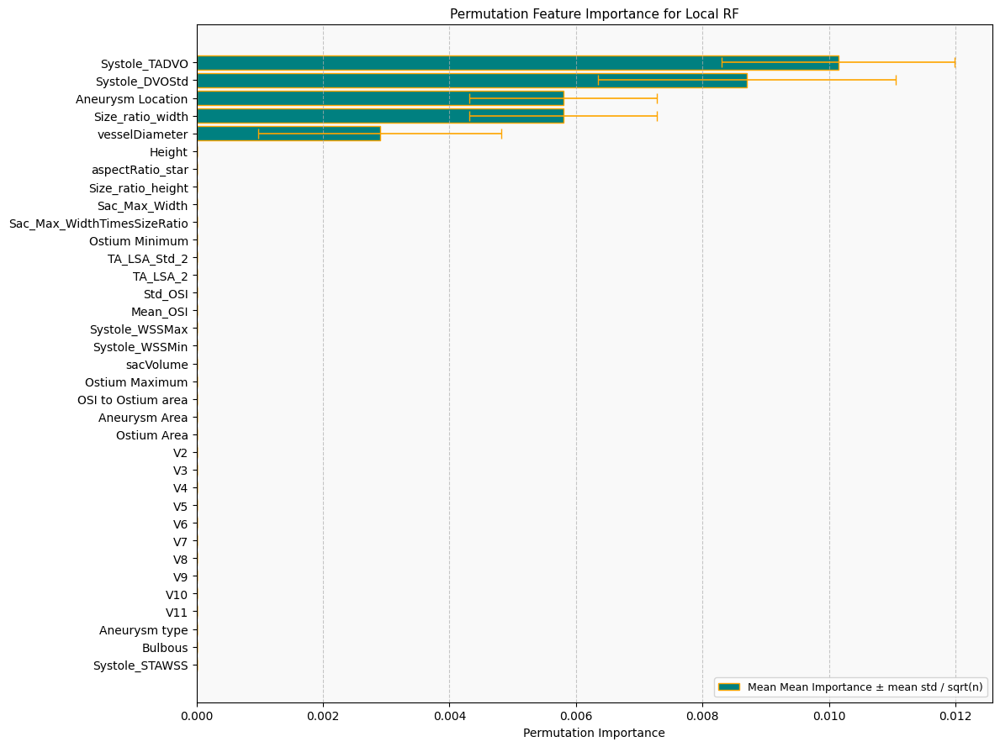

In [43]:
generate_feature_permutation_plots(models, X_test, y_test, "RF")

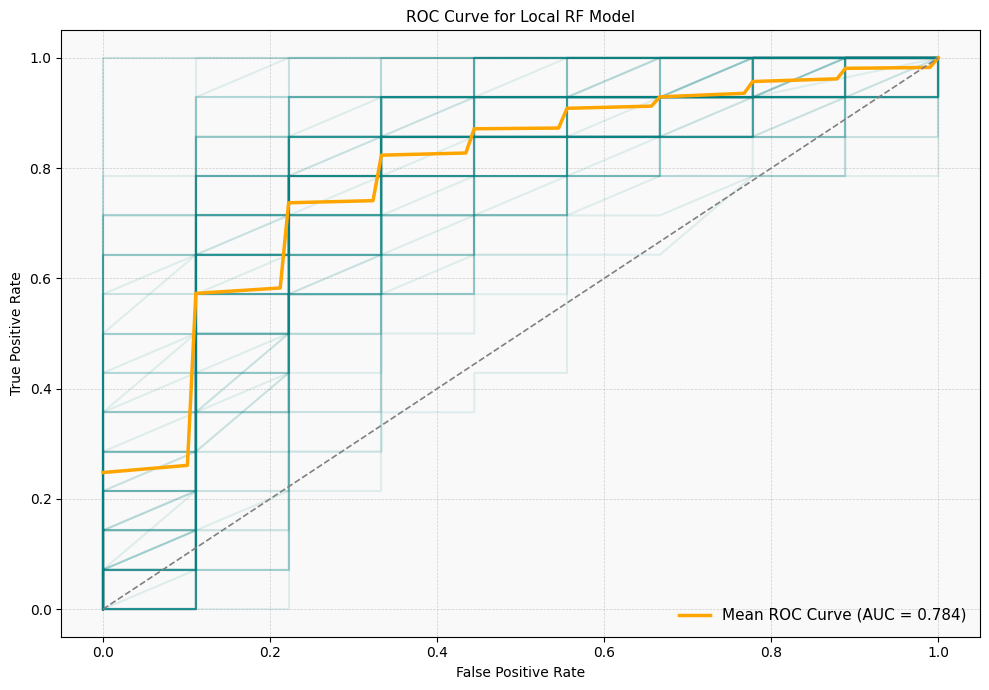

In [44]:
generate_roc_plots(roc_curves, metrics, "RF")

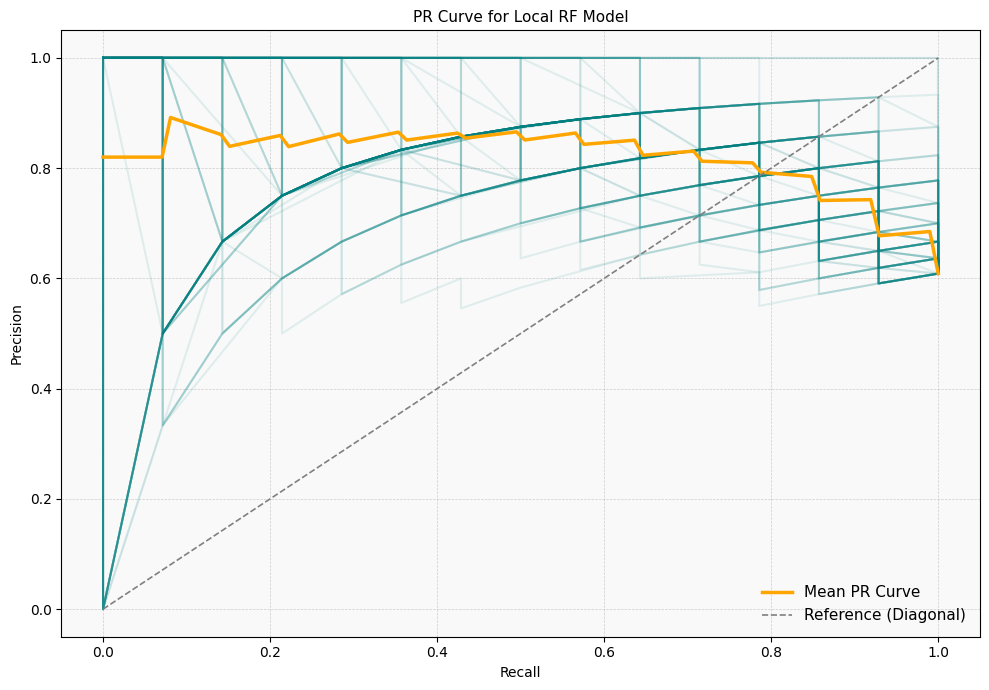

In [45]:
generate_pr_plots(precision_recall_curves, metrics, "RF")

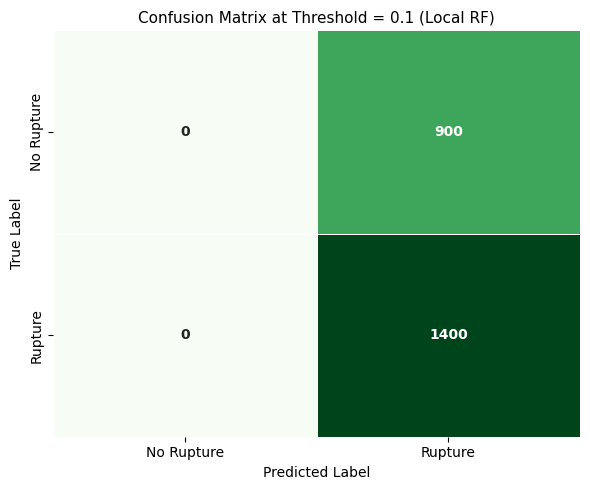

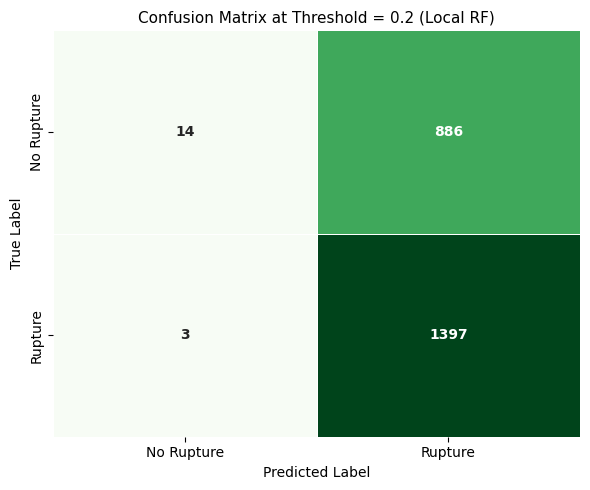

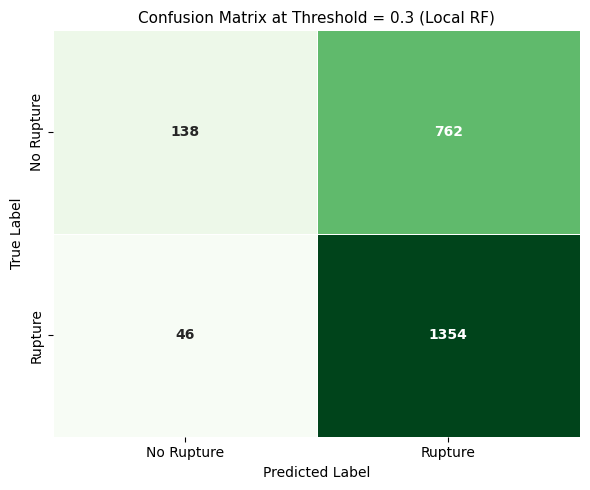

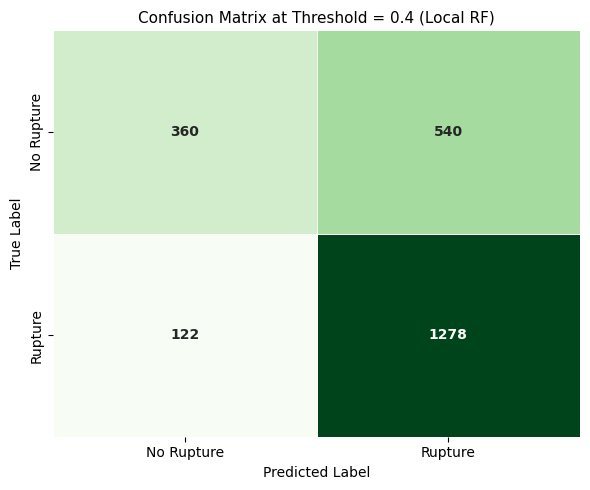

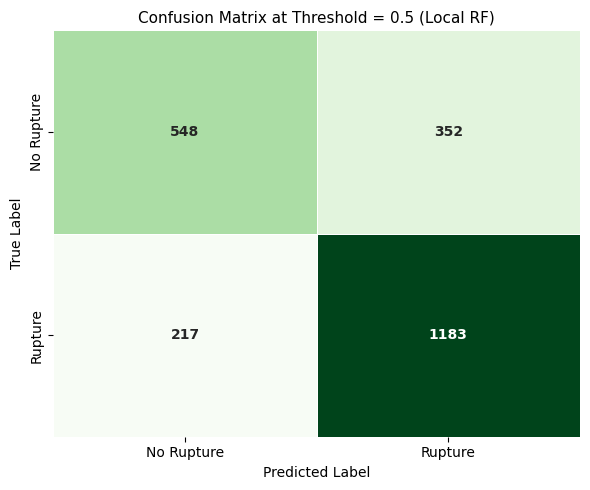

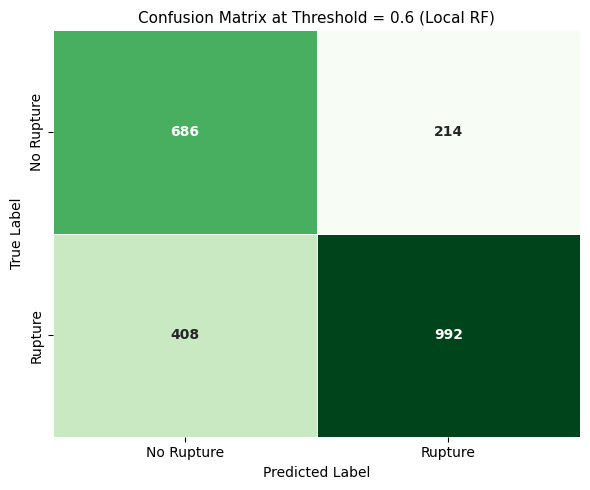

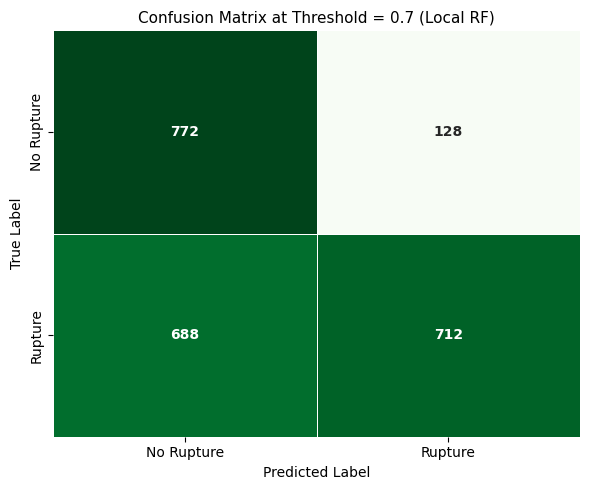

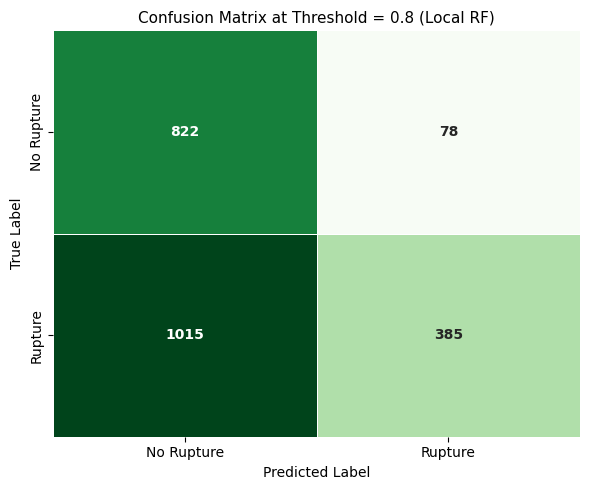

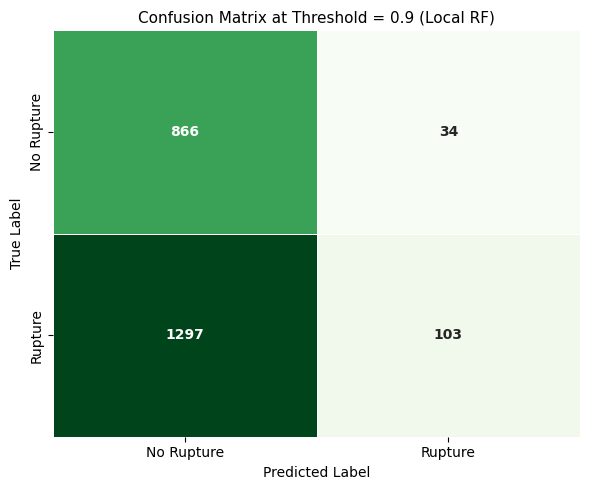

In [46]:
generate_confusian_matrix_plots(conf_matrices, "RF") 

### XGBoost

In [47]:
df = load_dataset()
df.pop("Case")

0       C0001_dicom
1       C0002_dicom
2             C0010
3             C0006
4             C0007
5             C0014
6             C0016
7             C0019
8             C0020
9        CH_case087
10           UM_003
11           UM_007
12           UM_009
13           UM_013
14           UM_015
15            C0057
16            C0060
17            C0055
18            C0024
19            C0026
20      C0049_dicom
21           C0028b
22            C0030
23            C0033
24            C0034
25      C0035_dicom
26      C0036_dicom
27            C0063
28            C0064
29      C0039_dicom
30      C0040_dicom
31      C0041_dicom
32      C0042_dicom
33      C0044_dicom
34            C0045
35            C0046
36            C0066
37            C0067
38            C0069
39            C0071
40            C0072
41     C0074a_dicom
42      C0075_dicom
43      C0076_dicom
44            C0078
45            C0079
46            C0086
47            C0089
48            C0090
49            C0093


### Other Paper's

In [48]:
#------------------------------------------------------------------------------  
#--- Extreme Gradient Boosting  
#------------------------------------------------------------------------------  
def test_XGBoost(num_iters, features, labels):    
    AUC_score = np.zeros(num_iters) 
    Accuracy_score = np.zeros(num_iters) 
    Precision_score = np.zeros(num_iters) 
    Recall_score = np.zeros(num_iters) 
    F1_score = np.zeros(num_iters) 
    
    for i in range(num_iters):
    
        #--get splits and best params
        np.random.RandomState(seed=1)
        t0 = time.time()         
        x_train,x_test,y_train,y_test=train_test_split(features,labels,test_size=0.1,random_state=i,stratify=labels) 
        xg=XGBClassifier(objective='binary:logistic' )
        PARAMETERS = {                      
                      "subsample":[0.9],
                      "colsample_bytree":[ 0.1],                
                      "max_depth":[7],
                       "eta":[0.1],
                      "min_child_weight":[1],
                      "learning_rate":[0.1,1],
                      "n_estimators":[1000],
                       "gamma":[0.1],
                        "reg_alpha":[0.1],
                        "use_label_encoder":['False'],
                        #'class_weight':['balanced'],
                        #'eval_metric':['error'] 
                     }
        eval_set = [(x_train, y_train),(x_test,y_test)]             
        grid = GridSearchCV(xg, param_grid=PARAMETERS, scoring='roc_auc', cv=10, verbose=0)#neg_log_loss,roc_auc
        grid.fit(x_train,y_train,eval_set=eval_set,early_stopping_rounds=200,eval_metric="error",verbose=0)
        y_pred=grid.predict(x_test) 
                    
        #--Get ROC-AUC Score
        Accuracy_score[i] = accuracy_score(y_test,y_pred)        
        AUC_score[i] = roc_auc_score(y_test, y_pred) #--Choose macro, micro etc. See Docs
        Precision_score[i] = precision_score(y_test,y_pred)
        Recall_score[i] = recall_score(y_test,y_pred)
        F1_score[i] = f1_score(y_test,y_pred)
       
        print("Iteration:", i, "Accuracy_Score:%.4f" % float(Accuracy_score[i]), "Predictions:", y_pred) 

    print("-------------------------")           
    print("Accuracy Score: %.4f" % np.mean(Accuracy_score))
    print("AUC Score: %.4f" % np.mean(AUC_score))
    print("Precision Score: %.4f" % np.mean(Precision_score))
    print("Recall Score: %.4f" % np.mean(Recall_score))
    print("F1 Score: %.4f" % np.mean(F1_score))
    print("-------------------------")      

    

In [49]:
train_cols_t = ['Aneurysm Location', 'Aneurysm type', 'Systole_STAWSS',
       'Systole_WSSMin', 'Systole_WSSMax', 'Mean_OSI', 'Std_OSI', 'TA_LSA_2',
       'TA_LSA_Std_2', 'Bulbous', 'sacVolume', 'Height', 'Sac_Max_Width',
       'Size_ratio_height', 'Size_ratio_width', 'aspectRatio_star',
       'vesselDiameter', 'Systole_TADVO', 'Systole_DVOStd', 'Ostium Minimum',
       'Ostium Maximum', 'Aneurysm Area', 'Ostium Area', 'V2', 'V3', 'V4',
       'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']
X_train_temp = df[train_cols_t].copy()
test_XGBoost(10, X_train_temp, df[["ruptureStatus"]].copy())

/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 0 Accuracy_Score:0.9167 Predictions: [0 0 1 1 0 1 1 1 1 0 1 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 1 Accuracy_Score:0.5833 Predictions: [1 1 1 1 1 1 0 1 1 1 0 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 2 Accuracy_Score:0.5833 Predictions: [1 1 1 0 1 0 1 1 1 1 1 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 3 Accuracy_Score:0.6667 Predictions: [0 0 0 0 1 1 1 0 1 1 1 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 4 Accuracy_Score:0.7500 Predictions: [0 1 1 1 0 0 1 1 1 1 0 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 5 Accuracy_Score:0.6667 Predictions: [1 0 0 0 1 1 0 1 1 1 0 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 6 Accuracy_Score:0.6667 Predictions: [0 0 0 1 1 1 1 1 0 1 0 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 7 Accuracy_Score:0.8333 Predictions: [1 0 1 0 0 1 0 1 1 0 1 1]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 8 Accuracy_Score:0.7500 Predictions: [0 1 0 1 1 0 0 1 1 0 1 0]


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

Iteration: 9 Accuracy_Score:0.7500 Predictions: [1 1 1 1 1 1 1 1 0 0 0 0]
-------------------------
Accuracy Score: 0.7167
AUC Score: 0.6971
Precision Score: 0.7408
Recall Score: 0.8143
F1 Score: 0.7714
-------------------------


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif is_categorical_dtype(dtype) and enable_categorical:
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:299: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:301: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

### Our's

In [50]:
from xgboost.sklearn import XGBClassifier

#############################################
# Identify columns and create dataframe  #
#############################################
standardized_num_features = df.columns.tolist()
categorical = ["Aneurysm type", "Aneurysm Location", "Bulbous"]
[standardized_num_features.remove(cat) for cat in categorical]
standardized_num_features.remove("ruptureStatus")

target_col = "ruptureStatus"
selected_features = standardized_num_features + categorical

X = df[selected_features].copy()

# feature scaling
X["Ostium Area"] = X["Ostium Area"]**(1/2.0)
X["Aneurysm Area"] = X["Aneurysm Area"]**(1/2.0)
X["sacVolume"] = X["sacVolume"]**(1/3.0)

# feature combos
X["OSI to Ostium area"] = X["Mean_OSI"] / (X["Ostium Area"]**2)
X["Sac_Max_WidthTimesSizeRatio"] = X["Sac_Max_Width"]*X["Size_ratio_width"]

standardized_num_features.append("OSI to Ostium area")
standardized_num_features.append("Sac_Max_WidthTimesSizeRatio")
selected_features = standardized_num_features + categorical

y = df[target_col].copy()

# Convert to numeric, coerce errors to NaN
for col in standardized_num_features:
    X[col] = pd.to_numeric(X[col], errors="coerce")



#############################################
# Perform 100 Iterations with Random Splits #
#############################################

n_splits = 100
test_scores = []
precisions = []
recalls = []
specificities = []
sensitivities = []
auc_scores = []
roc_curves = []
precision_recall_curves = []
conf_matrices = [[] for i in range(1, 10)] # different matrix for thresholds 0.1, ..., 0.9
f1s = []

from scipy.stats import t
def compute_confidence_interval(metric_list, confidence=0.95):
    metric_list = np.array(metric_list)
    n = len(metric_list)
    mean_val = np.mean(metric_list)
    std_err = np.std(metric_list, ddof=1) / np.sqrt(n)
    ci = t.interval(confidence, df=n-1, loc=mean_val, scale=std_err)
    return mean_val, ci, std_err

import optuna

sss = StratifiedShuffleSplit(n_splits=n_splits, test_size=0.2, random_state=42)
it = 1

biggest_model_id_existing = 0
for i in range(1, n_splits+1):
    dir_path = "./aneurysm_models_trained_locally/xgb"
    model_filename = f"model{i}.joblib"
    if os.path.exists(os.path.join(dir_path, model_filename)):
        biggest_model_id_existing += 1
    else:
        break

models = list(joblib.Parallel(n_jobs=-1)(
    joblib.delayed(joblib.load)(f"./aneurysm_models_trained_locally/xgb/model{i}.joblib") for i in range(1, biggest_model_id_existing+1)
))

splits_it = 1
train_idxs = []
test_idxs = []
if os.path.exists("./aneurysm_models_trained_locally/xgb/splits/"):
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/xgb/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/xgb/splits/test{splits_it}.npy"))
        splits_it += 1
else:
    os.makedirs("./aneurysm_models_trained_locally/xgb/splits/")
    for train_idx, test_idx in sss.split(X,y):
        np.save(f"./aneurysm_models_trained_locally/xgb/splits/training{splits_it}.npy", train_idx)
        np.save(f"./aneurysm_models_trained_locally/xgb/splits/test{splits_it}.npy", test_idx)
        splits_it += 1
    splits_it = 1
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/xgb/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/xgb/splits/test{splits_it}.npy"))
        splits_it += 1
            
for train_idx, test_idx in list(zip(train_idxs, test_idxs)):
    dir_path = "./aneurysm_models_trained_locally/xgb"
    model_filename = f"model{it}.joblib"
    print(f"Running iteration {it}")
    X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
    y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
    
    if not os.path.exists(os.path.join(dir_path, model_filename)):
        print("Getting best params")
        def objective(trial):
            val_aucs = []
            train_aucs = []
    
            cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=6789)
            for train_idx, val_idx in cv.split(X_train, y_train):
                X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
                y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]
                
                #############################################
                # Build ColumnTransformer                 #
                #############################################
                preprocessor = ColumnTransformer([
                    ("stand_nums",
                     Pipeline([
                         ("imputer", SimpleImputer(strategy="median")),
                         ("scaler", StandardScaler())
                     ]),
                     standardized_num_features
                    ),
                    ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
                ])
    
                #############################################
                # Define Model Pipeline & Parameters       #
                #############################################
                pipeline = Pipeline([
                    ("preprocessor", preprocessor),
                    ("classifier", XGBClassifier(objective='binary:logistic', gamma=trial.suggest_float("G", 1e-3, 1e3, log=True), n_estimators=trial.suggest_int("N", 5, 100), learning_rate=trial.suggest_float("LR", 1e-3, 1e3, log=True), max_depth=trial.suggest_int("MD", 5, 40)))
                ])
    
                pipeline.fit(X_tr, y_tr)
                
    
                y_val_pred = pipeline.predict_proba(X_val)[:, 1]
                y_tr_pred = pipeline.predict_proba(X_tr)[:, 1]
    
                val_auc = roc_auc_score(y_val, y_val_pred)
                train_auc = roc_auc_score(y_tr, y_tr_pred)
    
                val_aucs.append(val_auc)
                train_aucs.append(train_auc)

            mean_val_auc = np.mean(val_aucs)
            mean_train_auc = np.mean(train_aucs)
            auc_diff = np.mean(np.abs(np.array(val_aucs) - np.array(train_auc)))  # Overfitting penalty
    
            return mean_val_auc - 0.1*auc_diff

        study_name = "XG" + str(int(time.time() * 1000))
        optuna.create_study(
            study_name=study_name, 
            directions=['maximize'], # Optimization directions
            sampler=TPESampler(seed=42), # Use the NSGAIII sampler
            pruner=MedianPruner(n_startup_trials=10, n_min_trials=2), # Use the MedianPruner
            load_if_exists=True, # Load study if it exists
            storage='mysql://root@localhost/optuna' # Save the study in SQLite
        )
        
        from concurrent.futures import ThreadPoolExecutor
        def run_optuna_study(study_name):
            study = optuna.load_study(
                study_name=study_name, storage="mysql://root@localhost/optuna"
            )
            study.optimize(objective, n_trials=1)
            
        with ThreadPoolExecutor(max_workers=16) as executor:
            res = []
            for i in range(16):
                res.append(executor.submit(run_optuna_study, study_name))
            for r in res:
                r.result()
            
        best_params = optuna.load_study(
            study_name=study_name, storage="mysql://root@localhost/optuna"
        ).best_params
        
    
        #############################################
        # Build ColumnTransformer                 #
        #############################################
        preprocessor = ColumnTransformer([
            ("stand_nums",
             Pipeline([
                 ("imputer", SimpleImputer(strategy="median")),
                 ("scaler", StandardScaler())
             ]),
             standardized_num_features
            ),
            ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
        ])
    
        #############################################
        # Define Model Pipeline & Parameters       #
        #############################################
        pipeline = Pipeline([
            ("preprocessor", preprocessor),
            ("classifier", XGBClassifier(objective='binary:logistic', gamma=best_params["G"], learning_rate=best_params["LR"], max_depth=best_params["MD"], n_estimators=best_params["N"]))
        ])
        
        pipeline.fit(X_train, y_train)

        best_model = pipeline
        models.append(best_model)
        print("Best hyperparameters:", best_params)
        
        # save model
        os.makedirs(dir_path, exist_ok=True)
        joblib.dump(models[-1], os.path.join(dir_path, model_filename))
    else:
        pipeline = joblib.load(os.path.join(dir_path, model_filename))
        best_model = pipeline
        
    # Accuracy
    y_pred = best_model.predict(X_test)
    test_score = accuracy_score(y_test, y_pred)
    test_scores.append(test_score)
    
    # Precision & Recall
    precision = precision_score(y_test, y_pred, average="binary")  # Adjust if multiclass
    recall = recall_score(y_test, y_pred, average="binary")
    precisions.append(precision)
    recalls.append(recall)
    f1s.append(2.0*precision*recall / (precision + recall))
    
    # Sensitivity & Specificity
    cm = confusion_matrix(y_test, y_pred)
    tn, fp, fn, tp = cm.ravel()  # Extract TP, TN, FP, FN
    specificity = tn / (tn + fp) if (tn + fp) != 0 else 0
    sensitivity = tp / (tp + fn) if (tp + fn) != 0 else 0
    specificities.append(specificity)
    sensitivities.append(sensitivity)
    
    test_score = best_model.score(X_test, y_test)
    test_scores.append(test_score)
    
    # Get predicted probabilities for ROC curve
    y_probs = best_model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_probs)
    roc_curves.append((fpr, tpr))
    auc_score = auc(fpr, tpr)
    auc_scores.append(auc_score)

    precision_recall_curves.append(precision_recall_curve(y_test, best_model.predict_proba(X_test)[:, 1]))

    # Confusion Matrix
    for k in range(len(conf_matrices)):
        y_pred = (best_model.predict_proba(X_test)[:, 1] > 0.1*(k+1)).astype(int)
        conf_matrices[k].append(confusion_matrix(y_test, y_pred))    

    it += 1


# Compute all metric statistics
metrics = {
    "Accuracy": compute_confidence_interval(test_scores),
    "Precision": compute_confidence_interval(precisions),
    "Recall (Sensitivity)": compute_confidence_interval(recalls),
    "Specificity": compute_confidence_interval(specificities),
    "AUC (Area Under ROC)": compute_confidence_interval(auc_scores),
    "F1 Score": compute_confidence_interval(f1s),
}

# Print results
for metric_name, (mean_val, (ci_lower, ci_upper), std) in metrics.items():
    print(f"{metric_name}: {mean_val:.4f}/{std:.4f} (95% CI: {ci_lower:.4f}, {ci_upper:.4f})")

[I 2025-04-07 15:19:01,671] A new study created in RDB with name: XG1744053541553


Running iteration 1
Getting best params


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sp

Best hyperparameters: {'G': 0.083404110632624, 'N': 39, 'LR': 1.0632392590127386, 'MD': 21}
Running iteration 2
Getting best params


[I 2025-04-07 15:19:12,285] A new study created in RDB with name: XG1744053552202
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0012943490800336923, 'N': 55, 'LR': 0.2164515463297904, 'MD': 39}
Running iteration 3
Getting best params


[I 2025-04-07 15:19:22,746] A new study created in RDB with name: XG1744053562375
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.02101692695472544, 'N': 96, 'LR': 0.15086115217269663, 'MD': 13}
Running iteration 4
Getting best params


[I 2025-04-07 15:19:32,454] A new study created in RDB with name: XG1744053572377
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.03831044483778184, 'N': 12, 'LR': 0.20154755896455695, 'MD': 39}
Running iteration 5
Getting best params


[I 2025-04-07 15:19:47,159] A new study created in RDB with name: XG1744053587084
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.07341739144002687, 'N': 76, 'LR': 0.09028147595245582, 'MD': 20}
Running iteration 6
Getting best params


[I 2025-04-07 15:20:04,606] A new study created in RDB with name: XG1744053604535
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 4.068106495712833, 'N': 84, 'LR': 0.014462199007528986, 'MD': 26}
Running iteration 7
Getting best params


[I 2025-04-07 15:20:19,633] A new study created in RDB with name: XG1744053619555
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.22953709800151725, 'N': 11, 'LR': 0.5166643110922314, 'MD': 16}
Running iteration 8
Getting best params


[I 2025-04-07 15:20:29,973] A new study created in RDB with name: XG1744053629898
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.002108882049356464, 'N': 43, 'LR': 1.5147990628664139, 'MD': 21}
Running iteration 9
Getting best params


[I 2025-04-07 15:20:42,217] A new study created in RDB with name: XG1744053642143
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.07584302580975463, 'N': 73, 'LR': 1.680418196305937, 'MD': 38}
Running iteration 10
Getting best params


[I 2025-04-07 15:20:52,408] A new study created in RDB with name: XG1744053652332
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0017220277406703437, 'N': 84, 'LR': 0.021745148432643614, 'MD': 36}
Running iteration 11
Getting best params


[I 2025-04-07 15:21:03,133] A new study created in RDB with name: XG1744053663059
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0242286463771539, 'N': 84, 'LR': 0.3295068643501559, 'MD': 15}
Running iteration 12
Getting best params


[I 2025-04-07 15:21:14,572] A new study created in RDB with name: XG1744053674499
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 1.040000548160822, 'N': 65, 'LR': 0.1953403418191196, 'MD': 21}
Running iteration 13
Getting best params


[I 2025-04-07 15:21:29,683] A new study created in RDB with name: XG1744053689608
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.03326669600167881, 'N': 57, 'LR': 0.13126322622789854, 'MD': 36}
Running iteration 14
Getting best params


[I 2025-04-07 15:21:41,392] A new study created in RDB with name: XG1744053701312
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.31042096420828574, 'N': 60, 'LR': 0.013652661543352965, 'MD': 10}
Running iteration 15
Getting best params


[I 2025-04-07 15:21:51,633] A new study created in RDB with name: XG1744053711555
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.1278270225321136, 'N': 65, 'LR': 0.05105473912633056, 'MD': 20}
Running iteration 16
Getting best params


[I 2025-04-07 15:22:01,051] A new study created in RDB with name: XG1744053720981
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.5129716360955872, 'N': 45, 'LR': 0.41808353887066424, 'MD': 34}
Running iteration 17
Getting best params


[I 2025-04-07 15:22:13,429] A new study created in RDB with name: XG1744053733348
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.011521084802566941, 'N': 54, 'LR': 0.07245214009156972, 'MD': 10}
Running iteration 18
Getting best params


[I 2025-04-07 15:22:25,403] A new study created in RDB with name: XG1744053745329
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.30905603551339567, 'N': 58, 'LR': 0.10744626114573116, 'MD': 37}
Running iteration 19
Getting best params


[I 2025-04-07 15:22:36,001] A new study created in RDB with name: XG1744053755926
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.008344258126409541, 'N': 88, 'LR': 0.3396439797133094, 'MD': 6}
Running iteration 20
Getting best params


[I 2025-04-07 15:22:46,840] A new study created in RDB with name: XG1744053766771
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 2.4313776670236242, 'N': 65, 'LR': 0.1586342699735576, 'MD': 19}
Running iteration 21
Getting best params


[I 2025-04-07 15:22:56,777] A new study created in RDB with name: XG1744053776705
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.004889384090960846, 'N': 46, 'LR': 0.4477392583168268, 'MD': 9}
Running iteration 22
Getting best params


[I 2025-04-07 15:23:13,454] A new study created in RDB with name: XG1744053793378
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 8.034066404570865, 'N': 45, 'LR': 0.004986802161437319, 'MD': 36}
Running iteration 23
Getting best params


[I 2025-04-07 15:23:25,731] A new study created in RDB with name: XG1744053805660
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.09085331895749091, 'N': 82, 'LR': 0.2770448567405968, 'MD': 23}
Running iteration 24
Getting best params


[I 2025-04-07 15:23:34,634] A new study created in RDB with name: XG1744053814564
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.027437713201477913, 'N': 100, 'LR': 0.12064064325779389, 'MD': 38}
Running iteration 25
Getting best params


[I 2025-04-07 15:23:47,951] A new study created in RDB with name: XG1744053827877
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.5796586766420545, 'N': 83, 'LR': 0.024501269630685597, 'MD': 22}
Running iteration 26
Getting best params


[I 2025-04-07 15:24:00,636] A new study created in RDB with name: XG1744053840562
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.010067285711260397, 'N': 57, 'LR': 0.3855574324421433, 'MD': 14}
Running iteration 27
Getting best params


[I 2025-04-07 15:24:11,144] A new study created in RDB with name: XG1744053851073
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.010756061388907577, 'N': 7, 'LR': 0.10255211188818446, 'MD': 13}
Running iteration 28
Getting best params


[I 2025-04-07 15:24:21,598] A new study created in RDB with name: XG1744053861528
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.11381957767346476, 'N': 33, 'LR': 0.8206890073124147, 'MD': 22}
Running iteration 29
Getting best params


[I 2025-04-07 15:24:32,533] A new study created in RDB with name: XG1744053872463
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.02817090758042813, 'N': 55, 'LR': 0.30862572908052477, 'MD': 5}
Running iteration 30
Getting best params


[I 2025-04-07 15:24:45,897] A new study created in RDB with name: XG1744053885822
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.005292087460427182, 'N': 16, 'LR': 1.485264144190006, 'MD': 31}
Running iteration 31
Getting best params


[I 2025-04-07 15:24:56,606] A new study created in RDB with name: XG1744053896535
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.3537360521532834, 'N': 71, 'LR': 0.04923740040748932, 'MD': 28}
Running iteration 32
Getting best params


[I 2025-04-07 15:25:07,377] A new study created in RDB with name: XG1744053907298
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.05537266144757905, 'N': 96, 'LR': 0.15496454473292834, 'MD': 32}
Running iteration 33
Getting best params


[I 2025-04-07 15:25:19,302] A new study created in RDB with name: XG1744053919225
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.7352007629653827, 'N': 37, 'LR': 0.05623719867085199, 'MD': 5}
Running iteration 34
Getting best params


[I 2025-04-07 15:25:30,204] A new study created in RDB with name: XG1744053930137
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.014242828171461107, 'N': 77, 'LR': 1.7901568965042929, 'MD': 40}
Running iteration 35
Getting best params


[I 2025-04-07 15:25:42,050] A new study created in RDB with name: XG1744053941978
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.07751672802133795, 'N': 81, 'LR': 0.19179288747631223, 'MD': 14}
Running iteration 36
Getting best params


[I 2025-04-07 15:25:54,506] A new study created in RDB with name: XG1744053954434
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.05418334388942675, 'N': 62, 'LR': 11.155968404799436, 'MD': 12}
Running iteration 37
Getting best params


[I 2025-04-07 15:26:06,100] A new study created in RDB with name: XG1744053966025
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.6655759802047905, 'N': 68, 'LR': 1.2743187645002045, 'MD': 16}
Running iteration 38
Getting best params


[I 2025-04-07 15:26:18,558] A new study created in RDB with name: XG1744053978491
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.5204175857230695, 'N': 95, 'LR': 0.355143145665117, 'MD': 6}
Running iteration 39
Getting best params


[I 2025-04-07 15:26:31,063] A new study created in RDB with name: XG1744053990990
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.21103276932567291, 'N': 65, 'LR': 0.07832703012049785, 'MD': 22}
Running iteration 40
Getting best params


[I 2025-04-07 15:26:40,340] A new study created in RDB with name: XG1744054000273
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.004043681285186648, 'N': 65, 'LR': 0.039037045048233736, 'MD': 37}
Running iteration 41
Getting best params


[I 2025-04-07 15:26:55,562] A new study created in RDB with name: XG1744054015491
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0010708955456813433, 'N': 32, 'LR': 1.1049888296307706, 'MD': 38}
Running iteration 42
Getting best params


[I 2025-04-07 15:27:06,310] A new study created in RDB with name: XG1744054026233
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.004665567714807126, 'N': 72, 'LR': 0.5767124841783644, 'MD': 11}
Running iteration 43
Getting best params


[I 2025-04-07 15:27:17,389] A new study created in RDB with name: XG1744054037309
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.257897282904685, 'N': 95, 'LR': 0.0016411118570638166, 'MD': 17}
Running iteration 44
Getting best params


[I 2025-04-07 15:27:28,254] A new study created in RDB with name: XG1744054048182
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 1.430174585933475, 'N': 46, 'LR': 1.371821084162809, 'MD': 39}
Running iteration 45
Getting best params


[I 2025-04-07 15:27:39,652] A new study created in RDB with name: XG1744054059585
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.018312134570955294, 'N': 74, 'LR': 0.02972748693327448, 'MD': 29}
Running iteration 46
Getting best params


[I 2025-04-07 15:27:55,078] A new study created in RDB with name: XG1744054075002
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.29868887664754346, 'N': 73, 'LR': 0.03884518454417705, 'MD': 20}
Running iteration 47
Getting best params


[I 2025-04-07 15:28:09,259] A new study created in RDB with name: XG1744054089184
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.27398766394255347, 'N': 24, 'LR': 0.1153093378417, 'MD': 35}
Running iteration 48
Getting best params


[I 2025-04-07 15:28:22,715] A new study created in RDB with name: XG1744054102632
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.00470556280610761, 'N': 46, 'LR': 0.6430234966116576, 'MD': 23}
Running iteration 49
Getting best params


[I 2025-04-07 15:28:35,758] A new study created in RDB with name: XG1744054115685
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 1.8278996746481004, 'N': 78, 'LR': 0.5010465529783812, 'MD': 37}
Running iteration 50
Getting best params


[I 2025-04-07 15:28:50,138] A new study created in RDB with name: XG1744054130067
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.016398311368487142, 'N': 89, 'LR': 0.33696305194383297, 'MD': 38}
Running iteration 51
Getting best params


[I 2025-04-07 15:29:07,518] A new study created in RDB with name: XG1744054147447
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0013580129860146493, 'N': 97, 'LR': 0.027557147378602546, 'MD': 10}
Running iteration 52
Getting best params


[I 2025-04-07 15:29:20,442] A new study created in RDB with name: XG1744054160366
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.005332600746908171, 'N': 53, 'LR': 0.4252885972142175, 'MD': 22}
Running iteration 53
Getting best params


[I 2025-04-07 15:29:34,287] A new study created in RDB with name: XG1744054174214
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.062008234081131514, 'N': 40, 'LR': 0.2197654512247798, 'MD': 30}
Running iteration 54
Getting best params


[I 2025-04-07 15:29:48,099] A new study created in RDB with name: XG1744054188030
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.006232925377924877, 'N': 91, 'LR': 0.4722175087452764, 'MD': 33}
Running iteration 55
Getting best params


[I 2025-04-07 15:29:58,964] A new study created in RDB with name: XG1744054198892
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.01158705320098957, 'N': 89, 'LR': 0.7355585824558998, 'MD': 23}
Running iteration 56
Getting best params


[I 2025-04-07 15:30:16,377] A new study created in RDB with name: XG1744054216309
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.00243412419800421, 'N': 94, 'LR': 0.01720846237839369, 'MD': 36}
Running iteration 57
Getting best params


[I 2025-04-07 15:30:28,817] A new study created in RDB with name: XG1744054228747
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 3.100857718113782, 'N': 59, 'LR': 6.649467995148586, 'MD': 39}
Running iteration 58
Getting best params


[I 2025-04-07 15:30:40,848] A new study created in RDB with name: XG1744054240782
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0023696292010672586, 'N': 55, 'LR': 1.5214151400232099, 'MD': 34}
Running iteration 59
Getting best params


[I 2025-04-07 15:30:53,453] A new study created in RDB with name: XG1744054253386
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 1.1104511258495395, 'N': 38, 'LR': 0.05520875634869721, 'MD': 31}
Running iteration 60
Getting best params


[I 2025-04-07 15:31:03,788] A new study created in RDB with name: XG1744054263718
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0026953466454726206, 'N': 10, 'LR': 2.67211552151222, 'MD': 11}
Running iteration 61
Getting best params


[I 2025-04-07 15:31:13,792] A new study created in RDB with name: XG1744054273416
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 4.663692338624089, 'N': 52, 'LR': 0.009757909544995384, 'MD': 38}
Running iteration 62
Getting best params


[I 2025-04-07 15:31:27,083] A new study created in RDB with name: XG1744054287012
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 8.007630619043098, 'N': 60, 'LR': 1.612590757029529, 'MD': 39}
Running iteration 63
Getting best params


[I 2025-04-07 15:31:39,022] A new study created in RDB with name: XG1744054298950
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 1.5422602657439861, 'N': 98, 'LR': 0.05850872999204724, 'MD': 18}
Running iteration 64
Getting best params


[I 2025-04-07 15:31:53,936] A new study created in RDB with name: XG1744054313863
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.006549985951394633, 'N': 91, 'LR': 0.14288896470630408, 'MD': 36}
Running iteration 65
Getting best params


[I 2025-04-07 15:32:06,202] A new study created in RDB with name: XG1744054326132
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.016379314826482073, 'N': 91, 'LR': 0.13135220054214664, 'MD': 7}
Running iteration 66
Getting best params


[I 2025-04-07 15:32:16,013] A new study created in RDB with name: XG1744054335943
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0025321075446703553, 'N': 95, 'LR': 0.04570982023666622, 'MD': 32}
Running iteration 67
Getting best params


[I 2025-04-07 15:32:26,287] A new study created in RDB with name: XG1744054346215
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.1409960002541209, 'N': 38, 'LR': 0.18695550122263008, 'MD': 6}
Running iteration 68
Getting best params


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sp

Best hyperparameters: {'G': 0.534512278991336, 'N': 35, 'LR': 0.12910823357134096, 'MD': 39}
Running iteration 69
Getting best params


[I 2025-04-07 15:32:52,064] A new study created in RDB with name: XG1744054371988
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.20483658083570594, 'N': 75, 'LR': 1.590621095356153, 'MD': 6}
Running iteration 70
Getting best params


[I 2025-04-07 15:33:02,733] A new study created in RDB with name: XG1744054382665
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.005776474590324763, 'N': 51, 'LR': 0.4972644408320829, 'MD': 19}
Running iteration 71
Getting best params


[I 2025-04-07 15:33:12,696] A new study created in RDB with name: XG1744054392619
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.008464502361975613, 'N': 69, 'LR': 0.057928912461025245, 'MD': 23}
Running iteration 72
Getting best params


[I 2025-04-07 15:33:24,379] A new study created in RDB with name: XG1744054404286
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.09384861120181265, 'N': 96, 'LR': 0.042151223139404156, 'MD': 34}
Running iteration 73
Getting best params


[I 2025-04-07 15:33:37,453] A new study created in RDB with name: XG1744054417378
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.003954821546083167, 'N': 13, 'LR': 0.15200168678225223, 'MD': 26}
Running iteration 74
Getting best params


[I 2025-04-07 15:33:51,421] A new study created in RDB with name: XG1744054431347
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 1.5375347978636733, 'N': 15, 'LR': 0.14770232482848156, 'MD': 31}
Running iteration 75
Getting best params


[I 2025-04-07 15:34:03,972] A new study created in RDB with name: XG1744054443903
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 4.911838440277957, 'N': 50, 'LR': 0.032976966381969196, 'MD': 15}
Running iteration 76
Getting best params


[I 2025-04-07 15:34:15,440] A new study created in RDB with name: XG1744054455370
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.19391870478599404, 'N': 19, 'LR': 0.22516012892983855, 'MD': 11}
Running iteration 77
Getting best params


[I 2025-04-07 15:34:28,131] A new study created in RDB with name: XG1744054468062
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0377381356271351, 'N': 50, 'LR': 0.11238751275379825, 'MD': 27}
Running iteration 78
Getting best params


[I 2025-04-07 15:34:41,814] A new study created in RDB with name: XG1744054481742
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.24694662022518452, 'N': 31, 'LR': 0.05255291487025287, 'MD': 23}
Running iteration 79
Getting best params


[I 2025-04-07 15:34:53,539] A new study created in RDB with name: XG1744054493469
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.02124854316078075, 'N': 42, 'LR': 0.1062744783778966, 'MD': 21}
Running iteration 80
Getting best params


[I 2025-04-07 15:35:02,875] A new study created in RDB with name: XG1744054502805
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0010262918922817207, 'N': 47, 'LR': 3.4964334879536976, 'MD': 25}
Running iteration 81
Getting best params


[I 2025-04-07 15:35:15,556] A new study created in RDB with name: XG1744054515488
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.024216390319490088, 'N': 40, 'LR': 0.05138915254927815, 'MD': 13}
Running iteration 82
Getting best params


[I 2025-04-07 15:35:26,386] A new study created in RDB with name: XG1744054526316
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.002645414270099246, 'N': 86, 'LR': 0.012584904432952793, 'MD': 27}
Running iteration 83
Getting best params


[I 2025-04-07 15:35:36,683] A new study created in RDB with name: XG1744054536614
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0015492539126710292, 'N': 78, 'LR': 0.012960408038475932, 'MD': 32}
Running iteration 84
Getting best params


[I 2025-04-07 15:35:47,988] A new study created in RDB with name: XG1744054547916
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 8.715367732144871, 'N': 53, 'LR': 0.15967765989888646, 'MD': 9}
Running iteration 85
Getting best params


[I 2025-04-07 15:36:01,363] A new study created in RDB with name: XG1744054561295
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.01267632267338009, 'N': 8, 'LR': 1.2979059981372758, 'MD': 36}
Running iteration 86
Getting best params


[I 2025-04-07 15:36:12,737] A new study created in RDB with name: XG1744054572664
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 2.9034647038687575, 'N': 73, 'LR': 134.6794607405404, 'MD': 37}
Running iteration 87
Getting best params


[I 2025-04-07 15:36:23,984] A new study created in RDB with name: XG1744054583908
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.5185113812115569, 'N': 74, 'LR': 0.7101416640272515, 'MD': 38}
Running iteration 88
Getting best params


[I 2025-04-07 15:36:36,427] A new study created in RDB with name: XG1744054596353
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.10975161651344312, 'N': 26, 'LR': 0.1228353754468989, 'MD': 24}
Running iteration 89
Getting best params


[I 2025-04-07 15:36:48,361] A new study created in RDB with name: XG1744054608287
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.015780082503711004, 'N': 33, 'LR': 0.03139680817572864, 'MD': 21}
Running iteration 90
Getting best params


[I 2025-04-07 15:37:03,182] A new study created in RDB with name: XG1744054623111
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 2.7828434665274577, 'N': 97, 'LR': 0.030008736468342897, 'MD': 15}
Running iteration 91
Getting best params


[I 2025-04-07 15:37:15,627] A new study created in RDB with name: XG1744054635557
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.7753538904583639, 'N': 77, 'LR': 0.19313468046331053, 'MD': 39}
Running iteration 92
Getting best params


[I 2025-04-07 15:37:28,438] A new study created in RDB with name: XG1744054648367
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.47259893918328927, 'N': 31, 'LR': 0.04280304792975876, 'MD': 20}
Running iteration 93
Getting best params


[I 2025-04-07 15:37:40,134] A new study created in RDB with name: XG1744054660056
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.0033919399464920155, 'N': 86, 'LR': 0.014290076600889837, 'MD': 34}
Running iteration 94
Getting best params


[I 2025-04-07 15:37:53,476] A new study created in RDB with name: XG1744054673403
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.06701961392577596, 'N': 68, 'LR': 0.026579242347689786, 'MD': 15}
Running iteration 95
Getting best params


[I 2025-04-07 15:38:07,245] A new study created in RDB with name: XG1744054687166
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.5247876632597349, 'N': 19, 'LR': 0.1536665334032881, 'MD': 35}
Running iteration 96
Getting best params


[I 2025-04-07 15:38:24,166] A new study created in RDB with name: XG1744054704099
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.022595059862363275, 'N': 100, 'LR': 0.025601525865558968, 'MD': 12}
Running iteration 97
Getting best params


[I 2025-04-07 15:38:37,761] A new study created in RDB with name: XG1744054717693
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 1.6317836202676048, 'N': 94, 'LR': 0.025951278088119787, 'MD': 26}
Running iteration 98
Getting best params


[I 2025-04-07 15:38:47,980] A new study created in RDB with name: XG1744054727907
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 6.38448159592665, 'N': 75, 'LR': 0.001828158756207943, 'MD': 22}
Running iteration 99
Getting best params


[I 2025-04-07 15:38:58,634] A new study created in RDB with name: XG1744054738568
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.017772393125747667, 'N': 56, 'LR': 0.06559081436643521, 'MD': 27}
Running iteration 100
Getting best params


[I 2025-04-07 15:39:12,507] A new study created in RDB with name: XG1744054752429
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):
/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed 

Best hyperparameters: {'G': 0.005948084804616991, 'N': 54, 'LR': 0.09684876759140155, 'MD': 27}
Accuracy: 0.6996/0.0068 (95% CI: 0.6862, 0.7130)
Precision: 0.7460/0.0080 (95% CI: 0.7301, 0.7618)
Recall (Sensitivity): 0.7757/0.0144 (95% CI: 0.7471, 0.8043)
Specificity: 0.5811/0.0162 (95% CI: 0.5489, 0.6134)
AUC (Area Under ROC): 0.7377/0.0104 (95% CI: 0.7172, 0.7582)
F1 Score: 0.7535/0.0095 (95% CI: 0.7346, 0.7724)


/Users/jasoncarlson/anaconda3/envs/paper1env/lib/python3.10/site-packages/xgboost/data.py:427: DeprecationWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):


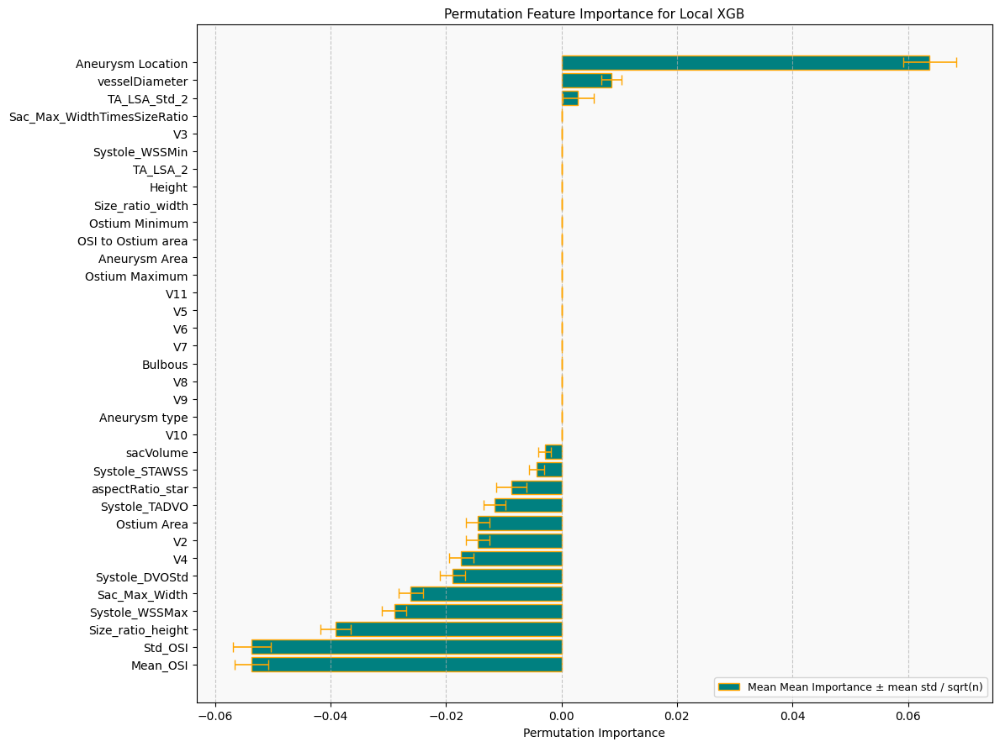

In [51]:
generate_feature_permutation_plots(models, X_test, y_test, "XGB")

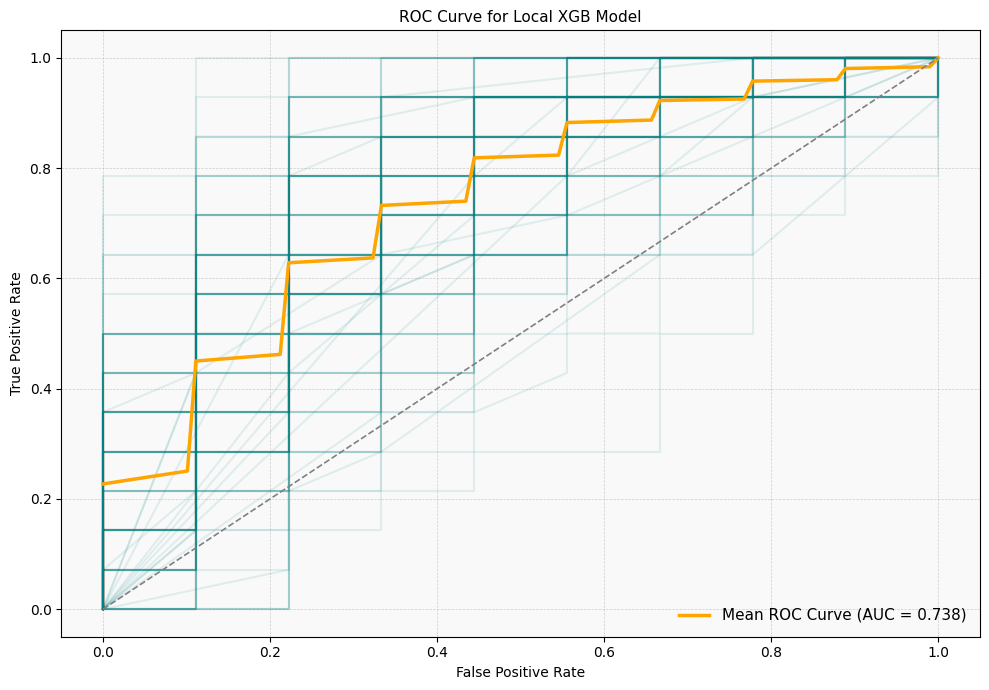

In [52]:
generate_roc_plots(roc_curves, metrics, "XGB")

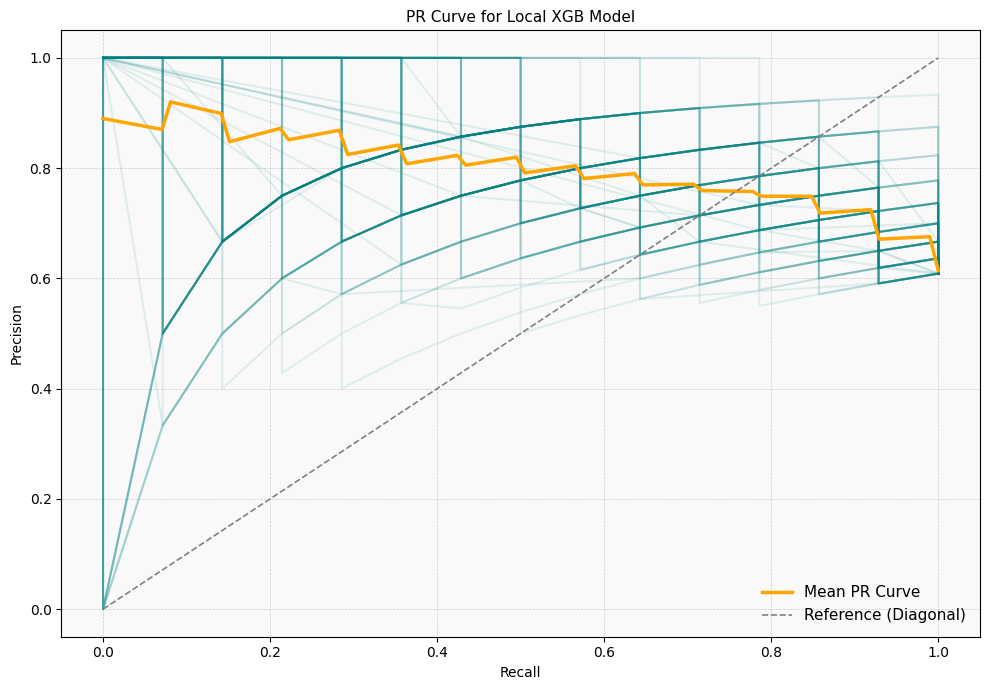

In [53]:
generate_pr_plots(precision_recall_curves, metrics, "XGB")

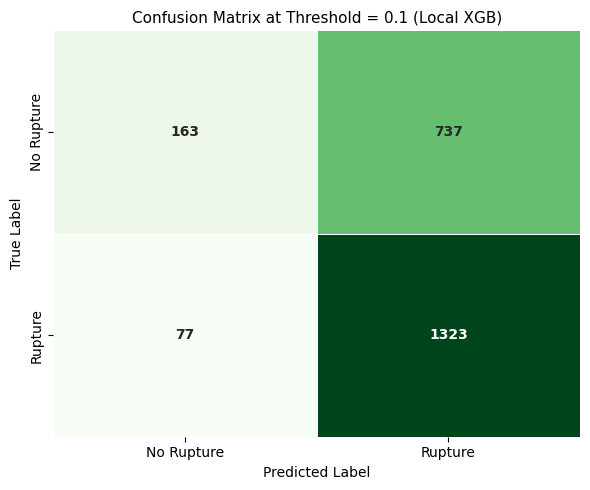

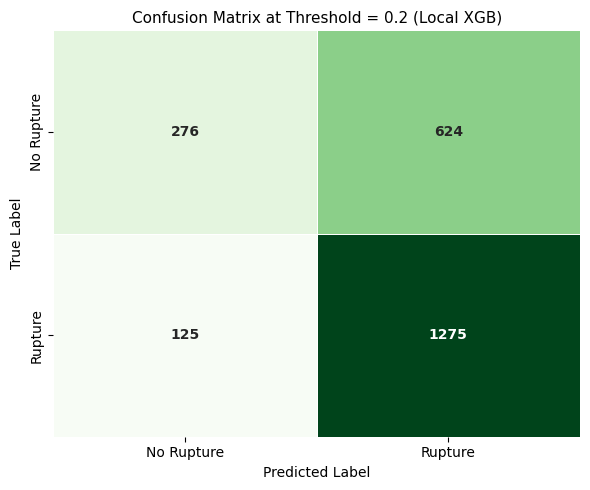

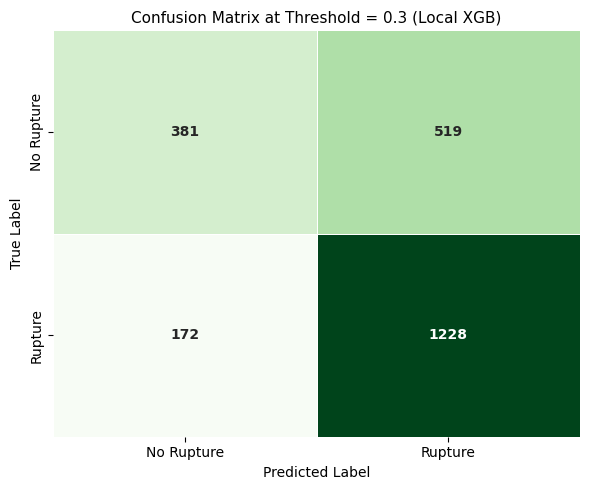

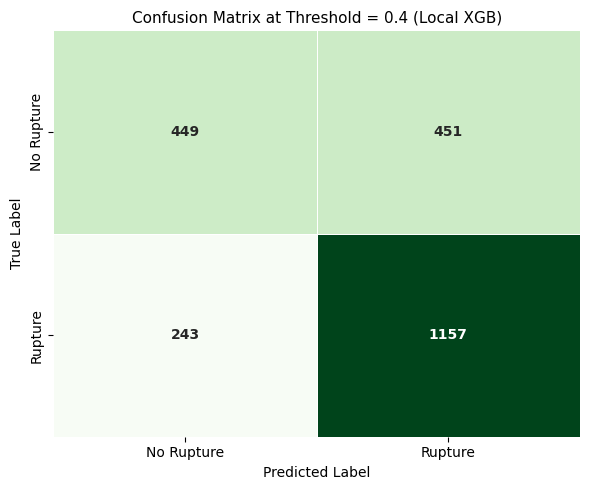

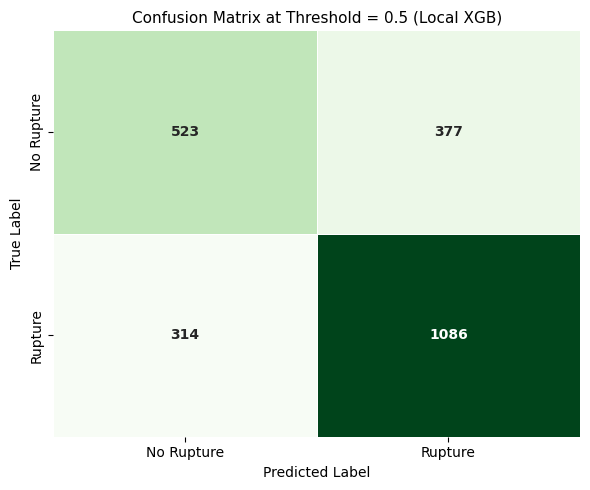

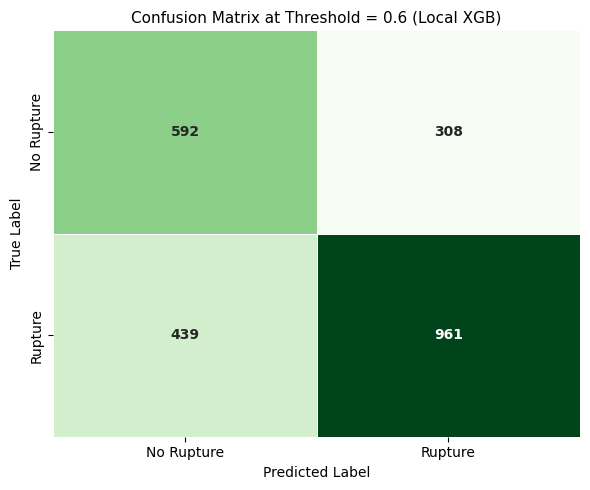

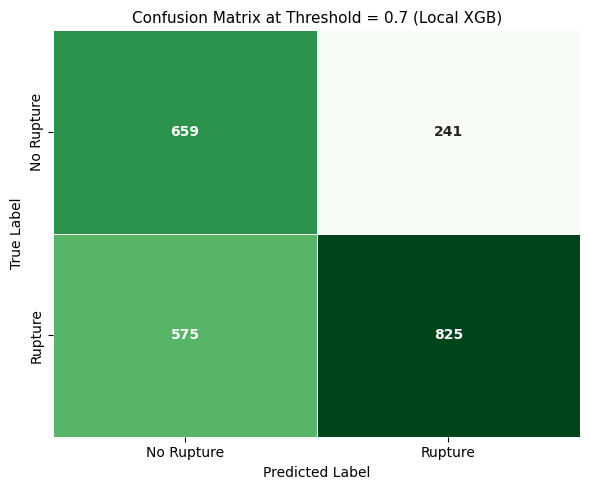

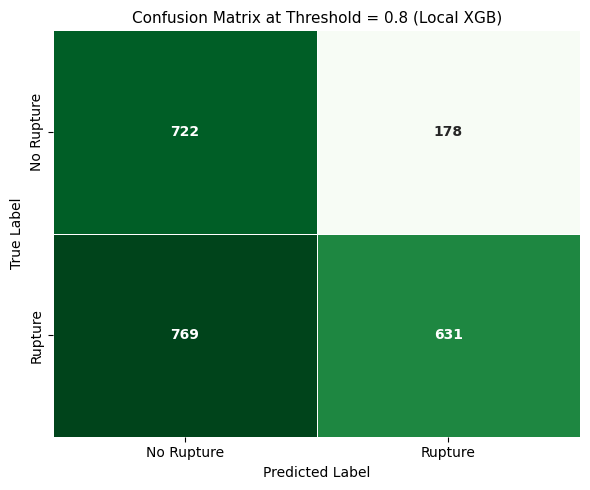

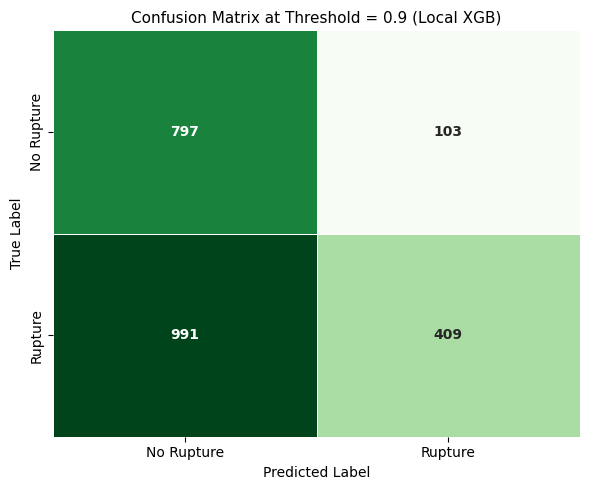

In [54]:
generate_confusian_matrix_plots(conf_matrices, "XGB") 

### MLPNN (Multi-Layer-Perceptron Neural Network)

In [5]:
df = load_dataset()
df.pop("Case")

0       C0001_dicom
1       C0002_dicom
2             C0010
3             C0006
4             C0007
5             C0014
6             C0016
7             C0019
8             C0020
9        CH_case087
10           UM_003
11           UM_007
12           UM_009
13           UM_013
14           UM_015
15            C0057
16            C0060
17            C0055
18            C0024
19            C0026
20      C0049_dicom
21           C0028b
22            C0030
23            C0033
24            C0034
25      C0035_dicom
26      C0036_dicom
27            C0063
28            C0064
29      C0039_dicom
30      C0040_dicom
31      C0041_dicom
32      C0042_dicom
33      C0044_dicom
34            C0045
35            C0046
36            C0066
37            C0067
38            C0069
39            C0071
40            C0072
41     C0074a_dicom
42      C0075_dicom
43      C0076_dicom
44            C0078
45            C0079
46            C0086
47            C0089
48            C0090
49            C0093


### Other Paper's Code

In [56]:
#------------------------------------------------------------------------------  
#---  Multi-layer Perceptron  
#------------------------------------------------------------------------------  
def test_MLP(num_iters, features, labels):  
    AUC_score = np.zeros(num_iters) 
    Accuracy_score = np.zeros(num_iters) 
    Precision_score = np.zeros(num_iters) 
    Recall_score = np.zeros(num_iters) 
    F1_score = np.zeros(num_iters)     

    for i in range(num_iters):

        #--get splits and best params
        np.random.RandomState(seed=1)
        t0 = time.time()        
        x_train,x_test,y_train,y_test=train_test_split(features,labels,test_size=0.1,random_state=i,stratify=labels) 
        mlp = MLPClassifier()    
        param_grid = {
             "hidden_layer_sizes": [(100,), (100, 30),(150,100,50)],
             "solver": [ 'lbfgs'],
             "max_iter": [30], # reduced this to make it faster from what was in original code
             'validation_fraction': [0.1],
             #'random_state': [1, 3, 5, 50],
             'activation': ['identity'],
             #'alpha': [0.0001, 0.05],
             #'class_weight':['balanced'],
             'learning_rate': ['adaptive']
             }              
        grid = GridSearchCV(mlp, param_grid=param_grid, scoring='accuracy', cv=10, verbose=0)#neg_log_loss,roc_auc
        grid.fit(x_train,y_train)
        y_pred=grid.predict(x_test) 
            
        #--Get ROC-AUC Score
        Accuracy_score[i] = accuracy_score(y_test,y_pred)        
        AUC_score[i] = roc_auc_score(y_test, y_pred) #--Choose macro, micro etc. See Docs
        Precision_score[i] = precision_score(y_test,y_pred)
        Recall_score[i] = recall_score(y_test,y_pred)
        F1_score[i] = f1_score(y_test,y_pred)

        print("Iteration:", i, "Accuracy_Score:%.4f" % float(Accuracy_score[i]), "Predictions:", y_pred)         

    print("-------------------------")   
    print("Accuracy Score: %.4f" % np.mean(Accuracy_score))
    print("AUC Score: %.4f" % np.mean(AUC_score))
    print("Precision Score: %.4f" % np.mean(Precision_score))
    print("Recall Score: %.4f" % np.mean(Recall_score))
    print("F1 Score: %.4f" % np.mean(F1_score))   
    print("-------------------------")   

In [57]:
train_cols_t = ['Aneurysm Location', 'Aneurysm type', 'Systole_STAWSS',
       'Systole_WSSMin', 'Systole_WSSMax', 'Mean_OSI', 'Std_OSI', 'TA_LSA_2',
       'TA_LSA_Std_2', 'Bulbous', 'sacVolume', 'Height', 'Sac_Max_Width',
       'Size_ratio_height', 'Size_ratio_width', 'aspectRatio_star',
       'vesselDiameter', 'Systole_TADVO', 'Systole_DVOStd', 'Ostium Minimum',
       'Ostium Maximum', 'Aneurysm Area', 'Ostium Area', 'V2', 'V3', 'V4',
       'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11']
X_train_temp = df[train_cols_t].copy()
test_MLP(10, X_train_temp, df[["ruptureStatus"]].copy())

Iteration: 0 Accuracy_Score:0.5833 Predictions: [1 1 1 0 0 1 1 1 1 1 1 1]
Iteration: 1 Accuracy_Score:0.9167 Predictions: [1 1 0 1 1 1 0 1 0 0 1 1]
Iteration: 2 Accuracy_Score:0.7500 Predictions: [1 0 1 0 1 0 1 0 1 1 1 1]
Iteration: 3 Accuracy_Score:0.6667 Predictions: [1 1 0 0 1 1 1 0 1 1 1 1]
Iteration: 4 Accuracy_Score:0.5000 Predictions: [0 1 1 1 0 0 0 0 0 1 1 0]
Iteration: 5 Accuracy_Score:0.5833 Predictions: [1 1 1 0 1 1 1 1 1 1 0 1]
Iteration: 6 Accuracy_Score:0.5833 Predictions: [1 1 0 1 1 1 1 1 1 1 0 1]
Iteration: 7 Accuracy_Score:0.6667 Predictions: [1 0 1 0 1 1 0 0 1 1 0 1]
Iteration: 8 Accuracy_Score:0.5833 Predictions: [1 1 1 1 1 0 0 1 1 0 0 1]
Iteration: 9 Accuracy_Score:0.6667 Predictions: [0 1 0 0 1 0 1 1 1 1 1 0]
-------------------------
Accuracy Score: 0.6500
AUC Score: 0.6229
Precision Score: 0.6745
Recall Score: 0.7857
F1 Score: 0.7196
-------------------------


### Our Code

In [8]:
import os

#############################################
# Identify columns and create dataframe  #
#############################################
standardized_num_features = df.columns.tolist()
categorical = ["Aneurysm type", "Aneurysm Location", "Bulbous"]
[standardized_num_features.remove(cat) for cat in categorical]
standardized_num_features.remove("ruptureStatus")

target_col = "ruptureStatus"
selected_features = standardized_num_features + categorical

X = df[selected_features].copy()

# feature scaling
X["Ostium Area"] = X["Ostium Area"]**(1/2.0)
X["Aneurysm Area"] = X["Aneurysm Area"]**(1/2.0)
X["sacVolume"] = X["sacVolume"]**(1/3.0)

# feature combos
X["OSI to Ostium area"] = X["Mean_OSI"] / (X["Ostium Area"]**2)
X["Sac_Max_WidthTimesSizeRatio"] = X["Sac_Max_Width"]*X["Size_ratio_width"]

standardized_num_features.append("OSI to Ostium area")
standardized_num_features.append("Sac_Max_WidthTimesSizeRatio")
selected_features = standardized_num_features + categorical

y = df[target_col].copy()

# Convert to numeric, coerce errors to NaN
for col in standardized_num_features:
    X[col] = pd.to_numeric(X[col], errors="coerce")

#############################################
# Perform 100 Iterations with Random Splits #
#############################################

n_splits = 100
test_scores = []
precisions = []
recalls = []
specificities = []
sensitivities = []
auc_scores = []
roc_curves = []
precision_recall_curves = []
conf_matrices = [[] for i in range(1, 10)] # different matrix for thresholds 0.1, ..., 0.9
f1s = []

from optuna.samplers import TPESampler
from optuna.pruners import MedianPruner

from scipy.stats import t
def compute_confidence_interval(metric_list, confidence=0.95):
    metric_list = np.array(metric_list)
    n = len(metric_list)
    mean_val = np.mean(metric_list)
    std_err = np.std(metric_list, ddof=1) / np.sqrt(n)
    ci = t.interval(confidence, df=n-1, loc=mean_val, scale=std_err)
    return mean_val, ci, std_err

import optuna

sss = StratifiedShuffleSplit(n_splits=n_splits, test_size=0.2, random_state=42)
it = 1

biggest_model_id_existing = 0
for i in range(1, n_splits+1):
    dir_path = "./aneurysm_models_trained_locally/mlp"
    model_filename = f"model{i}.joblib"
    if os.path.exists(os.path.join(dir_path, model_filename)):
        biggest_model_id_existing += 1
    else:
        break

models = list(joblib.Parallel(n_jobs=-1)(
    joblib.delayed(joblib.load)(f"./aneurysm_models_trained_locally/svc/model{i}.joblib") for i in range(1, biggest_model_id_existing+1)
))

splits_it = 1
train_idxs = []
test_idxs = []
if os.path.exists("./aneurysm_models_trained_locally/mlp/splits/"):
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/mlp/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/mlp/splits/test{splits_it}.npy"))
        splits_it += 1
else:
    os.makedirs("./aneurysm_models_trained_locally/mlp/splits/")
    for train_idx, test_idx in sss.split(X,y):
        np.save(f"./aneurysm_models_trained_locally/mlp/splits/training{splits_it}.npy", train_idx)
        np.save(f"./aneurysm_models_trained_locally/mlp/splits/test{splits_it}.npy", test_idx)
        splits_it += 1
    splits_it = 1
    while splits_it <= n_splits:
        train_idxs.append(np.load(f"./aneurysm_models_trained_locally/mlp/splits/training{splits_it}.npy"))
        test_idxs.append(np.load(f"./aneurysm_models_trained_locally/mlp/splits/test{splits_it}.npy"))
        splits_it += 1
            
for train_idx, test_idx in list(zip(train_idxs, test_idxs)):
    dir_path = "./aneurysm_models_trained_locally/mlp"
    model_filename = f"model{it}.joblib"
    print(f"Running iteration {it}")
    X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
    y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
    
    if not os.path.exists(os.path.join(dir_path, model_filename)):
        print("Getting best params")
        def objective(trial):
            val_aucs = []
            train_aucs = []
    
            cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=6789)
            for train_idx, val_idx in cv.split(X_train, y_train):
                X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
                y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]
                
                #############################################
                # Build ColumnTransformer                 #
                #############################################
                preprocessor = ColumnTransformer([
                    ("stand_nums",
                     Pipeline([
                         ("imputer", SimpleImputer(strategy="median")),
                         ("scaler", StandardScaler())
                     ]),
                     standardized_num_features
                    ),
                    ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
                ])
    
                #############################################
                # Define Model Pipeline & Parameters       #
                #############################################
                pipeline = Pipeline([
                    ("preprocessor", preprocessor),
                    ("classifier", MLPClassifier(solver="lbfgs", max_iter=trial.suggest_int("MI", 5, 400), validation_fraction=0.2, activation="identity", learning_rate="adaptive", hidden_layer_sizes=(trial.suggest_int("L1", 1, 200, log=True), trial.suggest_int("L2", 1, 200, log=True), trial.suggest_int("L3", 1, 200, log=True))))
                ])
    
                pipeline.fit(X_tr, y_tr)
                
    
                y_val_pred = pipeline.predict_proba(X_val)[:, 1]
                y_tr_pred = pipeline.predict_proba(X_tr)[:, 1]
    
                val_auc = roc_auc_score(y_val, y_val_pred)
                train_auc = roc_auc_score(y_tr, y_tr_pred)
    
                val_aucs.append(val_auc)
                train_aucs.append(train_auc)
    
            mean_val_auc = np.mean(val_aucs)
            mean_train_auc = np.mean(train_aucs)
            auc_diff = np.mean(np.abs(np.array(val_aucs) - np.array(train_auc)))  # Overfitting penalty
    
            return mean_val_auc - 0.1*auc_diff

        study_name = "MLP" + str(int(time.time() * 1000))
        optuna.create_study(
            study_name=study_name, 
            directions=['maximize'], # Optimization directions
            sampler=TPESampler(seed=42), # Use the NSGAIII sampler
            pruner=MedianPruner(n_startup_trials=10, n_min_trials=2), # Use the MedianPruner
            load_if_exists=True, # Load study if it exists
            storage='mysql://root@localhost/optuna' # Save the study in SQLite
        )
    
        from concurrent.futures import ThreadPoolExecutor
        def run_optuna_study(study_name):
            study = optuna.load_study(
                study_name=study_name, storage="mysql://root@localhost/optuna"
            )
            study.optimize(objective, n_trials=5)
            
        with ThreadPoolExecutor(max_workers=16) as executor:
            res = []
            for i in range(16):
                res.append(executor.submit(run_optuna_study, study_name))
            for r in res:
                r.result()
        
        best_params = optuna.load_study(
            study_name=study_name, storage="mysql://root@localhost/optuna"
        ).best_params
    
    
        #############################################
        # Build ColumnTransformer                 #
        #############################################
        preprocessor = ColumnTransformer([
            ("stand_nums",
             Pipeline([
                 ("imputer", SimpleImputer(strategy="median")),
                 ("scaler", StandardScaler())
             ]),
             standardized_num_features
            ),
            ("cat", OneHotEncoder(handle_unknown="ignore"), categorical)
        ])
    
        #############################################
        # Define Model Pipeline & Parameters       #
        #############################################
        pipeline = Pipeline([
            ("preprocessor", preprocessor),
            ("classifier", MLPClassifier(solver="lbfgs", max_iter=best_params["MI"], validation_fraction=0.2, activation="identity", learning_rate="adaptive", hidden_layer_sizes=(best_params["L1"], best_params["L2"], best_params["L3"])))
        ])
        
        pipeline.fit(X_train, y_train)

        best_model = pipeline
        models.append(best_model)
        print("Best hyperparameters:", best_params)

        # save model
        os.makedirs(dir_path, exist_ok=True)
        joblib.dump(models[-1], os.path.join(dir_path, model_filename))
    else:
        pipeline = joblib.load(os.path.join(dir_path, model_filename))
        best_model = pipeline

    # Accuracy
    y_pred = best_model.predict(X_test)
    test_score = accuracy_score(y_test, y_pred)
    test_scores.append(test_score)
    
    # Precision & Recall
    precision = precision_score(y_test, y_pred, average="binary")  # Adjust if multiclass
    recall = recall_score(y_test, y_pred, average="binary")
    precisions.append(precision)
    recalls.append(recall)
    f1s.append(2.0*precision*recall / (precision + recall))
    
    # Sensitivity & Specificity
    cm = confusion_matrix(y_test, y_pred)
    tn, fp, fn, tp = cm.ravel()  # Extract TP, TN, FP, FN
    specificity = tn / (tn + fp) if (tn + fp) != 0 else 0
    sensitivity = tp / (tp + fn) if (tp + fn) != 0 else 0
    specificities.append(specificity)
    sensitivities.append(sensitivity)
    
    test_score = best_model.score(X_test, y_test)
    test_scores.append(test_score)
    
    # Get predicted probabilities for ROC curve
    y_scores = best_model.predict_proba(X_test)[:, 1]
    
    fpr, tpr, _ = roc_curve(y_test, y_scores)
    roc_curves.append((fpr, tpr))
    auc_score = auc(fpr, tpr)
    auc_scores.append(auc_score)

    precision_recall_curves.append(precision_recall_curve(y_test, best_model.predict_proba(X_test)[:, 1]))

    # Confusion Matrix
    for k in range(len(conf_matrices)):
        y_pred = (best_model.predict_proba(X_test)[:, 1] > 0.1*(k+1)).astype(int)
        conf_matrices[k].append(confusion_matrix(y_test, y_pred))    

    it += 1


# Compute all metric statistics
metrics = {
    "Accuracy": compute_confidence_interval(test_scores),
    "Precision": compute_confidence_interval(precisions),
    "Recall (Sensitivity)": compute_confidence_interval(recalls),
    "Specificity": compute_confidence_interval(specificities),
    "AUC (Area Under ROC)": compute_confidence_interval(auc_scores),
    "F1 Score": compute_confidence_interval(f1s),
}

# Print results
for metric_name, (mean_val, (ci_lower, ci_upper), std) in metrics.items():
    print(f"{metric_name}: {mean_val:.4f}/{std:.4f} (95% CI: {ci_lower:.4f}, {ci_upper:.4f})")

Running iteration 1
Running iteration 2
Running iteration 3
Running iteration 4
Running iteration 5
Running iteration 6
Running iteration 7
Running iteration 8
Running iteration 9
Running iteration 10
Running iteration 11
Running iteration 12
Running iteration 13
Running iteration 14
Running iteration 15
Running iteration 16
Running iteration 17
Running iteration 18
Running iteration 19
Running iteration 20
Running iteration 21
Running iteration 22
Running iteration 23
Running iteration 24
Running iteration 25
Running iteration 26
Running iteration 27
Running iteration 28
Running iteration 29
Running iteration 30
Running iteration 31
Running iteration 32
Running iteration 33
Getting best params


[I 2025-04-07 16:57:30,557] A new study created in RDB with name: MLP1744059449560
[I 2025-04-07 16:57:40,803] Trial 6 finished with value: 0.5077142857142858 and parameters: {'MI': 323, 'L1': 6, 'L2': 2, 'L3': 6}. Best is trial 6 with value: 0.5077142857142858.
[I 2025-04-07 16:57:41,356] Trial 1 finished with value: 0.5124285714285715 and parameters: {'MI': 107, 'L1': 1, 'L2': 10, 'L3': 5}. Best is trial 1 with value: 0.5124285714285715.
[I 2025-04-07 16:57:43,036] Trial 7 finished with value: 0.5701428571428572 and parameters: {'MI': 355, 'L1': 3, 'L2': 15, 'L3': 1}. Best is trial 7 with value: 0.5701428571428572.
[I 2025-04-07 16:57:43,337] Trial 13 finished with value: 0.543142857142857 and parameters: {'MI': 48, 'L1': 1, 'L2': 3, 'L3': 12}. Best is trial 7 with value: 0.5701428571428572.
[I 2025-04-07 16:57:43,878] Trial 10 finished with value: 0.5359999999999999 and parameters: {'MI': 103, 'L1': 2, 'L2': 1, 'L3': 12}. Best is trial 7 with value: 0.5701428571428572.
[I 2025-04-07

Best hyperparameters: {'MI': 337, 'L1': 4, 'L2': 54, 'L3': 8}
Running iteration 34
Getting best params


[I 2025-04-07 16:59:45,329] A new study created in RDB with name: MLP1744059585254
[I 2025-04-07 16:59:54,217] Trial 8 finished with value: 0.6733733766233766 and parameters: {'MI': 6, 'L1': 190, 'L2': 1, 'L3': 3}. Best is trial 8 with value: 0.6733733766233766.
[I 2025-04-07 16:59:54,612] Trial 10 finished with value: 0.5498571428571429 and parameters: {'MI': 372, 'L1': 2, 'L2': 3, 'L3': 1}. Best is trial 8 with value: 0.6733733766233766.
[I 2025-04-07 16:59:55,116] Trial 9 finished with value: 0.5284285714285714 and parameters: {'MI': 265, 'L1': 1, 'L2': 11, 'L3': 4}. Best is trial 8 with value: 0.6733733766233766.
[I 2025-04-07 16:59:56,699] Trial 5 finished with value: 0.5469999999999999 and parameters: {'MI': 338, 'L1': 2, 'L2': 61, 'L3': 1}. Best is trial 8 with value: 0.6733733766233766.
[I 2025-04-07 16:59:57,039] Trial 1 finished with value: 0.5284285714285715 and parameters: {'MI': 393, 'L1': 2, 'L2': 2, 'L3': 15}. Best is trial 8 with value: 0.6733733766233766.
[I 2025-04-07

Best hyperparameters: {'MI': 5, 'L1': 176, 'L2': 1, 'L3': 178}
Running iteration 35
Getting best params


[I 2025-04-07 17:01:56,372] Trial 0 finished with value: 0.6093831168831169 and parameters: {'MI': 30, 'L1': 1, 'L2': 1, 'L3': 5}. Best is trial 0 with value: 0.6093831168831169.
[I 2025-04-07 17:01:58,652] Trial 7 finished with value: 0.5680000000000001 and parameters: {'MI': 55, 'L1': 5, 'L2': 1, 'L3': 1}. Best is trial 0 with value: 0.6093831168831169.
[I 2025-04-07 17:01:59,361] Trial 2 finished with value: 0.5965714285714286 and parameters: {'MI': 354, 'L1': 5, 'L2': 7, 'L3': 1}. Best is trial 0 with value: 0.6093831168831169.
[I 2025-04-07 17:01:59,626] Trial 13 finished with value: 0.5837142857142856 and parameters: {'MI': 350, 'L1': 6, 'L2': 1, 'L3': 25}. Best is trial 0 with value: 0.6093831168831169.
[I 2025-04-07 17:01:59,661] Trial 9 finished with value: 0.5908571428571429 and parameters: {'MI': 84, 'L1': 1, 'L2': 1, 'L3': 7}. Best is trial 0 with value: 0.6093831168831169.
[I 2025-04-07 17:02:00,670] Trial 11 finished with value: 0.612 and parameters: {'MI': 297, 'L1': 10,

Best hyperparameters: {'MI': 6, 'L1': 4, 'L2': 13, 'L3': 15}
Running iteration 36
Getting best params


[I 2025-04-07 17:03:25,148] Trial 5 finished with value: 0.6193733766233768 and parameters: {'MI': 17, 'L1': 1, 'L2': 88, 'L3': 1}. Best is trial 5 with value: 0.6193733766233768.
[I 2025-04-07 17:03:25,814] Trial 13 finished with value: 0.6374285714285713 and parameters: {'MI': 277, 'L1': 2, 'L2': 4, 'L3': 3}. Best is trial 13 with value: 0.6374285714285713.
[I 2025-04-07 17:03:26,921] Trial 7 finished with value: 0.6308571428571429 and parameters: {'MI': 354, 'L1': 2, 'L2': 1, 'L3': 3}. Best is trial 13 with value: 0.6374285714285713.
[I 2025-04-07 17:03:27,338] Trial 2 finished with value: 0.625 and parameters: {'MI': 242, 'L1': 9, 'L2': 3, 'L3': 21}. Best is trial 13 with value: 0.6374285714285713.
[I 2025-04-07 17:03:29,710] Trial 14 finished with value: 0.6658571428571428 and parameters: {'MI': 230, 'L1': 12, 'L2': 1, 'L3': 5}. Best is trial 14 with value: 0.6658571428571428.
[I 2025-04-07 17:03:31,289] Trial 0 finished with value: 0.6345714285714286 and parameters: {'MI': 363, '

Best hyperparameters: {'MI': 6, 'L1': 72, 'L2': 58, 'L3': 16}
Running iteration 37
Getting best params


[I 2025-04-07 17:05:43,875] Trial 2 finished with value: 0.7527857142857143 and parameters: {'MI': 8, 'L1': 144, 'L2': 4, 'L3': 21}. Best is trial 2 with value: 0.7527857142857143.
[I 2025-04-07 17:05:44,577] Trial 13 finished with value: 0.7025714285714285 and parameters: {'MI': 135, 'L1': 7, 'L2': 11, 'L3': 1}. Best is trial 2 with value: 0.7527857142857143.
[I 2025-04-07 17:05:44,899] Trial 9 finished with value: 0.6551428571428571 and parameters: {'MI': 191, 'L1': 8, 'L2': 1, 'L3': 28}. Best is trial 2 with value: 0.7527857142857143.
[I 2025-04-07 17:05:45,438] Trial 8 finished with value: 0.7080000000000001 and parameters: {'MI': 178, 'L1': 3, 'L2': 9, 'L3': 2}. Best is trial 2 with value: 0.7527857142857143.
[I 2025-04-07 17:05:46,248] Trial 0 finished with value: 0.6902857142857143 and parameters: {'MI': 89, 'L1': 3, 'L2': 41, 'L3': 7}. Best is trial 2 with value: 0.7527857142857143.
[I 2025-04-07 17:05:47,591] Trial 10 finished with value: 0.6884285714285714 and parameters: {'M

Best hyperparameters: {'MI': 6, 'L1': 153, 'L2': 4, 'L3': 4}
Running iteration 38
Getting best params


[I 2025-04-07 17:08:15,595] Trial 15 finished with value: 0.6371428571428571 and parameters: {'MI': 124, 'L1': 4, 'L2': 2, 'L3': 5}. Best is trial 15 with value: 0.6371428571428571.
[I 2025-04-07 17:08:15,911] Trial 6 finished with value: 0.6392857142857142 and parameters: {'MI': 251, 'L1': 10, 'L2': 1, 'L3': 2}. Best is trial 6 with value: 0.6392857142857142.
[I 2025-04-07 17:08:16,932] Trial 12 finished with value: 0.6202857142857143 and parameters: {'MI': 218, 'L1': 12, 'L2': 1, 'L3': 1}. Best is trial 6 with value: 0.6392857142857142.
[I 2025-04-07 17:08:18,528] Trial 5 finished with value: 0.6487142857142857 and parameters: {'MI': 137, 'L1': 12, 'L2': 19, 'L3': 1}. Best is trial 5 with value: 0.6487142857142857.
[I 2025-04-07 17:08:19,967] Trial 3 finished with value: 0.6842857142857144 and parameters: {'MI': 81, 'L1': 2, 'L2': 77, 'L3': 6}. Best is trial 3 with value: 0.6842857142857144.
[I 2025-04-07 17:08:20,671] Trial 1 finished with value: 0.6428571428571429 and parameters: {

Best hyperparameters: {'MI': 233, 'L1': 27, 'L2': 91, 'L3': 40}
Running iteration 39
Getting best params


[I 2025-04-07 17:10:00,016] Trial 1 finished with value: 0.7049837662337662 and parameters: {'MI': 6, 'L1': 9, 'L2': 1, 'L3': 7}. Best is trial 1 with value: 0.7049837662337662.
[I 2025-04-07 17:10:00,369] Trial 15 finished with value: 0.716422077922078 and parameters: {'MI': 10, 'L1': 3, 'L2': 3, 'L3': 20}. Best is trial 15 with value: 0.716422077922078.
[I 2025-04-07 17:10:01,107] Trial 6 finished with value: 0.6792759740259741 and parameters: {'MI': 8, 'L1': 20, 'L2': 2, 'L3': 16}. Best is trial 15 with value: 0.716422077922078.
[I 2025-04-07 17:10:03,100] Trial 4 finished with value: 0.6978214285714285 and parameters: {'MI': 11, 'L1': 2, 'L2': 79, 'L3': 10}. Best is trial 15 with value: 0.716422077922078.
[I 2025-04-07 17:10:07,364] Trial 17 finished with value: 0.674 and parameters: {'MI': 278, 'L1': 2, 'L2': 5, 'L3': 1}. Best is trial 15 with value: 0.716422077922078.
[I 2025-04-07 17:10:08,331] Trial 0 finished with value: 0.6802857142857144 and parameters: {'MI': 220, 'L1': 35,

Best hyperparameters: {'MI': 10, 'L1': 3, 'L2': 3, 'L3': 20}
Running iteration 40
Getting best params


[I 2025-04-07 17:11:12,804] Trial 8 finished with value: 0.692 and parameters: {'MI': 16, 'L1': 7, 'L2': 1, 'L3': 1}. Best is trial 8 with value: 0.692.
[I 2025-04-07 17:11:14,599] Trial 7 finished with value: 0.6722857142857142 and parameters: {'MI': 27, 'L1': 2, 'L2': 10, 'L3': 6}. Best is trial 8 with value: 0.692.
[I 2025-04-07 17:11:15,918] Trial 9 finished with value: 0.6638571428571428 and parameters: {'MI': 30, 'L1': 2, 'L2': 2, 'L3': 9}. Best is trial 8 with value: 0.692.
[I 2025-04-07 17:11:16,024] Trial 1 finished with value: 0.6085714285714285 and parameters: {'MI': 391, 'L1': 1, 'L2': 7, 'L3': 15}. Best is trial 8 with value: 0.692.
[I 2025-04-07 17:11:16,916] Trial 0 finished with value: 0.6377142857142858 and parameters: {'MI': 333, 'L1': 2, 'L2': 8, 'L3': 4}. Best is trial 8 with value: 0.692.
[I 2025-04-07 17:11:17,697] Trial 6 finished with value: 0.6391428571428572 and parameters: {'MI': 373, 'L1': 2, 'L2': 6, 'L3': 4}. Best is trial 8 with value: 0.692.
[I 2025-04-0

Best hyperparameters: {'MI': 18, 'L1': 126, 'L2': 38, 'L3': 1}
Running iteration 41
Getting best params


[I 2025-04-07 17:13:31,755] Trial 11 finished with value: 0.4982857142857142 and parameters: {'MI': 363, 'L1': 9, 'L2': 1, 'L3': 2}. Best is trial 11 with value: 0.4982857142857142.
[I 2025-04-07 17:13:32,586] Trial 12 finished with value: 0.504 and parameters: {'MI': 42, 'L1': 3, 'L2': 11, 'L3': 1}. Best is trial 12 with value: 0.504.
[I 2025-04-07 17:13:32,660] Trial 15 finished with value: 0.4811428571428571 and parameters: {'MI': 171, 'L1': 3, 'L2': 1, 'L3': 2}. Best is trial 8 with value: 0.5154285714285713.
[I 2025-04-07 17:13:32,734] Trial 8 finished with value: 0.5154285714285713 and parameters: {'MI': 205, 'L1': 2, 'L2': 32, 'L3': 2}. Best is trial 8 with value: 0.5154285714285713.
[I 2025-04-07 17:13:35,272] Trial 9 finished with value: 0.5211428571428571 and parameters: {'MI': 305, 'L1': 8, 'L2': 26, 'L3': 4}. Best is trial 9 with value: 0.5211428571428571.
[I 2025-04-07 17:13:37,022] Trial 4 finished with value: 0.49071428571428577 and parameters: {'MI': 42, 'L1': 2, 'L2': 

Best hyperparameters: {'MI': 5, 'L1': 81, 'L2': 16, 'L3': 4}
Running iteration 42
Getting best params


[I 2025-04-07 17:14:57,959] Trial 5 finished with value: 0.6028571428571429 and parameters: {'MI': 350, 'L1': 2, 'L2': 3, 'L3': 1}. Best is trial 5 with value: 0.6028571428571429.
[I 2025-04-07 17:14:58,616] Trial 6 finished with value: 0.5614285714285714 and parameters: {'MI': 308, 'L1': 6, 'L2': 20, 'L3': 2}. Best is trial 5 with value: 0.6028571428571429.
[I 2025-04-07 17:14:58,991] Trial 9 finished with value: 0.6328571428571428 and parameters: {'MI': 243, 'L1': 8, 'L2': 3, 'L3': 24}. Best is trial 9 with value: 0.6328571428571428.
[I 2025-04-07 17:15:01,297] Trial 10 finished with value: 0.5657142857142857 and parameters: {'MI': 258, 'L1': 2, 'L2': 11, 'L3': 2}. Best is trial 9 with value: 0.6328571428571428.
[I 2025-04-07 17:15:05,078] Trial 14 finished with value: 0.5871428571428571 and parameters: {'MI': 92, 'L1': 21, 'L2': 10, 'L3': 1}. Best is trial 9 with value: 0.6328571428571428.
[I 2025-04-07 17:15:05,407] Trial 11 finished with value: 0.5671428571428571 and parameters: {

Best hyperparameters: {'MI': 167, 'L1': 1, 'L2': 136, 'L3': 27}
Running iteration 43
Getting best params


[I 2025-04-07 17:16:42,014] Trial 6 finished with value: 0.7051428571428571 and parameters: {'MI': 217, 'L1': 1, 'L2': 4, 'L3': 1}. Best is trial 6 with value: 0.7051428571428571.
[I 2025-04-07 17:16:42,164] Trial 1 finished with value: 0.630857142857143 and parameters: {'MI': 144, 'L1': 3, 'L2': 3, 'L3': 1}. Best is trial 6 with value: 0.7051428571428571.
[I 2025-04-07 17:16:42,324] Trial 9 finished with value: 0.6491428571428571 and parameters: {'MI': 60, 'L1': 8, 'L2': 2, 'L3': 2}. Best is trial 2 with value: 0.7082857142857143.
[I 2025-04-07 17:16:42,468] Trial 2 finished with value: 0.7082857142857143 and parameters: {'MI': 272, 'L1': 6, 'L2': 5, 'L3': 2}. Best is trial 2 with value: 0.7082857142857143.
[I 2025-04-07 17:16:42,982] Trial 11 finished with value: 0.6108571428571428 and parameters: {'MI': 52, 'L1': 1, 'L2': 1, 'L3': 1}. Best is trial 2 with value: 0.7082857142857143.
[I 2025-04-07 17:16:48,347] Trial 12 finished with value: 0.6525714285714285 and parameters: {'MI': 38

Best hyperparameters: {'MI': 132, 'L1': 2, 'L2': 8, 'L3': 142}


[I 2025-04-07 17:18:01,866] A new study created in RDB with name: MLP1744060681810


Running iteration 44
Getting best params


[I 2025-04-07 17:18:11,005] Trial 9 finished with value: 0.6381428571428571 and parameters: {'MI': 52, 'L1': 5, 'L2': 3, 'L3': 1}. Best is trial 9 with value: 0.6381428571428571.
[I 2025-04-07 17:18:12,071] Trial 11 finished with value: 0.6514285714285715 and parameters: {'MI': 61, 'L1': 1, 'L2': 1, 'L3': 3}. Best is trial 11 with value: 0.6514285714285715.
[I 2025-04-07 17:18:14,016] Trial 6 finished with value: 0.6362857142857143 and parameters: {'MI': 257, 'L1': 2, 'L2': 15, 'L3': 8}. Best is trial 11 with value: 0.6514285714285715.
[I 2025-04-07 17:18:15,108] Trial 8 finished with value: 0.6434512987012987 and parameters: {'MI': 96, 'L1': 1, 'L2': 1, 'L3': 1}. Best is trial 11 with value: 0.6514285714285715.
[I 2025-04-07 17:18:18,630] Trial 12 finished with value: 0.6378571428571429 and parameters: {'MI': 363, 'L1': 7, 'L2': 1, 'L3': 54}. Best is trial 11 with value: 0.6514285714285715.
[I 2025-04-07 17:18:19,151] Trial 0 finished with value: 0.6295714285714286 and parameters: {'M

Best hyperparameters: {'MI': 6, 'L1': 14, 'L2': 147, 'L3': 1}
Running iteration 45
Getting best params


[I 2025-04-07 17:20:18,762] Trial 11 finished with value: 0.6684285714285714 and parameters: {'MI': 118, 'L1': 1, 'L2': 2, 'L3': 3}. Best is trial 11 with value: 0.6684285714285714.
[I 2025-04-07 17:20:23,918] Trial 6 finished with value: 0.6832240259740259 and parameters: {'MI': 63, 'L1': 1, 'L2': 52, 'L3': 1}. Best is trial 6 with value: 0.6832240259740259.
[I 2025-04-07 17:20:24,801] Trial 0 finished with value: 0.6819999999999999 and parameters: {'MI': 355, 'L1': 1, 'L2': 10, 'L3': 3}. Best is trial 6 with value: 0.6832240259740259.
[I 2025-04-07 17:20:25,288] Trial 7 finished with value: 0.7294285714285713 and parameters: {'MI': 58, 'L1': 22, 'L2': 4, 'L3': 1}. Best is trial 7 with value: 0.7294285714285713.
[I 2025-04-07 17:20:25,395] Trial 12 finished with value: 0.7045714285714286 and parameters: {'MI': 399, 'L1': 18, 'L2': 6, 'L3': 1}. Best is trial 7 with value: 0.7294285714285713.
[I 2025-04-07 17:20:26,114] Trial 13 finished with value: 0.6411428571428571 and parameters: {'

Best hyperparameters: {'MI': 26, 'L1': 36, 'L2': 9, 'L3': 19}
Running iteration 46
Getting best params


[I 2025-04-07 17:22:09,369] Trial 5 finished with value: 0.5514285714285714 and parameters: {'MI': 349, 'L1': 1, 'L2': 8, 'L3': 2}. Best is trial 4 with value: 0.5757142857142856.
[I 2025-04-07 17:22:09,576] Trial 4 finished with value: 0.5757142857142856 and parameters: {'MI': 73, 'L1': 6, 'L2': 18, 'L3': 2}. Best is trial 4 with value: 0.5757142857142856.
[I 2025-04-07 17:22:13,062] Trial 15 finished with value: 0.5457142857142858 and parameters: {'MI': 69, 'L1': 1, 'L2': 4, 'L3': 51}. Best is trial 4 with value: 0.5757142857142856.
[I 2025-04-07 17:22:17,587] Trial 0 finished with value: 0.5657142857142858 and parameters: {'MI': 187, 'L1': 97, 'L2': 1, 'L3': 2}. Best is trial 4 with value: 0.5757142857142856.
[I 2025-04-07 17:22:18,547] Trial 12 finished with value: 0.5845714285714285 and parameters: {'MI': 192, 'L1': 121, 'L2': 3, 'L3': 2}. Best is trial 12 with value: 0.5845714285714285.
[I 2025-04-07 17:22:19,306] Trial 10 finished with value: 0.5299999999999999 and parameters: {

Best hyperparameters: {'MI': 31, 'L1': 30, 'L2': 58, 'L3': 183}
Running iteration 47
Getting best params


[I 2025-04-07 17:24:33,470] A new study created in RDB with name: MLP1744061073398
[I 2025-04-07 17:24:43,893] Trial 10 finished with value: 0.6491428571428571 and parameters: {'MI': 53, 'L1': 2, 'L2': 11, 'L3': 1}. Best is trial 10 with value: 0.6491428571428571.
[I 2025-04-07 17:24:44,623] Trial 9 finished with value: 0.6314285714285715 and parameters: {'MI': 238, 'L1': 9, 'L2': 1, 'L3': 8}. Best is trial 10 with value: 0.6491428571428571.
[I 2025-04-07 17:24:45,348] Trial 11 finished with value: 0.6525714285714286 and parameters: {'MI': 197, 'L1': 7, 'L2': 2, 'L3': 1}. Best is trial 11 with value: 0.6525714285714286.
[I 2025-04-07 17:24:47,263] Trial 13 finished with value: 0.703344155844156 and parameters: {'MI': 30, 'L1': 18, 'L2': 19, 'L3': 2}. Best is trial 13 with value: 0.703344155844156.
[I 2025-04-07 17:24:48,749] Trial 8 finished with value: 0.7029999999999998 and parameters: {'MI': 40, 'L1': 16, 'L2': 6, 'L3': 3}. Best is trial 13 with value: 0.703344155844156.
[I 2025-04-

Best hyperparameters: {'MI': 5, 'L1': 3, 'L2': 37, 'L3': 35}
Running iteration 48
Getting best params


[I 2025-04-07 17:26:24,301] Trial 15 finished with value: 0.7006883116883117 and parameters: {'MI': 27, 'L1': 2, 'L2': 1, 'L3': 4}. Best is trial 3 with value: 0.7471428571428571.
[I 2025-04-07 17:26:24,535] Trial 3 finished with value: 0.7471428571428571 and parameters: {'MI': 287, 'L1': 3, 'L2': 2, 'L3': 1}. Best is trial 11 with value: 0.7528571428571429.
[I 2025-04-07 17:26:24,789] Trial 11 finished with value: 0.7528571428571429 and parameters: {'MI': 27, 'L1': 3, 'L2': 11, 'L3': 9}. Best is trial 11 with value: 0.7528571428571429.
[I 2025-04-07 17:26:25,622] Trial 4 finished with value: 0.711077922077922 and parameters: {'MI': 7, 'L1': 7, 'L2': 119, 'L3': 20}. Best is trial 11 with value: 0.7528571428571429.
[I 2025-04-07 17:26:26,030] Trial 1 finished with value: 0.74 and parameters: {'MI': 83, 'L1': 1, 'L2': 1, 'L3': 1}. Best is trial 11 with value: 0.7528571428571429.
[I 2025-04-07 17:26:28,535] Trial 9 finished with value: 0.732857142857143 and parameters: {'MI': 211, 'L1': 1

Best hyperparameters: {'MI': 264, 'L1': 90, 'L2': 199, 'L3': 6}
Running iteration 49
Getting best params


[I 2025-04-07 17:29:01,871] A new study created in RDB with name: MLP1744061341805
[I 2025-04-07 17:29:09,270] Trial 1 finished with value: 0.6597142857142858 and parameters: {'MI': 248, 'L1': 4, 'L2': 2, 'L3': 9}. Best is trial 1 with value: 0.6597142857142858.
[I 2025-04-07 17:29:09,547] Trial 13 finished with value: 0.6599935064935065 and parameters: {'MI': 12, 'L1': 13, 'L2': 10, 'L3': 1}. Best is trial 13 with value: 0.6599935064935065.
[I 2025-04-07 17:29:10,017] Trial 10 finished with value: 0.6537142857142858 and parameters: {'MI': 362, 'L1': 7, 'L2': 1, 'L3': 7}. Best is trial 13 with value: 0.6599935064935065.
[I 2025-04-07 17:29:12,698] Trial 8 finished with value: 0.6465714285714287 and parameters: {'MI': 212, 'L1': 5, 'L2': 77, 'L3': 1}. Best is trial 13 with value: 0.6599935064935065.
[I 2025-04-07 17:29:13,959] Trial 2 finished with value: 0.6537142857142858 and parameters: {'MI': 254, 'L1': 26, 'L2': 5, 'L3': 1}. Best is trial 13 with value: 0.6599935064935065.
[I 2025-

Best hyperparameters: {'MI': 8, 'L1': 36, 'L2': 3, 'L3': 4}
Running iteration 50
Getting best params


[I 2025-04-07 17:30:27,421] Trial 1 finished with value: 0.7257370129870131 and parameters: {'MI': 13, 'L1': 3, 'L2': 10, 'L3': 8}. Best is trial 1 with value: 0.7257370129870131.
[I 2025-04-07 17:30:30,188] Trial 7 finished with value: 0.6897142857142857 and parameters: {'MI': 34, 'L1': 2, 'L2': 20, 'L3': 9}. Best is trial 1 with value: 0.7257370129870131.
[I 2025-04-07 17:30:30,206] Trial 15 finished with value: 0.6328571428571429 and parameters: {'MI': 271, 'L1': 3, 'L2': 18, 'L3': 3}. Best is trial 1 with value: 0.7257370129870131.
[I 2025-04-07 17:30:31,003] Trial 6 finished with value: 0.6578571428571429 and parameters: {'MI': 9, 'L1': 37, 'L2': 1, 'L3': 153}. Best is trial 1 with value: 0.7257370129870131.
[I 2025-04-07 17:30:33,171] Trial 10 finished with value: 0.6665714285714286 and parameters: {'MI': 130, 'L1': 4, 'L2': 74, 'L3': 5}. Best is trial 1 with value: 0.7257370129870131.
[I 2025-04-07 17:30:35,929] Trial 14 finished with value: 0.644 and parameters: {'MI': 157, 'L1

Best hyperparameters: {'MI': 13, 'L1': 3, 'L2': 10, 'L3': 8}
Running iteration 51
Getting best params


[I 2025-04-07 17:31:46,858] Trial 11 finished with value: 0.7502857142857142 and parameters: {'MI': 34, 'L1': 3, 'L2': 41, 'L3': 5}. Best is trial 11 with value: 0.7502857142857142.
[I 2025-04-07 17:31:47,302] Trial 15 finished with value: 0.690857142857143 and parameters: {'MI': 261, 'L1': 8, 'L2': 2, 'L3': 2}. Best is trial 11 with value: 0.7502857142857142.
[I 2025-04-07 17:31:47,594] Trial 9 finished with value: 0.7371428571428572 and parameters: {'MI': 92, 'L1': 2, 'L2': 5, 'L3': 28}. Best is trial 11 with value: 0.7502857142857142.
[I 2025-04-07 17:31:47,851] Trial 1 finished with value: 0.7887597402597403 and parameters: {'MI': 7, 'L1': 75, 'L2': 7, 'L3': 108}. Best is trial 1 with value: 0.7887597402597403.
[I 2025-04-07 17:31:50,068] Trial 13 finished with value: 0.7062857142857144 and parameters: {'MI': 384, 'L1': 2, 'L2': 48, 'L3': 1}. Best is trial 1 with value: 0.7887597402597403.
[I 2025-04-07 17:31:50,364] Trial 12 finished with value: 0.696 and parameters: {'MI': 191, '

Best hyperparameters: {'MI': 7, 'L1': 152, 'L2': 6, 'L3': 14}
Running iteration 52
Getting best params


[I 2025-04-07 17:33:38,699] Trial 5 finished with value: 0.57 and parameters: {'MI': 284, 'L1': 1, 'L2': 1, 'L3': 10}. Best is trial 4 with value: 0.5975714285714286.
[I 2025-04-07 17:33:38,717] Trial 4 finished with value: 0.5975714285714286 and parameters: {'MI': 168, 'L1': 1, 'L2': 2, 'L3': 2}. Best is trial 4 with value: 0.5975714285714286.
[I 2025-04-07 17:33:39,778] Trial 10 finished with value: 0.6172857142857142 and parameters: {'MI': 179, 'L1': 2, 'L2': 3, 'L3': 6}. Best is trial 10 with value: 0.6172857142857142.
[I 2025-04-07 17:33:42,098] Trial 15 finished with value: 0.5772857142857142 and parameters: {'MI': 227, 'L1': 2, 'L2': 72, 'L3': 1}. Best is trial 10 with value: 0.6172857142857142.
[I 2025-04-07 17:33:43,174] Trial 8 finished with value: 0.5721428571428572 and parameters: {'MI': 312, 'L1': 12, 'L2': 12, 'L3': 7}. Best is trial 10 with value: 0.6172857142857142.
[I 2025-04-07 17:33:43,898] Trial 14 finished with value: 0.5880162337662338 and parameters: {'MI': 119, 

Best hyperparameters: {'MI': 209, 'L1': 131, 'L2': 2, 'L3': 11}
Running iteration 53
Getting best params


[I 2025-04-07 17:35:03,322] A new study created in RDB with name: MLP1744061703253
[I 2025-04-07 17:35:10,218] Trial 8 finished with value: 0.6013084415584415 and parameters: {'MI': 8, 'L1': 3, 'L2': 27, 'L3': 4}. Best is trial 8 with value: 0.6013084415584415.
[I 2025-04-07 17:35:11,711] Trial 12 finished with value: 0.6955357142857143 and parameters: {'MI': 6, 'L1': 20, 'L2': 2, 'L3': 20}. Best is trial 12 with value: 0.6955357142857143.
[I 2025-04-07 17:35:12,302] Trial 1 finished with value: 0.656 and parameters: {'MI': 96, 'L1': 4, 'L2': 17, 'L3': 1}. Best is trial 12 with value: 0.6955357142857143.
[I 2025-04-07 17:35:12,477] Trial 4 finished with value: 0.6788571428571428 and parameters: {'MI': 256, 'L1': 5, 'L2': 2, 'L3': 3}. Best is trial 12 with value: 0.6955357142857143.
[I 2025-04-07 17:35:14,261] Trial 0 finished with value: 0.6642857142857144 and parameters: {'MI': 216, 'L1': 3, 'L2': 12, 'L3': 14}. Best is trial 12 with value: 0.6955357142857143.
[I 2025-04-07 17:35:15,5

Best hyperparameters: {'MI': 353, 'L1': 14, 'L2': 115, 'L3': 142}
Running iteration 54
Getting best params


[I 2025-04-07 17:37:16,671] Trial 4 finished with value: 0.7074285714285714 and parameters: {'MI': 133, 'L1': 4, 'L2': 5, 'L3': 8}. Best is trial 4 with value: 0.7074285714285714.
[I 2025-04-07 17:37:16,950] Trial 12 finished with value: 0.7228344155844155 and parameters: {'MI': 17, 'L1': 14, 'L2': 3, 'L3': 1}. Best is trial 12 with value: 0.7228344155844155.
[I 2025-04-07 17:37:17,795] Trial 14 finished with value: 0.7025714285714285 and parameters: {'MI': 95, 'L1': 2, 'L2': 5, 'L3': 13}. Best is trial 12 with value: 0.7228344155844155.
[I 2025-04-07 17:37:19,095] Trial 5 finished with value: 0.714 and parameters: {'MI': 178, 'L1': 1, 'L2': 31, 'L3': 1}. Best is trial 12 with value: 0.7228344155844155.
[I 2025-04-07 17:37:19,624] Trial 2 finished with value: 0.7245714285714285 and parameters: {'MI': 174, 'L1': 17, 'L2': 2, 'L3': 2}. Best is trial 2 with value: 0.7245714285714285.
[I 2025-04-07 17:37:20,558] Trial 1 finished with value: 0.6859999999999999 and parameters: {'MI': 63, 'L1

Best hyperparameters: {'MI': 5, 'L1': 11, 'L2': 5, 'L3': 9}
Running iteration 55
Getting best params


[I 2025-04-07 17:38:44,179] Trial 11 finished with value: 0.6318863636363635 and parameters: {'MI': 16, 'L1': 1, 'L2': 3, 'L3': 78}. Best is trial 11 with value: 0.6318863636363635.
[I 2025-04-07 17:38:46,660] Trial 10 finished with value: 0.5567142857142857 and parameters: {'MI': 94, 'L1': 11, 'L2': 1, 'L3': 1}. Best is trial 11 with value: 0.6318863636363635.
[I 2025-04-07 17:38:48,636] Trial 4 finished with value: 0.5827142857142857 and parameters: {'MI': 215, 'L1': 1, 'L2': 17, 'L3': 7}. Best is trial 11 with value: 0.6318863636363635.
[I 2025-04-07 17:38:53,086] Trial 13 finished with value: 0.6096850649350648 and parameters: {'MI': 170, 'L1': 4, 'L2': 2, 'L3': 9}. Best is trial 11 with value: 0.6318863636363635.
[I 2025-04-07 17:38:53,163] Trial 14 finished with value: 0.5628571428571428 and parameters: {'MI': 303, 'L1': 1, 'L2': 23, 'L3': 8}. Best is trial 11 with value: 0.6318863636363635.
[I 2025-04-07 17:38:53,442] Trial 7 finished with value: 0.5855032467532469 and parameter

Best hyperparameters: {'MI': 371, 'L1': 2, 'L2': 63, 'L3': 66}
Running iteration 56
Getting best params


[I 2025-04-07 17:40:49,119] Trial 4 finished with value: 0.6130844155844155 and parameters: {'MI': 11, 'L1': 2, 'L2': 60, 'L3': 4}. Best is trial 4 with value: 0.6130844155844155.
[I 2025-04-07 17:40:52,871] Trial 9 finished with value: 0.624857142857143 and parameters: {'MI': 364, 'L1': 3, 'L2': 7, 'L3': 1}. Best is trial 9 with value: 0.624857142857143.
[I 2025-04-07 17:40:55,471] Trial 11 finished with value: 0.6095714285714287 and parameters: {'MI': 279, 'L1': 8, 'L2': 7, 'L3': 19}. Best is trial 9 with value: 0.624857142857143.
[I 2025-04-07 17:40:55,495] Trial 14 finished with value: 0.6114285714285714 and parameters: {'MI': 103, 'L1': 8, 'L2': 1, 'L3': 32}. Best is trial 9 with value: 0.624857142857143.
[I 2025-04-07 17:40:59,627] Trial 15 finished with value: 0.6268571428571428 and parameters: {'MI': 309, 'L1': 14, 'L2': 1, 'L3': 8}. Best is trial 15 with value: 0.6268571428571428.
[I 2025-04-07 17:41:01,569] Trial 1 finished with value: 0.6330000000000001 and parameters: {'MI'

Best hyperparameters: {'MI': 199, 'L1': 1, 'L2': 122, 'L3': 27}
Running iteration 57
Getting best params


[I 2025-04-07 17:42:52,249] Trial 7 finished with value: 0.6922857142857143 and parameters: {'MI': 357, 'L1': 5, 'L2': 26, 'L3': 1}. Best is trial 7 with value: 0.6922857142857143.
[I 2025-04-07 17:42:52,257] Trial 4 finished with value: 0.6708571428571428 and parameters: {'MI': 225, 'L1': 12, 'L2': 1, 'L3': 2}. Best is trial 7 with value: 0.6922857142857143.
[I 2025-04-07 17:42:52,268] Trial 9 finished with value: 0.6754285714285714 and parameters: {'MI': 388, 'L1': 6, 'L2': 15, 'L3': 1}. Best is trial 7 with value: 0.6922857142857143.
[I 2025-04-07 17:42:55,689] Trial 3 finished with value: 0.6637142857142856 and parameters: {'MI': 162, 'L1': 3, 'L2': 1, 'L3': 52}. Best is trial 7 with value: 0.6922857142857143.
[I 2025-04-07 17:42:58,404] Trial 11 finished with value: 0.6565714285714285 and parameters: {'MI': 189, 'L1': 18, 'L2': 24, 'L3': 2}. Best is trial 7 with value: 0.6922857142857143.
[I 2025-04-07 17:42:59,298] Trial 15 finished with value: 0.6994285714285714 and parameters: 

Best hyperparameters: {'MI': 6, 'L1': 1, 'L2': 72, 'L3': 17}
Running iteration 58
Getting best params


[I 2025-04-07 17:44:08,186] Trial 2 finished with value: 0.7028571428571427 and parameters: {'MI': 377, 'L1': 4, 'L2': 1, 'L3': 9}. Best is trial 2 with value: 0.7028571428571427.
[I 2025-04-07 17:44:08,217] Trial 0 finished with value: 0.6857142857142856 and parameters: {'MI': 345, 'L1': 1, 'L2': 5, 'L3': 26}. Best is trial 2 with value: 0.7028571428571427.
[I 2025-04-07 17:44:09,320] Trial 15 finished with value: 0.7287305194805195 and parameters: {'MI': 19, 'L1': 13, 'L2': 3, 'L3': 3}. Best is trial 15 with value: 0.7287305194805195.
[I 2025-04-07 17:44:10,143] Trial 6 finished with value: 0.7088571428571429 and parameters: {'MI': 190, 'L1': 2, 'L2': 25, 'L3': 12}. Best is trial 15 with value: 0.7287305194805195.
[I 2025-04-07 17:44:10,292] Trial 8 finished with value: 0.7128571428571429 and parameters: {'MI': 357, 'L1': 1, 'L2': 13, 'L3': 13}. Best is trial 15 with value: 0.7287305194805195.
[I 2025-04-07 17:44:11,797] Trial 14 finished with value: 0.6947142857142857 and parameters

Best hyperparameters: {'MI': 6, 'L1': 1, 'L2': 92, 'L3': 1}
Running iteration 59
Getting best params


[I 2025-04-07 17:45:51,040] A new study created in RDB with name: MLP1744062350969
[I 2025-04-07 17:46:00,092] Trial 10 finished with value: 0.6428571428571429 and parameters: {'MI': 255, 'L1': 5, 'L2': 3, 'L3': 5}. Best is trial 10 with value: 0.6428571428571429.
[I 2025-04-07 17:46:01,185] Trial 11 finished with value: 0.642 and parameters: {'MI': 134, 'L1': 1, 'L2': 1, 'L3': 2}. Best is trial 10 with value: 0.6428571428571429.
[I 2025-04-07 17:46:01,580] Trial 3 finished with value: 0.6308571428571428 and parameters: {'MI': 80, 'L1': 1, 'L2': 1, 'L3': 5}. Best is trial 10 with value: 0.6428571428571429.
[I 2025-04-07 17:46:01,670] Trial 5 finished with value: 0.6245714285714286 and parameters: {'MI': 391, 'L1': 2, 'L2': 3, 'L3': 22}. Best is trial 10 with value: 0.6428571428571429.
[I 2025-04-07 17:46:07,686] Trial 8 finished with value: 0.6262857142857142 and parameters: {'MI': 323, 'L1': 19, 'L2': 9, 'L3': 2}. Best is trial 10 with value: 0.6428571428571429.
[I 2025-04-07 17:46:08

Best hyperparameters: {'MI': 216, 'L1': 88, 'L2': 51, 'L3': 13}
Running iteration 60
Getting best params


[I 2025-04-07 17:48:45,771] Trial 3 finished with value: 0.6532337662337662 and parameters: {'MI': 10, 'L1': 63, 'L2': 1, 'L3': 46}. Best is trial 3 with value: 0.6532337662337662.
[I 2025-04-07 17:48:51,370] Trial 9 finished with value: 0.5545714285714285 and parameters: {'MI': 118, 'L1': 10, 'L2': 9, 'L3': 12}. Best is trial 3 with value: 0.6532337662337662.
[I 2025-04-07 17:48:51,856] Trial 1 finished with value: 0.5745714285714286 and parameters: {'MI': 76, 'L1': 1, 'L2': 54, 'L3': 1}. Best is trial 3 with value: 0.6532337662337662.
[I 2025-04-07 17:48:52,337] Trial 13 finished with value: 0.5598571428571428 and parameters: {'MI': 284, 'L1': 10, 'L2': 29, 'L3': 8}. Best is trial 3 with value: 0.6532337662337662.
[I 2025-04-07 17:48:52,793] Trial 4 finished with value: 0.5864285714285713 and parameters: {'MI': 220, 'L1': 3, 'L2': 6, 'L3': 78}. Best is trial 3 with value: 0.6532337662337662.
[I 2025-04-07 17:48:54,234] Trial 2 finished with value: 0.5657142857142857 and parameters: {

Best hyperparameters: {'MI': 6, 'L1': 12, 'L2': 4, 'L3': 64}
Running iteration 61
Getting best params


[I 2025-04-07 17:50:08,453] Trial 4 finished with value: 0.7102857142857143 and parameters: {'MI': 229, 'L1': 3, 'L2': 1, 'L3': 7}. Best is trial 4 with value: 0.7102857142857143.
[I 2025-04-07 17:50:08,791] Trial 10 finished with value: 0.7135714285714285 and parameters: {'MI': 355, 'L1': 7, 'L2': 2, 'L3': 3}. Best is trial 10 with value: 0.7135714285714285.
[I 2025-04-07 17:50:09,003] Trial 9 finished with value: 0.7011428571428572 and parameters: {'MI': 108, 'L1': 2, 'L2': 3, 'L3': 2}. Best is trial 10 with value: 0.7135714285714285.
[I 2025-04-07 17:50:09,438] Trial 7 finished with value: 0.7082857142857143 and parameters: {'MI': 95, 'L1': 2, 'L2': 2, 'L3': 11}. Best is trial 10 with value: 0.7135714285714285.
[I 2025-04-07 17:50:11,087] Trial 14 finished with value: 0.7157142857142857 and parameters: {'MI': 272, 'L1': 1, 'L2': 31, 'L3': 7}. Best is trial 14 with value: 0.7157142857142857.
[I 2025-04-07 17:50:11,437] Trial 11 finished with value: 0.7185714285714285 and parameters: 

Best hyperparameters: {'MI': 146, 'L1': 44, 'L2': 170, 'L3': 33}
Running iteration 62
Getting best params


[I 2025-04-07 17:52:13,033] Trial 5 finished with value: 0.6111428571428571 and parameters: {'MI': 68, 'L1': 2, 'L2': 13, 'L3': 17}. Best is trial 5 with value: 0.6111428571428571.
[I 2025-04-07 17:52:14,201] Trial 6 finished with value: 0.6097142857142858 and parameters: {'MI': 162, 'L1': 1, 'L2': 10, 'L3': 8}. Best is trial 5 with value: 0.6111428571428571.
[I 2025-04-07 17:52:18,177] Trial 4 finished with value: 0.6437142857142857 and parameters: {'MI': 235, 'L1': 25, 'L2': 12, 'L3': 3}. Best is trial 4 with value: 0.6437142857142857.
[I 2025-04-07 17:52:18,521] Trial 3 finished with value: 0.6271428571428572 and parameters: {'MI': 145, 'L1': 14, 'L2': 1, 'L3': 16}. Best is trial 4 with value: 0.6437142857142857.
[I 2025-04-07 17:52:18,548] Trial 14 finished with value: 0.6425714285714287 and parameters: {'MI': 62, 'L1': 23, 'L2': 16, 'L3': 3}. Best is trial 4 with value: 0.6437142857142857.
[I 2025-04-07 17:52:20,361] Trial 0 finished with value: 0.6197922077922078 and parameters: 

Best hyperparameters: {'MI': 89, 'L1': 193, 'L2': 40, 'L3': 24}
Running iteration 63
Getting best params


[I 2025-04-07 17:54:49,568] Trial 2 finished with value: 0.5708571428571428 and parameters: {'MI': 159, 'L1': 6, 'L2': 3, 'L3': 5}. Best is trial 2 with value: 0.5708571428571428.
[I 2025-04-07 17:54:50,456] Trial 11 finished with value: 0.557 and parameters: {'MI': 206, 'L1': 1, 'L2': 4, 'L3': 21}. Best is trial 2 with value: 0.5708571428571428.
[I 2025-04-07 17:54:50,843] Trial 3 finished with value: 0.5732857142857143 and parameters: {'MI': 206, 'L1': 5, 'L2': 1, 'L3': 2}. Best is trial 3 with value: 0.5732857142857143.
[I 2025-04-07 17:54:53,439] Trial 0 finished with value: 0.5232857142857142 and parameters: {'MI': 385, 'L1': 11, 'L2': 6, 'L3': 28}. Best is trial 3 with value: 0.5732857142857143.
[I 2025-04-07 17:54:54,142] Trial 15 finished with value: 0.558 and parameters: {'MI': 329, 'L1': 4, 'L2': 59, 'L3': 1}. Best is trial 5 with value: 0.5814285714285714.
[I 2025-04-07 17:54:54,144] Trial 5 finished with value: 0.5814285714285714 and parameters: {'MI': 71, 'L1': 1, 'L2': 9,

Best hyperparameters: {'MI': 6, 'L1': 2, 'L2': 12, 'L3': 199}
Running iteration 64
Getting best params


[I 2025-04-07 17:56:22,166] Trial 1 finished with value: 0.686 and parameters: {'MI': 218, 'L1': 4, 'L2': 7, 'L3': 2}. Best is trial 1 with value: 0.686.
[I 2025-04-07 17:56:23,214] Trial 8 finished with value: 0.6934285714285716 and parameters: {'MI': 381, 'L1': 3, 'L2': 2, 'L3': 6}. Best is trial 8 with value: 0.6934285714285716.
[I 2025-04-07 17:56:23,596] Trial 4 finished with value: 0.6865714285714286 and parameters: {'MI': 163, 'L1': 2, 'L2': 17, 'L3': 1}. Best is trial 8 with value: 0.6934285714285716.
[I 2025-04-07 17:56:24,928] Trial 12 finished with value: 0.7472532467532467 and parameters: {'MI': 16, 'L1': 126, 'L2': 2, 'L3': 1}. Best is trial 12 with value: 0.7472532467532467.
[I 2025-04-07 17:56:26,776] Trial 13 finished with value: 0.7025714285714285 and parameters: {'MI': 367, 'L1': 1, 'L2': 2, 'L3': 65}. Best is trial 12 with value: 0.7472532467532467.
[I 2025-04-07 17:56:27,323] Trial 11 finished with value: 0.6959999999999998 and parameters: {'MI': 228, 'L1': 2, 'L2':

Best hyperparameters: {'MI': 15, 'L1': 158, 'L2': 136, 'L3': 3}
Running iteration 65
Getting best params


[I 2025-04-07 17:58:42,675] Trial 8 finished with value: 0.6265714285714286 and parameters: {'MI': 115, 'L1': 1, 'L2': 8, 'L3': 5}. Best is trial 8 with value: 0.6265714285714286.
[I 2025-04-07 17:58:42,704] Trial 11 finished with value: 0.6225714285714286 and parameters: {'MI': 157, 'L1': 4, 'L2': 1, 'L3': 14}. Best is trial 8 with value: 0.6265714285714286.
[I 2025-04-07 17:58:43,511] Trial 15 finished with value: 0.6294285714285713 and parameters: {'MI': 279, 'L1': 1, 'L2': 9, 'L3': 7}. Best is trial 15 with value: 0.6294285714285713.
[I 2025-04-07 17:58:43,794] Trial 14 finished with value: 0.6111428571428572 and parameters: {'MI': 186, 'L1': 6, 'L2': 6, 'L3': 1}. Best is trial 15 with value: 0.6294285714285713.
[I 2025-04-07 17:58:43,935] Trial 1 finished with value: 0.6072857142857143 and parameters: {'MI': 257, 'L1': 5, 'L2': 50, 'L3': 5}. Best is trial 15 with value: 0.6294285714285713.
[I 2025-04-07 17:58:45,176] Trial 13 finished with value: 0.612 and parameters: {'MI': 166, 

Best hyperparameters: {'MI': 13, 'L1': 6, 'L2': 8, 'L3': 125}
Running iteration 66
Getting best params


[I 2025-04-07 17:59:56,812] Trial 9 finished with value: 0.6397142857142858 and parameters: {'MI': 184, 'L1': 5, 'L2': 1, 'L3': 3}. Best is trial 9 with value: 0.6397142857142858.
[I 2025-04-07 17:59:57,148] Trial 7 finished with value: 0.65 and parameters: {'MI': 371, 'L1': 4, 'L2': 1, 'L3': 21}. Best is trial 7 with value: 0.65.
[I 2025-04-07 17:59:59,025] Trial 6 finished with value: 0.6670000000000001 and parameters: {'MI': 355, 'L1': 3, 'L2': 49, 'L3': 1}. Best is trial 6 with value: 0.6670000000000001.
[I 2025-04-07 18:00:01,435] Trial 13 finished with value: 0.6398571428571429 and parameters: {'MI': 185, 'L1': 5, 'L2': 17, 'L3': 12}. Best is trial 6 with value: 0.6670000000000001.
[I 2025-04-07 18:00:02,457] Trial 4 finished with value: 0.6297142857142858 and parameters: {'MI': 108, 'L1': 9, 'L2': 48, 'L3': 1}. Best is trial 6 with value: 0.6670000000000001.
[I 2025-04-07 18:00:03,507] Trial 2 finished with value: 0.6435714285714286 and parameters: {'MI': 35, 'L1': 34, 'L2': 1, 

Best hyperparameters: {'MI': 358, 'L1': 1, 'L2': 41, 'L3': 1}
Running iteration 67
Getting best params


[I 2025-04-07 18:01:19,694] Trial 7 finished with value: 0.615198051948052 and parameters: {'MI': 10, 'L1': 7, 'L2': 1, 'L3': 39}. Best is trial 7 with value: 0.615198051948052.
[I 2025-04-07 18:01:21,349] Trial 0 finished with value: 0.6279999999999999 and parameters: {'MI': 128, 'L1': 7, 'L2': 22, 'L3': 1}. Best is trial 0 with value: 0.6279999999999999.
[I 2025-04-07 18:01:22,271] Trial 11 finished with value: 0.6459999999999999 and parameters: {'MI': 201, 'L1': 2, 'L2': 1, 'L3': 13}. Best is trial 11 with value: 0.6459999999999999.
[I 2025-04-07 18:01:22,452] Trial 14 finished with value: 0.631142857142857 and parameters: {'MI': 261, 'L1': 2, 'L2': 2, 'L3': 5}. Best is trial 1 with value: 0.6717889610389609.
[I 2025-04-07 18:01:22,586] Trial 1 finished with value: 0.6717889610389609 and parameters: {'MI': 58, 'L1': 1, 'L2': 9, 'L3': 1}. Best is trial 1 with value: 0.6717889610389609.
[I 2025-04-07 18:01:22,595] Trial 2 finished with value: 0.6245714285714287 and parameters: {'MI': 

Best hyperparameters: {'MI': 75, 'L1': 1, 'L2': 11, 'L3': 55}
Running iteration 68
Getting best params


[I 2025-04-07 18:03:08,066] Trial 4 finished with value: 0.6065714285714287 and parameters: {'MI': 345, 'L1': 7, 'L2': 1, 'L3': 1}. Best is trial 4 with value: 0.6065714285714287.
[I 2025-04-07 18:03:09,376] Trial 0 finished with value: 0.6077142857142858 and parameters: {'MI': 171, 'L1': 5, 'L2': 6, 'L3': 18}. Best is trial 0 with value: 0.6077142857142858.
[I 2025-04-07 18:03:15,910] Trial 15 finished with value: 0.574 and parameters: {'MI': 23, 'L1': 9, 'L2': 148, 'L3': 2}. Best is trial 0 with value: 0.6077142857142858.
[I 2025-04-07 18:03:17,047] Trial 9 finished with value: 0.6037142857142856 and parameters: {'MI': 217, 'L1': 1, 'L2': 2, 'L3': 62}. Best is trial 0 with value: 0.6077142857142858.
[I 2025-04-07 18:03:17,316] Trial 8 finished with value: 0.6071428571428572 and parameters: {'MI': 309, 'L1': 2, 'L2': 2, 'L3': 94}. Best is trial 0 with value: 0.6077142857142858.
[I 2025-04-07 18:03:20,141] Trial 10 finished with value: 0.6011428571428572 and parameters: {'MI': 65, 'L1'

Best hyperparameters: {'MI': 5, 'L1': 3, 'L2': 11, 'L3': 2}
Running iteration 69
Getting best params


[I 2025-04-07 18:05:02,862] Trial 1 finished with value: 0.6234285714285713 and parameters: {'MI': 288, 'L1': 8, 'L2': 3, 'L3': 1}. Best is trial 1 with value: 0.6234285714285713.
[I 2025-04-07 18:05:03,485] Trial 11 finished with value: 0.6388571428571429 and parameters: {'MI': 121, 'L1': 7, 'L2': 1, 'L3': 6}. Best is trial 11 with value: 0.6388571428571429.
[I 2025-04-07 18:05:04,435] Trial 6 finished with value: 0.642 and parameters: {'MI': 378, 'L1': 10, 'L2': 1, 'L3': 12}. Best is trial 14 with value: 0.6519999999999999.
[I 2025-04-07 18:05:04,503] Trial 14 finished with value: 0.6519999999999999 and parameters: {'MI': 376, 'L1': 12, 'L2': 1, 'L3': 2}. Best is trial 14 with value: 0.6519999999999999.
[I 2025-04-07 18:05:06,534] Trial 3 finished with value: 0.6775909090909091 and parameters: {'MI': 19, 'L1': 75, 'L2': 4, 'L3': 1}. Best is trial 3 with value: 0.6775909090909091.
[I 2025-04-07 18:05:07,417] Trial 12 finished with value: 0.645142857142857 and parameters: {'MI': 105, '

Best hyperparameters: {'MI': 17, 'L1': 2, 'L2': 30, 'L3': 199}
Running iteration 70
Getting best params


[I 2025-04-07 18:06:55,451] A new study created in RDB with name: MLP1744063615371
[I 2025-04-07 18:07:04,653] Trial 0 finished with value: 0.5922857142857144 and parameters: {'MI': 231, 'L1': 7, 'L2': 8, 'L3': 1}. Best is trial 0 with value: 0.5922857142857144.
[I 2025-04-07 18:07:05,772] Trial 4 finished with value: 0.6140000000000001 and parameters: {'MI': 154, 'L1': 2, 'L2': 11, 'L3': 1}. Best is trial 4 with value: 0.6140000000000001.
[I 2025-04-07 18:07:07,183] Trial 6 finished with value: 0.5742857142857143 and parameters: {'MI': 328, 'L1': 1, 'L2': 2, 'L3': 21}. Best is trial 4 with value: 0.6140000000000001.
[I 2025-04-07 18:07:11,411] Trial 14 finished with value: 0.5942857142857144 and parameters: {'MI': 302, 'L1': 25, 'L2': 11, 'L3': 6}. Best is trial 4 with value: 0.6140000000000001.
[I 2025-04-07 18:07:11,755] Trial 11 finished with value: 0.6001428571428571 and parameters: {'MI': 342, 'L1': 24, 'L2': 1, 'L3': 10}. Best is trial 4 with value: 0.6140000000000001.
[I 2025-0

Best hyperparameters: {'MI': 5, 'L1': 8, 'L2': 142, 'L3': 99}
Running iteration 71
Getting best params


[I 2025-04-07 18:08:57,214] Trial 12 finished with value: 0.7017435064935066 and parameters: {'MI': 18, 'L1': 2, 'L2': 9, 'L3': 1}. Best is trial 12 with value: 0.7017435064935066.
[I 2025-04-07 18:08:59,642] Trial 4 finished with value: 0.7464285714285713 and parameters: {'MI': 29, 'L1': 5, 'L2': 1, 'L3': 46}. Best is trial 4 with value: 0.7464285714285713.
[I 2025-04-07 18:09:00,512] Trial 1 finished with value: 0.7260000000000001 and parameters: {'MI': 84, 'L1': 11, 'L2': 25, 'L3': 2}. Best is trial 4 with value: 0.7464285714285713.
[I 2025-04-07 18:09:00,928] Trial 0 finished with value: 0.7442857142857142 and parameters: {'MI': 179, 'L1': 5, 'L2': 4, 'L3': 45}. Best is trial 4 with value: 0.7464285714285713.
[I 2025-04-07 18:09:01,188] Trial 3 finished with value: 0.7147142857142856 and parameters: {'MI': 219, 'L1': 1, 'L2': 23, 'L3': 14}. Best is trial 4 with value: 0.7464285714285713.
[I 2025-04-07 18:09:04,948] Trial 6 finished with value: 0.7440000000000001 and parameters: {'M

Best hyperparameters: {'MI': 162, 'L1': 110, 'L2': 4, 'L3': 121}
Running iteration 72
Getting best params


[I 2025-04-07 18:11:24,381] Trial 4 finished with value: 0.6918571428571427 and parameters: {'MI': 21, 'L1': 2, 'L2': 74, 'L3': 1}. Best is trial 4 with value: 0.6918571428571427.
[I 2025-04-07 18:11:25,525] Trial 9 finished with value: 0.6506590909090909 and parameters: {'MI': 8, 'L1': 26, 'L2': 15, 'L3': 2}. Best is trial 4 with value: 0.6918571428571427.
[I 2025-04-07 18:11:34,612] Trial 1 finished with value: 0.6477954545454545 and parameters: {'MI': 81, 'L1': 1, 'L2': 1, 'L3': 141}. Best is trial 4 with value: 0.6918571428571427.
[I 2025-04-07 18:11:34,617] Trial 15 finished with value: 0.6662857142857143 and parameters: {'MI': 120, 'L1': 44, 'L2': 3, 'L3': 1}. Best is trial 4 with value: 0.6918571428571427.
[I 2025-04-07 18:11:34,819] Trial 16 finished with value: 0.6560000000000001 and parameters: {'MI': 182, 'L1': 2, 'L2': 1, 'L3': 1}. Best is trial 4 with value: 0.6918571428571427.
[I 2025-04-07 18:11:37,285] Trial 12 finished with value: 0.6557142857142857 and parameters: {'M

Best hyperparameters: {'MI': 15, 'L1': 69, 'L2': 25, 'L3': 3}
Running iteration 73
Getting best params


[I 2025-04-07 18:13:55,398] Trial 0 finished with value: 0.6220000000000001 and parameters: {'MI': 117, 'L1': 8, 'L2': 1, 'L3': 1}. Best is trial 0 with value: 0.6220000000000001.
[I 2025-04-07 18:13:58,856] Trial 14 finished with value: 0.600857142857143 and parameters: {'MI': 220, 'L1': 2, 'L2': 1, 'L3': 24}. Best is trial 0 with value: 0.6220000000000001.
[I 2025-04-07 18:13:58,917] Trial 8 finished with value: 0.6182857142857143 and parameters: {'MI': 107, 'L1': 1, 'L2': 1, 'L3': 1}. Best is trial 0 with value: 0.6220000000000001.
[I 2025-04-07 18:14:01,990] Trial 11 finished with value: 0.5745714285714287 and parameters: {'MI': 145, 'L1': 1, 'L2': 85, 'L3': 2}. Best is trial 0 with value: 0.6220000000000001.
[I 2025-04-07 18:14:04,052] Trial 10 finished with value: 0.6077142857142858 and parameters: {'MI': 269, 'L1': 7, 'L2': 76, 'L3': 2}. Best is trial 0 with value: 0.6220000000000001.
[I 2025-04-07 18:14:04,497] Trial 9 finished with value: 0.5991428571428572 and parameters: {'M

Best hyperparameters: {'MI': 6, 'L1': 21, 'L2': 14, 'L3': 9}
Running iteration 74
Getting best params


[I 2025-04-07 18:15:38,891] A new study created in RDB with name: MLP1744064138819
[I 2025-04-07 18:15:47,254] Trial 9 finished with value: 0.6454285714285714 and parameters: {'MI': 38, 'L1': 4, 'L2': 1, 'L3': 7}. Best is trial 9 with value: 0.6454285714285714.
[I 2025-04-07 18:15:47,932] Trial 1 finished with value: 0.6635714285714286 and parameters: {'MI': 292, 'L1': 2, 'L2': 1, 'L3': 2}. Best is trial 1 with value: 0.6635714285714286.
[I 2025-04-07 18:15:49,371] Trial 3 finished with value: 0.6698571428571428 and parameters: {'MI': 273, 'L1': 1, 'L2': 24, 'L3': 1}. Best is trial 3 with value: 0.6698571428571428.
[I 2025-04-07 18:15:49,876] Trial 15 finished with value: 0.649 and parameters: {'MI': 183, 'L1': 1, 'L2': 9, 'L3': 6}. Best is trial 3 with value: 0.6698571428571428.
[I 2025-04-07 18:15:53,225] Trial 8 finished with value: 0.6541428571428571 and parameters: {'MI': 326, 'L1': 13, 'L2': 2, 'L3': 3}. Best is trial 3 with value: 0.6698571428571428.
[I 2025-04-07 18:15:53,270] 

Best hyperparameters: {'MI': 13, 'L1': 1, 'L2': 124, 'L3': 53}
Running iteration 75
Getting best params


[I 2025-04-07 18:18:16,063] Trial 8 finished with value: 0.6634285714285714 and parameters: {'MI': 234, 'L1': 6, 'L2': 5, 'L3': 6}. Best is trial 8 with value: 0.6634285714285714.
[I 2025-04-07 18:18:16,950] Trial 10 finished with value: 0.6841428571428572 and parameters: {'MI': 51, 'L1': 3, 'L2': 1, 'L3': 2}. Best is trial 10 with value: 0.6841428571428572.
[I 2025-04-07 18:18:18,244] Trial 11 finished with value: 0.6187142857142858 and parameters: {'MI': 389, 'L1': 2, 'L2': 5, 'L3': 1}. Best is trial 10 with value: 0.6841428571428572.
[I 2025-04-07 18:18:19,518] Trial 7 finished with value: 0.6692857142857144 and parameters: {'MI': 371, 'L1': 5, 'L2': 4, 'L3': 9}. Best is trial 10 with value: 0.6841428571428572.
[I 2025-04-07 18:18:19,911] Trial 14 finished with value: 0.6717142857142857 and parameters: {'MI': 124, 'L1': 1, 'L2': 2, 'L3': 9}. Best is trial 10 with value: 0.6841428571428572.
[I 2025-04-07 18:18:20,822] Trial 3 finished with value: 0.6640000000000001 and parameters: {'

Best hyperparameters: {'MI': 5, 'L1': 8, 'L2': 8, 'L3': 140}
Running iteration 76
Getting best params


[I 2025-04-07 18:19:48,509] Trial 14 finished with value: 0.6397142857142857 and parameters: {'MI': 40, 'L1': 2, 'L2': 7, 'L3': 2}. Best is trial 14 with value: 0.6397142857142857.
[I 2025-04-07 18:19:48,686] Trial 0 finished with value: 0.6162857142857143 and parameters: {'MI': 350, 'L1': 9, 'L2': 10, 'L3': 1}. Best is trial 14 with value: 0.6397142857142857.
[I 2025-04-07 18:19:48,849] Trial 6 finished with value: 0.6097142857142857 and parameters: {'MI': 122, 'L1': 3, 'L2': 1, 'L3': 16}. Best is trial 14 with value: 0.6397142857142857.
[I 2025-04-07 18:19:49,216] Trial 10 finished with value: 0.614 and parameters: {'MI': 42, 'L1': 8, 'L2': 15, 'L3': 2}. Best is trial 14 with value: 0.6397142857142857.
[I 2025-04-07 18:19:49,577] Trial 12 finished with value: 0.5862857142857142 and parameters: {'MI': 335, 'L1': 6, 'L2': 1, 'L3': 8}. Best is trial 14 with value: 0.6397142857142857.
[I 2025-04-07 18:19:50,219] Trial 3 finished with value: 0.6274285714285714 and parameters: {'MI': 146, 

Best hyperparameters: {'MI': 6, 'L1': 16, 'L2': 8, 'L3': 83}
Running iteration 77
Getting best params


[I 2025-04-07 18:21:16,248] Trial 4 finished with value: 0.5931428571428572 and parameters: {'MI': 113, 'L1': 3, 'L2': 21, 'L3': 2}. Best is trial 4 with value: 0.5931428571428572.
[I 2025-04-07 18:21:16,874] Trial 2 finished with value: 0.6264285714285714 and parameters: {'MI': 226, 'L1': 3, 'L2': 8, 'L3': 1}. Best is trial 2 with value: 0.6264285714285714.
[I 2025-04-07 18:21:17,076] Trial 11 finished with value: 0.6191428571428571 and parameters: {'MI': 27, 'L1': 4, 'L2': 19, 'L3': 9}. Best is trial 2 with value: 0.6264285714285714.
[I 2025-04-07 18:21:17,090] Trial 12 finished with value: 0.5984285714285715 and parameters: {'MI': 115, 'L1': 1, 'L2': 23, 'L3': 3}. Best is trial 2 with value: 0.6264285714285714.
[I 2025-04-07 18:21:18,538] Trial 13 finished with value: 0.6297370129870131 and parameters: {'MI': 22, 'L1': 1, 'L2': 21, 'L3': 19}. Best is trial 13 with value: 0.6297370129870131.
[I 2025-04-07 18:21:21,084] Trial 10 finished with value: 0.5984285714285715 and parameters: 

Best hyperparameters: {'MI': 8, 'L1': 8, 'L2': 165, 'L3': 35}
Running iteration 78
Getting best params


[I 2025-04-07 18:23:10,105] Trial 14 finished with value: 0.701857142857143 and parameters: {'MI': 17, 'L1': 4, 'L2': 7, 'L3': 11}. Best is trial 14 with value: 0.701857142857143.
[I 2025-04-07 18:23:12,986] Trial 10 finished with value: 0.6508571428571429 and parameters: {'MI': 64, 'L1': 1, 'L2': 16, 'L3': 13}. Best is trial 14 with value: 0.701857142857143.
[I 2025-04-07 18:23:14,938] Trial 4 finished with value: 0.642 and parameters: {'MI': 178, 'L1': 12, 'L2': 2, 'L3': 65}. Best is trial 14 with value: 0.701857142857143.
[I 2025-04-07 18:23:15,383] Trial 9 finished with value: 0.6294285714285714 and parameters: {'MI': 193, 'L1': 10, 'L2': 2, 'L3': 27}. Best is trial 14 with value: 0.701857142857143.
[I 2025-04-07 18:23:16,954] Trial 1 finished with value: 0.6328571428571429 and parameters: {'MI': 170, 'L1': 42, 'L2': 1, 'L3': 1}. Best is trial 14 with value: 0.701857142857143.
[I 2025-04-07 18:23:17,420] Trial 5 finished with value: 0.6472857142857144 and parameters: {'MI': 230, 'L

Best hyperparameters: {'MI': 5, 'L1': 1, 'L2': 18, 'L3': 16}
Running iteration 79
Getting best params


[I 2025-04-07 18:24:18,500] Trial 12 finished with value: 0.6720487012987013 and parameters: {'MI': 5, 'L1': 4, 'L2': 1, 'L3': 1}. Best is trial 12 with value: 0.6720487012987013.
[I 2025-04-07 18:24:19,231] Trial 0 finished with value: 0.71737012987013 and parameters: {'MI': 17, 'L1': 4, 'L2': 16, 'L3': 4}. Best is trial 0 with value: 0.71737012987013.
[I 2025-04-07 18:24:22,292] Trial 7 finished with value: 0.6122857142857143 and parameters: {'MI': 63, 'L1': 2, 'L2': 1, 'L3': 1}. Best is trial 0 with value: 0.71737012987013.
[I 2025-04-07 18:24:22,924] Trial 10 finished with value: 0.624857142857143 and parameters: {'MI': 41, 'L1': 5, 'L2': 5, 'L3': 10}. Best is trial 0 with value: 0.71737012987013.
[I 2025-04-07 18:24:23,687] Trial 11 finished with value: 0.6549999999999999 and parameters: {'MI': 53, 'L1': 2, 'L2': 7, 'L3': 18}. Best is trial 0 with value: 0.71737012987013.
[I 2025-04-07 18:24:24,525] Trial 2 finished with value: 0.6235714285714286 and parameters: {'MI': 193, 'L1': 

Best hyperparameters: {'MI': 10, 'L1': 3, 'L2': 32, 'L3': 1}
Running iteration 80
Getting best params


[I 2025-04-07 18:26:03,528] A new study created in RDB with name: MLP1744064763456
[I 2025-04-07 18:26:10,684] Trial 1 finished with value: 0.6662857142857143 and parameters: {'MI': 34, 'L1': 5, 'L2': 3, 'L3': 3}. Best is trial 1 with value: 0.6662857142857143.
[I 2025-04-07 18:26:14,120] Trial 14 finished with value: 0.6522272727272728 and parameters: {'MI': 16, 'L1': 1, 'L2': 191, 'L3': 1}. Best is trial 1 with value: 0.6662857142857143.
[I 2025-04-07 18:26:14,988] Trial 10 finished with value: 0.6655714285714285 and parameters: {'MI': 185, 'L1': 4, 'L2': 1, 'L3': 14}. Best is trial 1 with value: 0.6662857142857143.
[I 2025-04-07 18:26:16,672] Trial 3 finished with value: 0.6734285714285715 and parameters: {'MI': 338, 'L1': 8, 'L2': 34, 'L3': 2}. Best is trial 3 with value: 0.6734285714285715.
[I 2025-04-07 18:26:17,952] Trial 11 finished with value: 0.6742857142857142 and parameters: {'MI': 383, 'L1': 6, 'L2': 10, 'L3': 16}. Best is trial 11 with value: 0.6742857142857142.
[I 2025-0

Best hyperparameters: {'MI': 300, 'L1': 59, 'L2': 143, 'L3': 14}
Running iteration 81
Getting best params


[I 2025-04-07 18:28:09,478] Trial 11 finished with value: 0.5782467532467532 and parameters: {'MI': 8, 'L1': 28, 'L2': 1, 'L3': 4}. Best is trial 11 with value: 0.5782467532467532.
[I 2025-04-07 18:28:10,757] Trial 12 finished with value: 0.5662857142857142 and parameters: {'MI': 73, 'L1': 2, 'L2': 1, 'L3': 19}. Best is trial 11 with value: 0.5782467532467532.
[I 2025-04-07 18:28:12,067] Trial 13 finished with value: 0.5622857142857143 and parameters: {'MI': 389, 'L1': 1, 'L2': 2, 'L3': 12}. Best is trial 11 with value: 0.5782467532467532.
[I 2025-04-07 18:28:14,262] Trial 0 finished with value: 0.552 and parameters: {'MI': 383, 'L1': 5, 'L2': 78, 'L3': 2}. Best is trial 11 with value: 0.5782467532467532.
[I 2025-04-07 18:28:17,767] Trial 14 finished with value: 0.5411428571428571 and parameters: {'MI': 278, 'L1': 14, 'L2': 14, 'L3': 1}. Best is trial 11 with value: 0.5782467532467532.
[I 2025-04-07 18:28:18,522] Trial 15 finished with value: 0.5322857142857144 and parameters: {'MI': 9

Best hyperparameters: {'MI': 5, 'L1': 4, 'L2': 7, 'L3': 22}
Running iteration 82
Getting best params


[I 2025-04-07 18:29:29,647] Trial 11 finished with value: 0.6642857142857144 and parameters: {'MI': 206, 'L1': 9, 'L2': 6, 'L3': 5}. Best is trial 13 with value: 0.675142857142857.
[I 2025-04-07 18:29:29,714] Trial 13 finished with value: 0.675142857142857 and parameters: {'MI': 290, 'L1': 11, 'L2': 2, 'L3': 2}. Best is trial 13 with value: 0.675142857142857.
[I 2025-04-07 18:29:30,194] Trial 4 finished with value: 0.6657142857142857 and parameters: {'MI': 148, 'L1': 1, 'L2': 12, 'L3': 3}. Best is trial 13 with value: 0.675142857142857.
[I 2025-04-07 18:29:30,955] Trial 5 finished with value: 0.6385714285714286 and parameters: {'MI': 351, 'L1': 2, 'L2': 21, 'L3': 6}. Best is trial 13 with value: 0.675142857142857.
[I 2025-04-07 18:29:35,497] Trial 12 finished with value: 0.6428571428571429 and parameters: {'MI': 335, 'L1': 1, 'L2': 41, 'L3': 2}. Best is trial 13 with value: 0.675142857142857.
[I 2025-04-07 18:29:36,814] Trial 6 finished with value: 0.6312857142857143 and parameters: {'

Best hyperparameters: {'MI': 393, 'L1': 2, 'L2': 4, 'L3': 43}
Running iteration 83
Getting best params


[I 2025-04-07 18:31:37,538] Trial 8 finished with value: 0.6345714285714285 and parameters: {'MI': 252, 'L1': 1, 'L2': 4, 'L3': 7}. Best is trial 7 with value: 0.6853246753246753.
[I 2025-04-07 18:31:37,717] Trial 7 finished with value: 0.6853246753246753 and parameters: {'MI': 7, 'L1': 111, 'L2': 54, 'L3': 2}. Best is trial 7 with value: 0.6853246753246753.
[I 2025-04-07 18:31:39,070] Trial 15 finished with value: 0.6534285714285715 and parameters: {'MI': 371, 'L1': 3, 'L2': 51, 'L3': 3}. Best is trial 7 with value: 0.6853246753246753.
[I 2025-04-07 18:31:39,345] Trial 2 finished with value: 0.6317142857142858 and parameters: {'MI': 295, 'L1': 1, 'L2': 23, 'L3': 10}. Best is trial 7 with value: 0.6853246753246753.
[I 2025-04-07 18:31:40,863] Trial 10 finished with value: 0.6570551948051948 and parameters: {'MI': 18, 'L1': 51, 'L2': 2, 'L3': 33}. Best is trial 7 with value: 0.6853246753246753.
[I 2025-04-07 18:31:44,611] Trial 0 finished with value: 0.6345714285714286 and parameters: {

Best hyperparameters: {'MI': 6, 'L1': 185, 'L2': 165, 'L3': 150}
Running iteration 84
Getting best params


[I 2025-04-07 18:34:18,853] A new study created in RDB with name: MLP1744065258782
[I 2025-04-07 18:34:30,532] Trial 3 finished with value: 0.7059545454545454 and parameters: {'MI': 19, 'L1': 55, 'L2': 6, 'L3': 12}. Best is trial 3 with value: 0.7059545454545454.
[I 2025-04-07 18:34:32,401] Trial 7 finished with value: 0.6514285714285715 and parameters: {'MI': 251, 'L1': 2, 'L2': 30, 'L3': 1}. Best is trial 3 with value: 0.7059545454545454.
[I 2025-04-07 18:34:32,982] Trial 0 finished with value: 0.6545714285714285 and parameters: {'MI': 349, 'L1': 1, 'L2': 70, 'L3': 5}. Best is trial 3 with value: 0.7059545454545454.
[I 2025-04-07 18:34:34,266] Trial 5 finished with value: 0.690038961038961 and parameters: {'MI': 17, 'L1': 171, 'L2': 21, 'L3': 4}. Best is trial 3 with value: 0.7059545454545454.
[I 2025-04-07 18:34:34,752] Trial 2 finished with value: 0.6455064935064935 and parameters: {'MI': 21, 'L1': 19, 'L2': 40, 'L3': 10}. Best is trial 3 with value: 0.7059545454545454.
[I 2025-04-

Best hyperparameters: {'MI': 8, 'L1': 1, 'L2': 39, 'L3': 4}
Running iteration 85
Getting best params


[I 2025-04-07 18:36:12,772] Trial 5 finished with value: 0.5335714285714285 and parameters: {'MI': 395, 'L1': 5, 'L2': 35, 'L3': 2}. Best is trial 5 with value: 0.5335714285714285.
[I 2025-04-07 18:36:13,678] Trial 15 finished with value: 0.5205714285714286 and parameters: {'MI': 37, 'L1': 5, 'L2': 2, 'L3': 10}. Best is trial 5 with value: 0.5335714285714285.
[I 2025-04-07 18:36:14,158] Trial 3 finished with value: 0.567 and parameters: {'MI': 208, 'L1': 3, 'L2': 8, 'L3': 9}. Best is trial 3 with value: 0.567.
[I 2025-04-07 18:36:15,152] Trial 12 finished with value: 0.5559999999999999 and parameters: {'MI': 290, 'L1': 9, 'L2': 10, 'L3': 2}. Best is trial 3 with value: 0.567.
[I 2025-04-07 18:36:16,435] Trial 8 finished with value: 0.5552857142857144 and parameters: {'MI': 341, 'L1': 2, 'L2': 1, 'L3': 12}. Best is trial 3 with value: 0.567.
[I 2025-04-07 18:36:16,929] Trial 9 finished with value: 0.5365714285714286 and parameters: {'MI': 29, 'L1': 16, 'L2': 2, 'L3': 3}. Best is trial 3

Best hyperparameters: {'MI': 5, 'L1': 4, 'L2': 27, 'L3': 20}
Running iteration 86
Getting best params


[I 2025-04-07 18:37:47,204] Trial 0 finished with value: 0.6688571428571428 and parameters: {'MI': 163, 'L1': 5, 'L2': 1, 'L3': 4}. Best is trial 0 with value: 0.6688571428571428.
[I 2025-04-07 18:37:47,583] Trial 1 finished with value: 0.6448571428571428 and parameters: {'MI': 65, 'L1': 11, 'L2': 1, 'L3': 1}. Best is trial 0 with value: 0.6688571428571428.
[I 2025-04-07 18:37:51,449] Trial 13 finished with value: 0.6362857142857143 and parameters: {'MI': 331, 'L1': 2, 'L2': 4, 'L3': 2}. Best is trial 0 with value: 0.6688571428571428.
[I 2025-04-07 18:37:51,542] Trial 4 finished with value: 0.6394285714285712 and parameters: {'MI': 332, 'L1': 1, 'L2': 9, 'L3': 6}. Best is trial 0 with value: 0.6688571428571428.
[I 2025-04-07 18:37:52,125] Trial 7 finished with value: 0.6398636363636363 and parameters: {'MI': 34, 'L1': 14, 'L2': 15, 'L3': 21}. Best is trial 0 with value: 0.6688571428571428.
[I 2025-04-07 18:37:55,316] Trial 12 finished with value: 0.6495714285714285 and parameters: {'MI

Best hyperparameters: {'MI': 360, 'L1': 1, 'L2': 15, 'L3': 4}
Running iteration 87
Getting best params


[I 2025-04-07 18:41:05,358] Trial 3 finished with value: 0.648 and parameters: {'MI': 302, 'L1': 4, 'L2': 1, 'L3': 3}. Best is trial 3 with value: 0.648.
[I 2025-04-07 18:41:07,547] Trial 6 finished with value: 0.6911428571428572 and parameters: {'MI': 19, 'L1': 20, 'L2': 25, 'L3': 7}. Best is trial 6 with value: 0.6911428571428572.
[I 2025-04-07 18:41:09,912] Trial 15 finished with value: 0.6131428571428572 and parameters: {'MI': 339, 'L1': 16, 'L2': 13, 'L3': 6}. Best is trial 6 with value: 0.6911428571428572.
[I 2025-04-07 18:41:10,957] Trial 0 finished with value: 0.6362857142857143 and parameters: {'MI': 35, 'L1': 120, 'L2': 2, 'L3': 16}. Best is trial 6 with value: 0.6911428571428572.
[I 2025-04-07 18:41:11,543] Trial 11 finished with value: 0.6291428571428572 and parameters: {'MI': 276, 'L1': 44, 'L2': 4, 'L3': 26}. Best is trial 6 with value: 0.6911428571428572.
[I 2025-04-07 18:41:12,080] Trial 10 finished with value: 0.648 and parameters: {'MI': 211, 'L1': 2, 'L2': 31, 'L3': 

Best hyperparameters: {'MI': 6, 'L1': 1, 'L2': 48, 'L3': 6}
Running iteration 88
Getting best params


[I 2025-04-07 18:42:16,406] A new study created in RDB with name: MLP1744065736334
[I 2025-04-07 18:42:25,990] Trial 3 finished with value: 0.6252954545454547 and parameters: {'MI': 20, 'L1': 1, 'L2': 1, 'L3': 35}. Best is trial 3 with value: 0.6252954545454547.
[I 2025-04-07 18:42:26,206] Trial 9 finished with value: 0.6038571428571429 and parameters: {'MI': 260, 'L1': 10, 'L2': 5, 'L3': 5}. Best is trial 3 with value: 0.6252954545454547.
[I 2025-04-07 18:42:29,007] Trial 14 finished with value: 0.6025714285714286 and parameters: {'MI': 394, 'L1': 1, 'L2': 19, 'L3': 1}. Best is trial 3 with value: 0.6252954545454547.
[I 2025-04-07 18:42:31,358] Trial 4 finished with value: 0.5865714285714285 and parameters: {'MI': 340, 'L1': 8, 'L2': 20, 'L3': 6}. Best is trial 3 with value: 0.6252954545454547.
[I 2025-04-07 18:42:34,731] Trial 12 finished with value: 0.6288571428571429 and parameters: {'MI': 167, 'L1': 12, 'L2': 1, 'L3': 9}. Best is trial 12 with value: 0.6288571428571429.
[I 2025-04

Best hyperparameters: {'MI': 7, 'L1': 9, 'L2': 4, 'L3': 67}
Running iteration 89
Getting best params


[I 2025-04-07 18:43:57,292] Trial 2 finished with value: 0.6574285714285715 and parameters: {'MI': 193, 'L1': 5, 'L2': 1, 'L3': 5}. Best is trial 2 with value: 0.6574285714285715.
[I 2025-04-07 18:43:57,294] Trial 13 finished with value: 0.630857142857143 and parameters: {'MI': 36, 'L1': 1, 'L2': 3, 'L3': 22}. Best is trial 2 with value: 0.6574285714285715.
[I 2025-04-07 18:43:57,728] Trial 5 finished with value: 0.6388571428571428 and parameters: {'MI': 300, 'L1': 1, 'L2': 14, 'L3': 6}. Best is trial 6 with value: 0.7229188311688313.
[I 2025-04-07 18:43:57,803] Trial 6 finished with value: 0.7229188311688313 and parameters: {'MI': 12, 'L1': 8, 'L2': 88, 'L3': 2}. Best is trial 6 with value: 0.7229188311688313.
[I 2025-04-07 18:44:05,101] Trial 16 finished with value: 0.6728571428571429 and parameters: {'MI': 220, 'L1': 3, 'L2': 10, 'L3': 3}. Best is trial 6 with value: 0.7229188311688313.
[I 2025-04-07 18:44:05,861] Trial 0 finished with value: 0.6549999999999999 and parameters: {'MI'

Best hyperparameters: {'MI': 5, 'L1': 135, 'L2': 20, 'L3': 3}
Running iteration 90
Getting best params


[I 2025-04-07 18:45:43,507] A new study created in RDB with name: MLP1744065943410
[I 2025-04-07 18:45:51,398] Trial 0 finished with value: 0.6450649350649351 and parameters: {'MI': 6, 'L1': 11, 'L2': 11, 'L3': 114}. Best is trial 0 with value: 0.6450649350649351.
[I 2025-04-07 18:45:53,071] Trial 2 finished with value: 0.6927175324675325 and parameters: {'MI': 10, 'L1': 58, 'L2': 12, 'L3': 5}. Best is trial 2 with value: 0.6927175324675325.
[I 2025-04-07 18:45:54,046] Trial 7 finished with value: 0.6102857142857142 and parameters: {'MI': 106, 'L1': 3, 'L2': 9, 'L3': 6}. Best is trial 2 with value: 0.6927175324675325.
[I 2025-04-07 18:45:55,022] Trial 11 finished with value: 0.6064285714285713 and parameters: {'MI': 59, 'L1': 5, 'L2': 12, 'L3': 2}. Best is trial 2 with value: 0.6927175324675325.
[I 2025-04-07 18:45:55,390] Trial 12 finished with value: 0.728762987012987 and parameters: {'MI': 15, 'L1': 20, 'L2': 1, 'L3': 67}. Best is trial 12 with value: 0.728762987012987.
[I 2025-04-0

Best hyperparameters: {'MI': 16, 'L1': 21, 'L2': 57, 'L3': 187}
Running iteration 91
Getting best params


[I 2025-04-07 18:47:45,956] Trial 0 finished with value: 0.7265714285714285 and parameters: {'MI': 208, 'L1': 5, 'L2': 1, 'L3': 6}. Best is trial 0 with value: 0.7265714285714285.
[I 2025-04-07 18:47:48,197] Trial 14 finished with value: 0.7311428571428572 and parameters: {'MI': 350, 'L1': 3, 'L2': 11, 'L3': 1}. Best is trial 14 with value: 0.7311428571428572.
[I 2025-04-07 18:47:52,851] Trial 10 finished with value: 0.7508571428571428 and parameters: {'MI': 97, 'L1': 1, 'L2': 130, 'L3': 1}. Best is trial 10 with value: 0.7508571428571428.
[I 2025-04-07 18:47:52,855] Trial 13 finished with value: 0.7457142857142858 and parameters: {'MI': 372, 'L1': 22, 'L2': 2, 'L3': 9}. Best is trial 10 with value: 0.7508571428571428.
[I 2025-04-07 18:47:53,101] Trial 15 finished with value: 0.7237142857142858 and parameters: {'MI': 153, 'L1': 15, 'L2': 18, 'L3': 5}. Best is trial 10 with value: 0.7508571428571428.
[I 2025-04-07 18:47:53,811] Trial 4 finished with value: 0.7222857142857142 and paramet

Best hyperparameters: {'MI': 179, 'L1': 12, 'L2': 1, 'L3': 49}
Running iteration 92
Getting best params


[I 2025-04-07 18:49:05,723] Trial 5 finished with value: 0.7365714285714287 and parameters: {'MI': 163, 'L1': 3, 'L2': 9, 'L3': 1}. Best is trial 5 with value: 0.7365714285714287.
[I 2025-04-07 18:49:06,253] Trial 4 finished with value: 0.7274285714285713 and parameters: {'MI': 156, 'L1': 10, 'L2': 1, 'L3': 10}. Best is trial 5 with value: 0.7365714285714287.
[I 2025-04-07 18:49:06,460] Trial 11 finished with value: 0.7438571428571429 and parameters: {'MI': 356, 'L1': 1, 'L2': 3, 'L3': 2}. Best is trial 11 with value: 0.7438571428571429.
[I 2025-04-07 18:49:07,572] Trial 8 finished with value: 0.7262857142857143 and parameters: {'MI': 363, 'L1': 2, 'L2': 4, 'L3': 17}. Best is trial 11 with value: 0.7438571428571429.
[I 2025-04-07 18:49:09,278] Trial 3 finished with value: 0.7448571428571429 and parameters: {'MI': 234, 'L1': 4, 'L2': 1, 'L3': 41}. Best is trial 3 with value: 0.7448571428571429.
[I 2025-04-07 18:49:10,391] Trial 12 finished with value: 0.730857142857143 and parameters: {

Best hyperparameters: {'MI': 30, 'L1': 1, 'L2': 65, 'L3': 57}
Running iteration 93
Getting best params


[I 2025-04-07 18:52:06,530] Trial 1 finished with value: 0.6398571428571428 and parameters: {'MI': 111, 'L1': 1, 'L2': 16, 'L3': 12}. Best is trial 1 with value: 0.6398571428571428.
[I 2025-04-07 18:52:08,411] Trial 2 finished with value: 0.6824285714285715 and parameters: {'MI': 368, 'L1': 2, 'L2': 4, 'L3': 9}. Best is trial 2 with value: 0.6824285714285715.
[I 2025-04-07 18:52:10,684] Trial 7 finished with value: 0.6498571428571427 and parameters: {'MI': 353, 'L1': 9, 'L2': 28, 'L3': 1}. Best is trial 2 with value: 0.6824285714285715.
[I 2025-04-07 18:52:12,511] Trial 10 finished with value: 0.7316266233766233 and parameters: {'MI': 104, 'L1': 1, 'L2': 146, 'L3': 1}. Best is trial 10 with value: 0.7316266233766233.
[I 2025-04-07 18:52:12,533] Trial 4 finished with value: 0.667 and parameters: {'MI': 137, 'L1': 46, 'L2': 1, 'L3': 5}. Best is trial 10 with value: 0.7316266233766233.
[I 2025-04-07 18:52:12,572] Trial 0 finished with value: 0.6609999999999999 and parameters: {'MI': 31, '

Best hyperparameters: {'MI': 6, 'L1': 4, 'L2': 92, 'L3': 29}
Running iteration 94
Getting best params


[I 2025-04-07 18:54:28,140] Trial 8 finished with value: 0.7062857142857143 and parameters: {'MI': 153, 'L1': 1, 'L2': 1, 'L3': 1}. Best is trial 8 with value: 0.7062857142857143.
[I 2025-04-07 18:54:28,425] Trial 4 finished with value: 0.7322857142857143 and parameters: {'MI': 40, 'L1': 1, 'L2': 1, 'L3': 1}. Best is trial 4 with value: 0.7322857142857143.
[I 2025-04-07 18:54:29,013] Trial 6 finished with value: 0.6461461038961038 and parameters: {'MI': 9, 'L1': 2, 'L2': 120, 'L3': 29}. Best is trial 4 with value: 0.7322857142857143.
[I 2025-04-07 18:54:29,811] Trial 10 finished with value: 0.7094285714285714 and parameters: {'MI': 394, 'L1': 1, 'L2': 1, 'L3': 1}. Best is trial 4 with value: 0.7322857142857143.
[I 2025-04-07 18:54:30,259] Trial 15 finished with value: 0.6995714285714286 and parameters: {'MI': 80, 'L1': 9, 'L2': 2, 'L3': 13}. Best is trial 4 with value: 0.7322857142857143.
[I 2025-04-07 18:54:31,466] Trial 7 finished with value: 0.7181428571428571 and parameters: {'MI':

Best hyperparameters: {'MI': 141, 'L1': 1, 'L2': 160, 'L3': 6}
Running iteration 95
Getting best params


[I 2025-04-07 18:55:53,586] Trial 14 finished with value: 0.6042857142857143 and parameters: {'MI': 298, 'L1': 8, 'L2': 3, 'L3': 1}. Best is trial 14 with value: 0.6042857142857143.
[I 2025-04-07 18:55:54,406] Trial 7 finished with value: 0.6035714285714286 and parameters: {'MI': 216, 'L1': 9, 'L2': 2, 'L3': 2}. Best is trial 14 with value: 0.6042857142857143.
[I 2025-04-07 18:55:54,889] Trial 11 finished with value: 0.584935064935065 and parameters: {'MI': 32, 'L1': 5, 'L2': 54, 'L3': 7}. Best is trial 14 with value: 0.6042857142857143.
[I 2025-04-07 18:55:56,893] Trial 12 finished with value: 0.6142857142857143 and parameters: {'MI': 325, 'L1': 1, 'L2': 20, 'L3': 1}. Best is trial 12 with value: 0.6142857142857143.
[I 2025-04-07 18:55:59,146] Trial 0 finished with value: 0.6 and parameters: {'MI': 281, 'L1': 21, 'L2': 1, 'L3': 2}. Best is trial 12 with value: 0.6142857142857143.
[I 2025-04-07 18:56:01,076] Trial 4 finished with value: 0.5985714285714285 and parameters: {'MI': 99, 'L1

Best hyperparameters: {'MI': 360, 'L1': 1, 'L2': 13, 'L3': 124}
Running iteration 96
Getting best params


[I 2025-04-07 18:57:30,834] Trial 5 finished with value: 0.6918571428571427 and parameters: {'MI': 255, 'L1': 7, 'L2': 2, 'L3': 1}. Best is trial 5 with value: 0.6918571428571427.
[I 2025-04-07 18:57:31,314] Trial 2 finished with value: 0.6614285714285714 and parameters: {'MI': 84, 'L1': 5, 'L2': 22, 'L3': 1}. Best is trial 5 with value: 0.6918571428571427.
[I 2025-04-07 18:57:32,258] Trial 1 finished with value: 0.6718571428571428 and parameters: {'MI': 307, 'L1': 1, 'L2': 1, 'L3': 6}. Best is trial 5 with value: 0.6918571428571427.
[I 2025-04-07 18:57:32,649] Trial 10 finished with value: 0.6828571428571428 and parameters: {'MI': 352, 'L1': 2, 'L2': 7, 'L3': 15}. Best is trial 5 with value: 0.6918571428571427.
[I 2025-04-07 18:57:33,921] Trial 14 finished with value: 0.7075714285714286 and parameters: {'MI': 219, 'L1': 1, 'L2': 14, 'L3': 1}. Best is trial 14 with value: 0.7075714285714286.
[I 2025-04-07 18:57:35,818] Trial 6 finished with value: 0.6877142857142857 and parameters: {'M

Best hyperparameters: {'MI': 248, 'L1': 56, 'L2': 154, 'L3': 41}
Running iteration 97
Getting best params


[I 2025-04-07 18:59:34,814] Trial 10 finished with value: 0.5722857142857143 and parameters: {'MI': 31, 'L1': 1, 'L2': 4, 'L3': 4}. Best is trial 10 with value: 0.5722857142857143.
[I 2025-04-07 18:59:37,004] Trial 15 finished with value: 0.5762857142857144 and parameters: {'MI': 174, 'L1': 7, 'L2': 8, 'L3': 1}. Best is trial 15 with value: 0.5762857142857144.
[I 2025-04-07 18:59:37,908] Trial 13 finished with value: 0.5528571428571429 and parameters: {'MI': 393, 'L1': 11, 'L2': 3, 'L3': 2}. Best is trial 15 with value: 0.5762857142857144.
[I 2025-04-07 18:59:38,696] Trial 12 finished with value: 0.560142857142857 and parameters: {'MI': 179, 'L1': 1, 'L2': 2, 'L3': 5}. Best is trial 15 with value: 0.5762857142857144.
[I 2025-04-07 18:59:39,623] Trial 1 finished with value: 0.5983668831168832 and parameters: {'MI': 17, 'L1': 2, 'L2': 14, 'L3': 56}. Best is trial 1 with value: 0.5983668831168832.
[I 2025-04-07 18:59:40,282] Trial 4 finished with value: 0.5670000000000001 and parameters: 

Best hyperparameters: {'MI': 5, 'L1': 49, 'L2': 163, 'L3': 42}
Running iteration 98
Getting best params


[I 2025-04-07 19:02:05,513] Trial 15 finished with value: 0.6532857142857142 and parameters: {'MI': 75, 'L1': 2, 'L2': 5, 'L3': 3}. Best is trial 15 with value: 0.6532857142857142.
[I 2025-04-07 19:02:06,519] Trial 10 finished with value: 0.6300000000000001 and parameters: {'MI': 371, 'L1': 1, 'L2': 14, 'L3': 1}. Best is trial 15 with value: 0.6532857142857142.
[I 2025-04-07 19:02:06,556] Trial 6 finished with value: 0.6095714285714287 and parameters: {'MI': 145, 'L1': 3, 'L2': 27, 'L3': 1}. Best is trial 15 with value: 0.6532857142857142.
[I 2025-04-07 19:02:12,336] Trial 8 finished with value: 0.6185714285714285 and parameters: {'MI': 61, 'L1': 22, 'L2': 4, 'L3': 6}. Best is trial 15 with value: 0.6532857142857142.
[I 2025-04-07 19:02:15,002] Trial 0 finished with value: 0.6308571428571428 and parameters: {'MI': 241, 'L1': 79, 'L2': 1, 'L3': 16}. Best is trial 15 with value: 0.6532857142857142.
[I 2025-04-07 19:02:15,881] Trial 5 finished with value: 0.6302857142857142 and parameters

Best hyperparameters: {'MI': 5, 'L1': 33, 'L2': 1, 'L3': 182}
Running iteration 99
Getting best params


[I 2025-04-07 19:03:52,544] A new study created in RDB with name: MLP1744067032479
[I 2025-04-07 19:04:00,978] Trial 3 finished with value: 0.7204285714285713 and parameters: {'MI': 123, 'L1': 5, 'L2': 5, 'L3': 1}. Best is trial 3 with value: 0.7204285714285713.
[I 2025-04-07 19:04:01,751] Trial 8 finished with value: 0.7005714285714285 and parameters: {'MI': 59, 'L1': 2, 'L2': 1, 'L3': 7}. Best is trial 3 with value: 0.7204285714285713.
[I 2025-04-07 19:04:02,303] Trial 15 finished with value: 0.7102857142857142 and parameters: {'MI': 232, 'L1': 6, 'L2': 11, 'L3': 3}. Best is trial 3 with value: 0.7204285714285713.
[I 2025-04-07 19:04:02,811] Trial 2 finished with value: 0.6990000000000001 and parameters: {'MI': 381, 'L1': 1, 'L2': 7, 'L3': 3}. Best is trial 3 with value: 0.7204285714285713.
[I 2025-04-07 19:04:05,532] Trial 0 finished with value: 0.7231428571428572 and parameters: {'MI': 80, 'L1': 18, 'L2': 13, 'L3': 4}. Best is trial 0 with value: 0.7231428571428572.
[I 2025-04-07 1

Best hyperparameters: {'MI': 161, 'L1': 6, 'L2': 195, 'L3': 10}
Running iteration 100
Getting best params


[I 2025-04-07 19:05:18,497] Trial 9 finished with value: 0.6202857142857143 and parameters: {'MI': 258, 'L1': 9, 'L2': 1, 'L3': 1}. Best is trial 0 with value: 0.6523928571428572.
[I 2025-04-07 19:05:18,527] Trial 0 finished with value: 0.6523928571428572 and parameters: {'MI': 19, 'L1': 3, 'L2': 55, 'L3': 11}. Best is trial 0 with value: 0.6523928571428572.
[I 2025-04-07 19:05:20,376] Trial 6 finished with value: 0.5921428571428572 and parameters: {'MI': 72, 'L1': 2, 'L2': 3, 'L3': 64}. Best is trial 0 with value: 0.6523928571428572.
[I 2025-04-07 19:05:24,351] Trial 11 finished with value: 0.6291428571428571 and parameters: {'MI': 106, 'L1': 4, 'L2': 3, 'L3': 97}. Best is trial 0 with value: 0.6523928571428572.
[I 2025-04-07 19:05:24,686] Trial 7 finished with value: 0.6048571428571429 and parameters: {'MI': 118, 'L1': 75, 'L2': 2, 'L3': 2}. Best is trial 0 with value: 0.6523928571428572.
[I 2025-04-07 19:05:24,777] Trial 13 finished with value: 0.592 and parameters: {'MI': 234, 'L1'

Best hyperparameters: {'MI': 8, 'L1': 1, 'L2': 19, 'L3': 11}
Accuracy: 0.6674/0.0061 (95% CI: 0.6554, 0.6793)
Precision: 0.7216/0.0081 (95% CI: 0.7056, 0.7376)
Recall (Sensitivity): 0.7521/0.0118 (95% CI: 0.7288, 0.7755)
Specificity: 0.5356/0.0170 (95% CI: 0.5019, 0.5692)
AUC (Area Under ROC): 0.6871/0.0097 (95% CI: 0.6679, 0.7063)
F1 Score: 0.7310/0.0077 (95% CI: 0.7158, 0.7462)


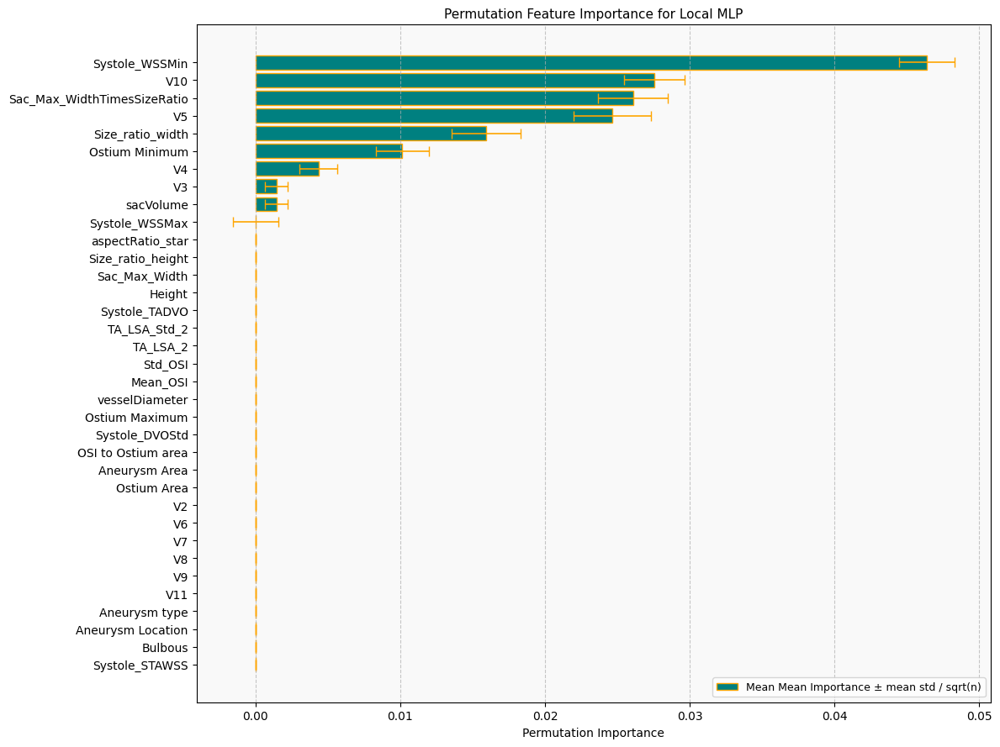

In [14]:
generate_feature_permutation_plots(models, X_test, y_test, "MLP")

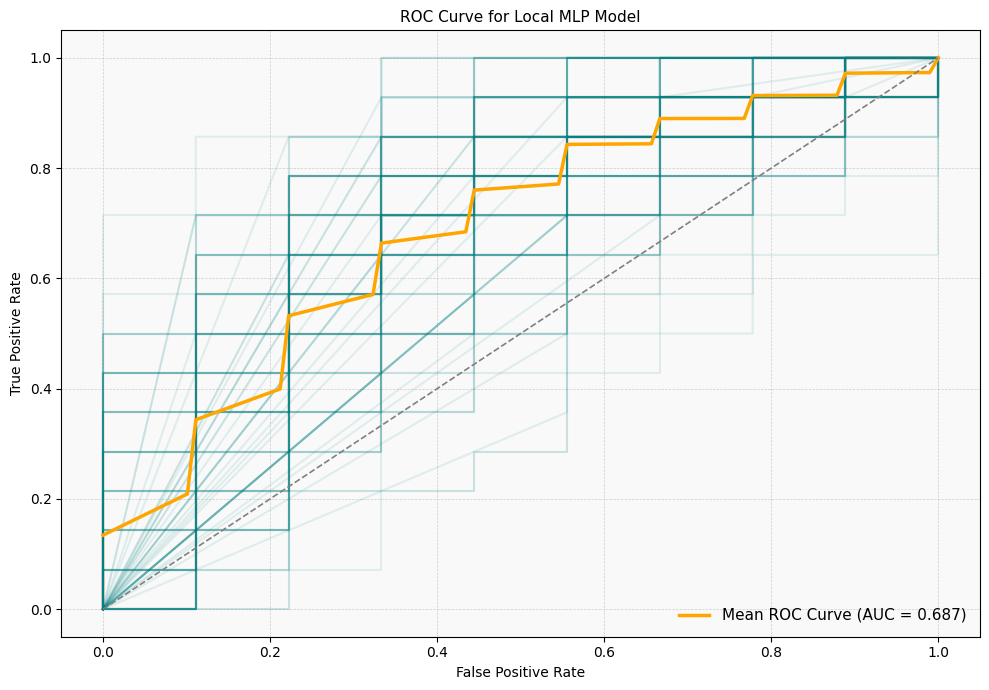

In [15]:
generate_roc_plots(roc_curves, metrics, "MLP")

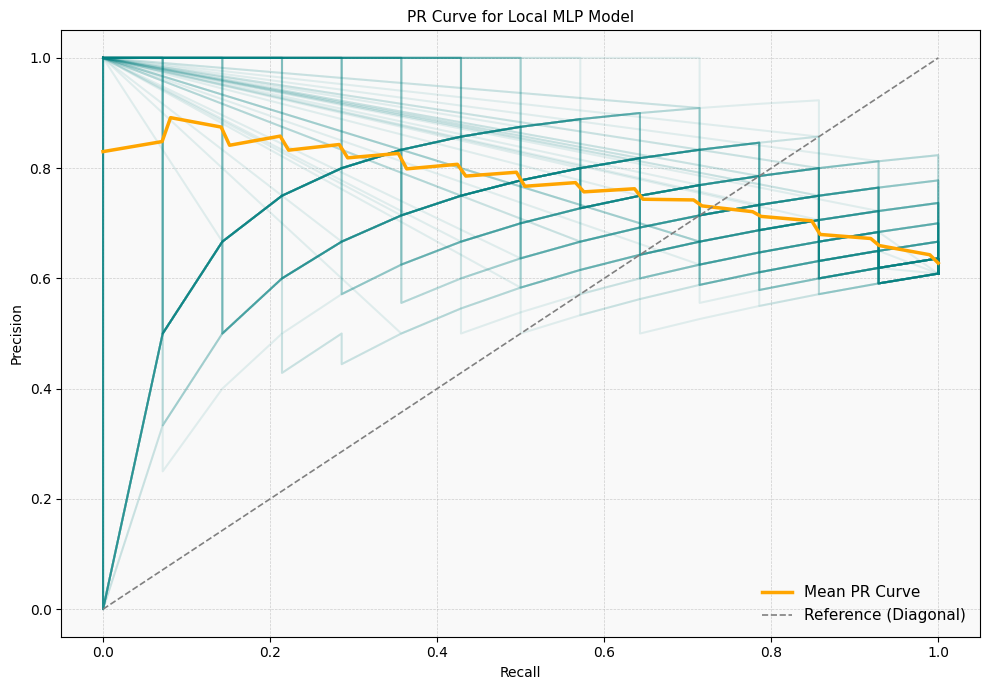

In [16]:
generate_pr_plots(precision_recall_curves, metrics, "MLP")

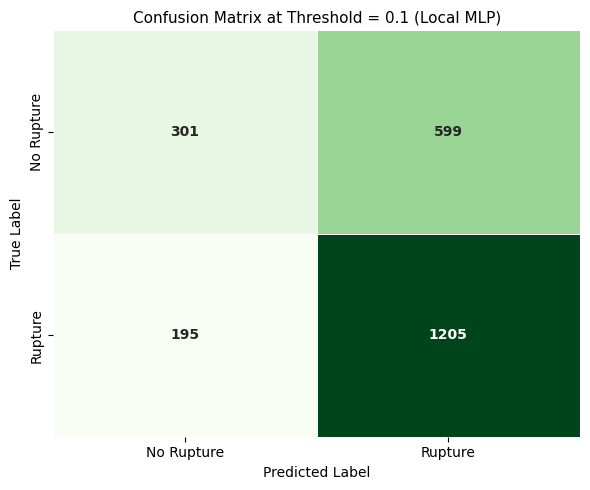

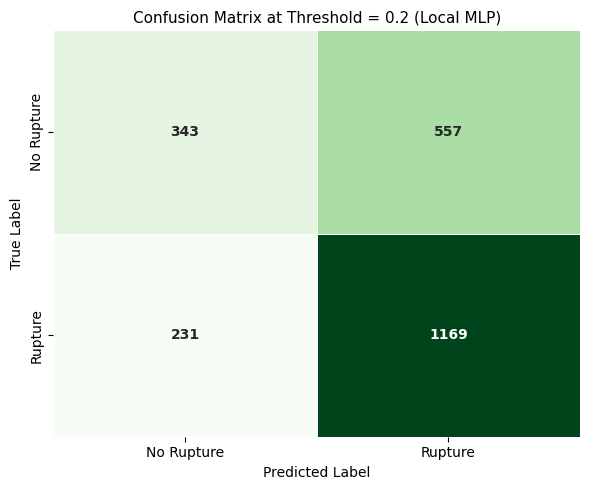

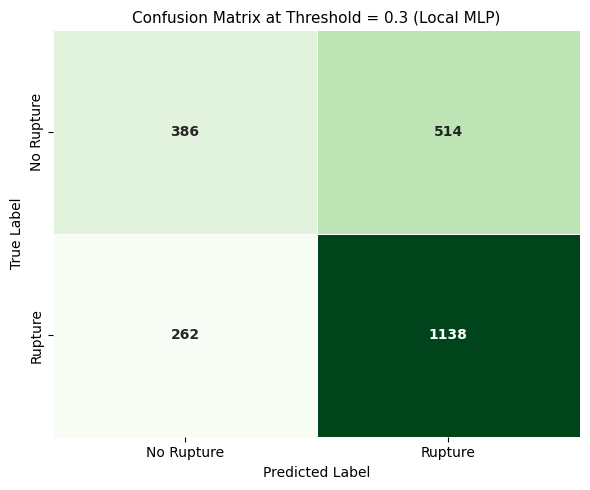

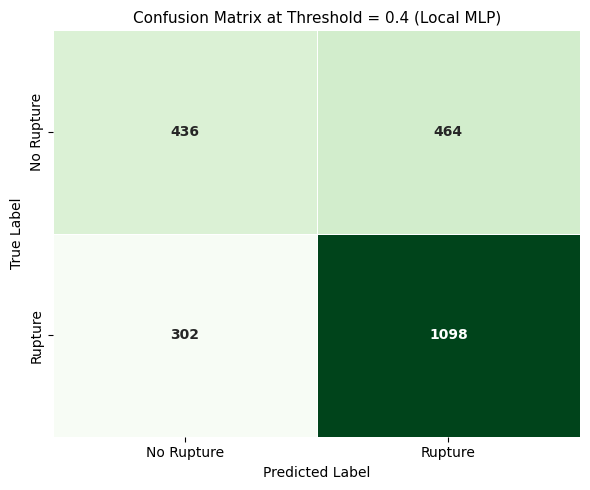

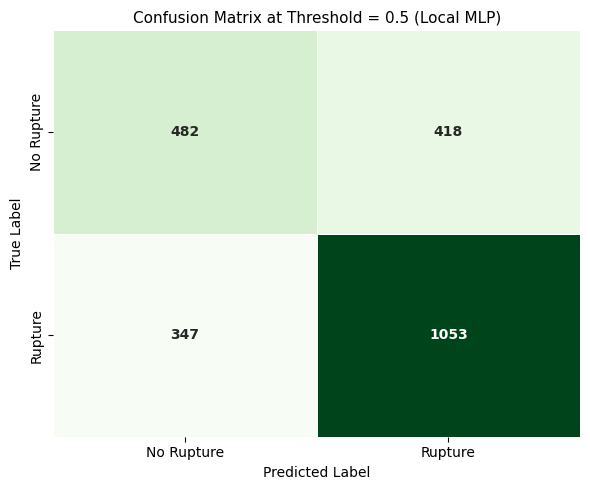

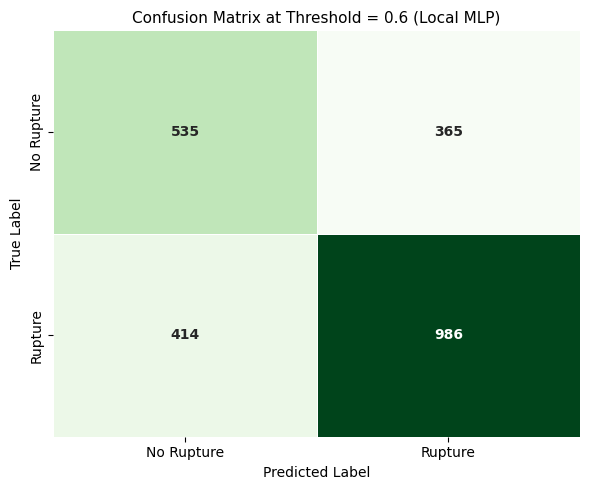

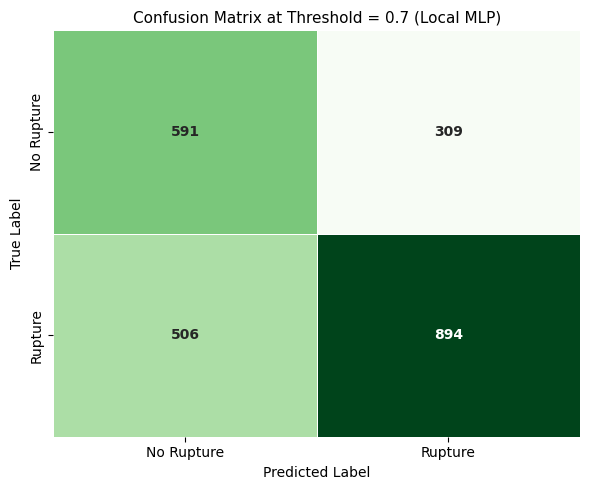

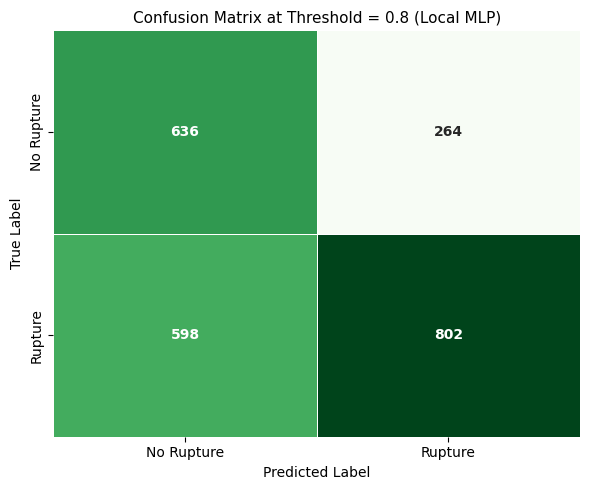

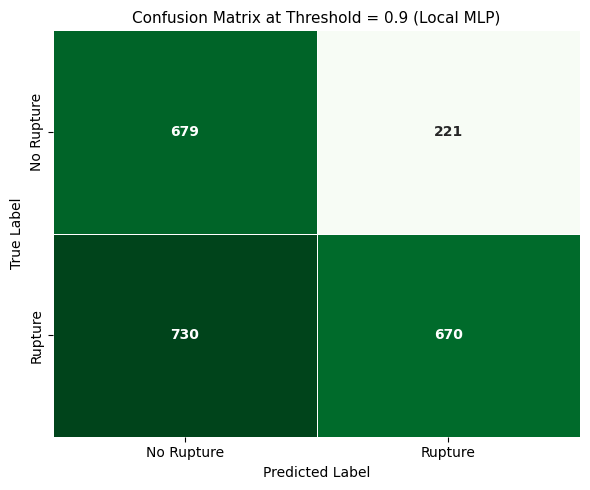

In [17]:
generate_confusian_matrix_plots(conf_matrices, "MLP")  

### ExtraTrees

## Comparing LR, SVC, Decision Trees, XGB, MLP, BART on Top Features

We will now only run the models using the top 7 features based on mutual information where 5 are numerical 
and 2 are categorical (the two are pre-determined). 

The numerical features that are highly correlated are dropped in favor of the one with the highest mutual information.


## Ignore Below

In [ ]:
import pandas as pd

for i in range(1, 51):
    X = pd.read_csv(f"/Users/jasoncarlson/Downloads/AneurysmRuptureDataBetterSplits/data_with_rupture_status_integer_categoricals/test/test_data{i}.csv")

    X["Ostium Area"] = X["Ostium Area"]**(1/2.0)
    X["Aneurysm Area"] = X["Aneurysm Area"]**(1/2.0)
    X["sacVolume"] = X["sacVolume"]**(1/3.0)

    # feature combos
    X["OSI to Ostium area"] = X["Mean_OSI"] / (X["Ostium Area"]**2)
    X["Sac_Max_WidthTimesSizeRatio"] = X["Sac_Max_Width"]*X["Size_ratio_width"]
    
    X.to_csv(f"~/Downloads/AneurysmRuptureDataBetterSplits/data_with_rupture_status_integer_categoricals_and_two_extra_cols/test/test_data{i}.csv", index=False)

In [ ]:
!mkdir -p /Users/jasoncarlson/Downloads/AneurysmRuptureDataBetterSplits/data_with_rupture_status_integer_categoricals_and_two_extra_cols/test

In [ ]:
!mkdir -p /Users/jasoncarlson/Downloads/AneurysmRuptureDataBetterSplits/data_with_rupture_status_integer_categoricals_and_two_extra_cols/train_and_val